# What happens when we analyze fMRI data unrelated to the EEG data?

In [1]:
import glob
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scipy
import sys

from datetime import datetime

sys.path.append('../../feeg_fmri_sync')

from feeg_fmri_sync.plotting import (
    display_plot,
    generate_latex_label,
    plot_all_search_results_2d_on_same_colormap,
    plot_local_minima
)
from feeg_fmri_sync.search import (
    build_models,
    search_voxels
)
from feeg_fmri_sync.simulations import (
    build_model_to_fmri,
    generate_downsampled_simulated_fmri,
)
from feeg_fmri_sync.utils import (
    generate_descriptions_from_search_df,
)
from feeg_fmri_sync.vectorized_models import VectorizedHemodynamicModel

## Initialize constants for Hemodynamic Modeling

In [2]:
### Initialize constants ###
sample_freq = 20
tr = 800
n_trs_skipped_at_beginning = 0
hemodynamic_response_window = 30

# Actual Values to generate data from
expected_delta = 2.25
expected_tau=1.25
expected_alpha=2

## Initialize constants for simulation

In [3]:
# Plot the generated data
# NOTE: only the first of the trials will be plotted
plot_generated_data = False

# Plot perfect data when modeling
plot_perfect_comparison = True

# noises to examine and plot when modeling
noise_range = np.arange(1, 16, step=3)
noises_to_plot = [4, 10, 16]

# trials we run for each condition and how many trials to plot when modeling
num_trials = 100
num_trials_to_plot = 1

# models to examine
models_to_test = [
    {
        'name': 'downsample',
        'model': VectorizedHemodynamicModel,
        'fmri_data_generator': generate_downsampled_simulated_fmri,
    }
]

num_models = 50
num_models_to_generate = num_models

# eeg data types to use
eeg_data_options_for_fmri_generation = ['random']
eeg_data_options_for_simulation = ['without_nans']



## Initialize Analysis variables

In [4]:
step_size = 0.05

filename_substring = f'RANDOM_effect_of_ideal_params_delta{expected_delta}_tau{expected_tau}_alpha{expected_alpha}'
filename_ext = '.csv'
plot = True

delta = np.arange(1, 3+step_size, step_size)
tau = np.arange(0.75, 1.75+step_size, step_size)
alpha = np.arange(1.75, 2.25+step_size, step_size)

print(f'Delta target: {expected_delta}, Range:\n{delta}\n')
print(f'Tau target: {expected_tau}, Range:\n{tau}\n')
print(f'Alpha target: {expected_alpha}, Range:\n{alpha}\n')

Delta target: 2.25, Range:
[1.   1.05 1.1  1.15 1.2  1.25 1.3  1.35 1.4  1.45 1.5  1.55 1.6  1.65
 1.7  1.75 1.8  1.85 1.9  1.95 2.   2.05 2.1  2.15 2.2  2.25 2.3  2.35
 2.4  2.45 2.5  2.55 2.6  2.65 2.7  2.75 2.8  2.85 2.9  2.95 3.  ]

Tau target: 1.25, Range:
[0.75 0.8  0.85 0.9  0.95 1.   1.05 1.1  1.15 1.2  1.25 1.3  1.35 1.4
 1.45 1.5  1.55 1.6  1.65 1.7  1.75]

Alpha target: 2, Range:
[1.75 1.8  1.85 1.9  1.95 2.   2.05 2.1  2.15 2.2  2.25]



## Load available datasets and plot Search Space Heatmap 

In [5]:
# Reuse whatever exists
data = []

matching_files = sorted(glob.glob(f'{filename_substring}*{filename_ext}'))
if len(matching_files) > 0:
    for filename_to_use in matching_files:
        if num_models_to_generate <= 0:
            continue
        num_models_to_generate -= 1
        print(f'Loading data from {filename_to_use}...')
        with open(filename_to_use, 'r') as f:
            df = pd.read_csv(f, index_col=0)
            assert len(df['model_name'].unique()) == 1
            df_to_plot = df.drop(columns='model_name').astype(float)
            
            for noise in np.concatenate([[0], noise_range]):
                columns_to_choose = np.char.startswith(df_to_plot.columns.to_numpy().astype(str), f'{noise}noise')
                columns_for_noise = df_to_plot.columns[columns_to_choose]

                average_df = df_to_plot.loc[:,['delta', 'tau', 'alpha']]
                average_df[f'Average Cost: noise {noise} ({model_name})'] = df_to_plot[columns_for_noise].mean(axis=1)
                display_plot(plot_all_search_results_2d_on_same_colormap, average_df)

                # Grab parameters with the minimum cost
                minimum_cost_mask = df_to_plot[columns_for_noise] == df_to_plot[columns_for_noise].min()
                minimum_cost_array = df_to_plot[columns_for_noise][minimum_cost_mask].to_numpy()

                for point in zip(*np.where(~np.isnan(minimum_cost_array))):
                    row_of_interest = df_to_plot.iloc[point[0]]
                    data.append([row_of_interest['delta'], row_of_interest['tau'], row_of_interest['alpha'], noise, num_models_to_generate])


## Est vs Actual (at generated points) and plot Search Space Heatmap 

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


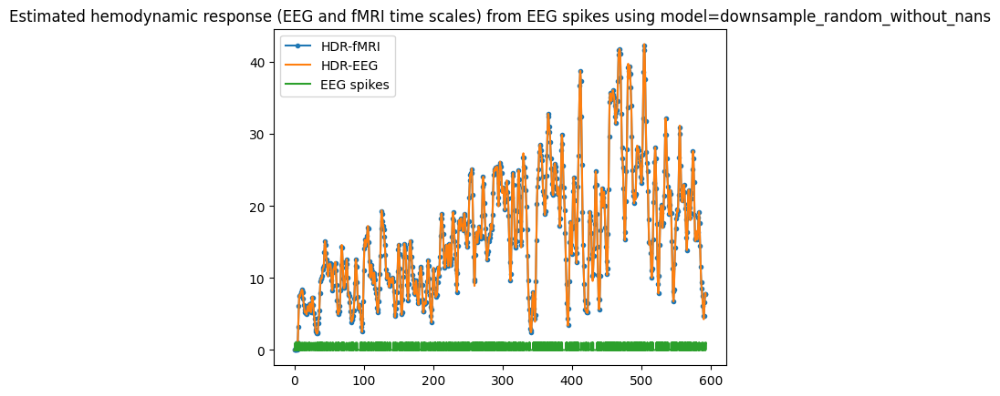

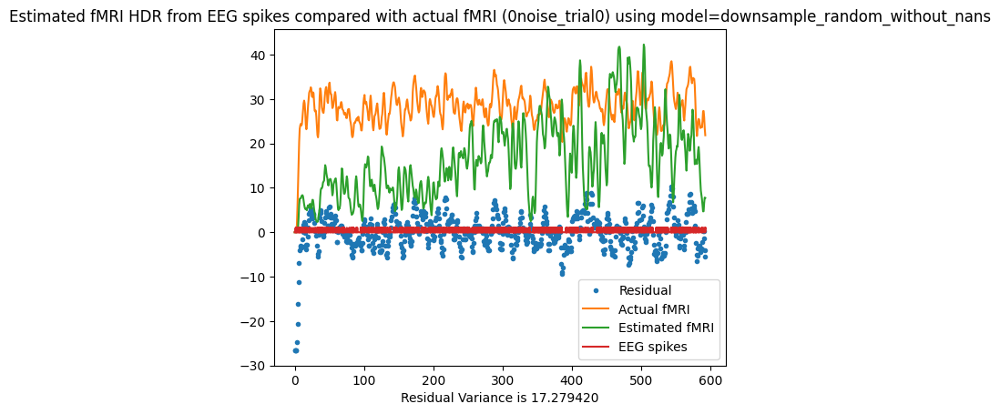

Residual Variance is 17.279420


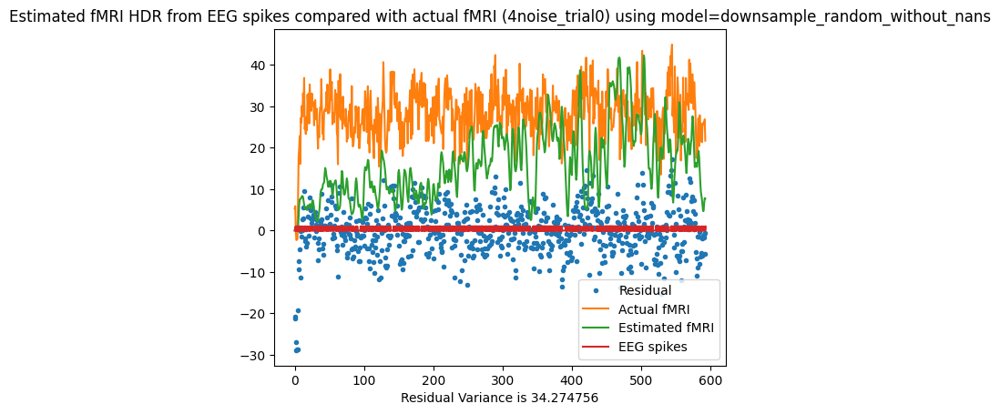

Residual Variance is 34.274756


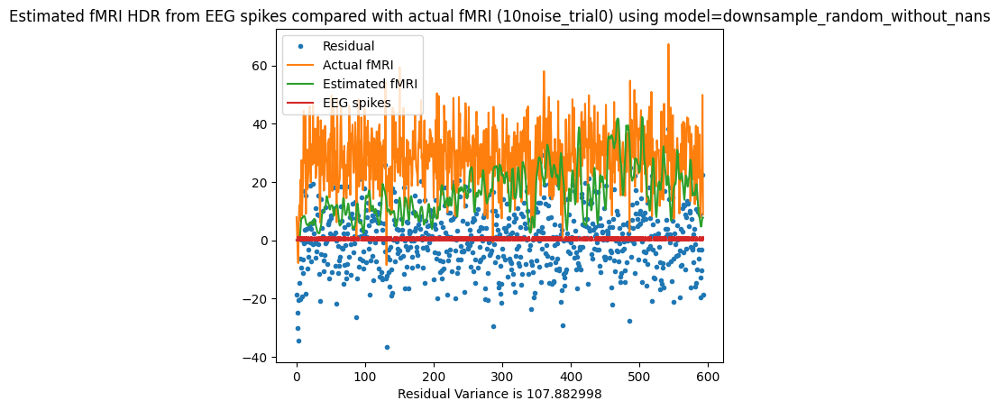

Residual Variance is 107.882998
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.70 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.69 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.69 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.68 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.70 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.90 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.90 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.87 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.88 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.95 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.87 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.91 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 1.94 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 1.88 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 16.87576661557596; at
      delta   tau  alpha
9470    3.0  1.75   2.25


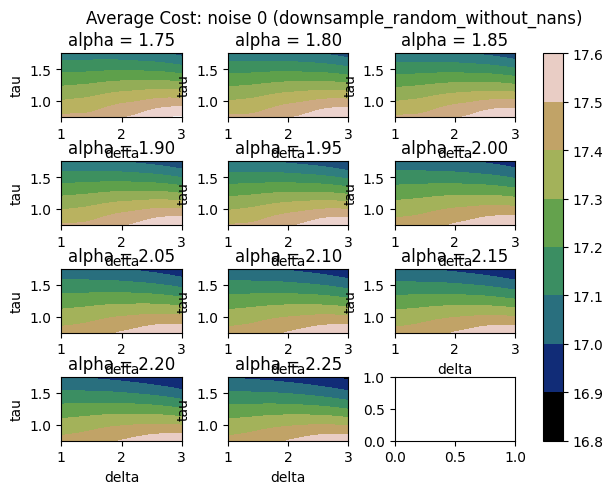

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 17.901171037564573; at
      delta   tau  alpha
9470    3.0  1.75   2.25


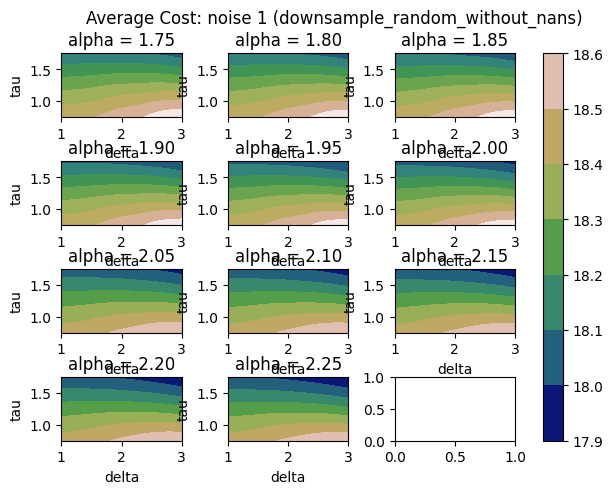

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 32.80044915379337; at
      delta   tau  alpha
9470    3.0  1.75   2.25


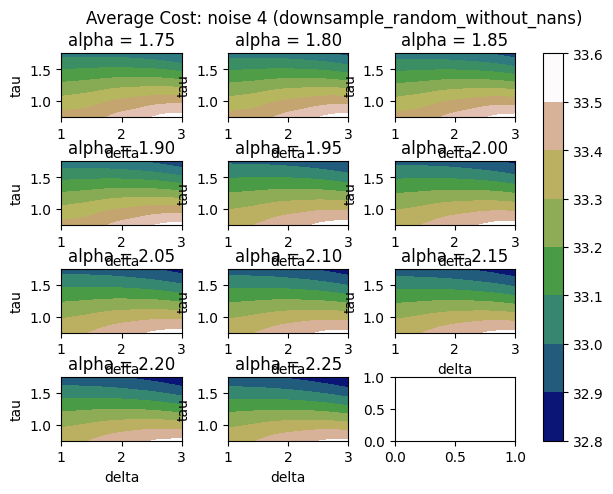

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 66.05232065112158; at
      delta   tau  alpha
9470    3.0  1.75   2.25


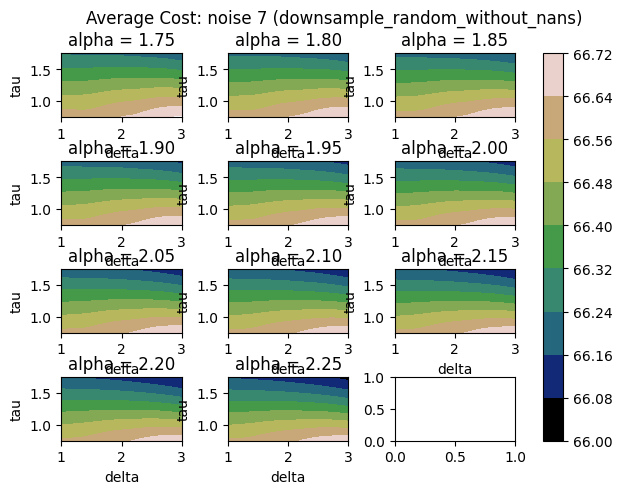

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 115.93706783897967; at
      delta   tau  alpha
9470    3.0  1.75   2.25


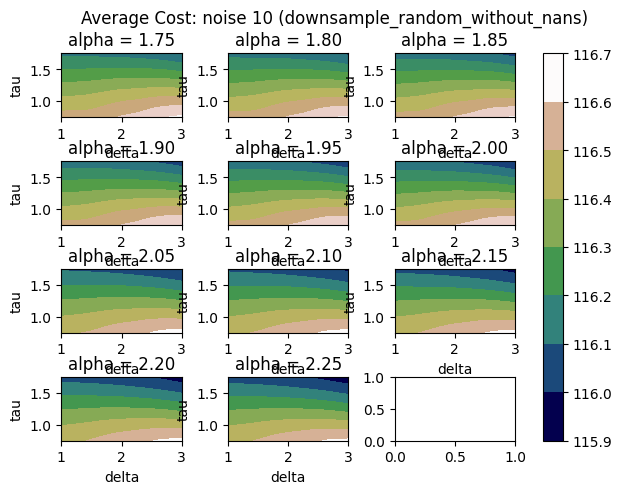

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 184.10354801805698; at
      delta   tau  alpha
9470    3.0  1.75   2.25


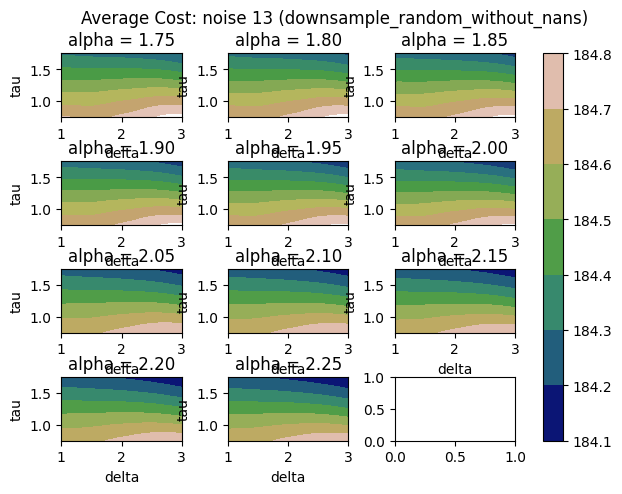

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


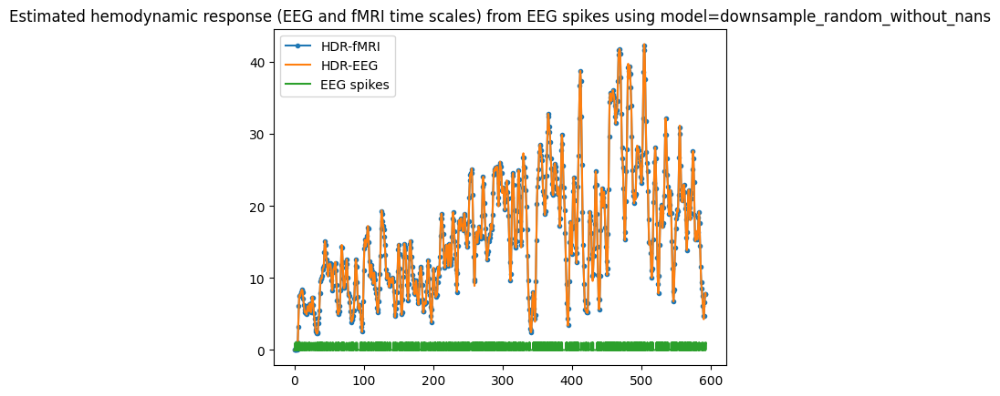

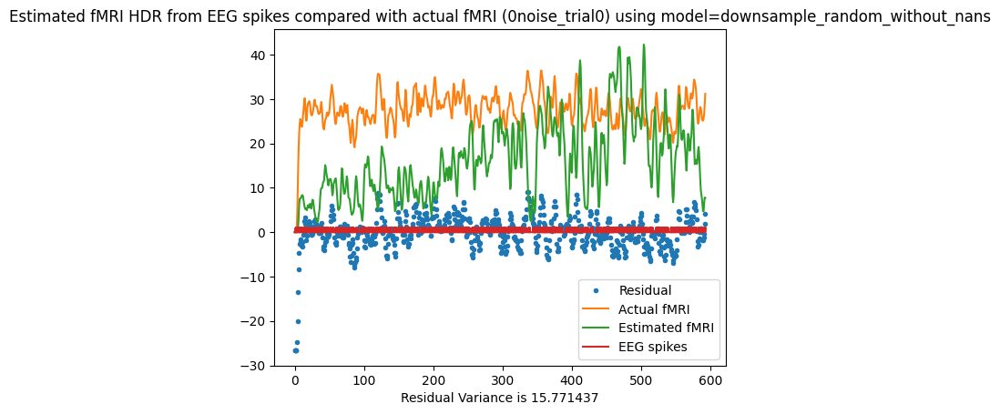

Residual Variance is 15.771437


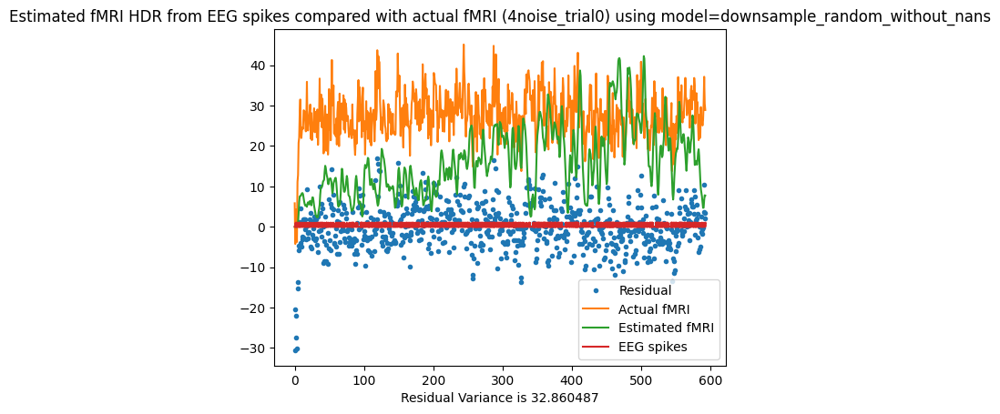

Residual Variance is 32.860487


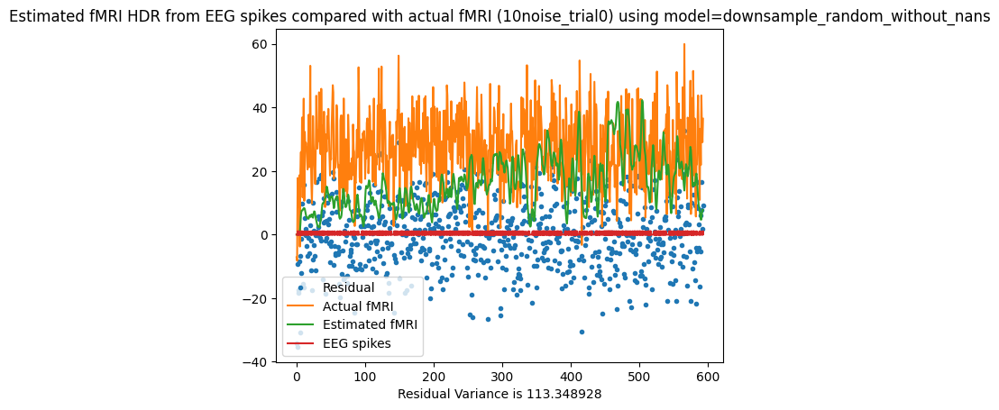

Residual Variance is 113.348928
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.78 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.94 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 2.03 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 2.08 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.99 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.99 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.00 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.04 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.24 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.09 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.06 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.05 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.04 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.06 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 15.765142392302963; at
      delta  tau  alpha
5004   2.05  1.4   2.25


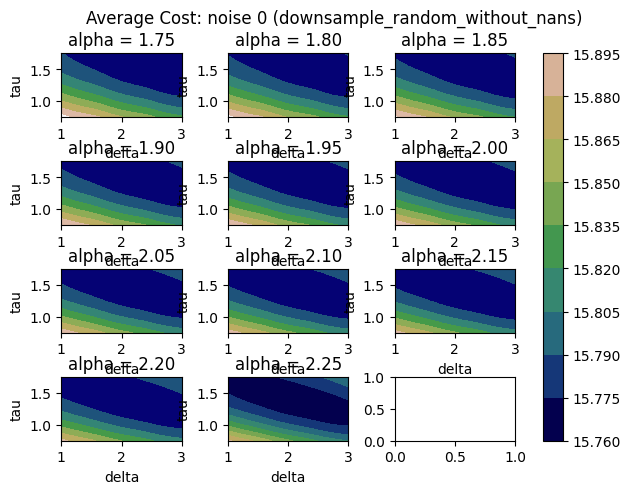

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 16.79097645049632; at
      delta  tau  alpha
5004   2.05  1.4   2.25


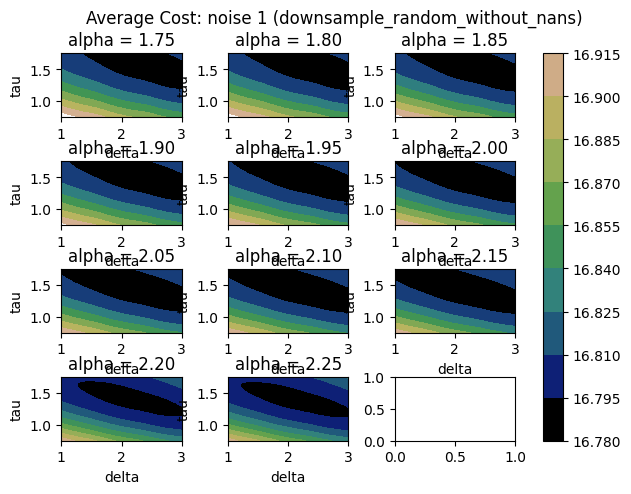

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 32.00955998224591; at
      delta  tau  alpha
4311    1.9  1.4   2.25


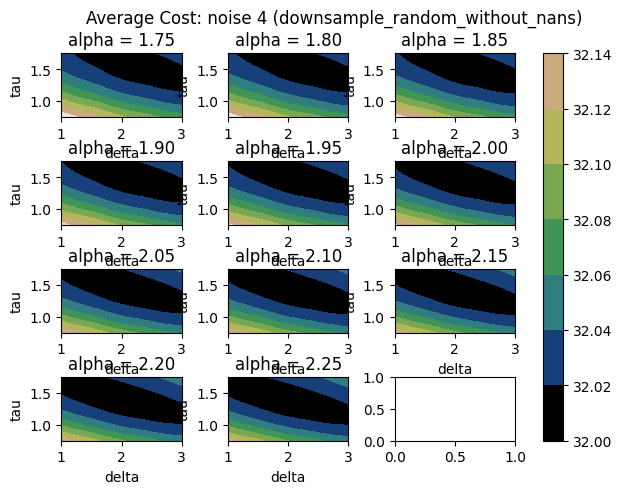

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 64.50576170388472; at
      delta   tau  alpha
7743   2.65  1.25   2.25


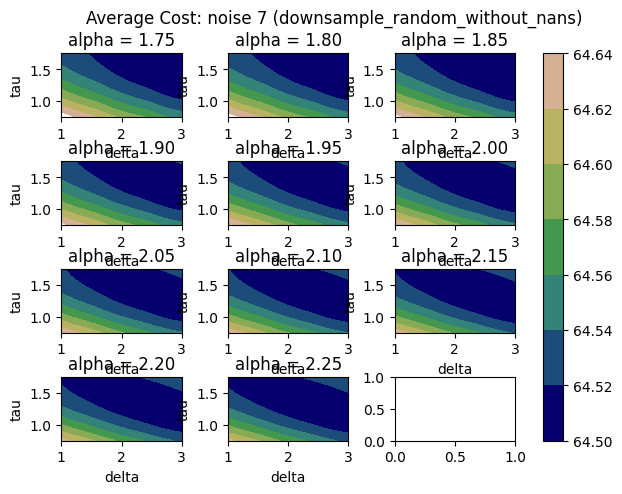

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 115.7996513442614; at
      delta   tau  alpha
9426    3.0  1.55   2.25


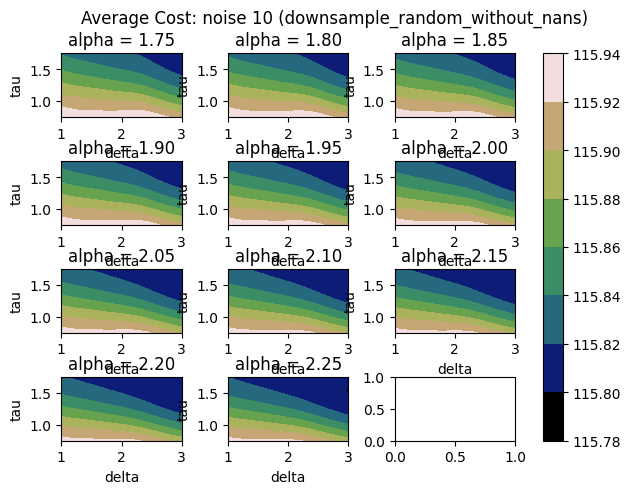

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 185.5376292777636; at
      delta  tau  alpha
1577    1.3  1.6   1.95


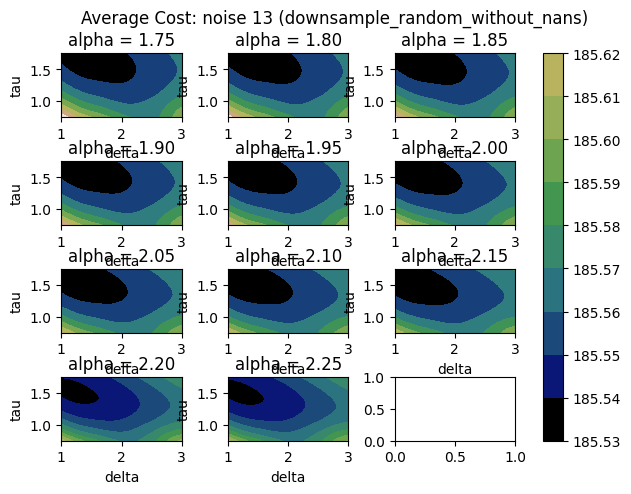

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


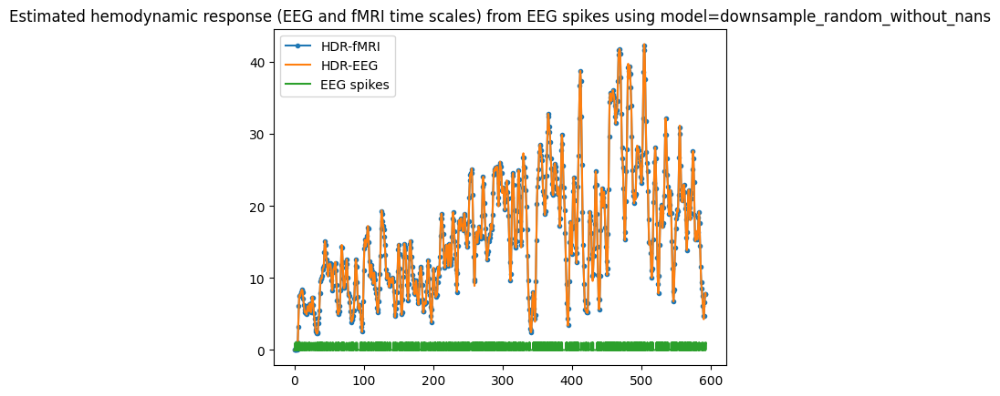

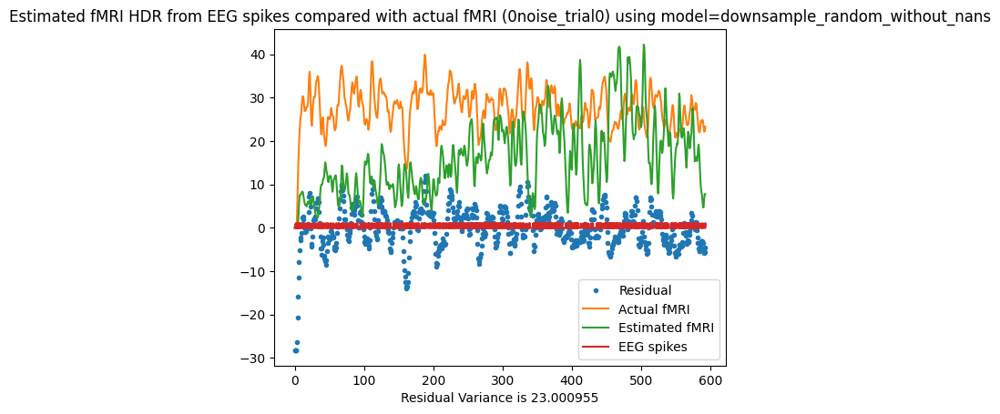

Residual Variance is 23.000955


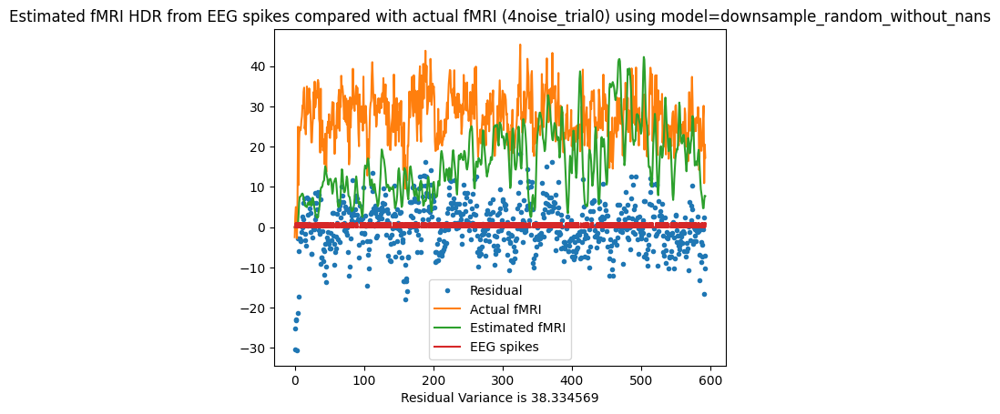

Residual Variance is 38.334569


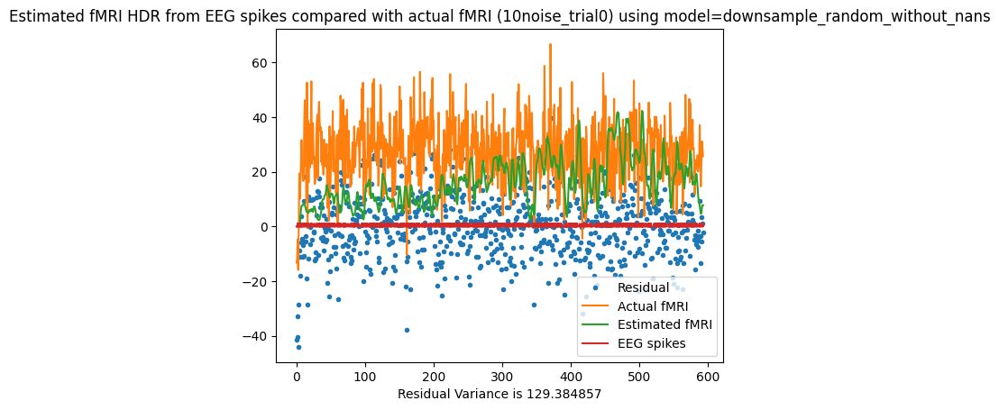

Residual Variance is 129.384857
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.86 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 2.04 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 2.11 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 2.12 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.24 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.36 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.27 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.19 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.15 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.15 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.15 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.23 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.22 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 3.59 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 22.98802736889329; at
      delta  tau  alpha
9283    3.0  0.9   2.25


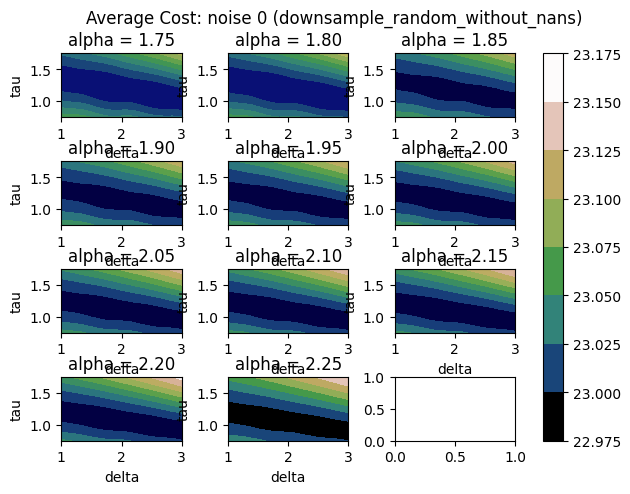

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 23.98015388946535; at
      delta   tau  alpha
7215   2.55  0.95   2.25


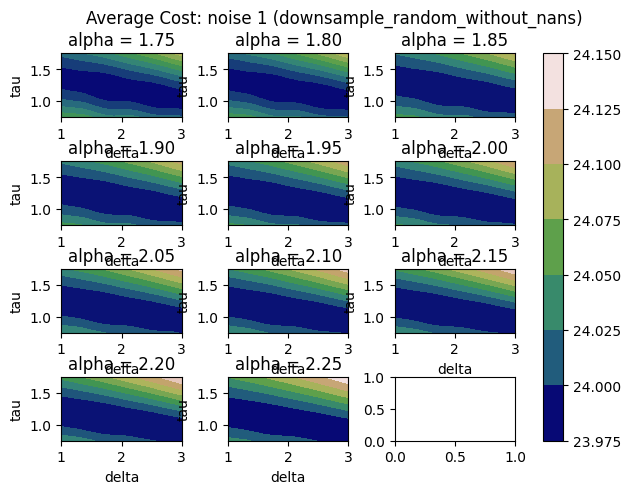

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 38.67755717294906; at
      delta  tau  alpha
9283    3.0  0.9   2.25


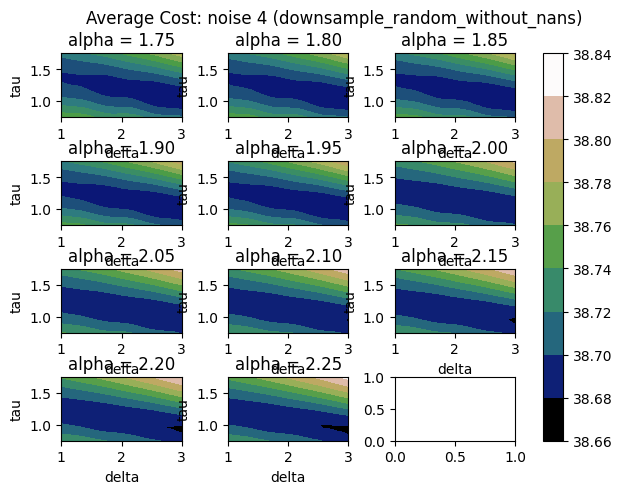

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 72.34424404606176; at
      delta  tau  alpha
3090   1.65  1.1   2.25


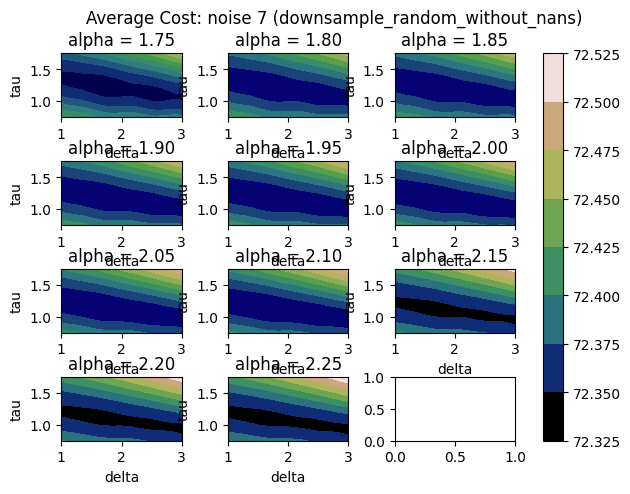

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 123.00163179059633; at
      delta  tau  alpha
3321    1.7  1.1   2.25


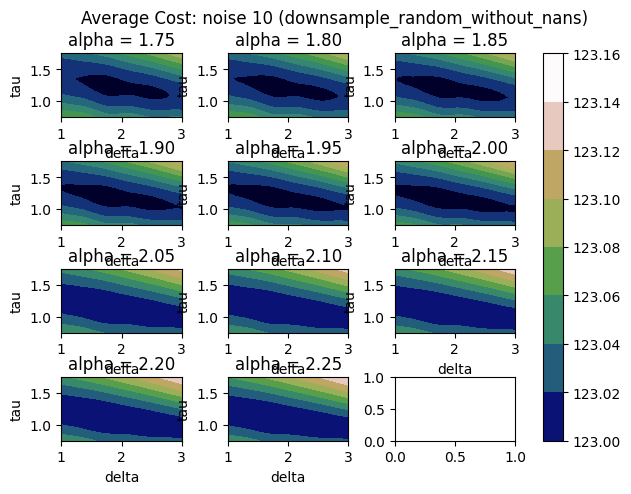

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 193.11911918250385; at
      delta   tau  alpha
9294    3.0  0.95   2.25


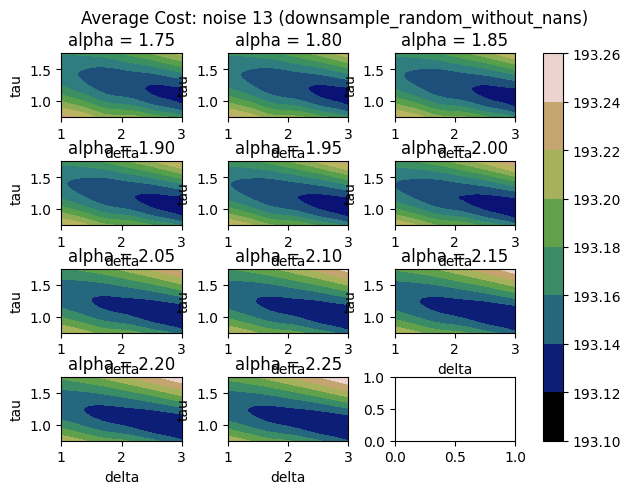

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


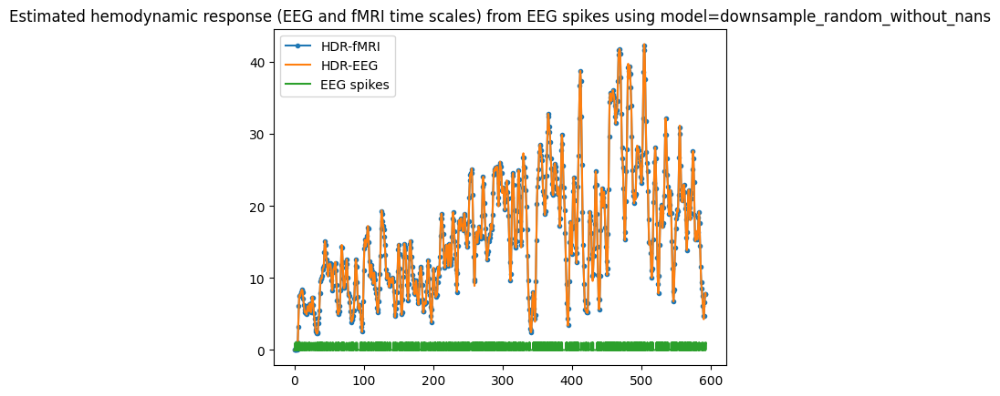

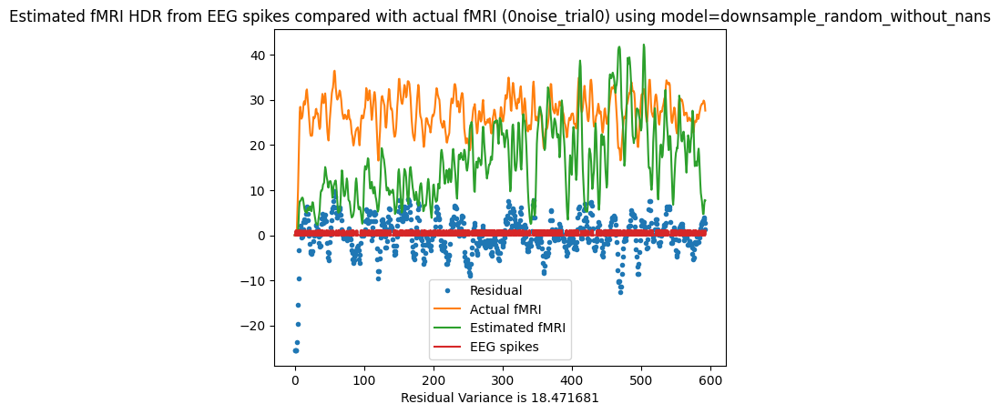

Residual Variance is 18.471681


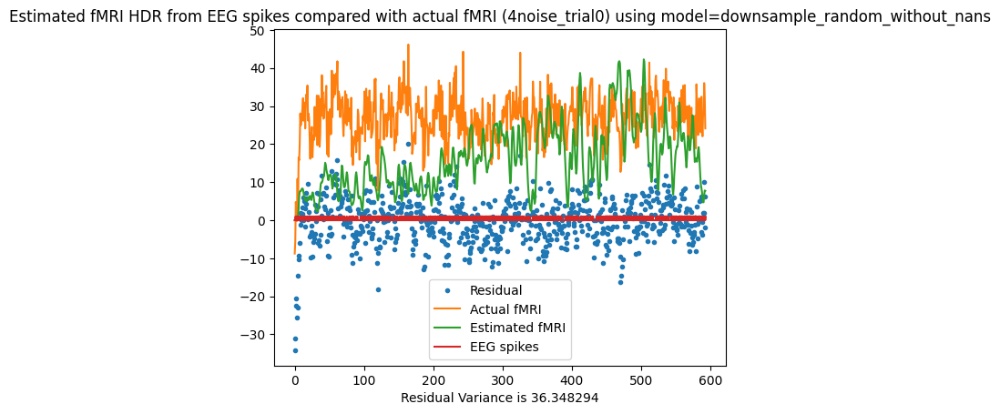

Residual Variance is 36.348294


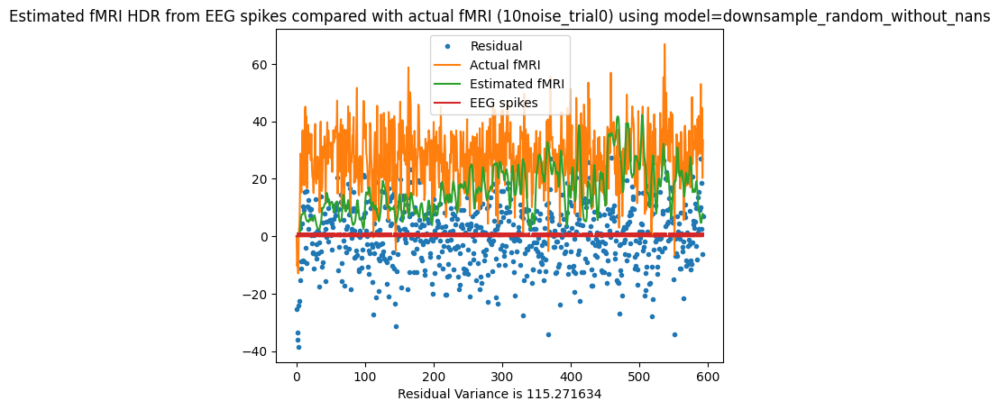

Residual Variance is 115.271634
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.68 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.81 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.90 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.97 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 3.28 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 3.24 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.28 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.38 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.16 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.32 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.16 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.39 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.21 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.27 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 18.435256392672134; at
      delta  tau  alpha
7754   2.65  1.3   2.25


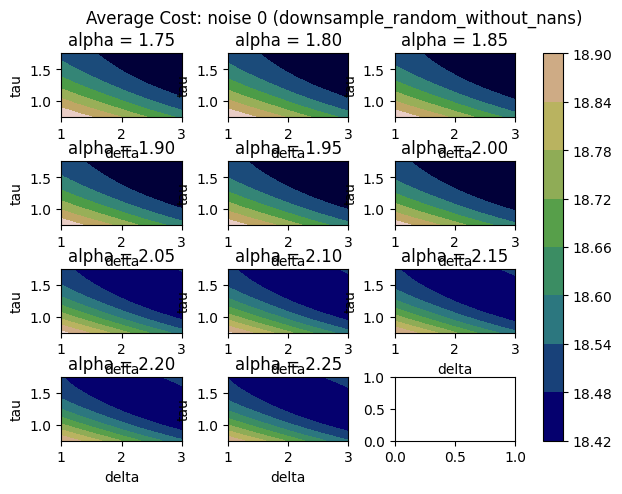

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 19.39011467077236; at
      delta   tau  alpha
8205   2.75  1.25   2.25


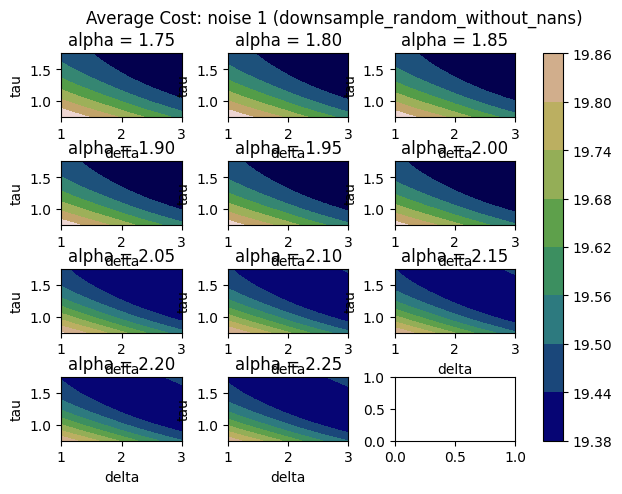

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 34.331750707511006; at
      delta   tau  alpha
8435    2.8  1.25    2.2


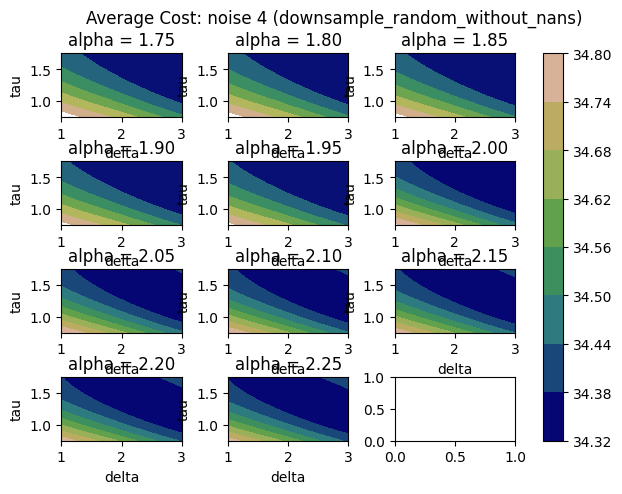

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 67.64824258447544; at
      delta  tau  alpha
8216   2.75  1.3   2.25


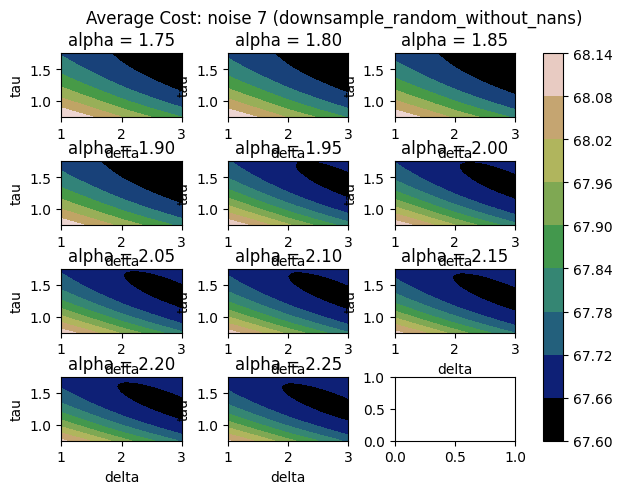

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 119.85326518088782; at
      delta  tau  alpha
7985    2.7  1.3   2.25


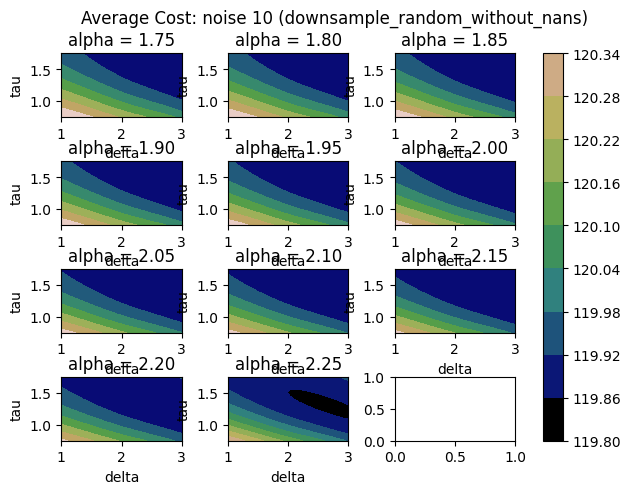

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 187.6675682988121; at
      delta   tau  alpha
9360    3.0  1.25   2.25


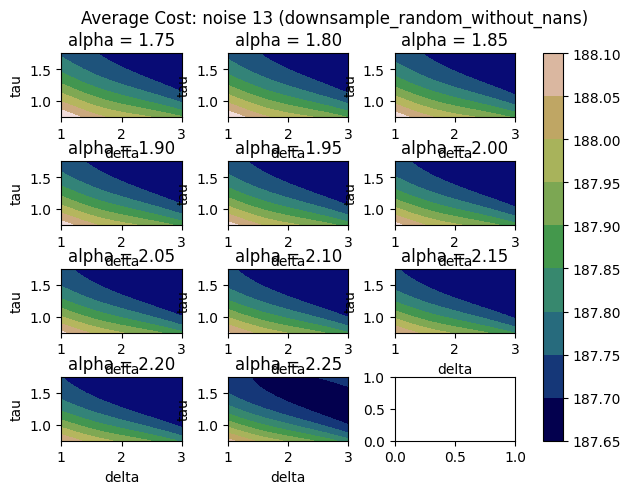

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


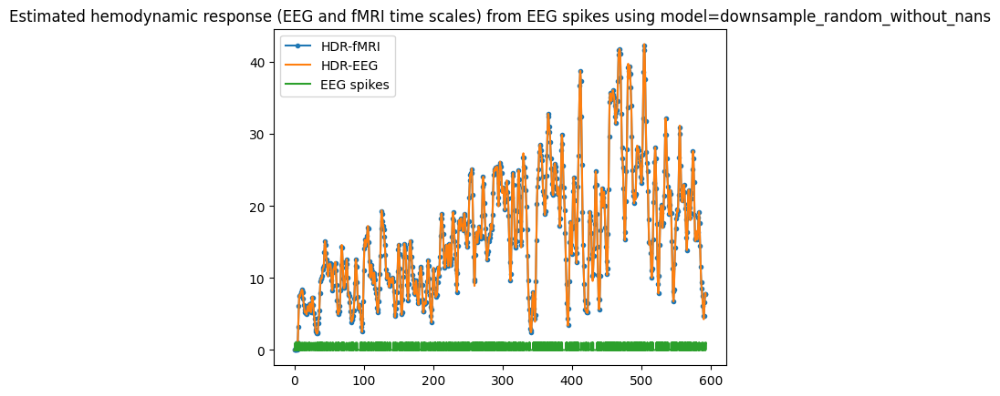

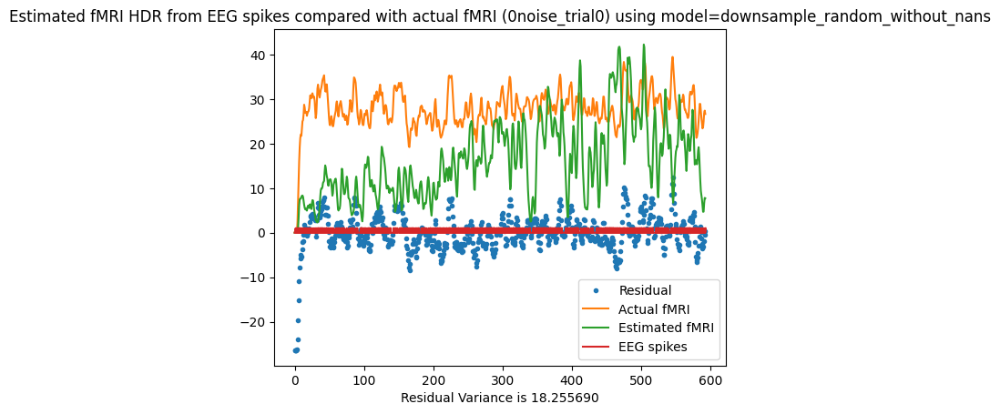

Residual Variance is 18.255690


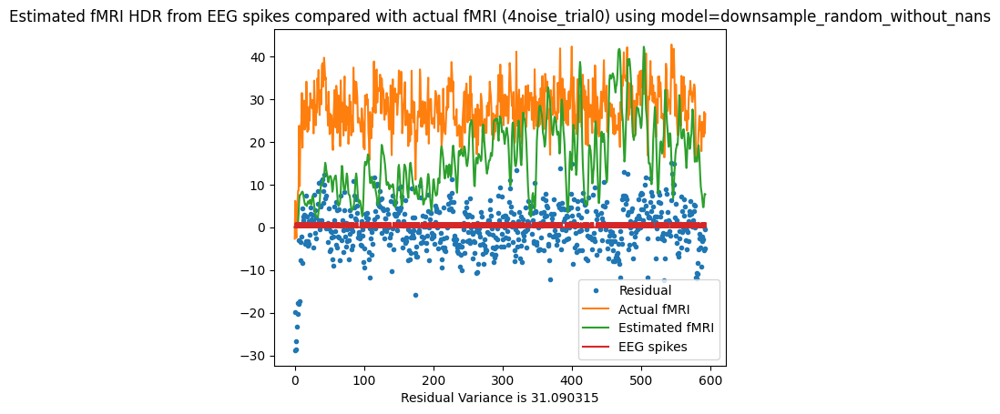

Residual Variance is 31.090315


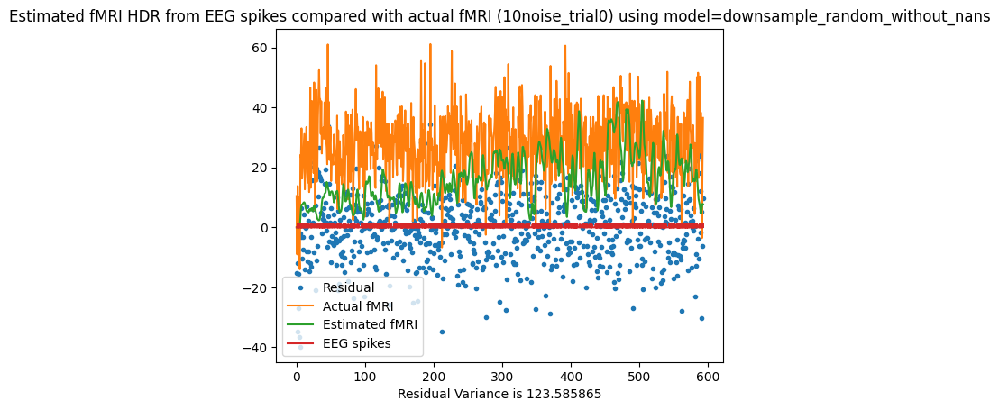

Residual Variance is 123.585865
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.72 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.82 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.84 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.95 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.97 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.98 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.02 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.49 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.38 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.09 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.14 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.11 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.17 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.14 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 17.898056232174497; at
      delta   tau  alpha
9470    3.0  1.75   2.25


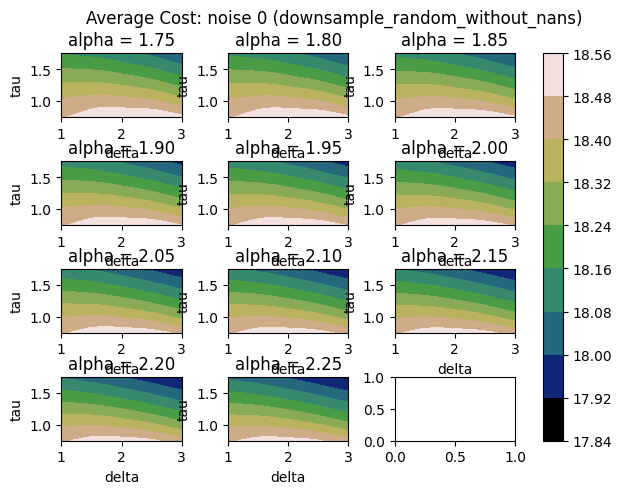

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 18.936092499956285; at
      delta   tau  alpha
9470    3.0  1.75   2.25


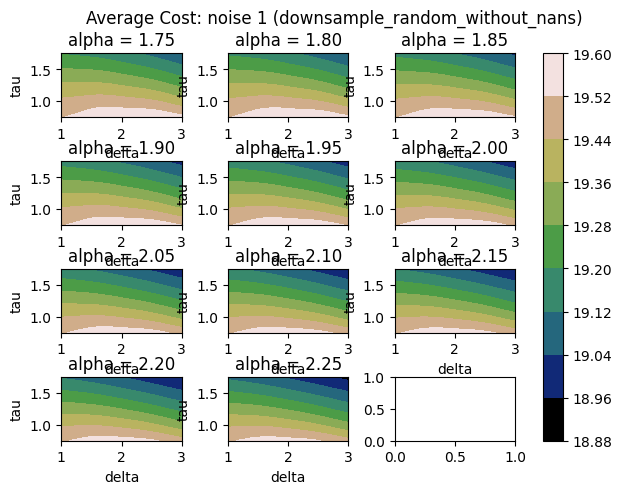

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 34.05914585694145; at
      delta   tau  alpha
9470    3.0  1.75   2.25


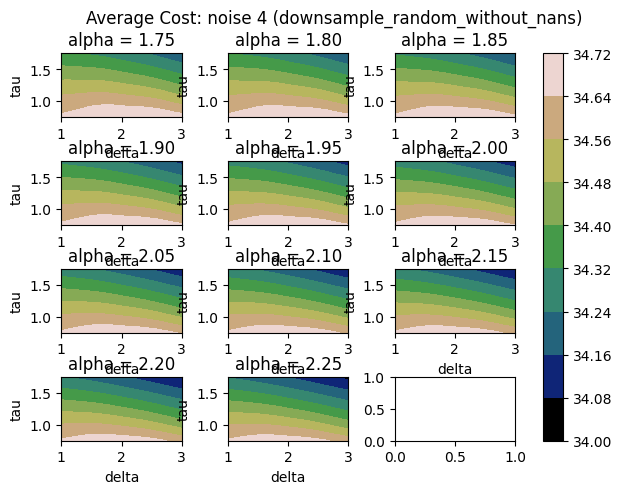

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 67.23946090909155; at
      delta   tau  alpha
9470    3.0  1.75   2.25


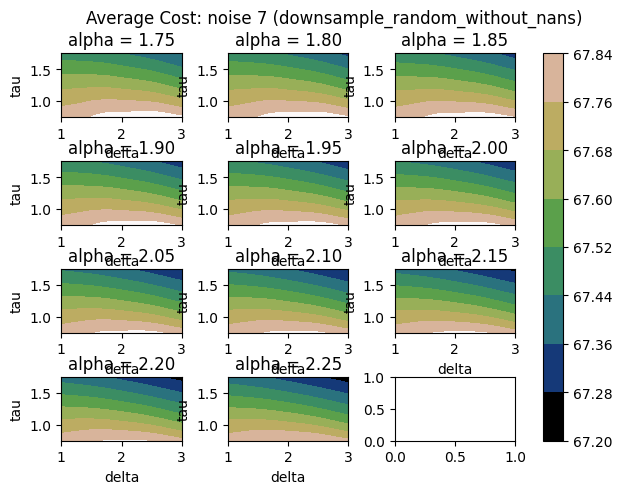

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 117.00731273643505; at
      delta   tau  alpha
9470    3.0  1.75   2.25


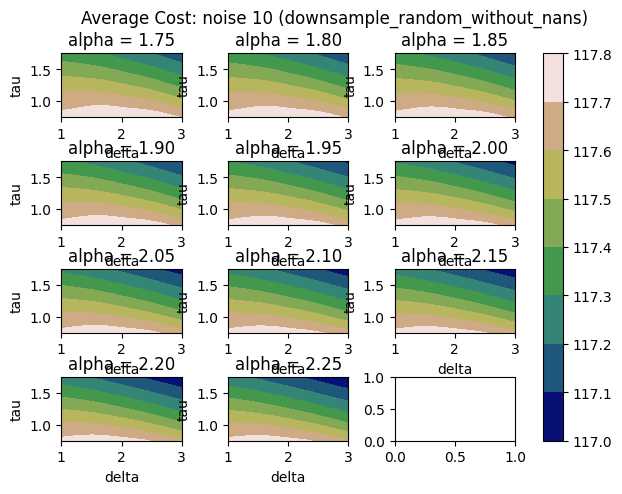

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 186.16006367256261; at
      delta   tau  alpha
9470    3.0  1.75   2.25


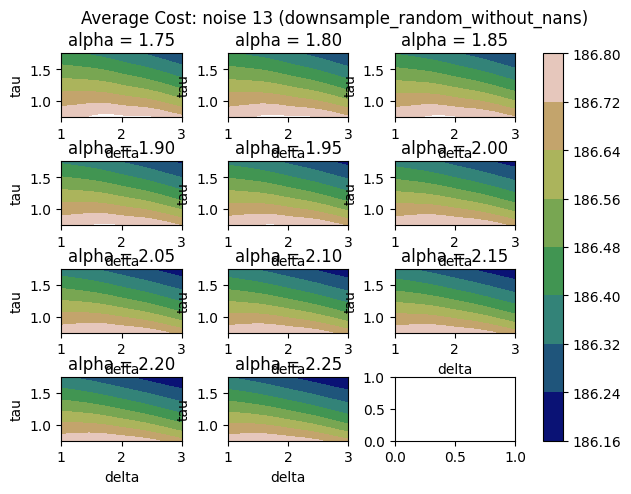

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


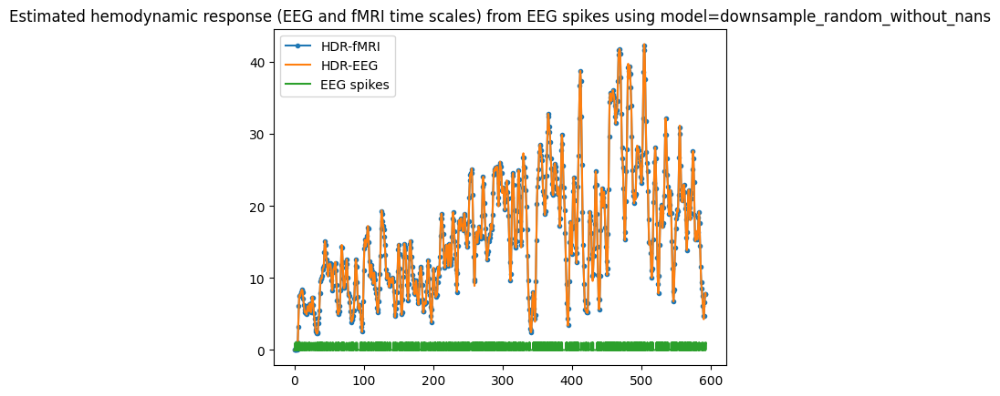

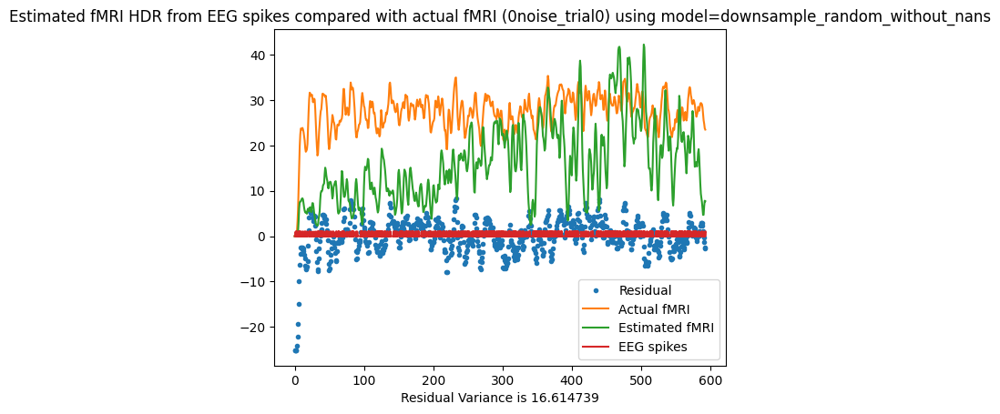

Residual Variance is 16.614739


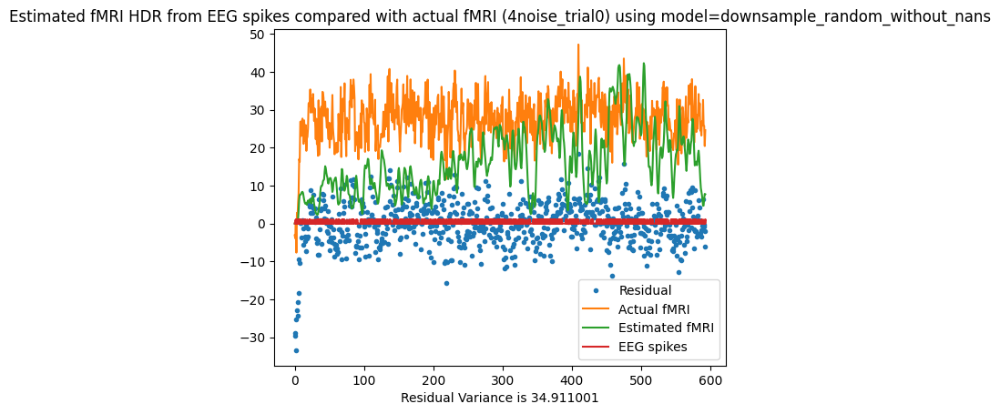

Residual Variance is 34.911001


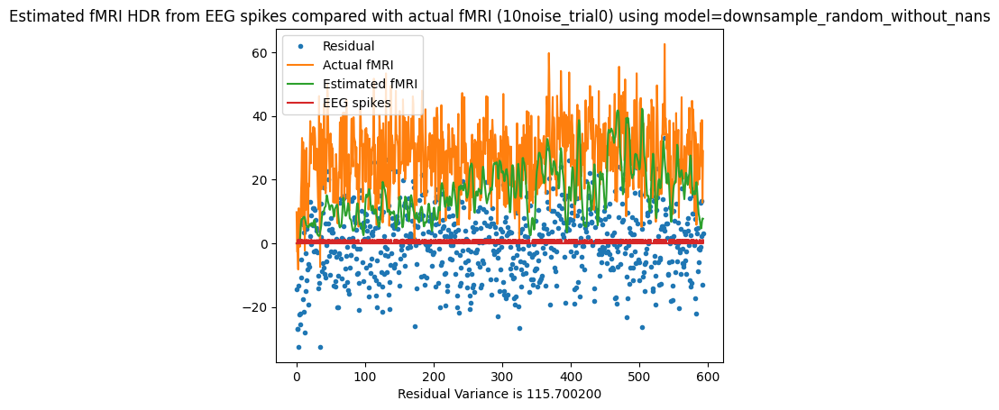

Residual Variance is 115.700200
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.98 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 2.23 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 2.58 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 2.57 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.79 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.66 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.89 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.66 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.60 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.61 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.54 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.59 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.27 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 3.79 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 16.459871152194214; at
     delta   tau  alpha
222    1.0  1.75   1.85


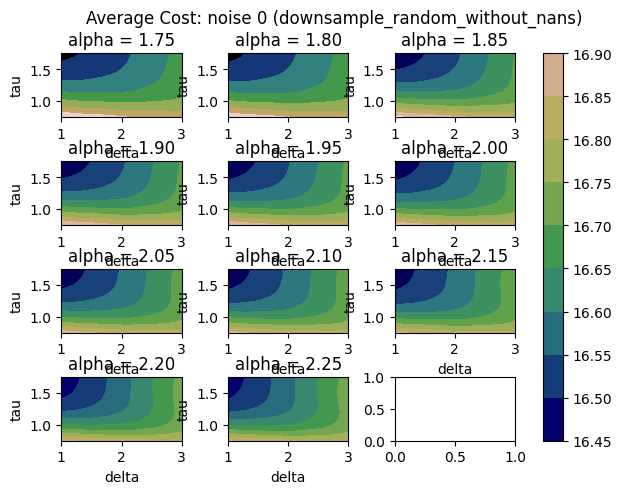

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 17.499826579973607; at
     delta   tau  alpha
222    1.0  1.75   1.85


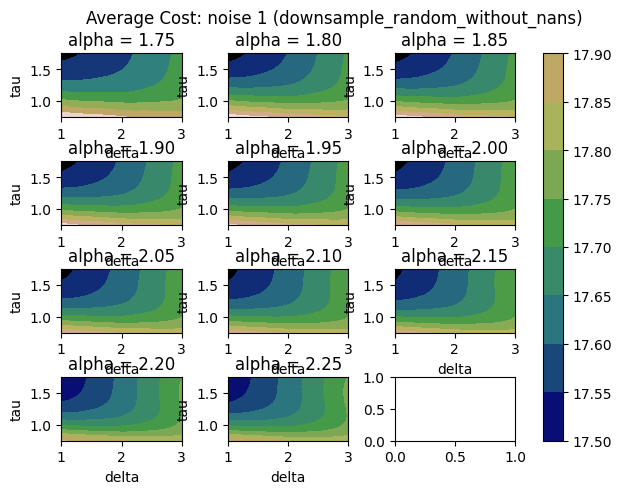

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 32.23570861488238; at
     delta   tau  alpha
223    1.0  1.75    1.9


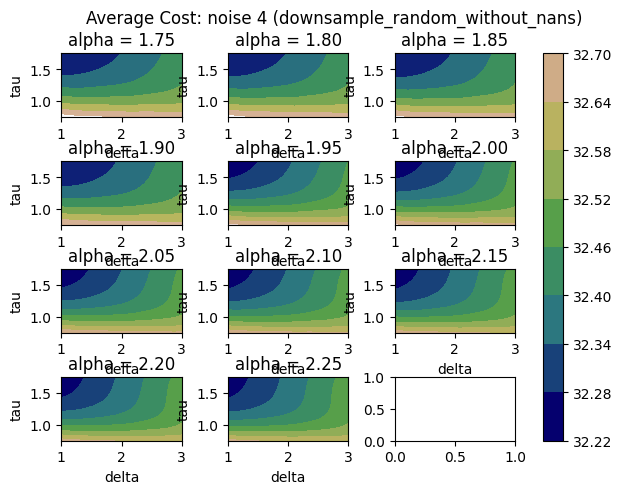

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 65.45339154403514; at
     delta   tau  alpha
220    1.0  1.75   1.75


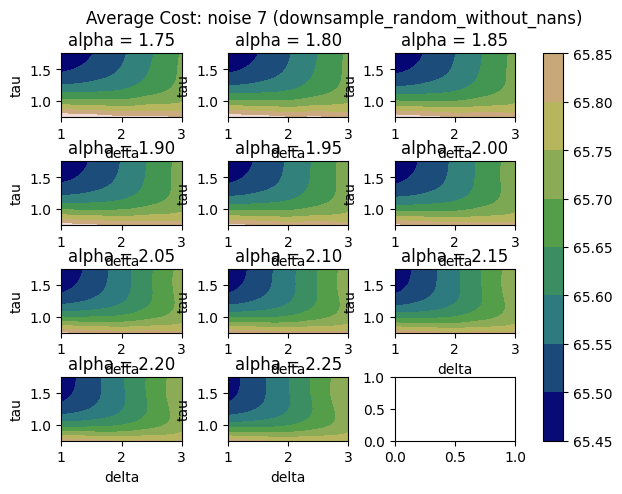

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 117.94500197271141; at
     delta   tau  alpha
225    1.0  1.75    2.0


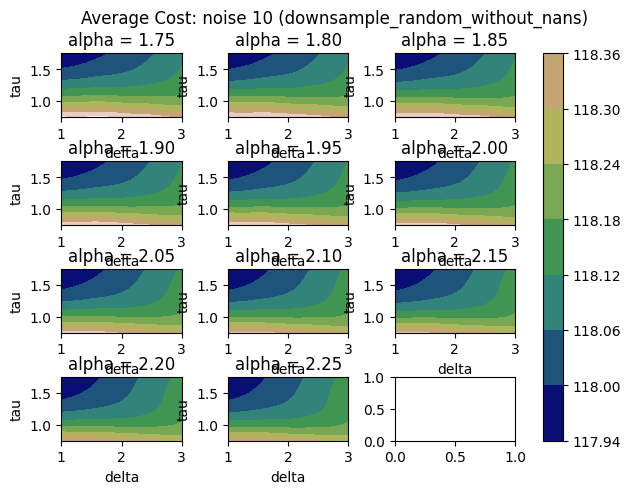

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 186.3354787915155; at
     delta   tau  alpha
223    1.0  1.75    1.9


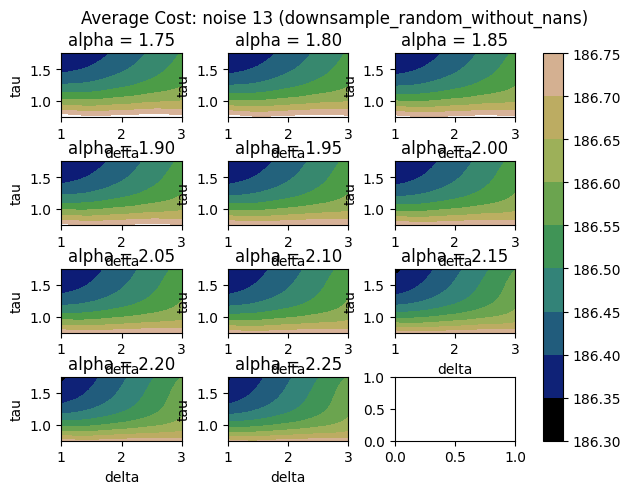

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


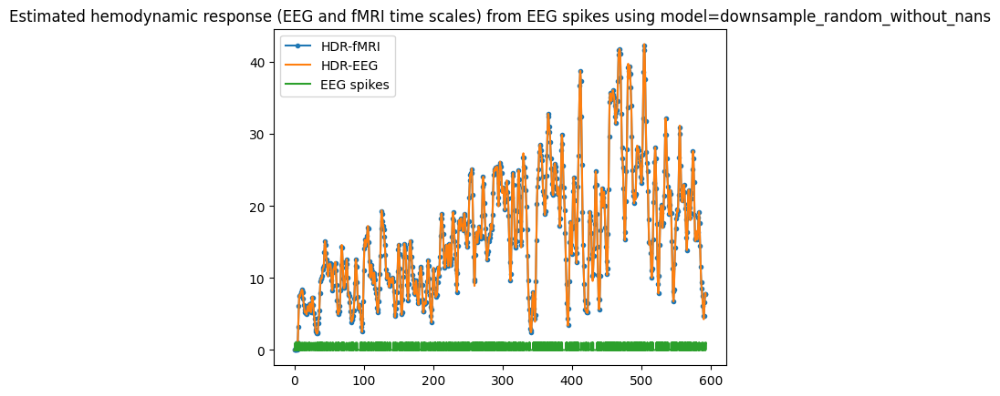

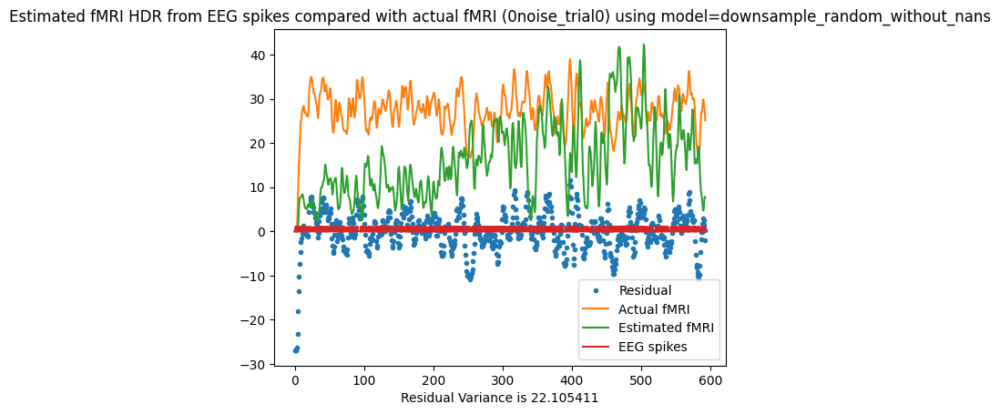

Residual Variance is 22.105411


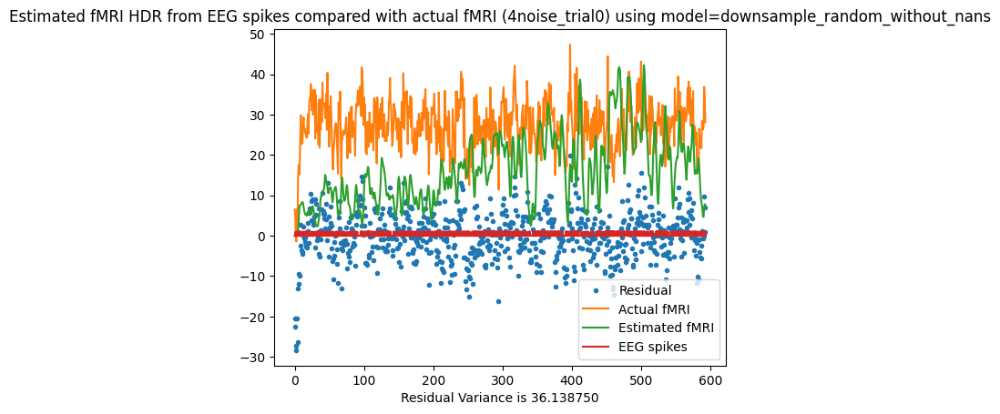

Residual Variance is 36.138750


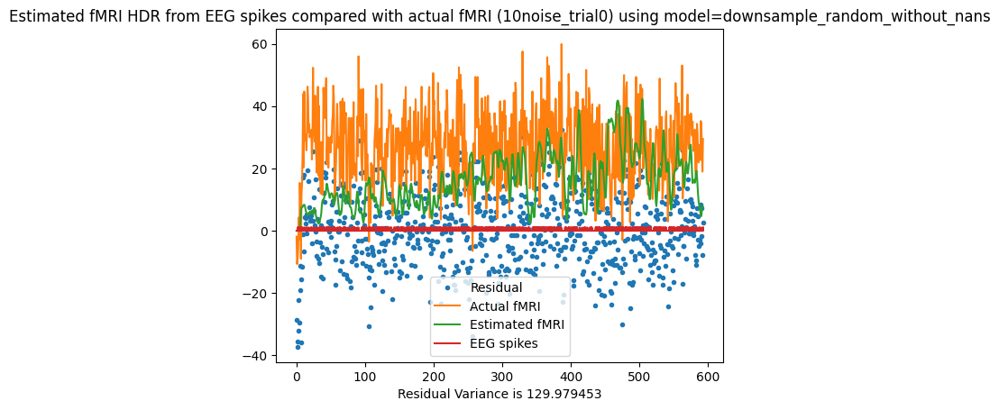

Residual Variance is 129.979453
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 2.28 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 2.08 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 2.04 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 2.06 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.14 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.12 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.16 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.09 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.92 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.99 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.06 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.79 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.70 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.15 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 21.938338882895213; at
   delta   tau  alpha
0    1.0  0.75   1.75


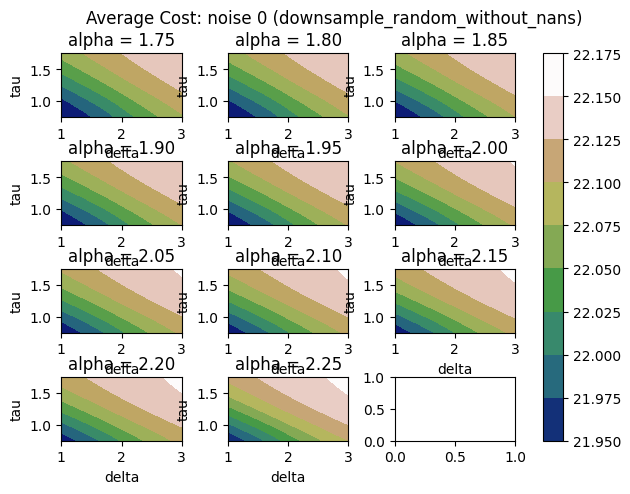

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 22.88982319153334; at
   delta   tau  alpha
0    1.0  0.75   1.75


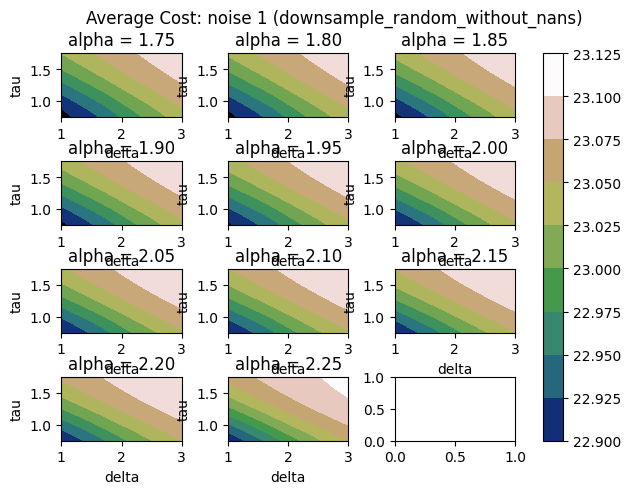

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 38.096507679868864; at
   delta   tau  alpha
0    1.0  0.75   1.75


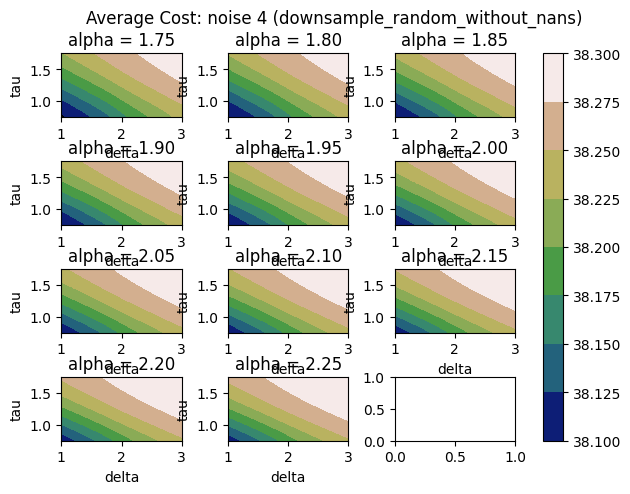

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 70.91873513339573; at
   delta   tau  alpha
0    1.0  0.75   1.75


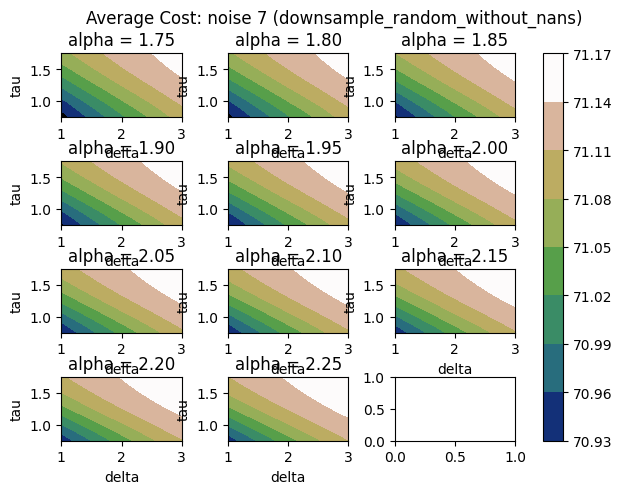

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 121.52624925420334; at
   delta   tau  alpha
0    1.0  0.75   1.75


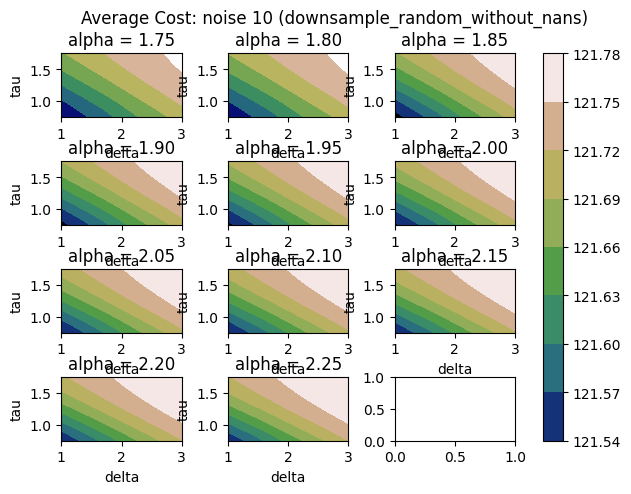

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 190.4233018179359; at
   delta   tau  alpha
0    1.0  0.75   1.75


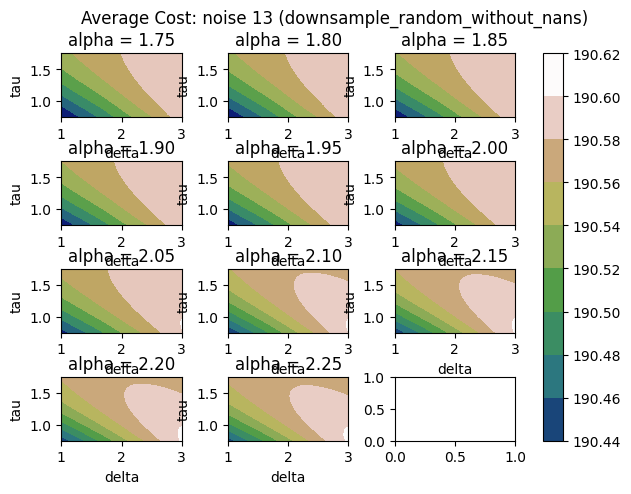

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


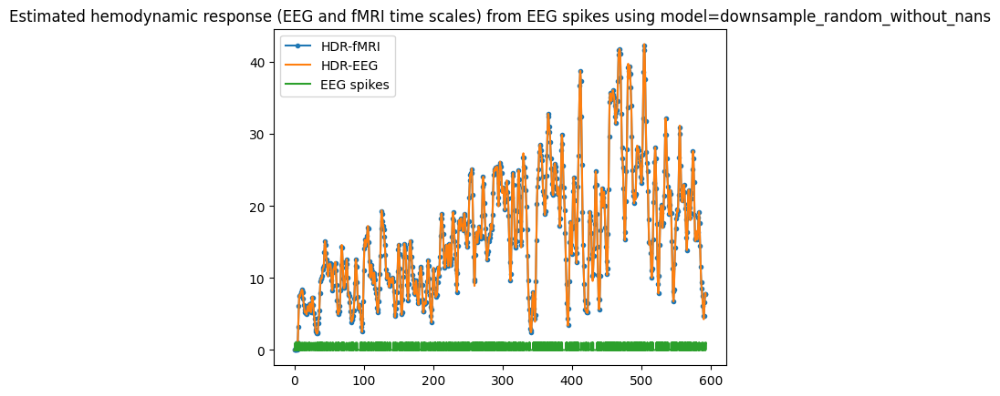

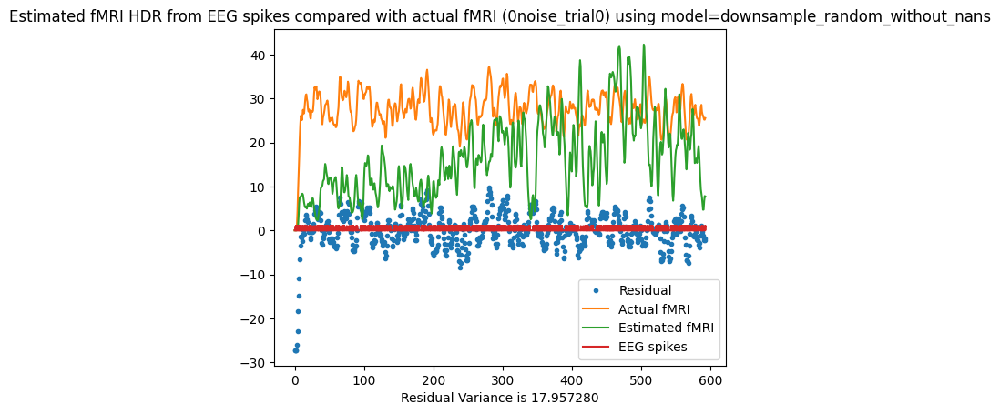

Residual Variance is 17.957280


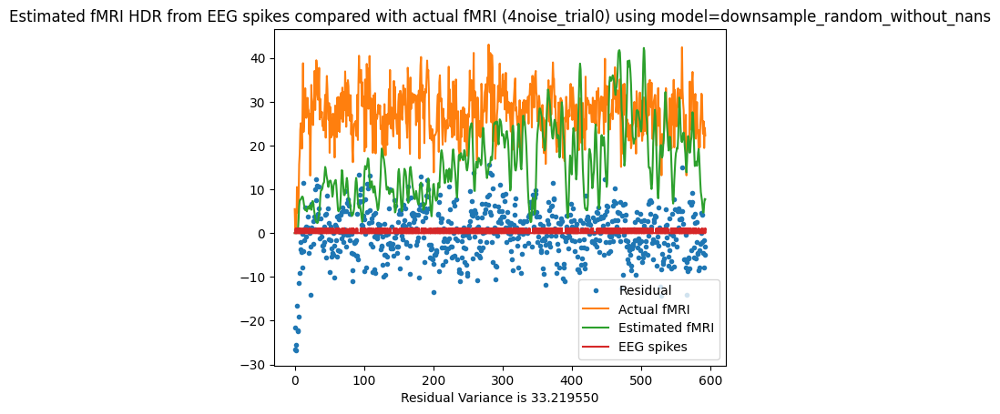

Residual Variance is 33.219550


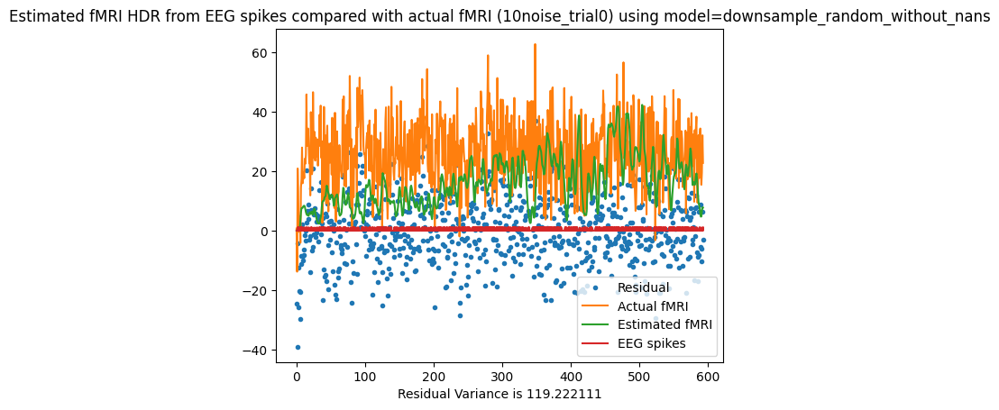

Residual Variance is 119.222111
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 2.13 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 2.42 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 2.42 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 2.63 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.71 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.82 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.90 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.75 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.67 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.72 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.82 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.97 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.94 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.75 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 17.87401138734946; at
      delta   tau  alpha
9470    3.0  1.75   2.25


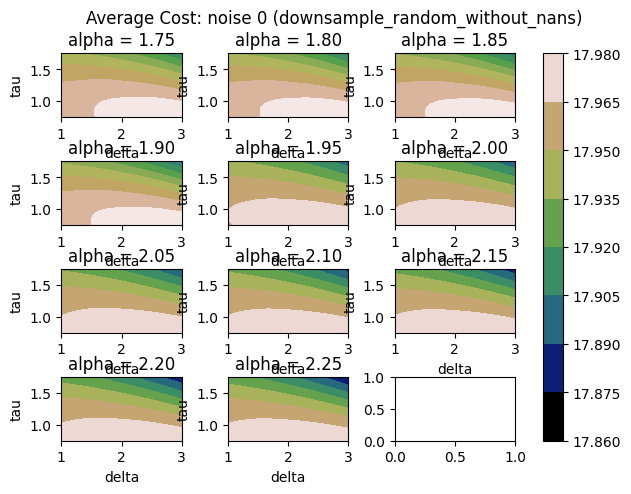

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 18.875526798844497; at
      delta   tau  alpha
9470    3.0  1.75   2.25


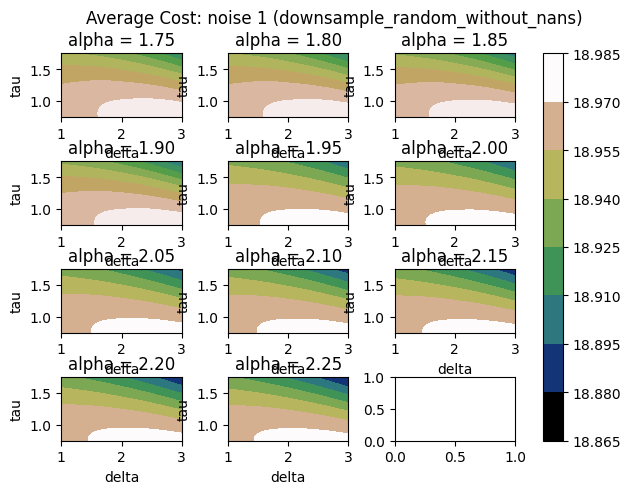

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 34.07677184967508; at
      delta   tau  alpha
9470    3.0  1.75   2.25


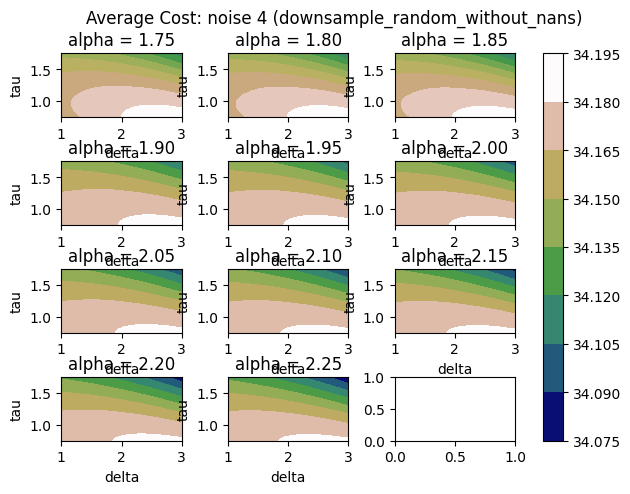

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 66.93656761028451; at
      delta   tau  alpha
9470    3.0  1.75   2.25


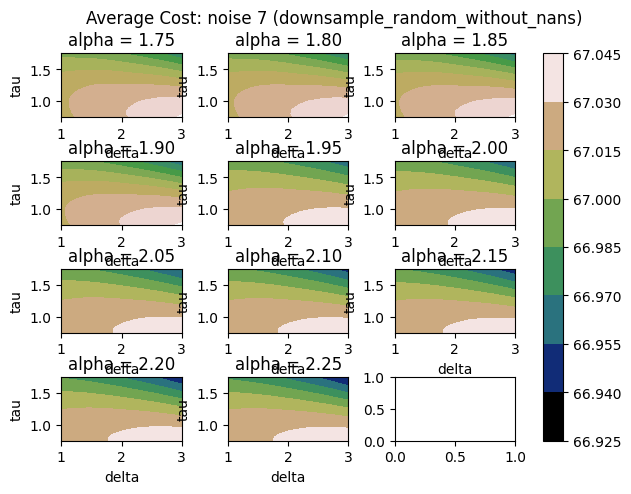

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 117.63730643913668; at
      delta   tau  alpha
9470    3.0  1.75   2.25


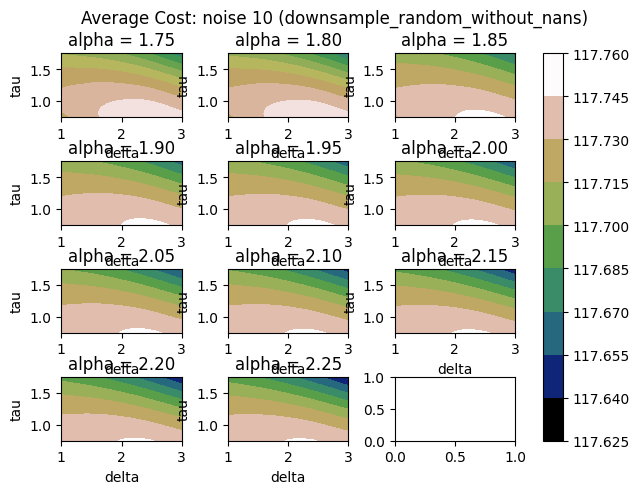

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 187.45901449376527; at
      delta   tau  alpha
9470    3.0  1.75   2.25


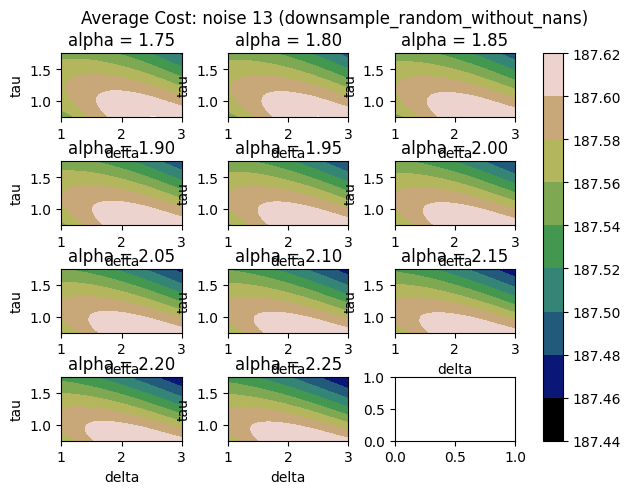

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


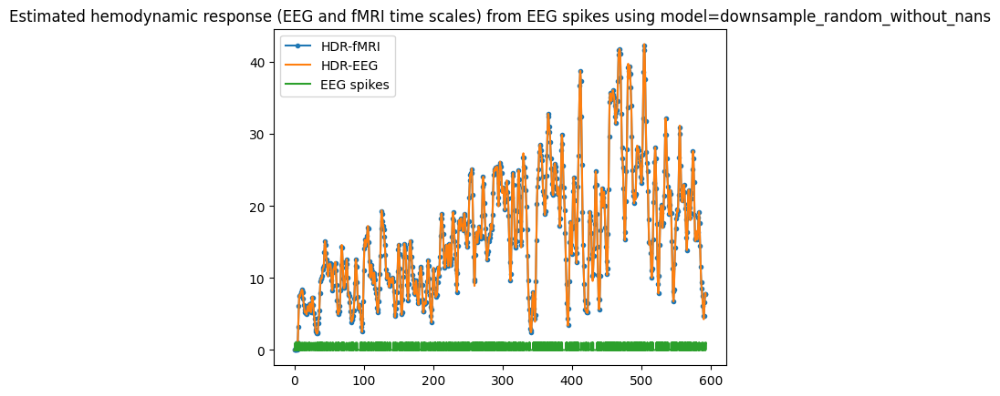

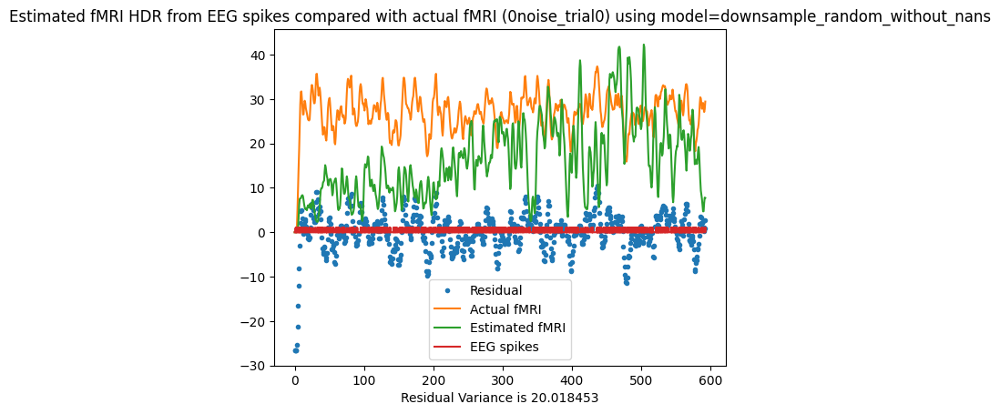

Residual Variance is 20.018453


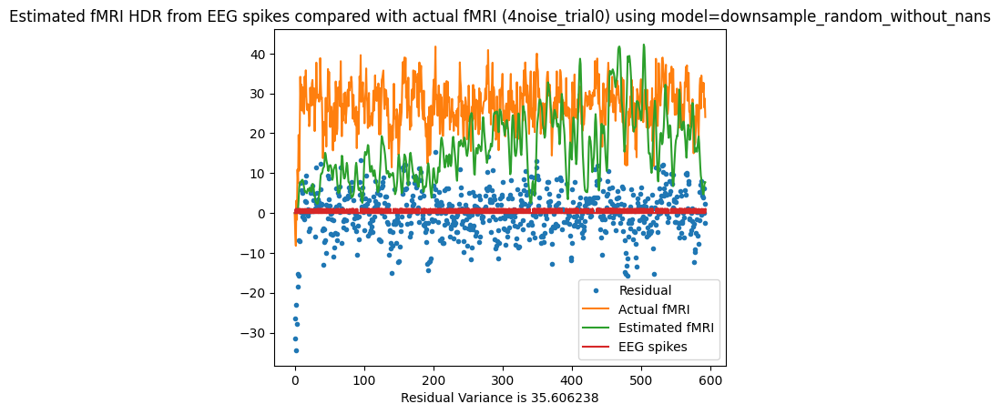

Residual Variance is 35.606238


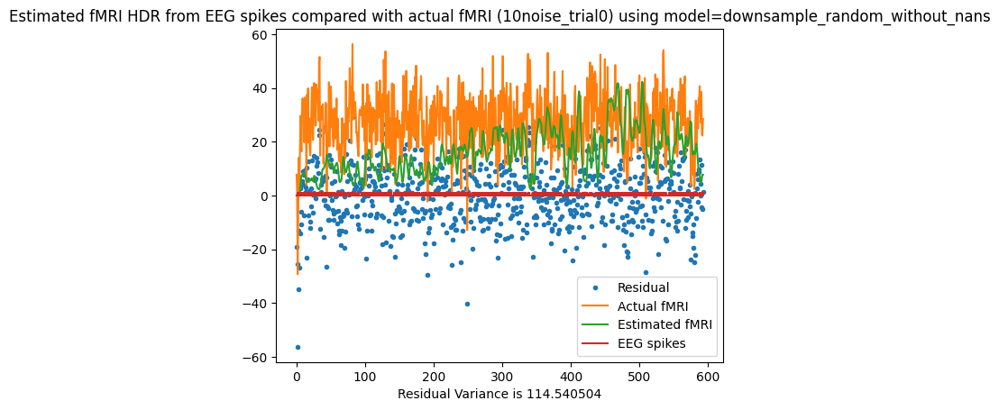

Residual Variance is 114.540504
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 2.26 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 2.01 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 2.42 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 2.26 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.50 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.42 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 3.76 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.70 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.52 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.75 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.71 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.66 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.67 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.44 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 20.002509398985826; at
      delta   tau  alpha
9470    3.0  1.75   2.25


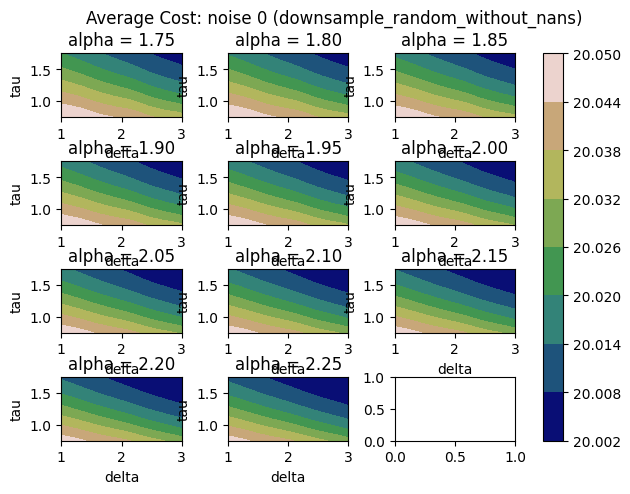

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 21.021529001984717; at
      delta   tau  alpha
9470    3.0  1.75   2.25


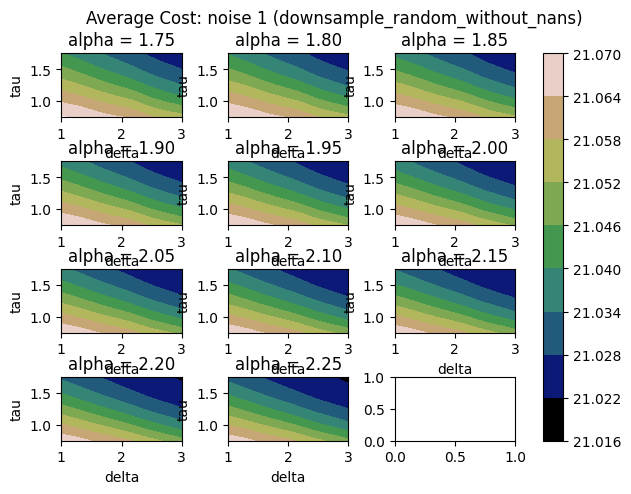

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 36.14173052993189; at
      delta   tau  alpha
7620    2.6  1.75   2.15


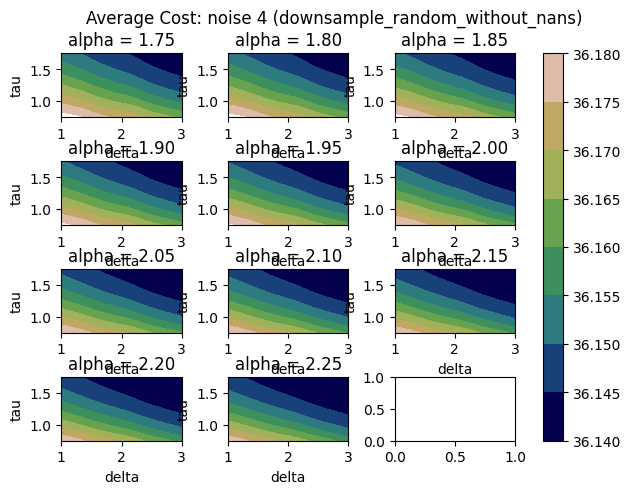

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 68.12821319299773; at
      delta   tau  alpha
9382    3.0  1.35   2.25


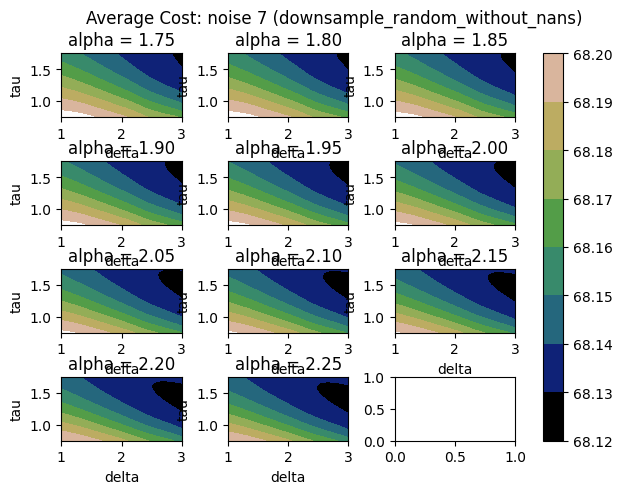

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 119.35919422445211; at
      delta   tau  alpha
9463    3.0  1.75    1.9


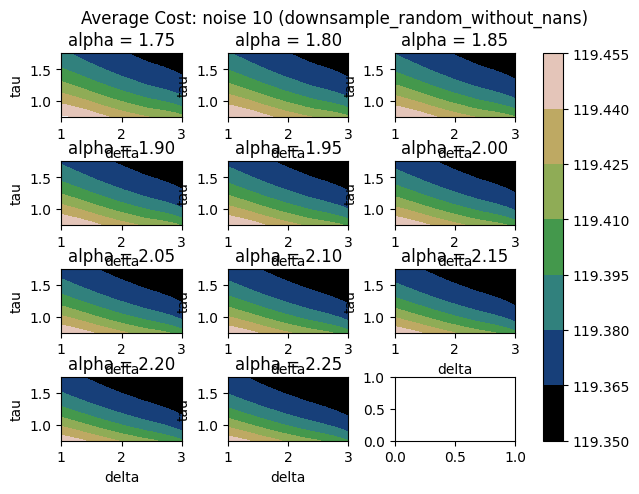

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 188.74849235024237; at
      delta   tau  alpha
9470    3.0  1.75   2.25


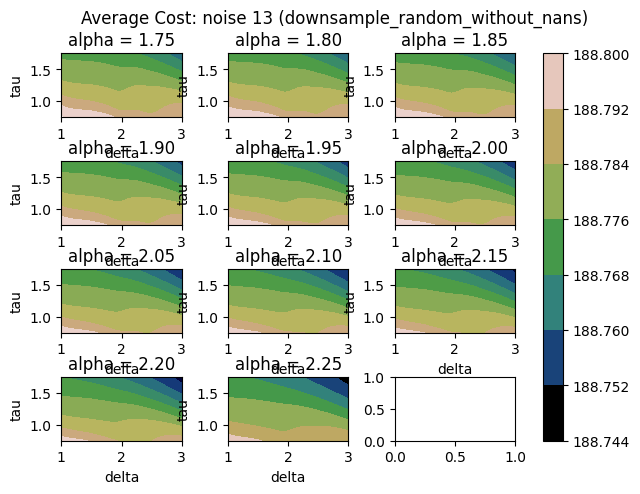

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


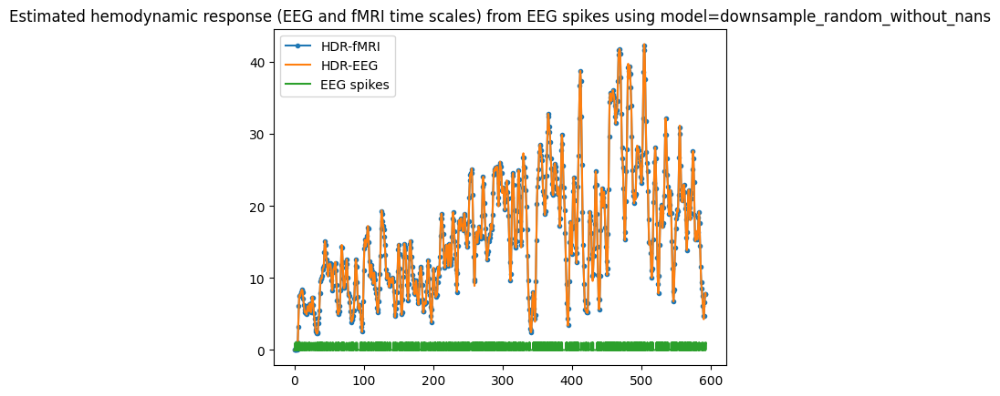

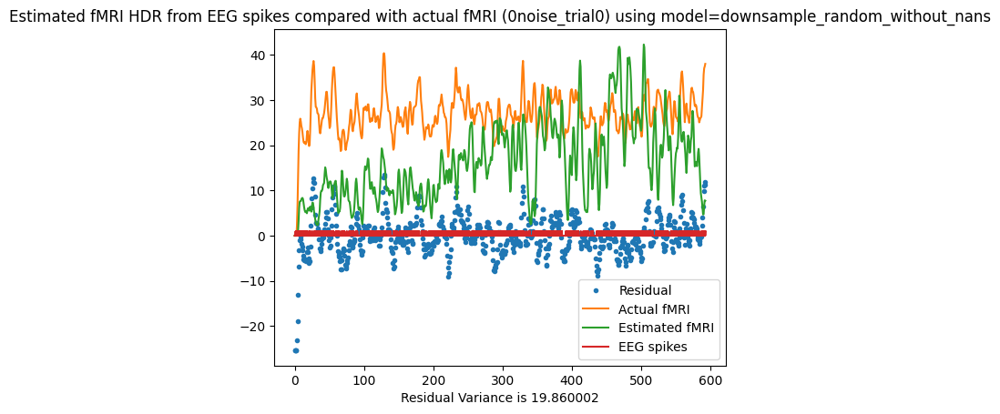

Residual Variance is 19.860002


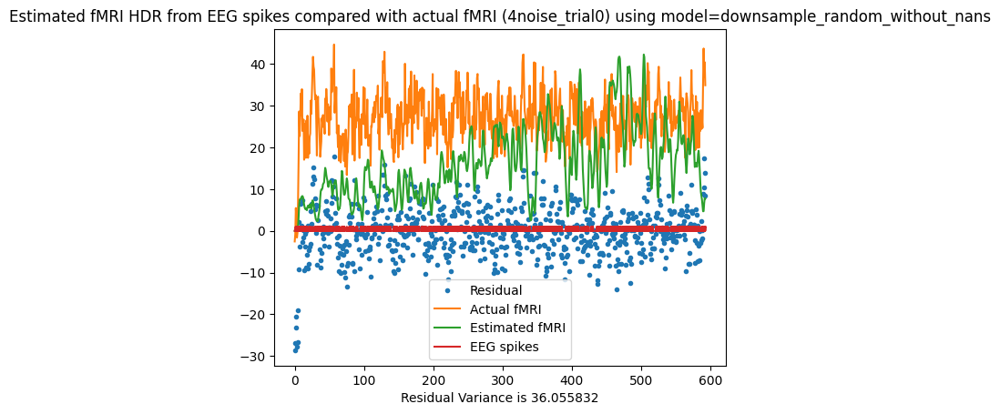

Residual Variance is 36.055832


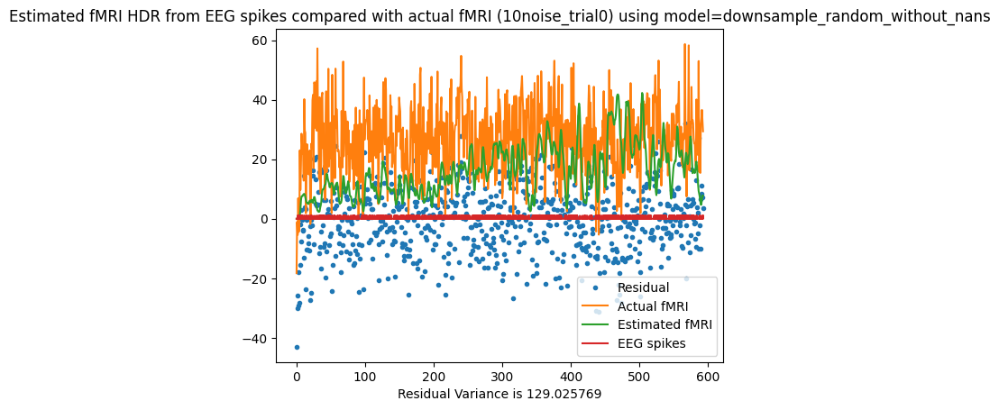

Residual Variance is 129.025769
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 2.26 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 2.03 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 2.74 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 2.50 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.26 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.24 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.23 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.11 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.12 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.00 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.10 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.06 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.03 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.03 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 19.730026399458232; at
      delta   tau  alpha
7622    2.6  1.75   2.25


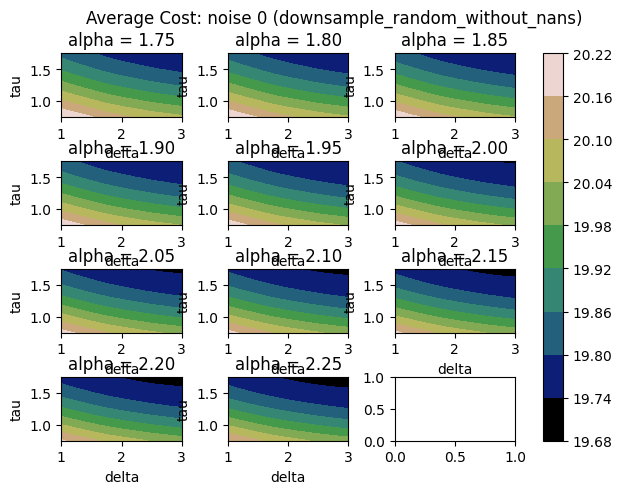

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 20.775495742685457; at
      delta   tau  alpha
7622    2.6  1.75   2.25


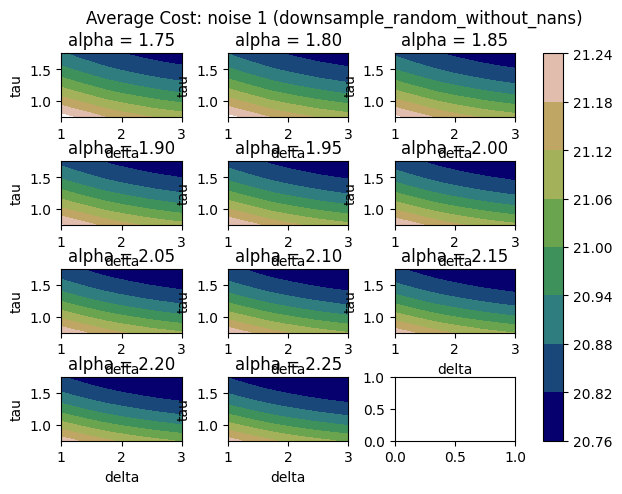

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 35.884760200788875; at
      delta   tau  alpha
7160    2.5  1.75   2.25


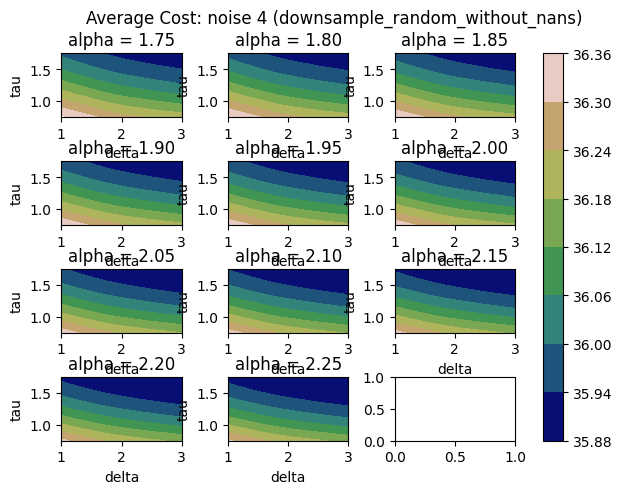

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 68.98227733287243; at
      delta   tau  alpha
6698    2.4  1.75   2.25


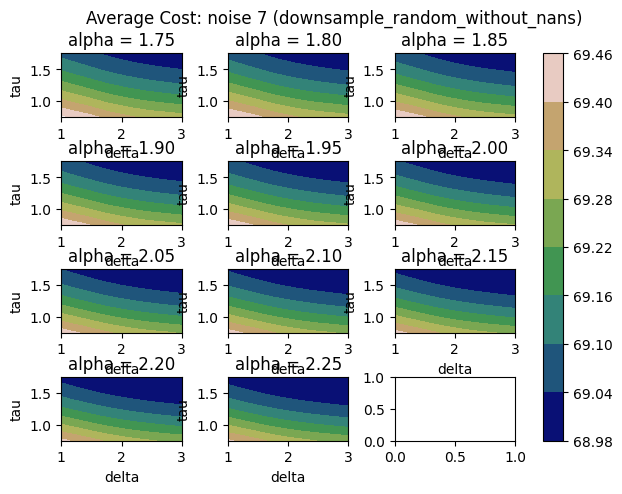

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 121.2449217742953; at
      delta   tau  alpha
9470    3.0  1.75   2.25


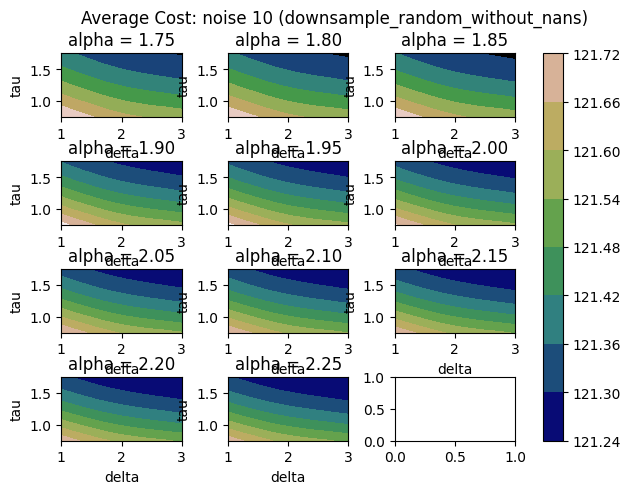

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 188.34035733230823; at
      delta   tau  alpha
6005   2.25  1.75   2.25


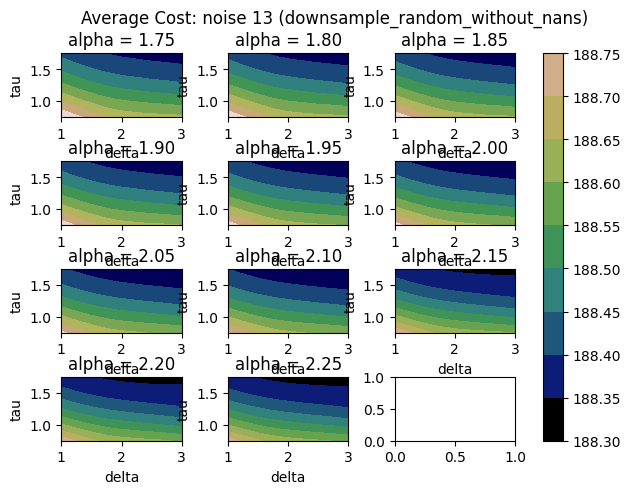

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


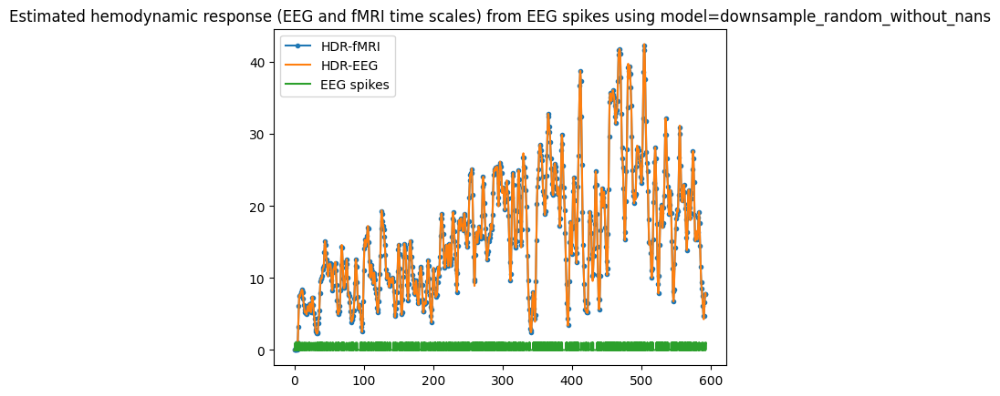

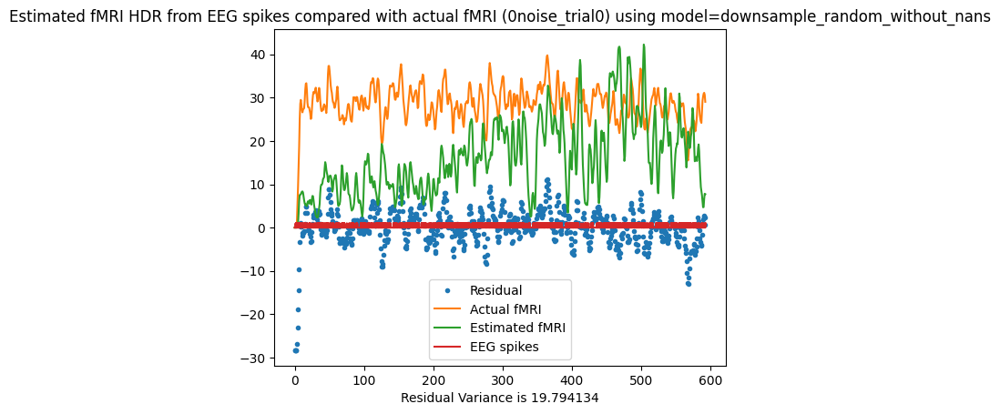

Residual Variance is 19.794134


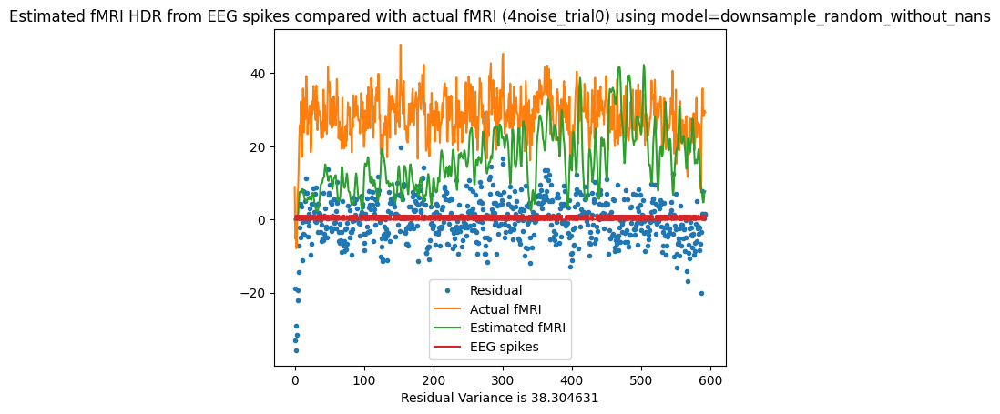

Residual Variance is 38.304631


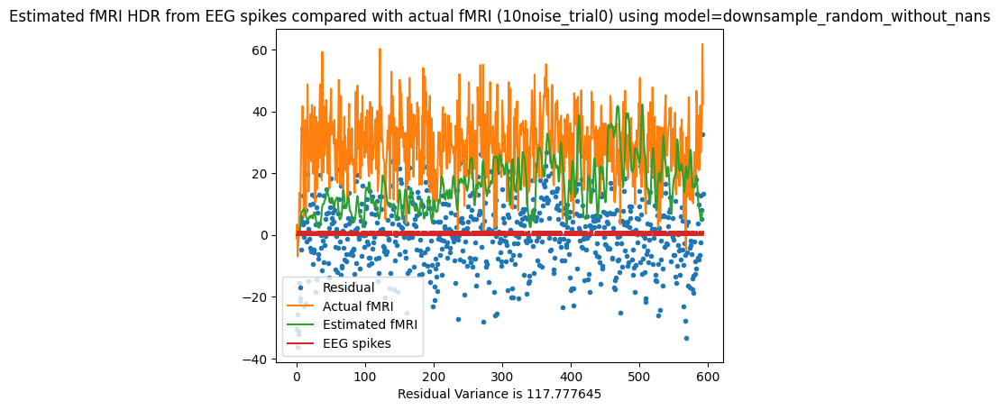

Residual Variance is 117.777645
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.90 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 2.01 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 2.12 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 2.53 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.21 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.27 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.39 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.18 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.30 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.26 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.24 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.31 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.28 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.38 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 19.697747403162104; at
      delta   tau  alpha
9470    3.0  1.75   2.25


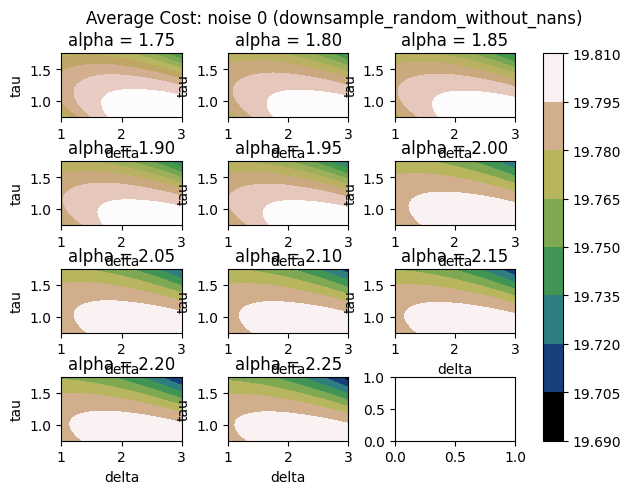

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 20.722231650744654; at
      delta   tau  alpha
9470    3.0  1.75   2.25


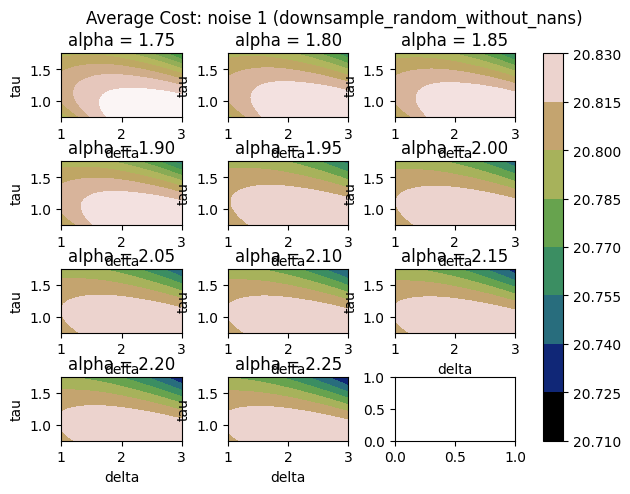

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 35.54831403270124; at
      delta   tau  alpha
9470    3.0  1.75   2.25


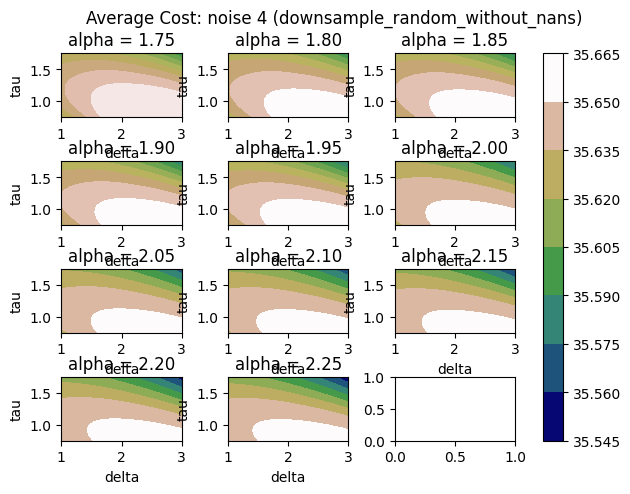

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 68.67879409179407; at
      delta   tau  alpha
9470    3.0  1.75   2.25


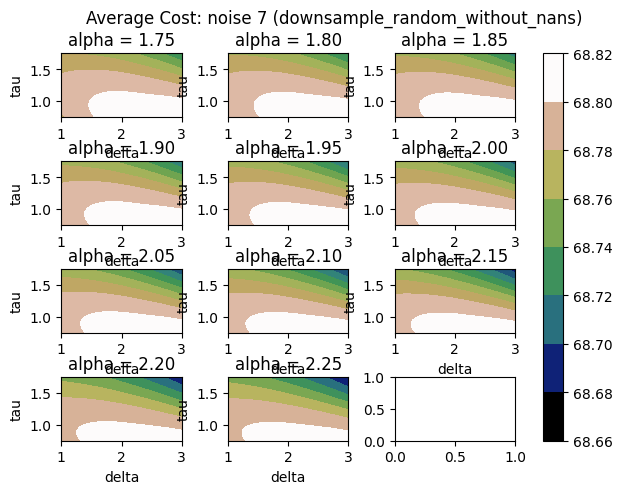

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 119.73226443804143; at
      delta   tau  alpha
9470    3.0  1.75   2.25


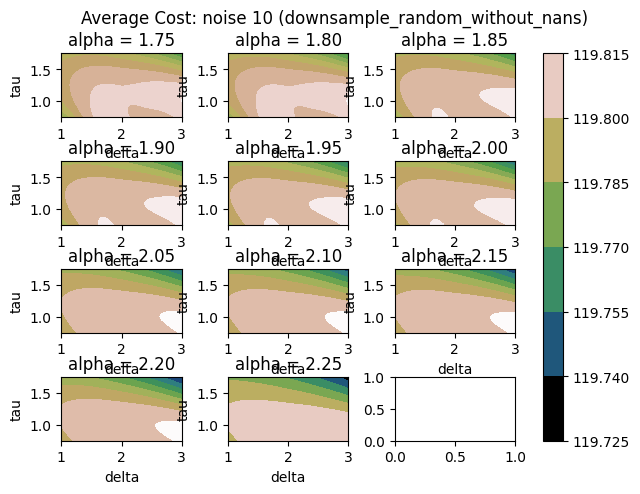

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 188.9609843138377; at
   delta   tau  alpha
0    1.0  0.75   1.75


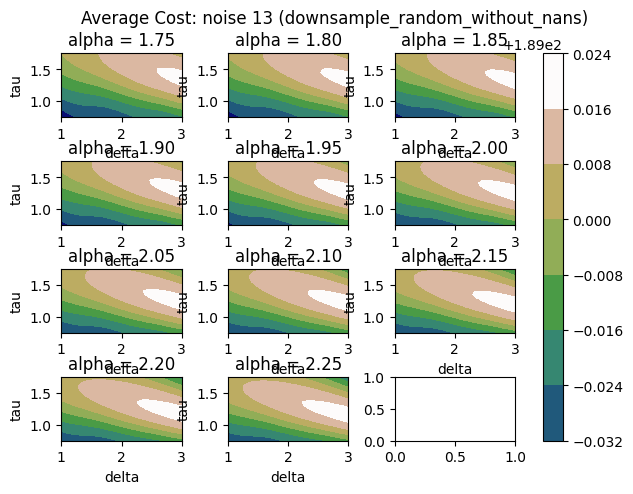

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


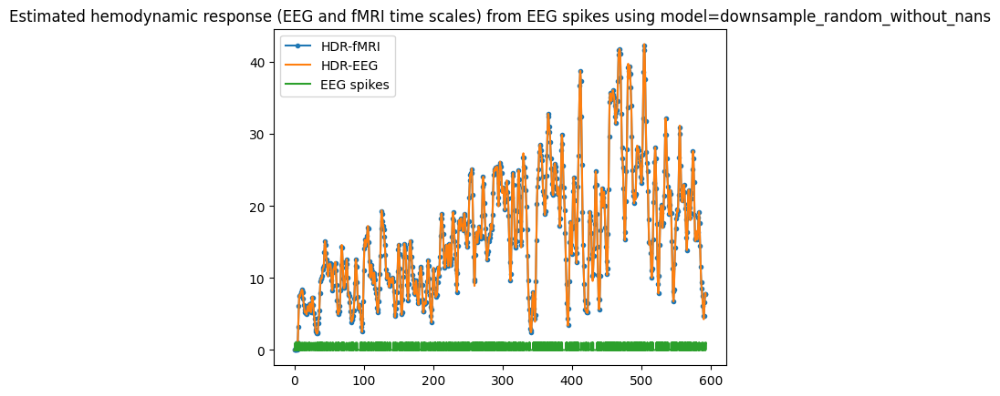

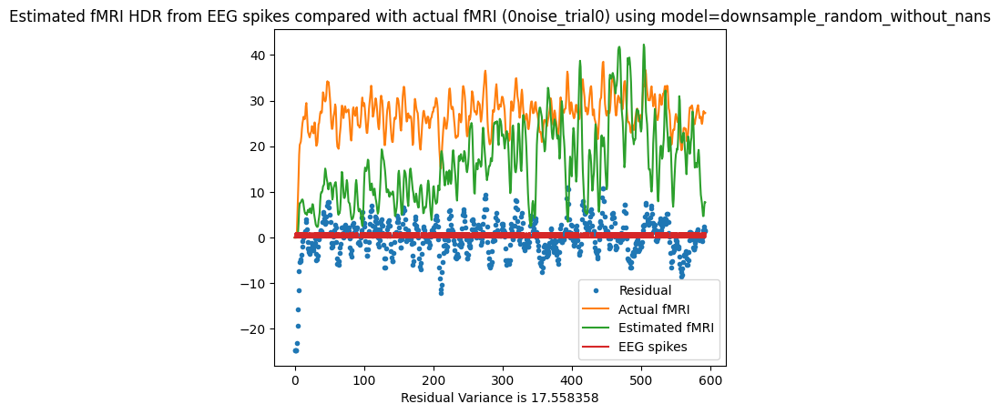

Residual Variance is 17.558358


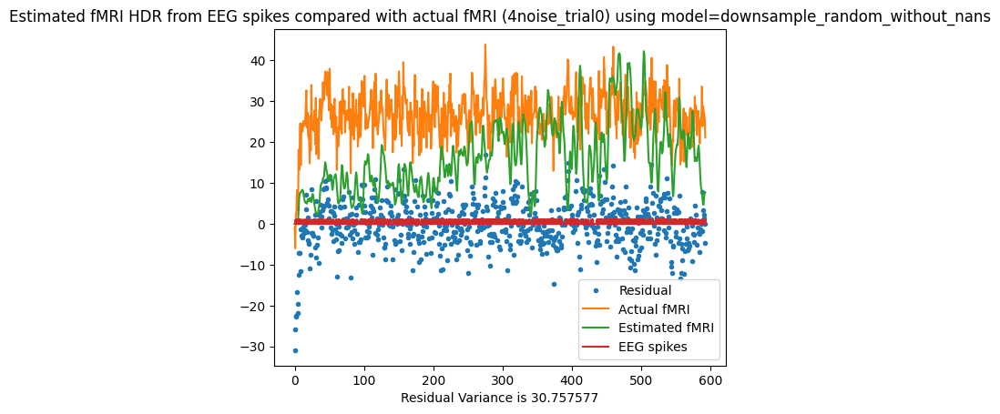

Residual Variance is 30.757577


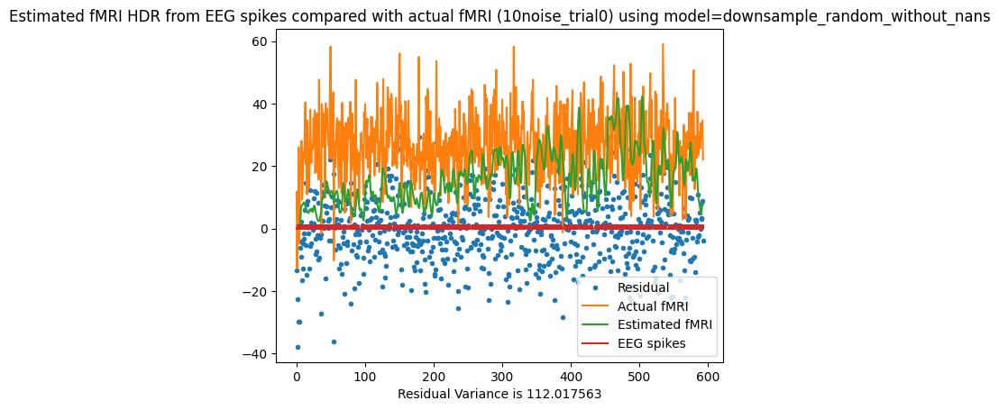

Residual Variance is 112.017563
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.81 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.90 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 2.03 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 2.14 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.15 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.14 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.17 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.19 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.22 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.20 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.30 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.23 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.18 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.15 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 17.316371380042156; at
     delta   tau  alpha
230    1.0  1.75   2.25


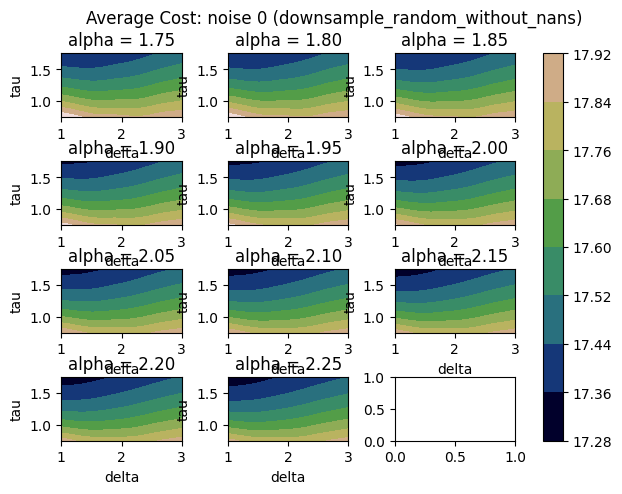

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 18.296951965887835; at
     delta   tau  alpha
230    1.0  1.75   2.25


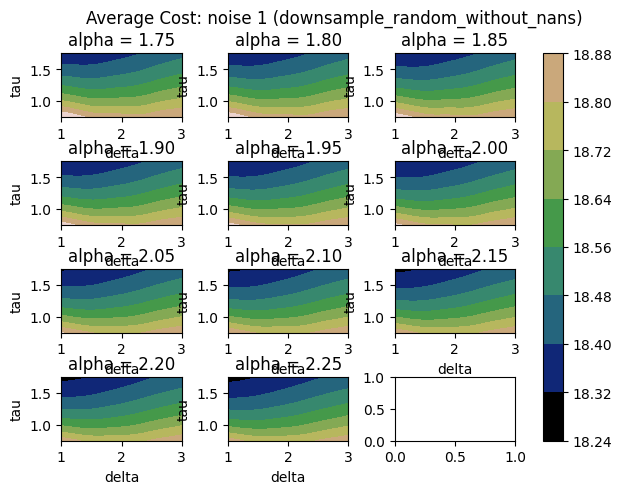

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 33.350933246213245; at
     delta   tau  alpha
230    1.0  1.75   2.25


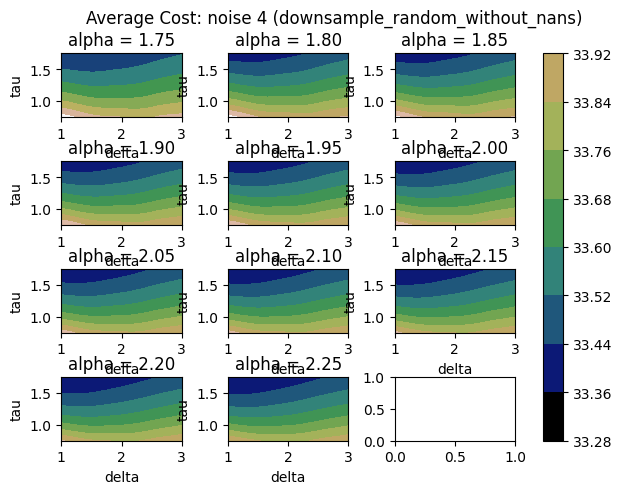

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 66.945437921365; at
     delta   tau  alpha
692    1.1  1.75   2.25


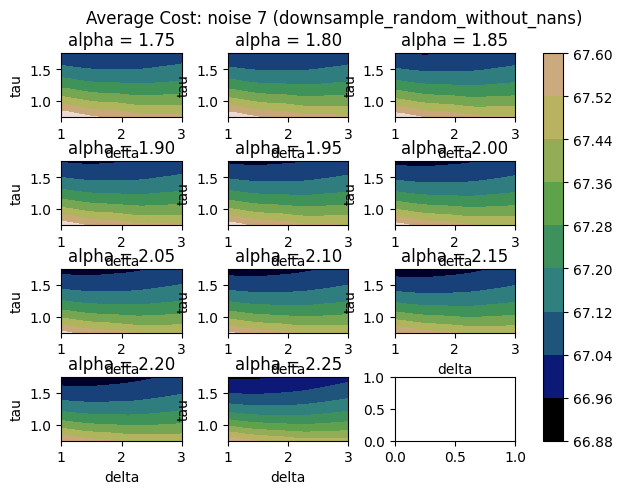

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 117.2308640569231; at
     delta   tau  alpha
230    1.0  1.75   2.25


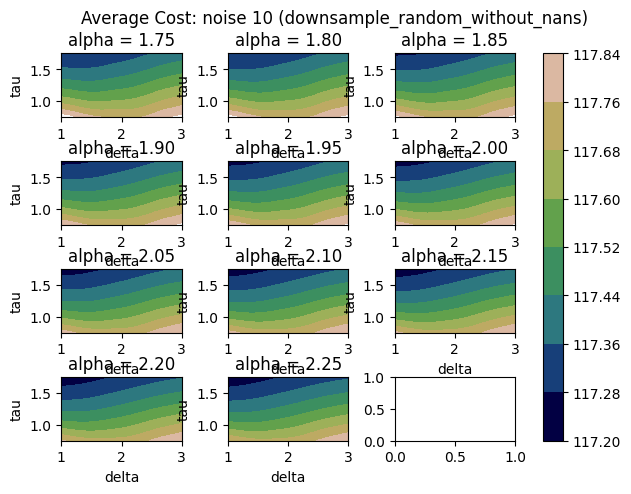

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 184.99030710124688; at
     delta   tau  alpha
230    1.0  1.75   2.25


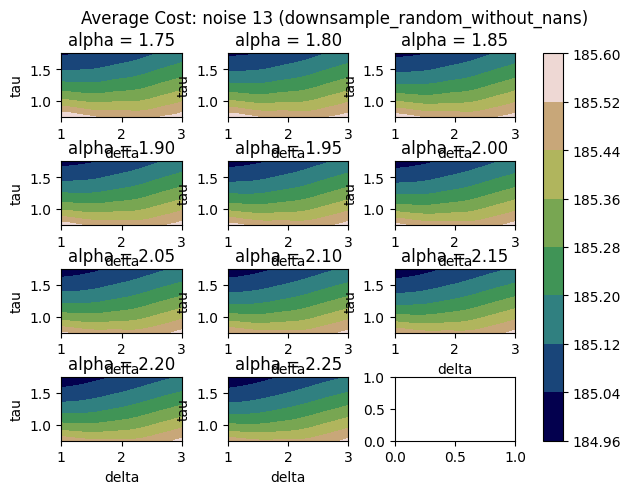

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


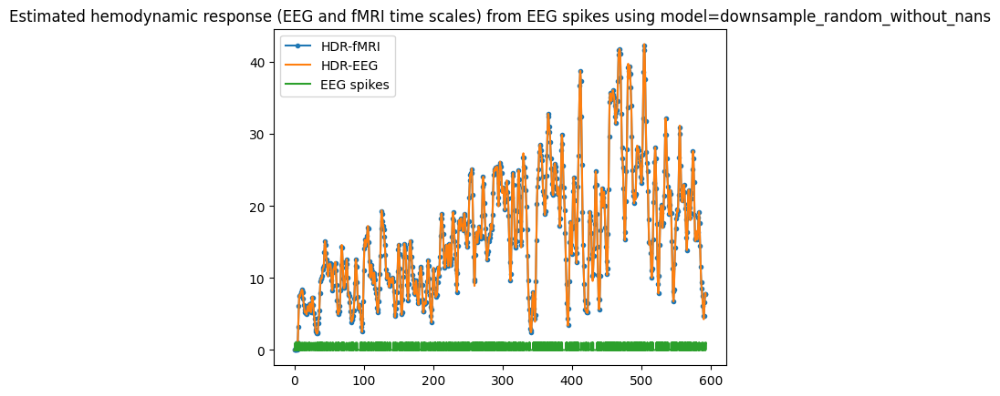

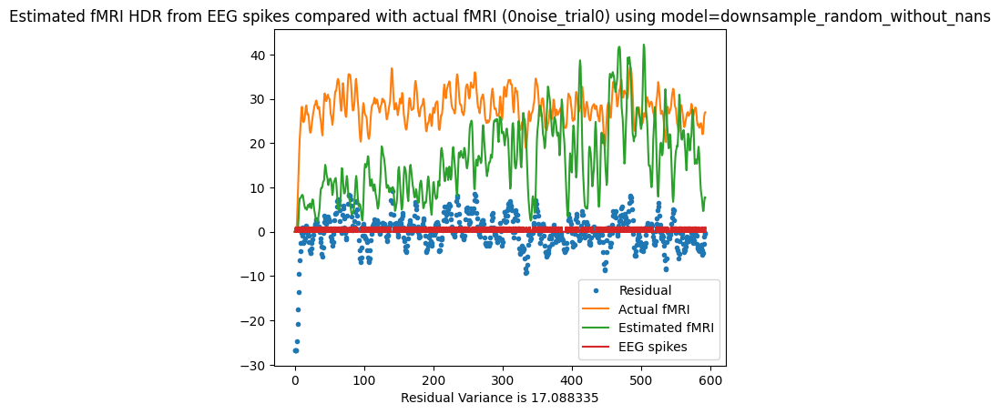

Residual Variance is 17.088335


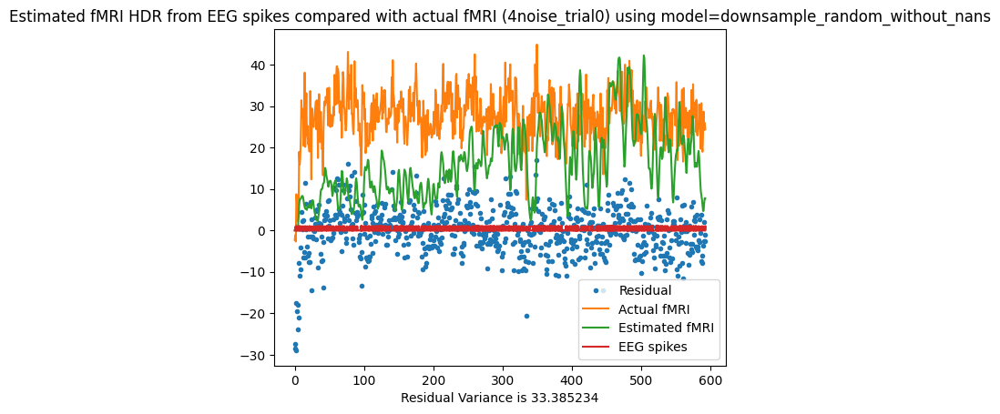

Residual Variance is 33.385234


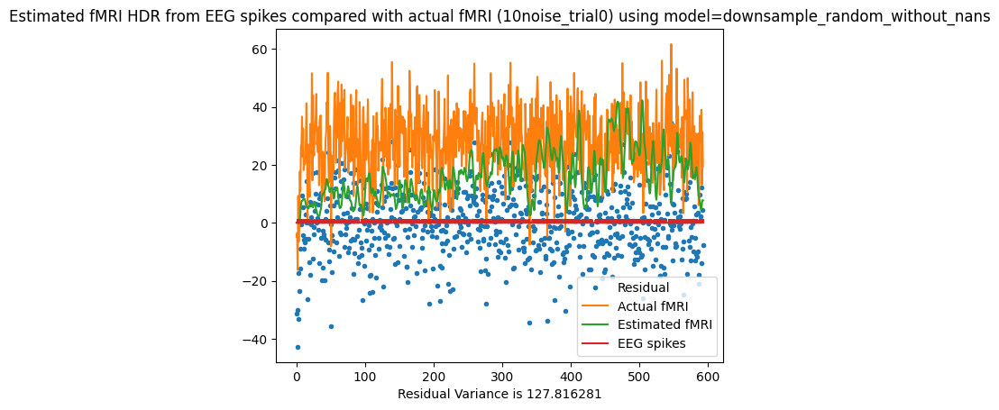

Residual Variance is 127.816281
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 2.03 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 2.35 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 2.27 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 2.28 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.26 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.53 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.18 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.27 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.53 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 3.34 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.37 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 3.17 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.54 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.62 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 16.805592879701972; at
      delta   tau  alpha
9470    3.0  1.75   2.25


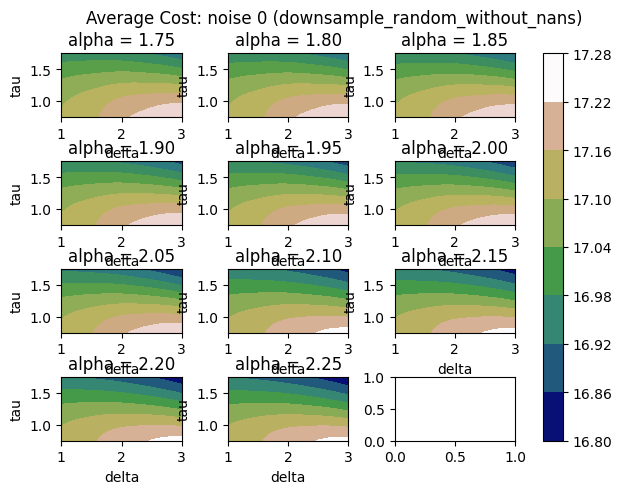

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 17.838591358042983; at
      delta   tau  alpha
9470    3.0  1.75   2.25


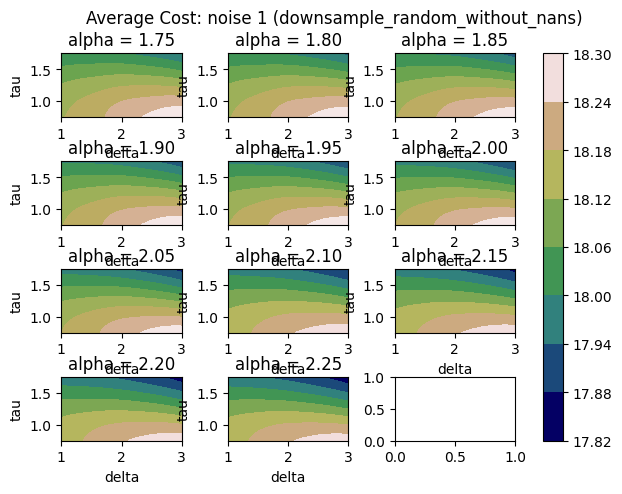

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 32.81692185538165; at
      delta   tau  alpha
9470    3.0  1.75   2.25


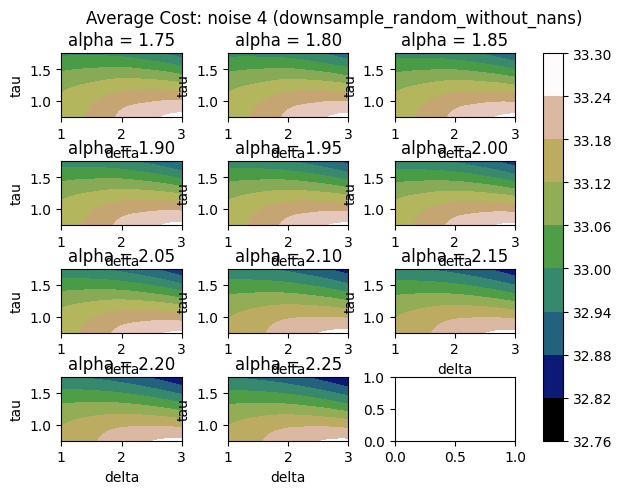

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 65.60921382703611; at
      delta   tau  alpha
9470    3.0  1.75   2.25


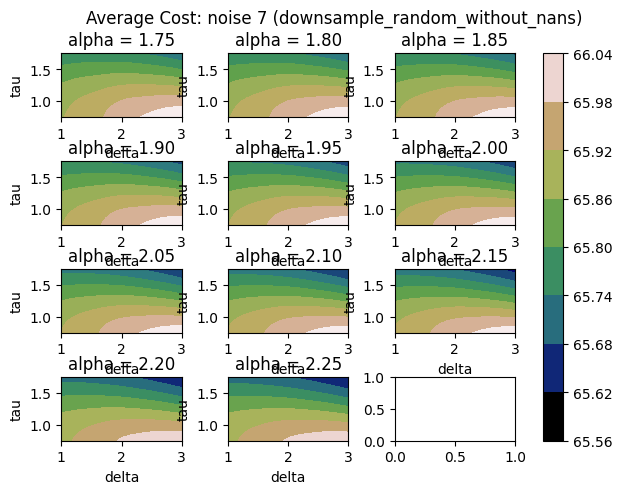

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 117.01192565315458; at
      delta   tau  alpha
9470    3.0  1.75   2.25


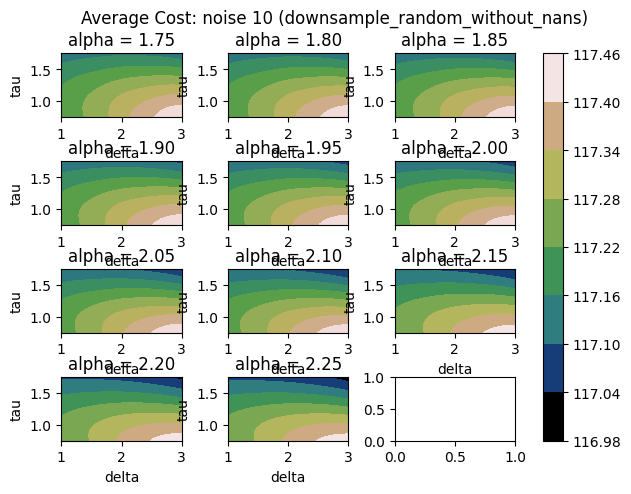

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 186.33979462920786; at
      delta   tau  alpha
9470    3.0  1.75   2.25


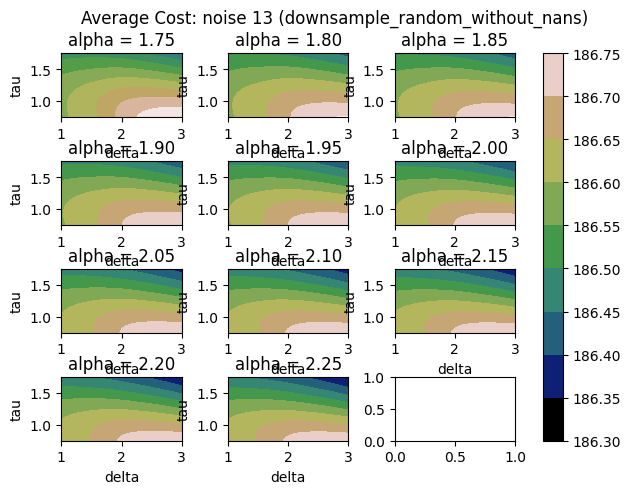

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


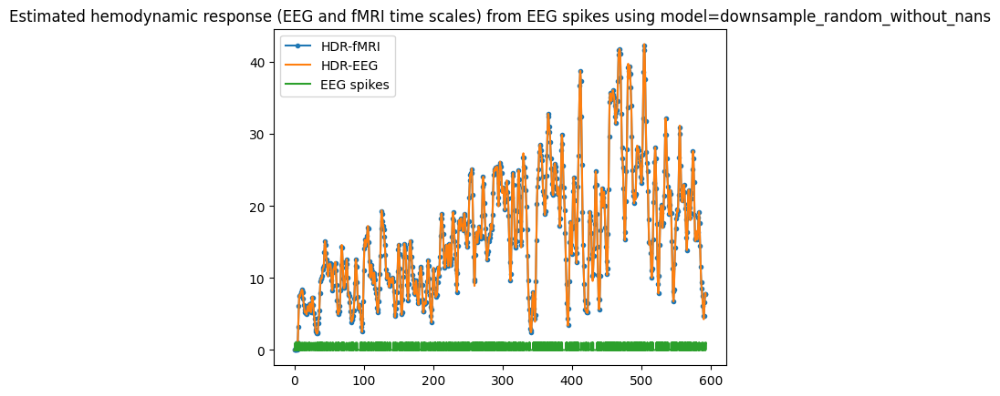

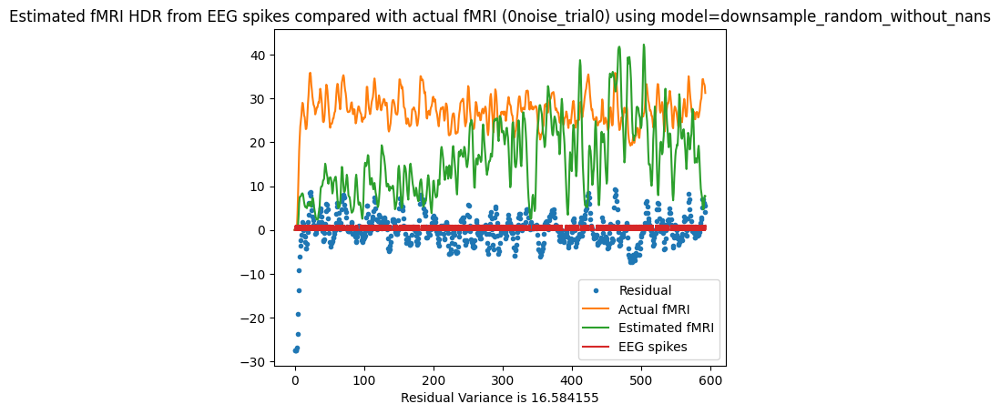

Residual Variance is 16.584155


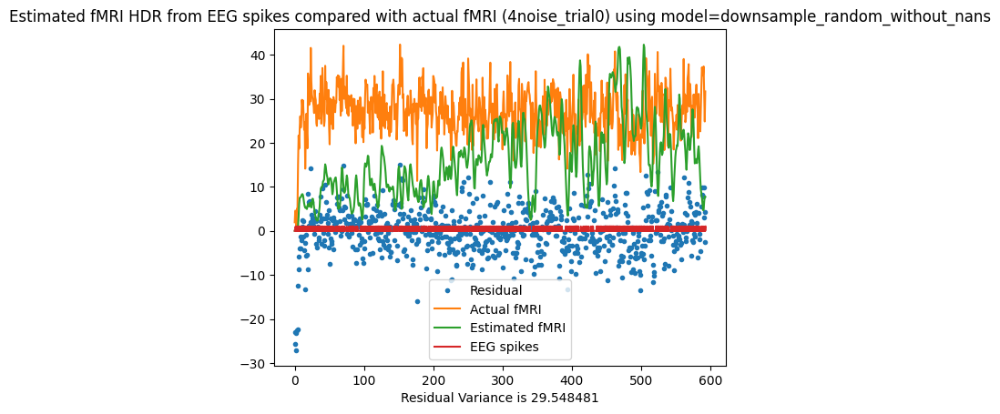

Residual Variance is 29.548481


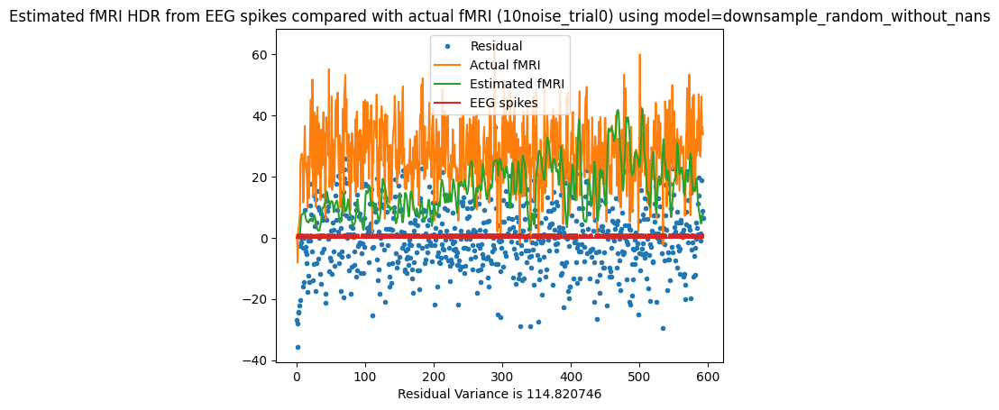

Residual Variance is 114.820746
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 2.31 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.79 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.93 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.96 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.09 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.09 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.41 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.11 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.08 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.29 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 3.16 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.55 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.46 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.29 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 16.48744834242475; at
   delta   tau  alpha
0    1.0  0.75   1.75


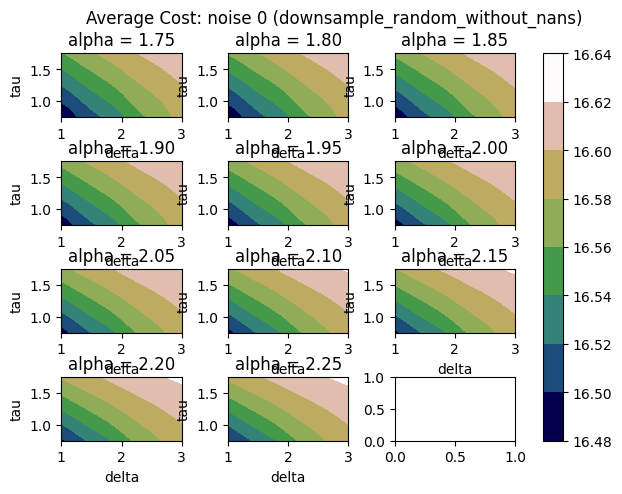

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 17.49137599927848; at
   delta   tau  alpha
0    1.0  0.75   1.75


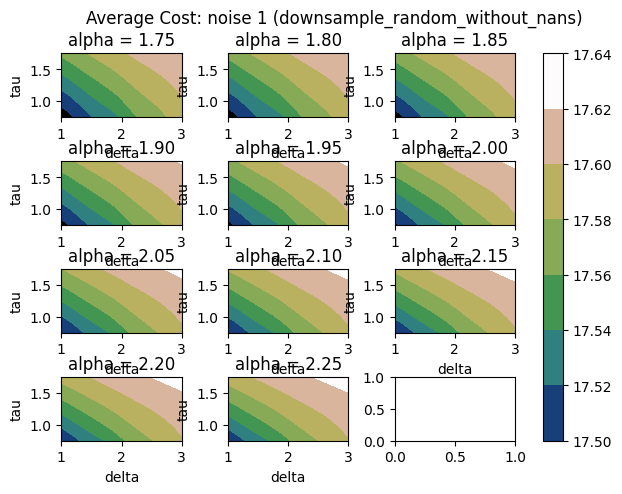

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 32.511911410908645; at
   delta   tau  alpha
0    1.0  0.75   1.75


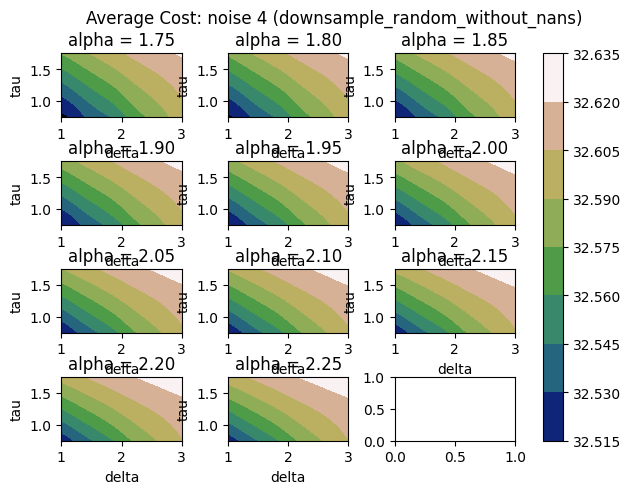

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 65.72703931025147; at
   delta   tau  alpha
0    1.0  0.75   1.75


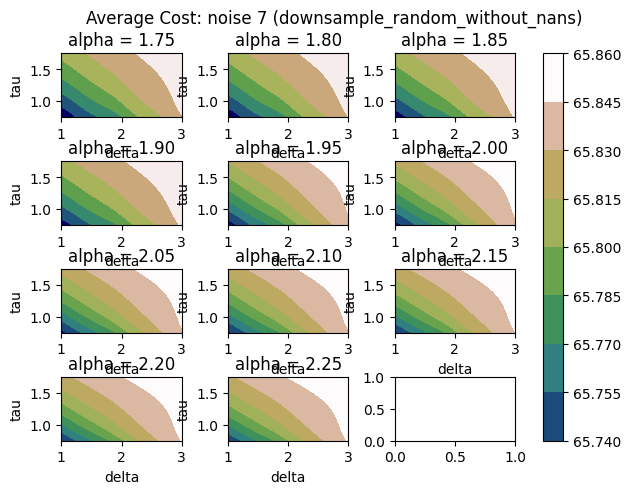

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 116.42260108503582; at
   delta   tau  alpha
0    1.0  0.75   1.75


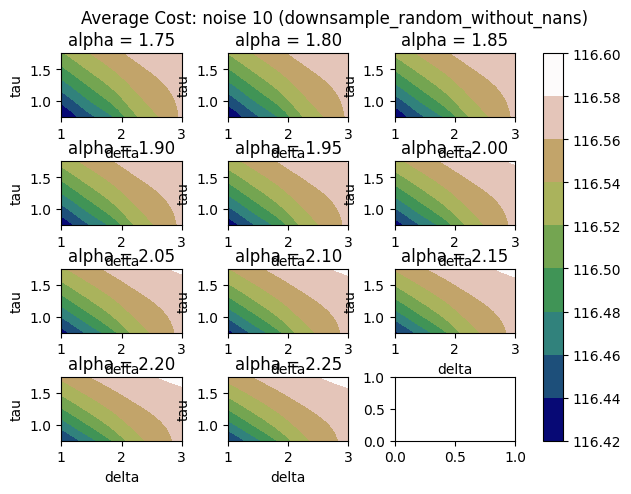

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 186.404334863881; at
   delta   tau  alpha
0    1.0  0.75   1.75


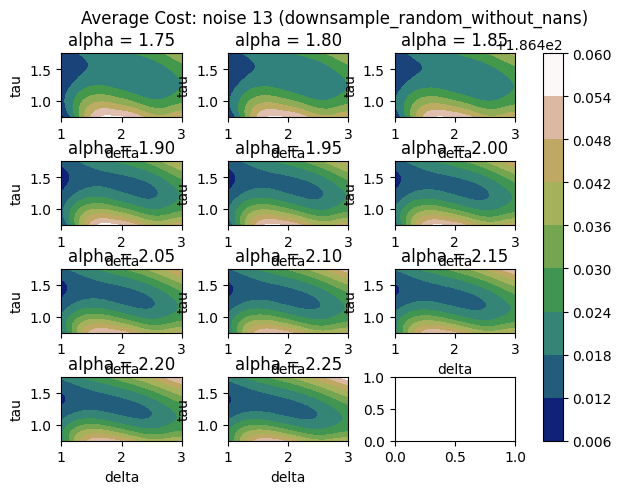

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


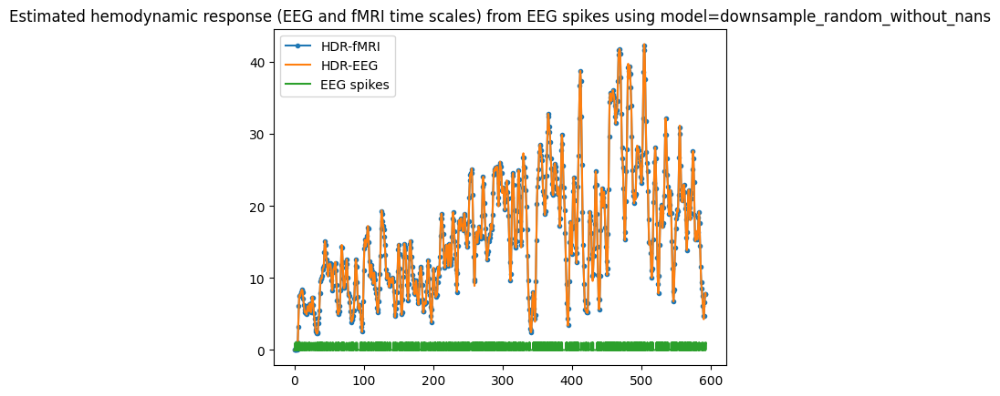

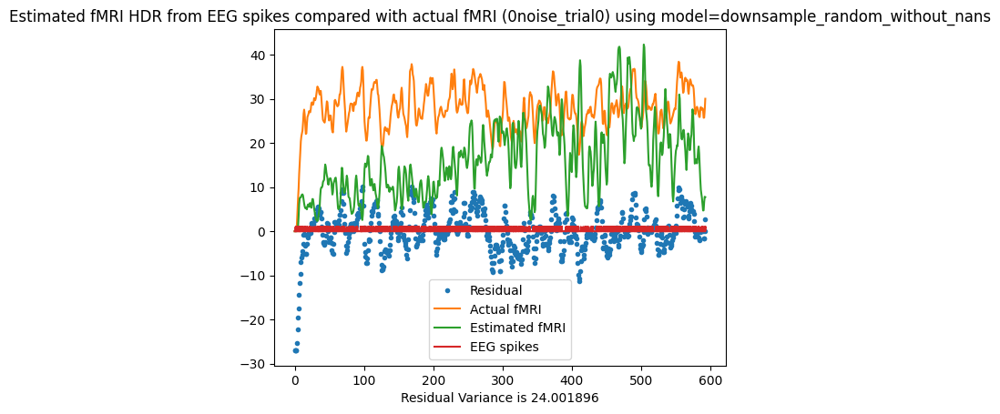

Residual Variance is 24.001896


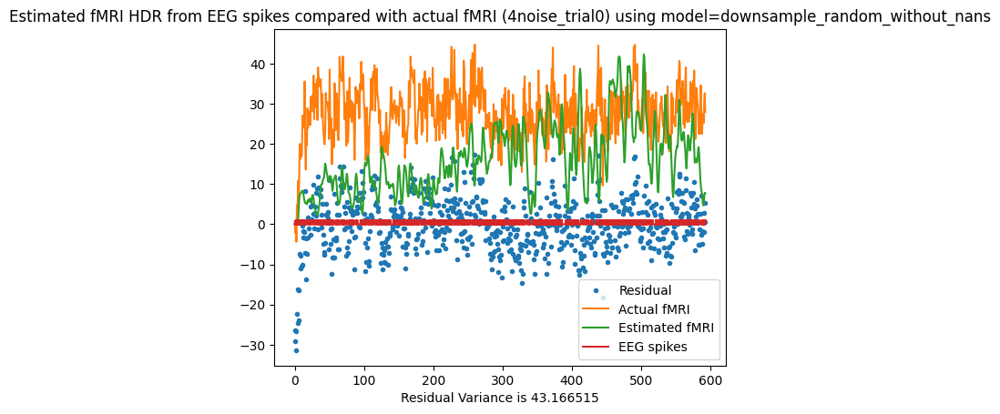

Residual Variance is 43.166515


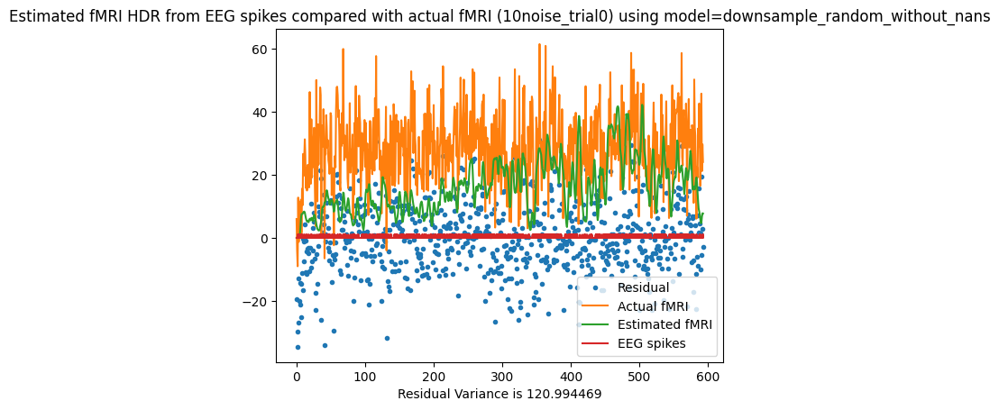

Residual Variance is 120.994469
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.66 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.77 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.93 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 2.07 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.06 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.12 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.13 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.14 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.11 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.18 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.17 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.13 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.11 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.15 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 23.652052689340962; at
      delta   tau  alpha
9470    3.0  1.75   2.25


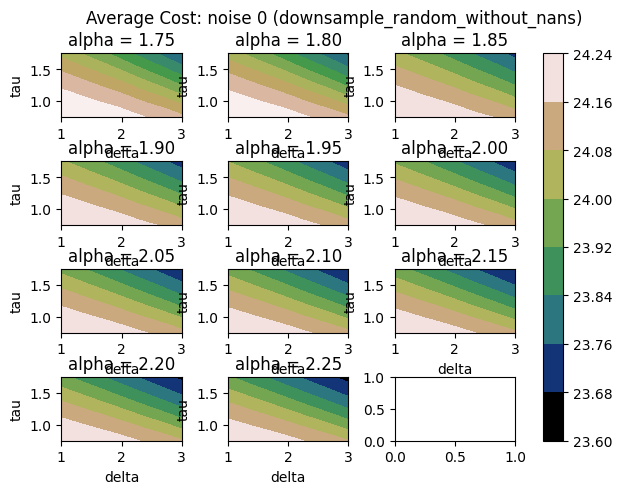

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 24.608510692755335; at
      delta   tau  alpha
9470    3.0  1.75   2.25


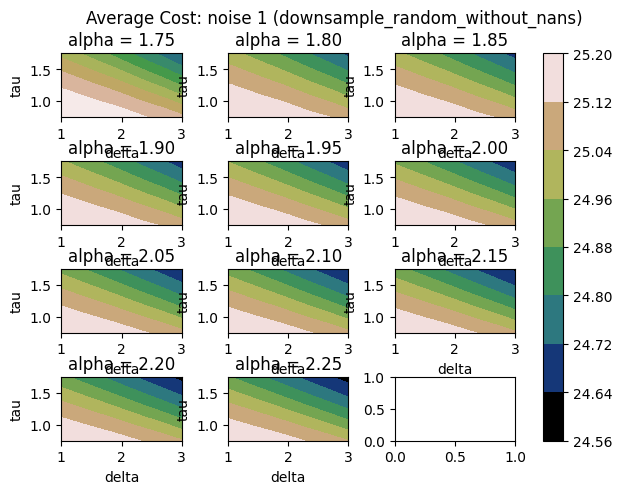

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 39.57141552496498; at
      delta   tau  alpha
9470    3.0  1.75   2.25


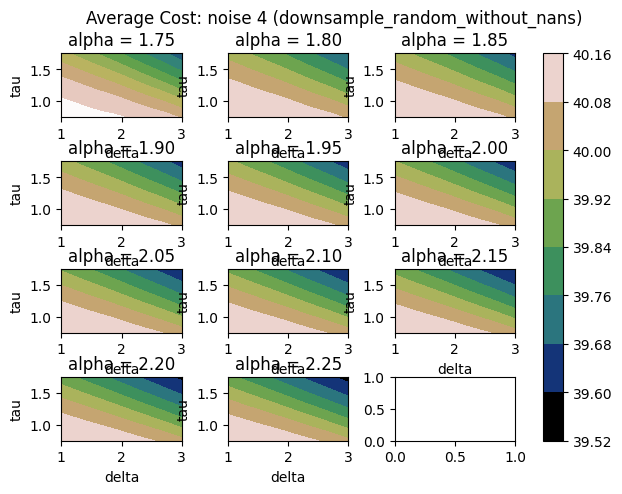

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 72.71722644415765; at
      delta   tau  alpha
9470    3.0  1.75   2.25


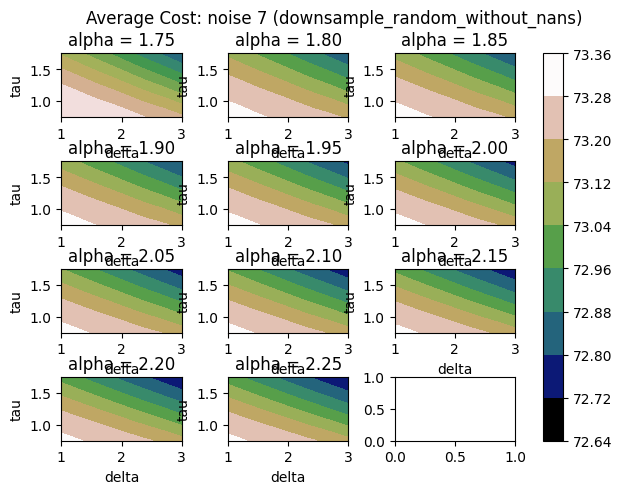

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 123.76680293801948; at
      delta   tau  alpha
9470    3.0  1.75   2.25


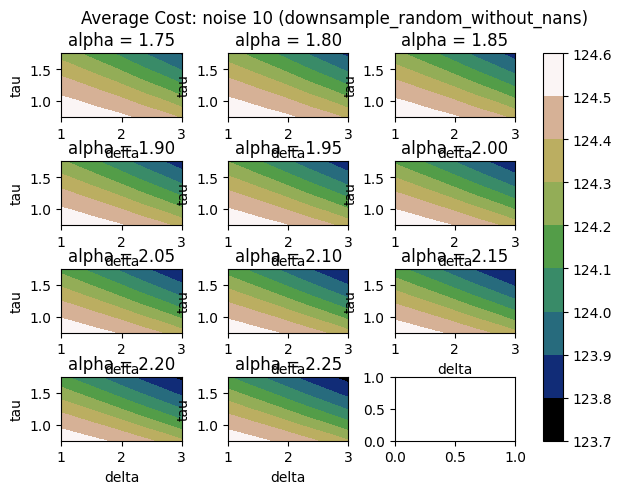

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 192.552975164626; at
      delta   tau  alpha
9470    3.0  1.75   2.25


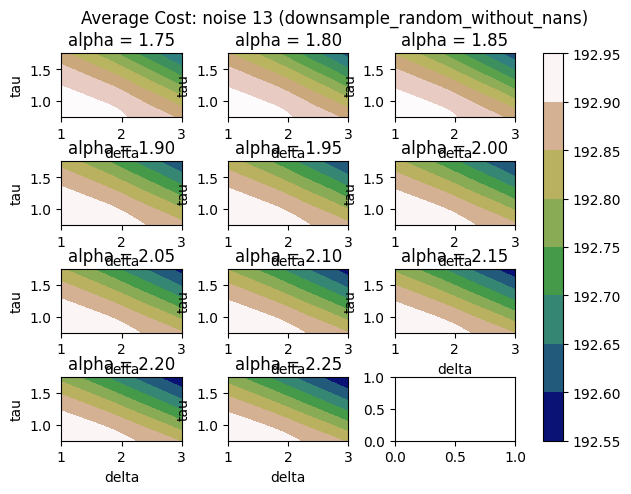

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


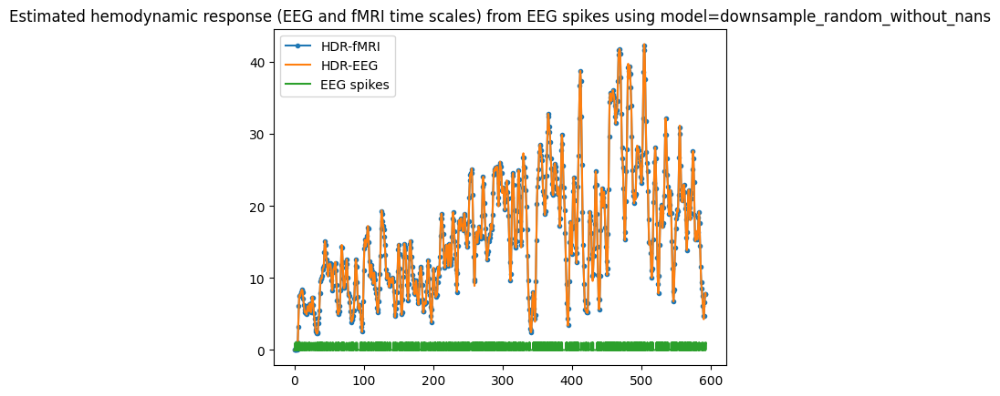

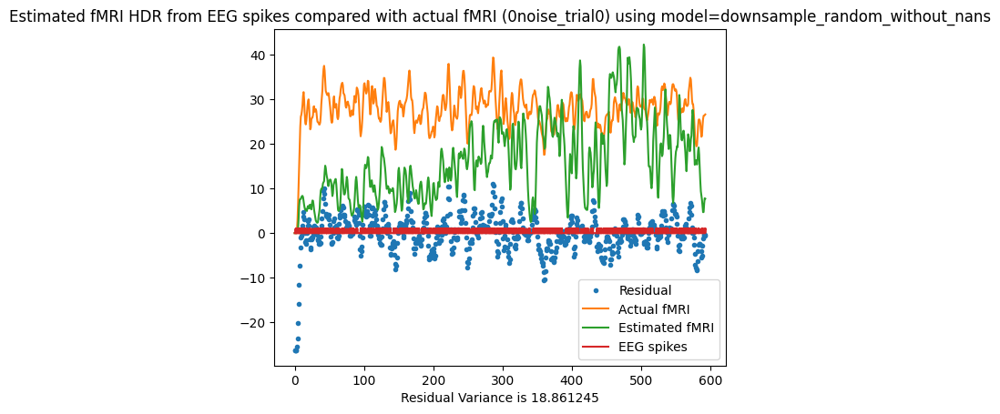

Residual Variance is 18.861245


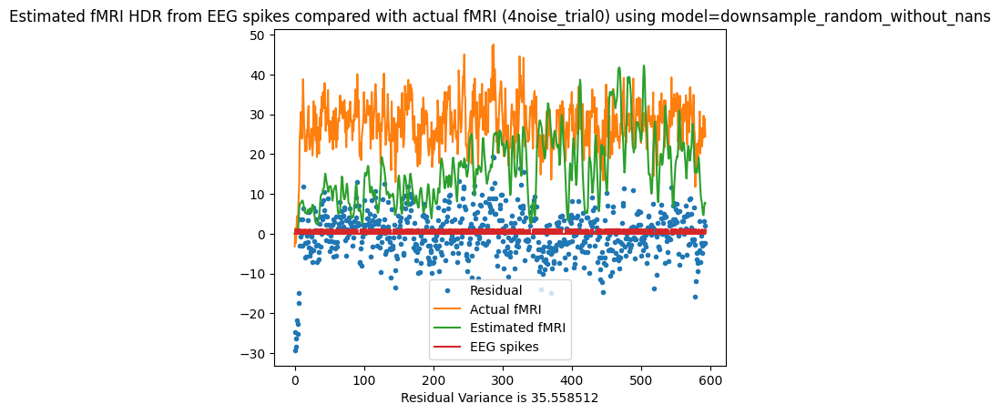

Residual Variance is 35.558512


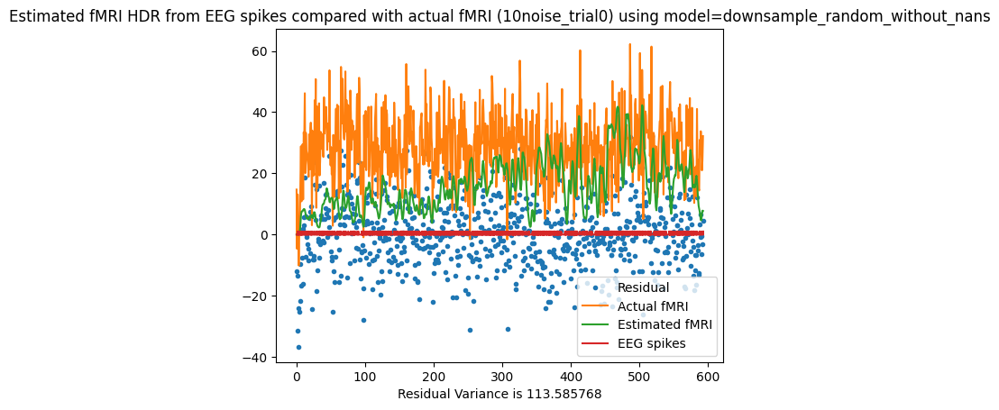

Residual Variance is 113.585768
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.72 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.82 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.94 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.98 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.01 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.99 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.00 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.98 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.98 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.98 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.00 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.18 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.22 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.23 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 18.78097147349774; at
     delta  tau  alpha
108    1.0  1.2    2.2


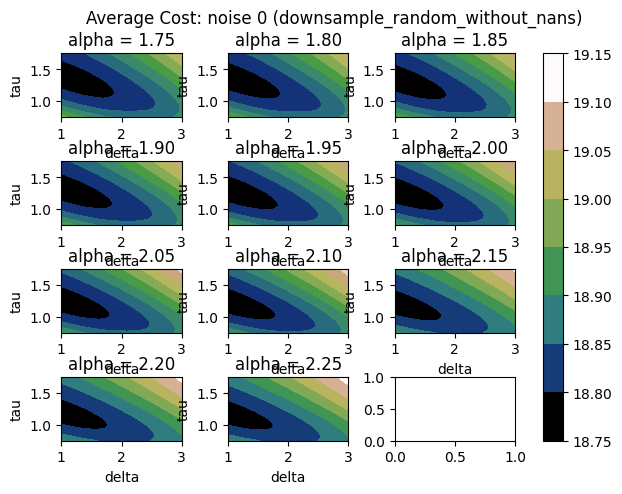

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 19.794029105497785; at
     delta  tau  alpha
108    1.0  1.2    2.2


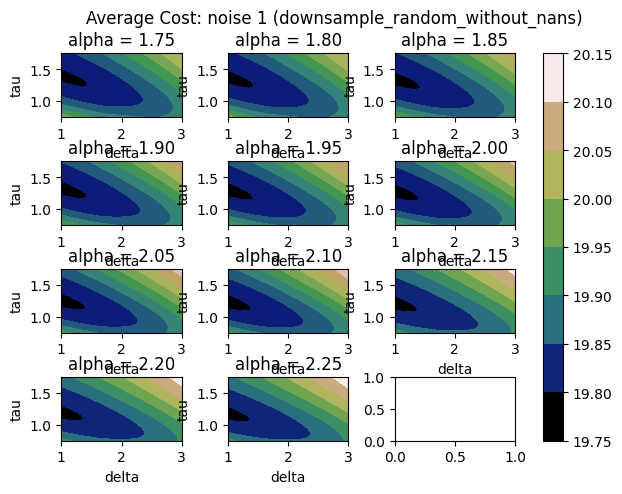

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 34.7978194591577; at
     delta  tau  alpha
109    1.0  1.2   2.25


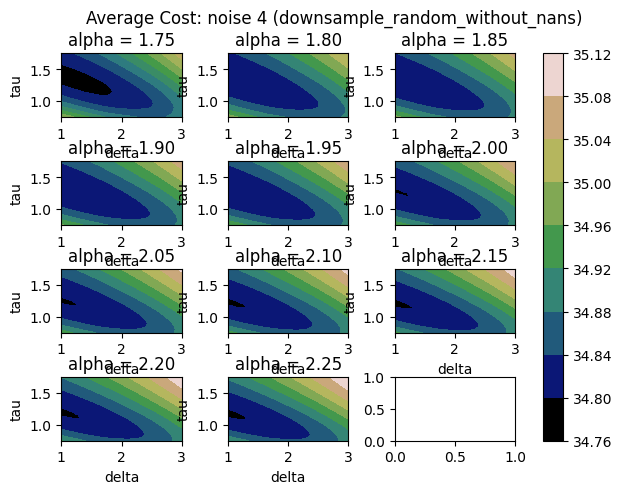

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 67.49068164886148; at
     delta   tau  alpha
134    1.0  1.35   1.85


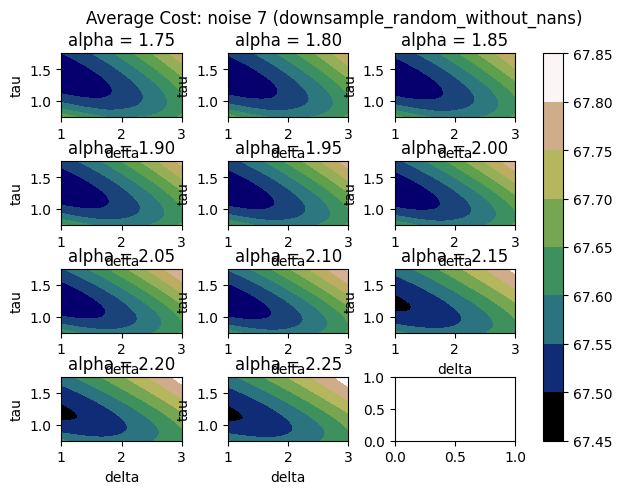

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 119.3319632316958; at
     delta  tau  alpha
108    1.0  1.2    2.2


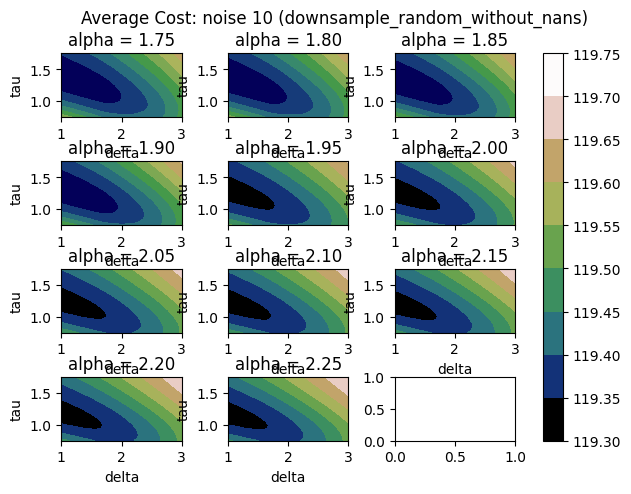

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 187.10150097764125; at
     delta  tau  alpha
802   1.15  1.2   2.25


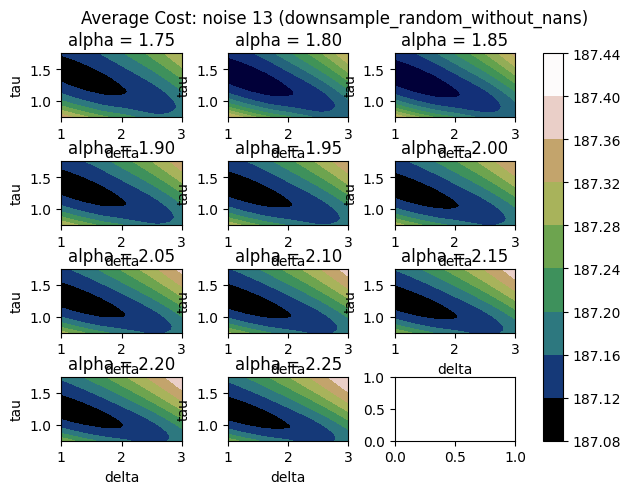

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


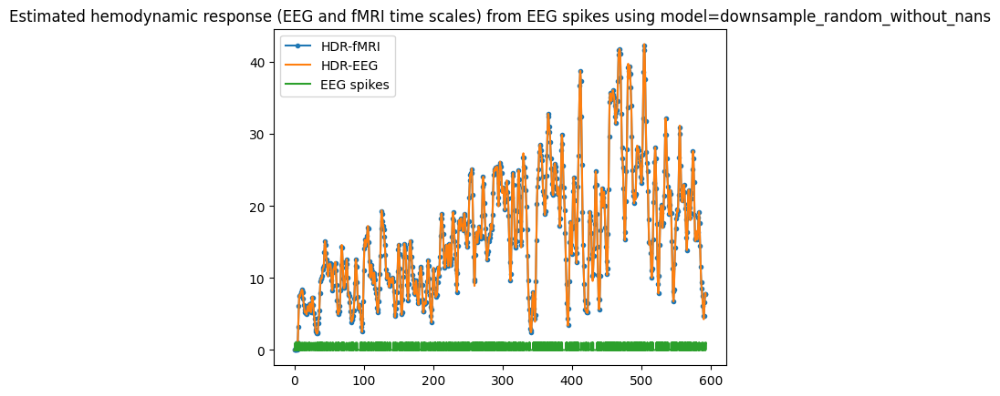

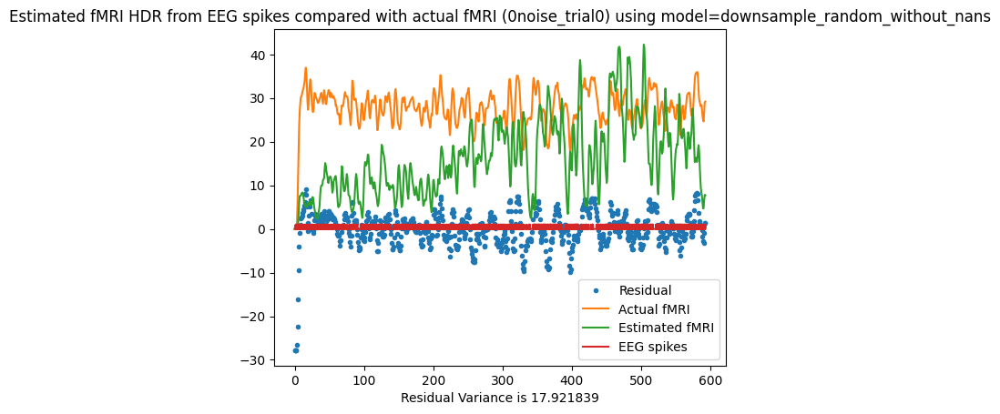

Residual Variance is 17.921839


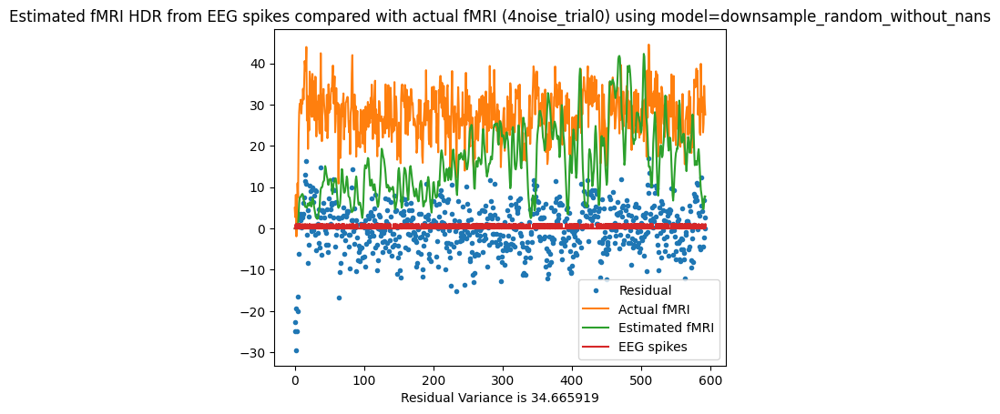

Residual Variance is 34.665919


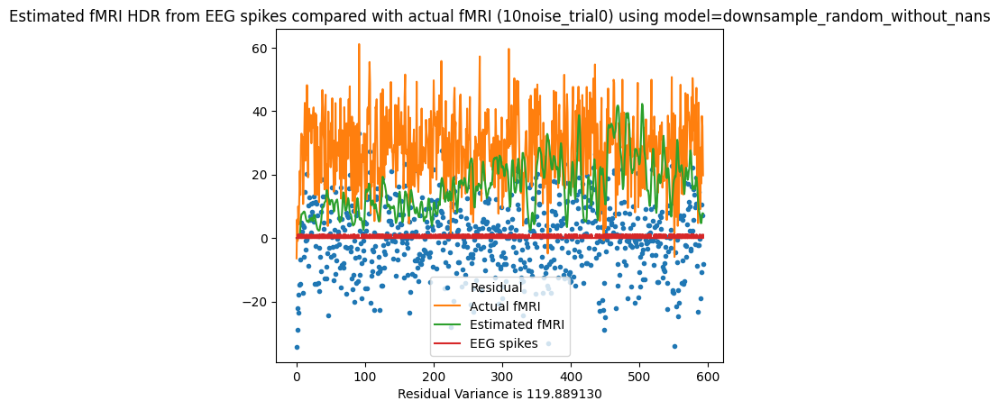

Residual Variance is 119.889130
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.83 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.96 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 2.00 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 2.11 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.10 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.24 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.15 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.23 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.57 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.30 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.31 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.27 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.16 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.37 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 17.918719155220938; at
      delta   tau  alpha
7392    2.6  0.75   1.75


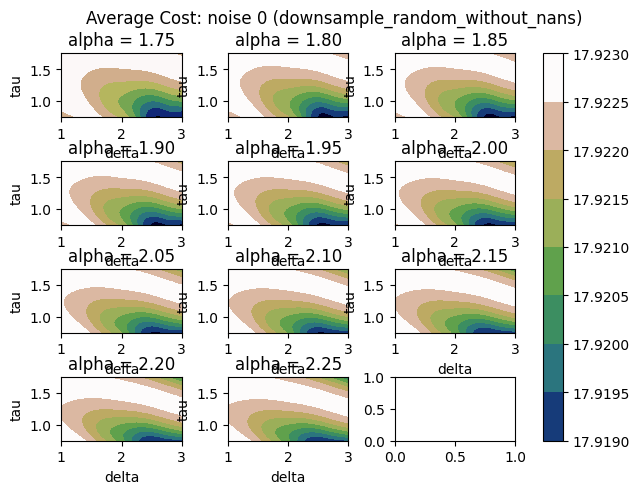

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 18.937713790446494; at
      delta   tau  alpha
7392    2.6  0.75   1.75


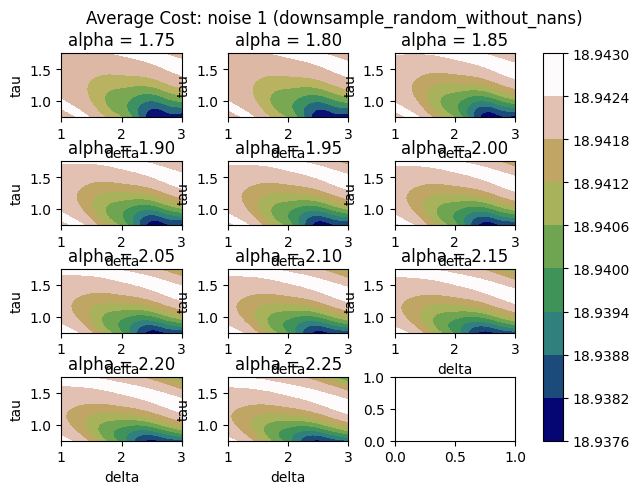

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 33.95419626364057; at
      delta   tau  alpha
9470    3.0  1.75   2.25


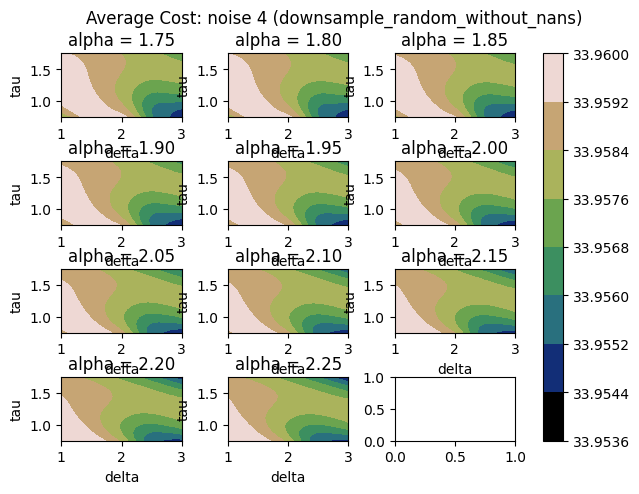

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 67.05558389850988; at
      delta   tau  alpha
7623   2.65  0.75   1.75


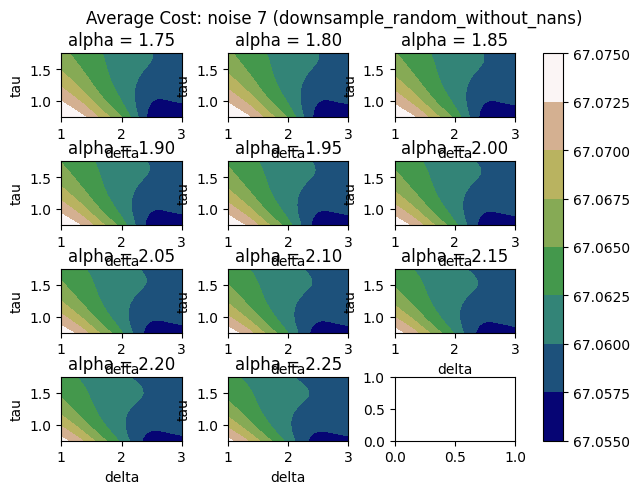

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 118.43614608970198; at
      delta   tau  alpha
7395    2.6  0.75    1.9


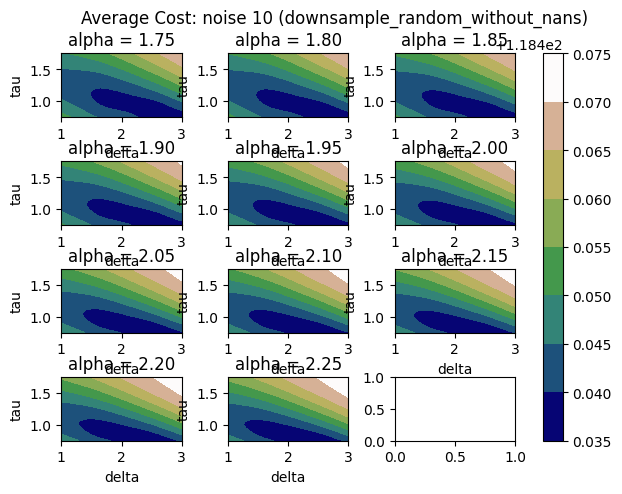

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 187.46793718368124; at
      delta   tau  alpha
9470    3.0  1.75   2.25


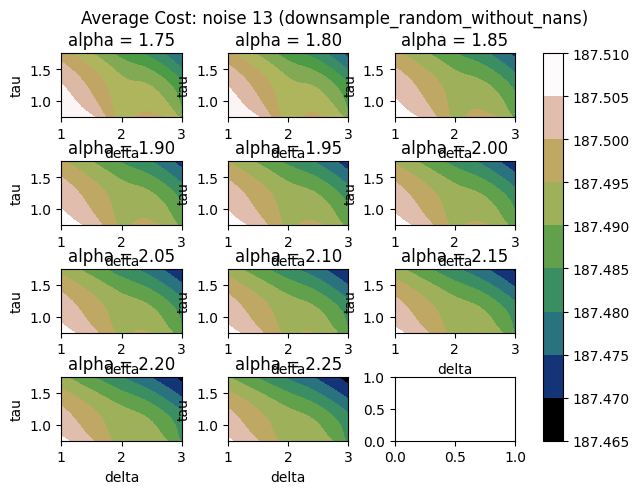

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


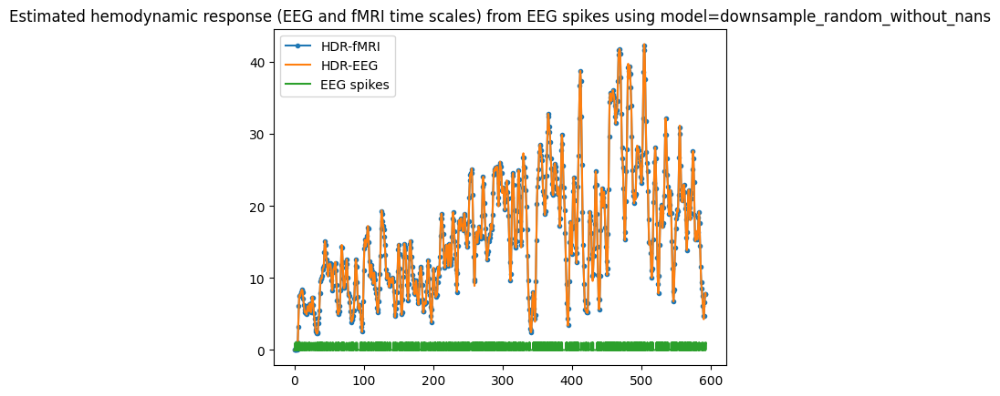

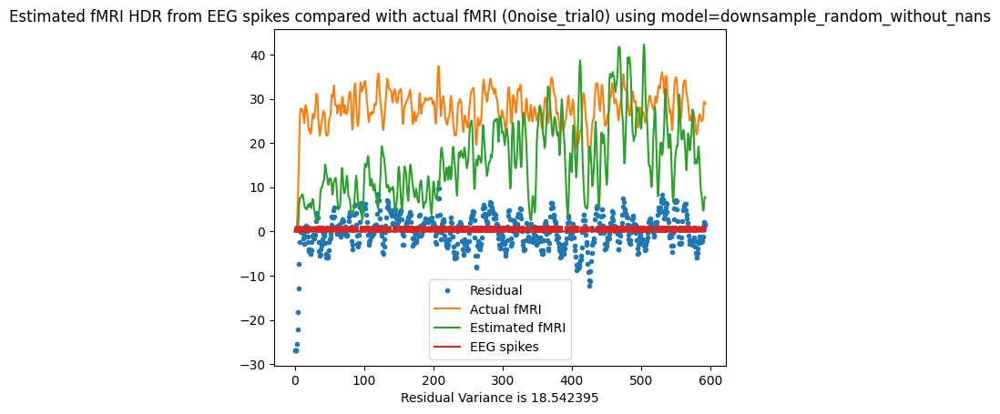

Residual Variance is 18.542395


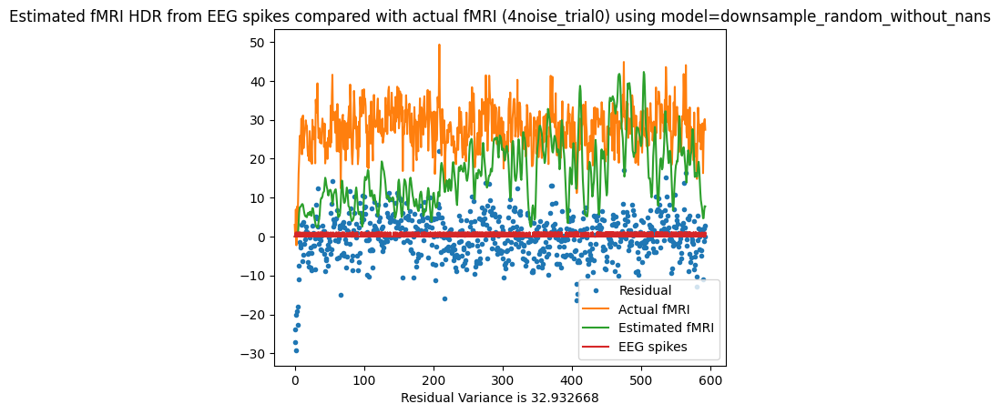

Residual Variance is 32.932668


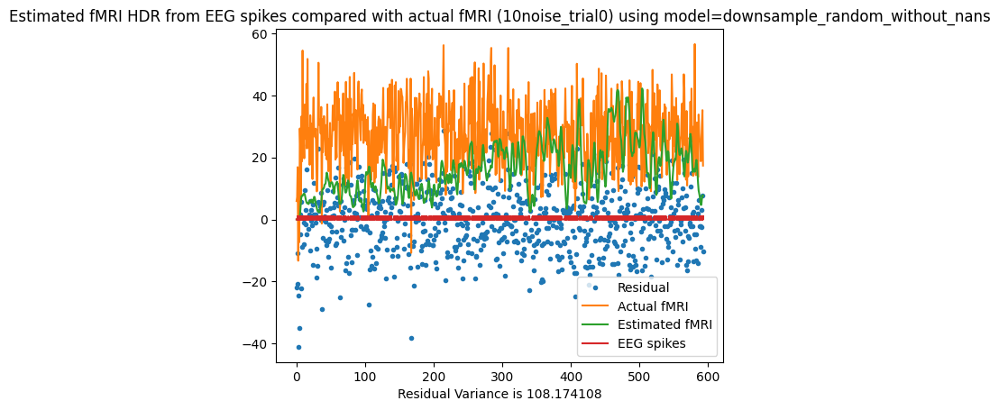

Residual Variance is 108.174108
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.64 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.78 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.90 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 2.00 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.03 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.07 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.36 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.19 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.13 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.16 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.13 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.14 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.14 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.14 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 18.3603046323043; at
      delta   tau  alpha
9470    3.0  1.75   2.25


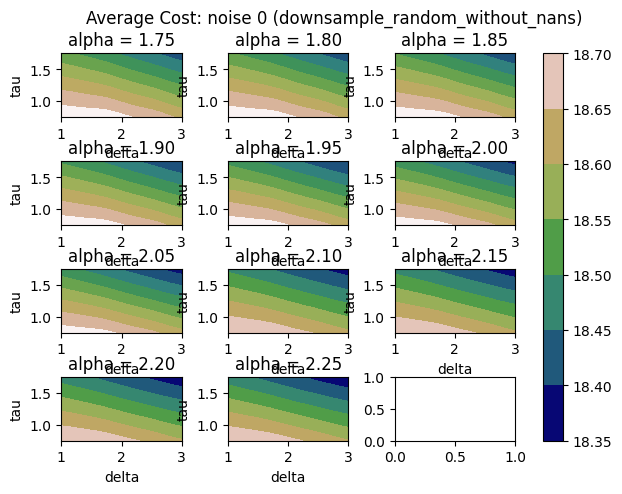

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 19.35762602678588; at
      delta   tau  alpha
9470    3.0  1.75   2.25


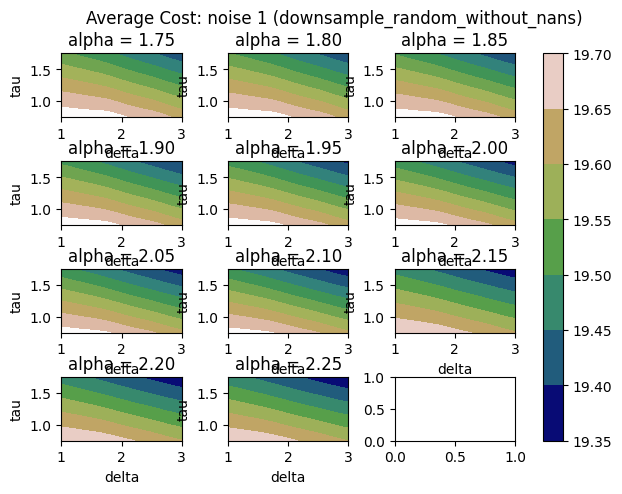

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 34.2632992033566; at
      delta   tau  alpha
9470    3.0  1.75   2.25


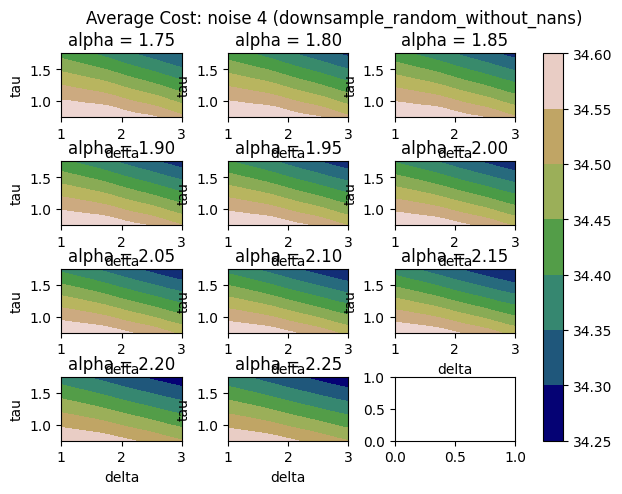

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 66.79631973471726; at
      delta   tau  alpha
9470    3.0  1.75   2.25


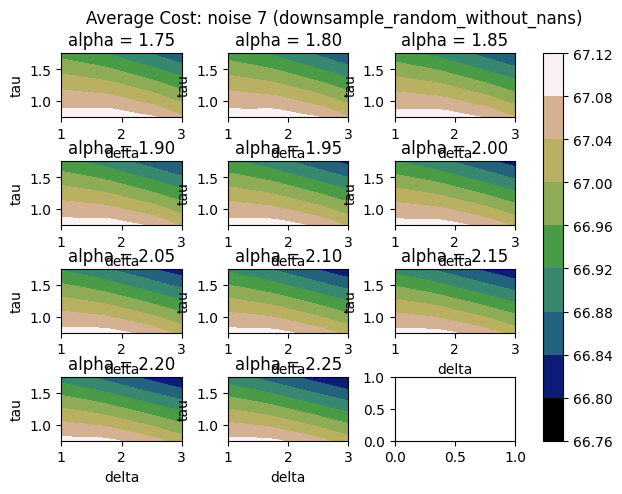

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 118.35791492588041; at
      delta   tau  alpha
9470    3.0  1.75   2.25


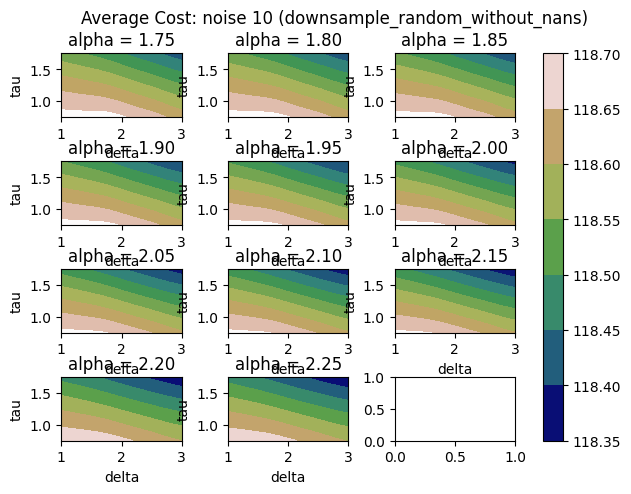

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 188.05177285536124; at
      delta   tau  alpha
9470    3.0  1.75   2.25


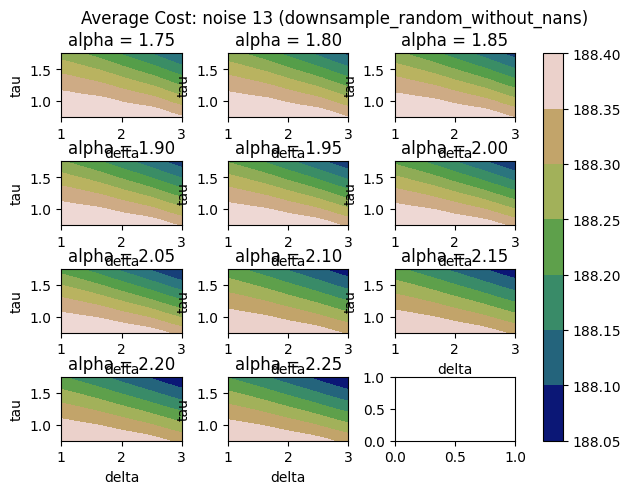

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


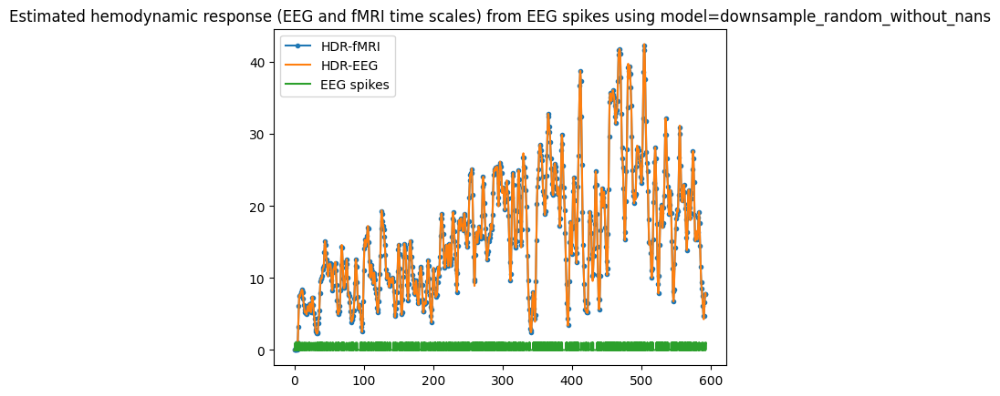

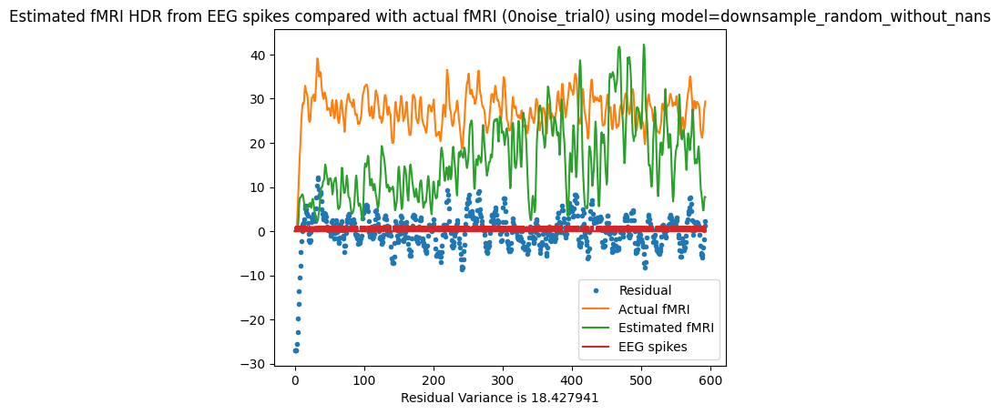

Residual Variance is 18.427941


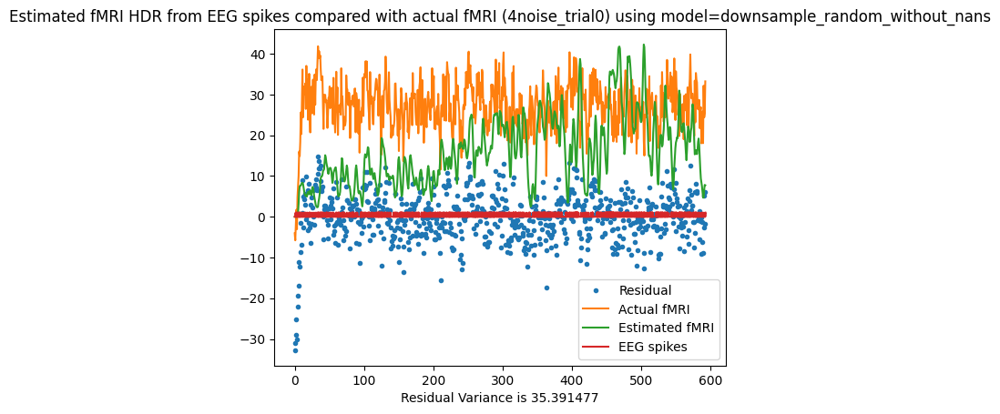

Residual Variance is 35.391477


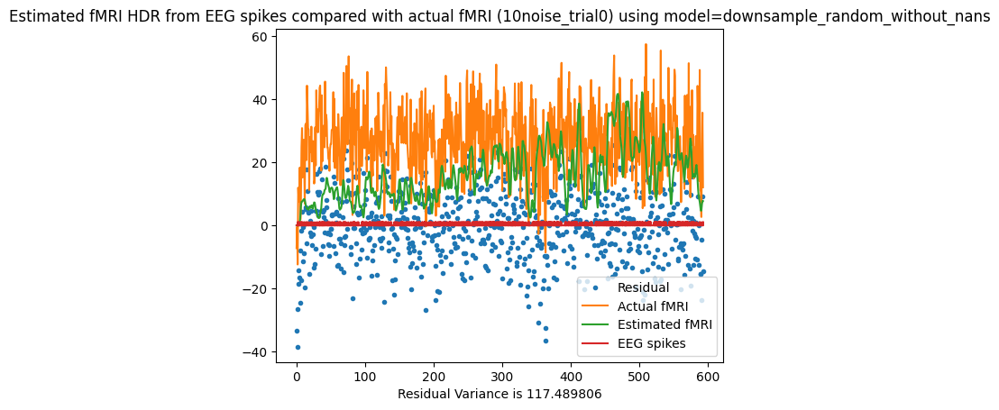

Residual Variance is 117.489806
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.62 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.71 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.79 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.85 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.81 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.92 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.89 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.94 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.93 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.91 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.89 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.89 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 1.96 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 1.99 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 18.364241861242267; at
      delta   tau  alpha
9470    3.0  1.75   2.25


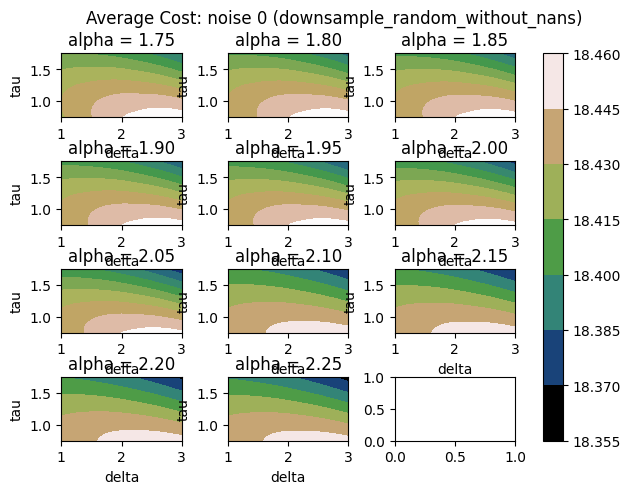

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 19.345452544323926; at
      delta   tau  alpha
9470    3.0  1.75   2.25


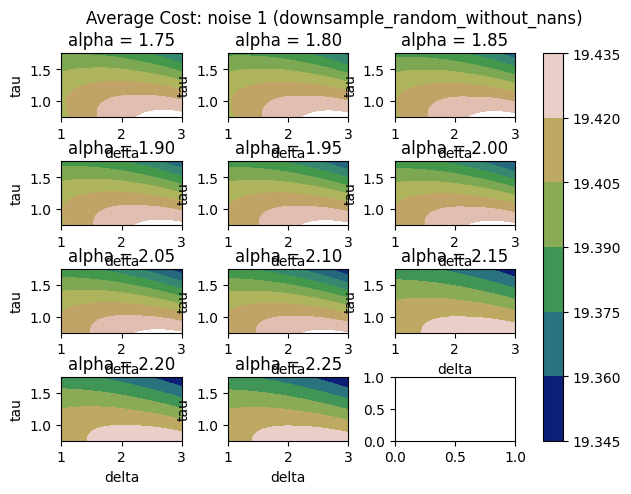

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 34.34419640173876; at
      delta   tau  alpha
9470    3.0  1.75   2.25


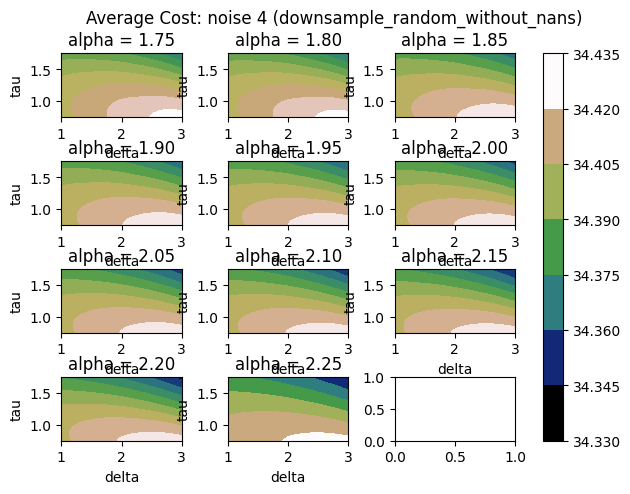

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 68.176370474205; at
      delta   tau  alpha
9470    3.0  1.75   2.25


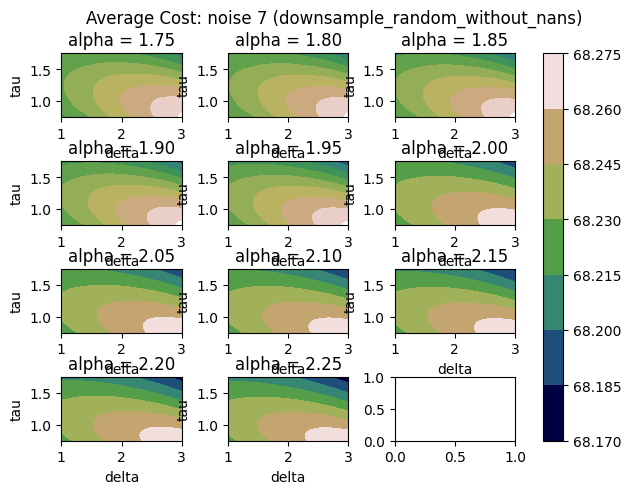

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 117.97739462520832; at
      delta   tau  alpha
9470    3.0  1.75   2.25


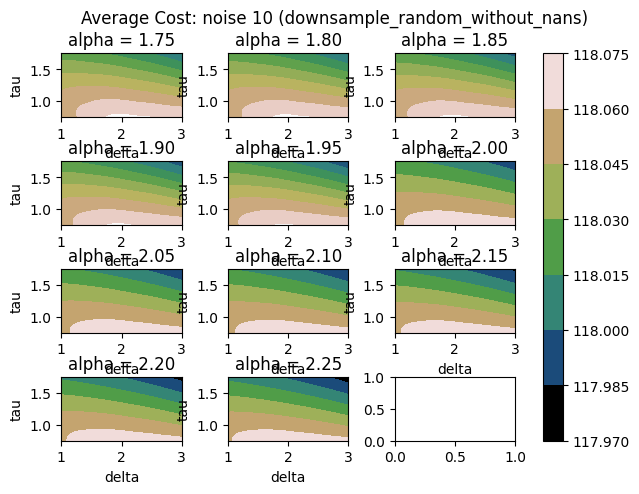

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 188.6474134071445; at
      delta   tau  alpha
9470    3.0  1.75   2.25


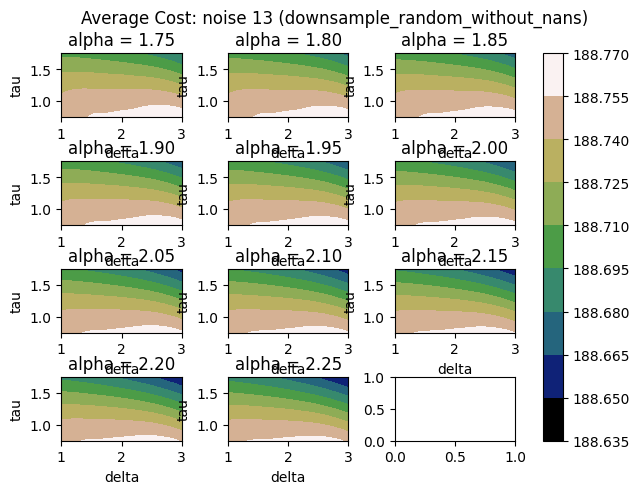

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


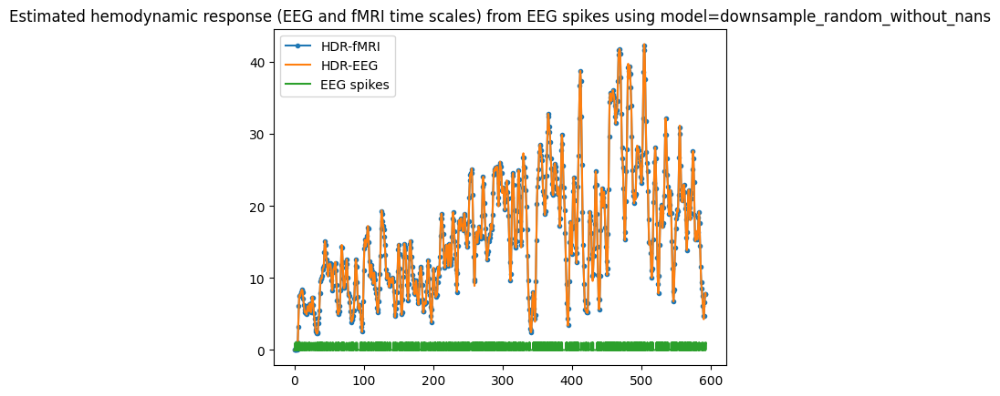

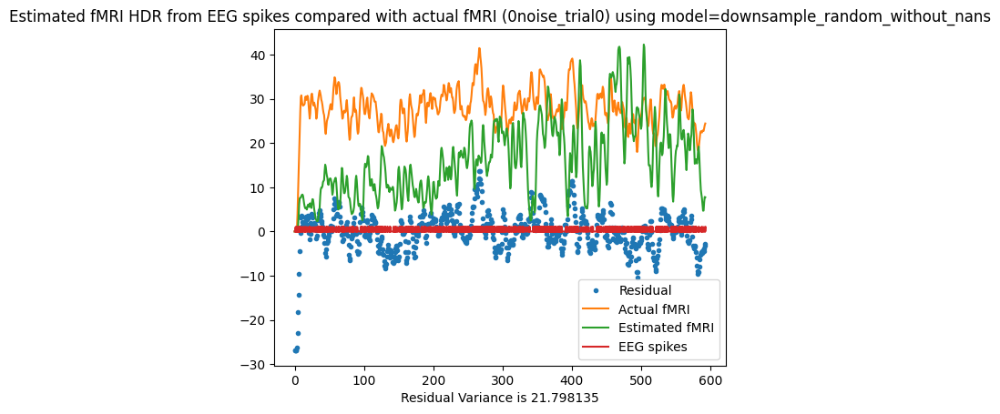

Residual Variance is 21.798135


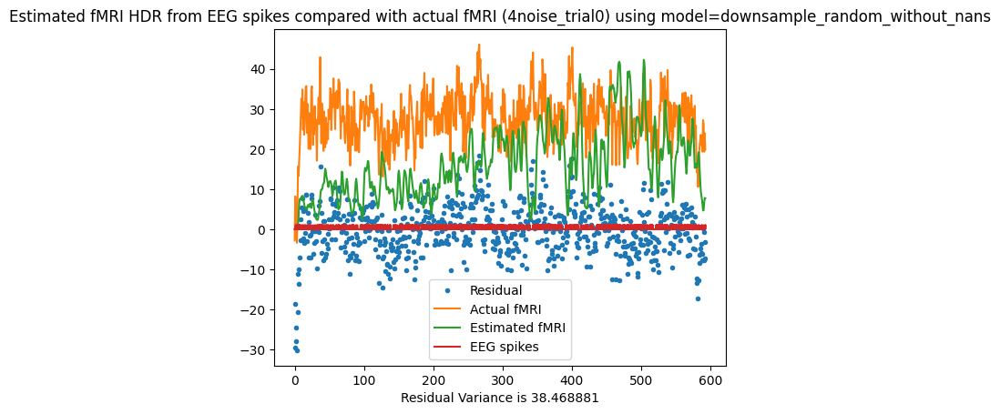

Residual Variance is 38.468881


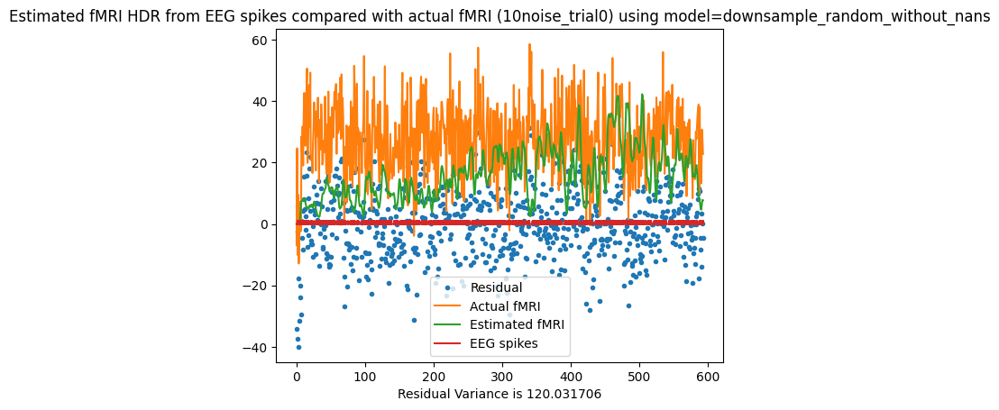

Residual Variance is 120.031706
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.81 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 2.12 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 2.31 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 2.23 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.21 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.16 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.16 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.10 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.06 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.05 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.00 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.13 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.01 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.20 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 21.772082741007175; at
     delta   tau  alpha
225    1.0  1.75    2.0


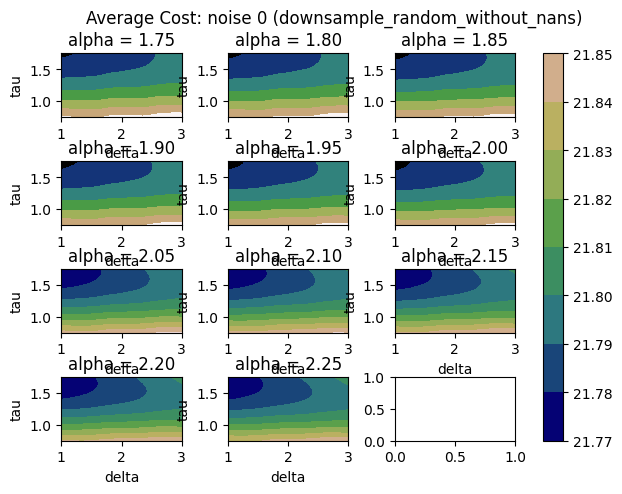

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 22.73456198830817; at
     delta   tau  alpha
225    1.0  1.75    2.0


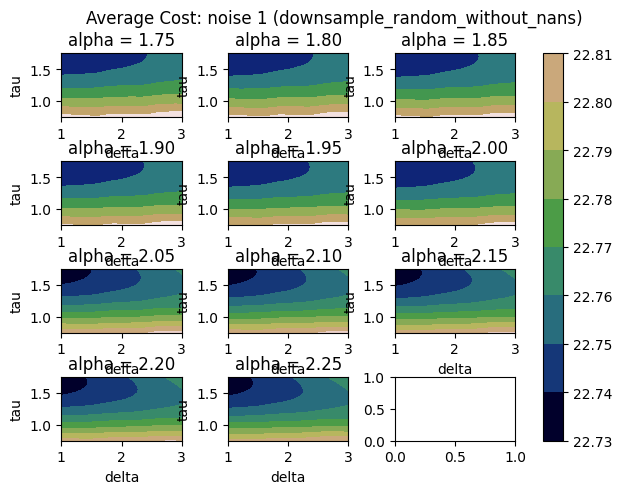

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 37.78388906097695; at
     delta   tau  alpha
221    1.0  1.75    1.8


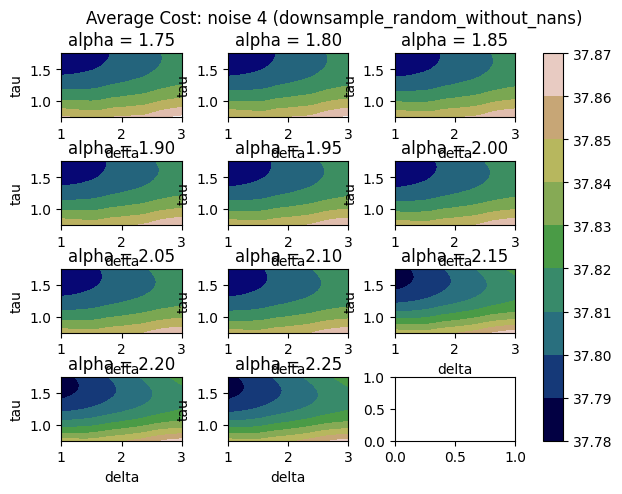

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 70.98404958695812; at
     delta   tau  alpha
230    1.0  1.75   2.25


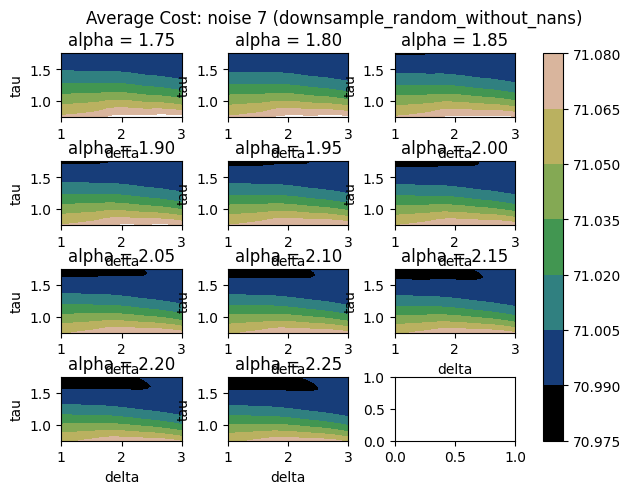

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 122.26017110003939; at
     delta   tau  alpha
230    1.0  1.75   2.25


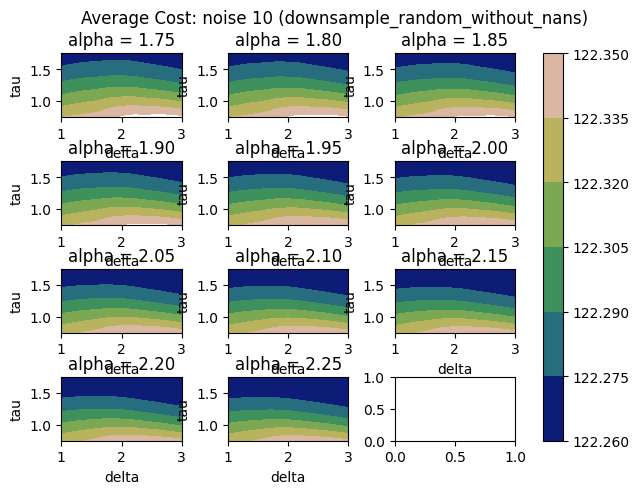

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 190.42150290235384; at
     delta   tau  alpha
221    1.0  1.75    1.8


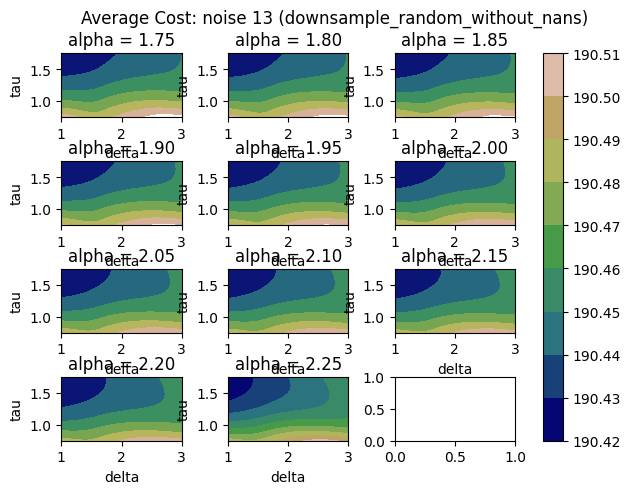

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


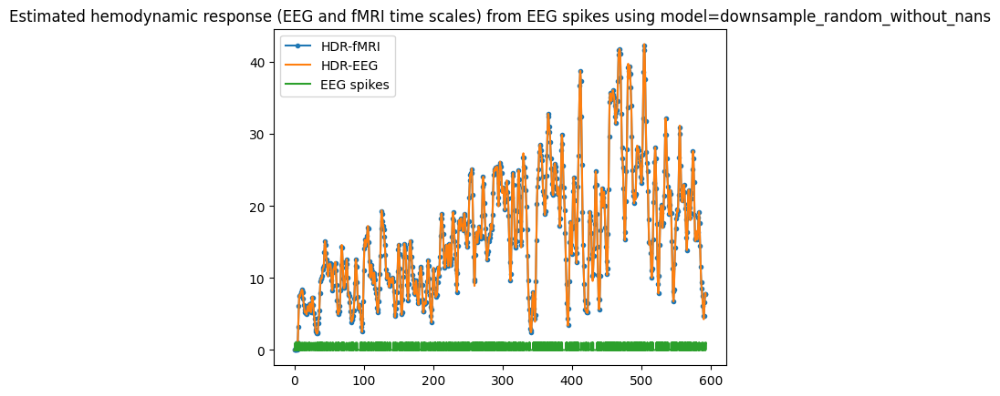

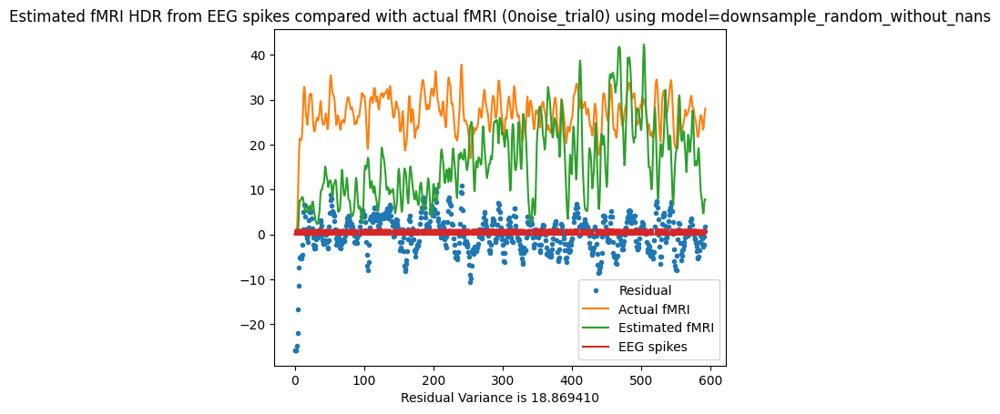

Residual Variance is 18.869410


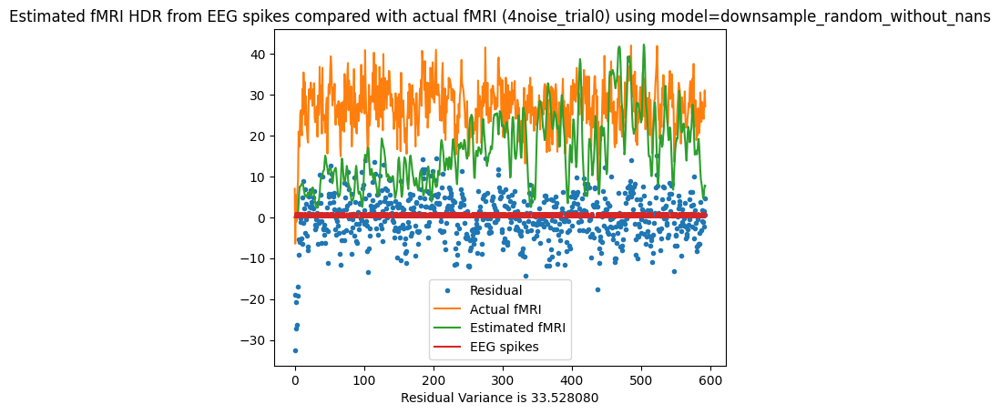

Residual Variance is 33.528080


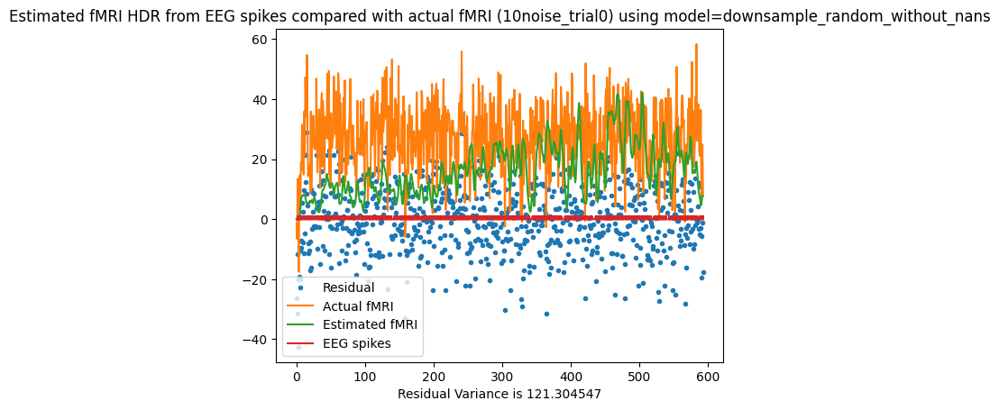

Residual Variance is 121.304547
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.64 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.69 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.80 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 3.10 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.09 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.00 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.01 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.01 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.99 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.00 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.02 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.07 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 1.96 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 1.95 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 18.812794177637862; at
      delta   tau  alpha
9360    3.0  1.25   2.25


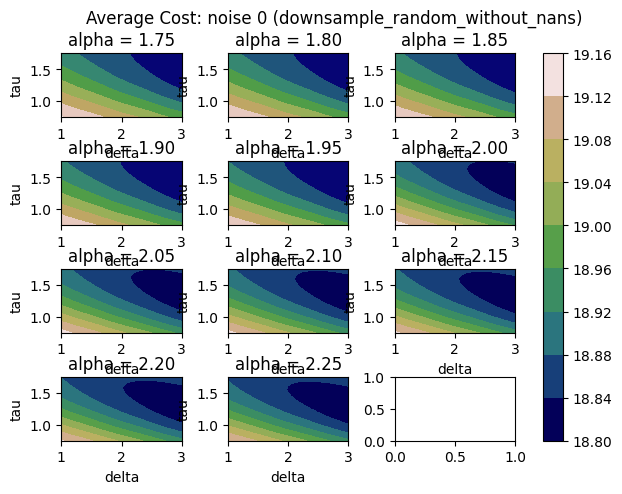

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 19.774594862614993; at
      delta   tau  alpha
9360    3.0  1.25   2.25


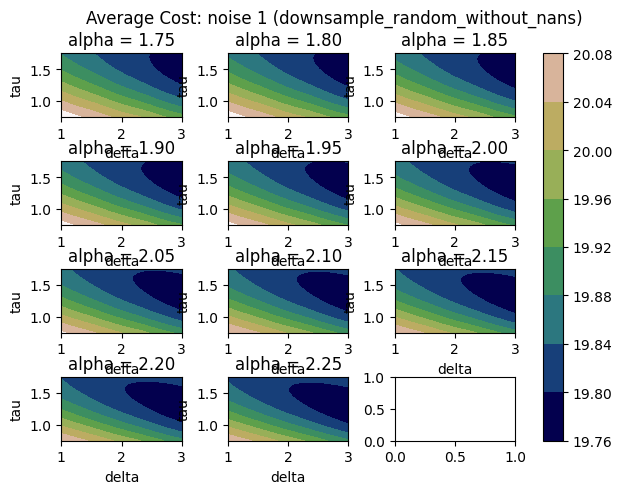

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 34.8731294775711; at
      delta   tau  alpha
9360    3.0  1.25   2.25


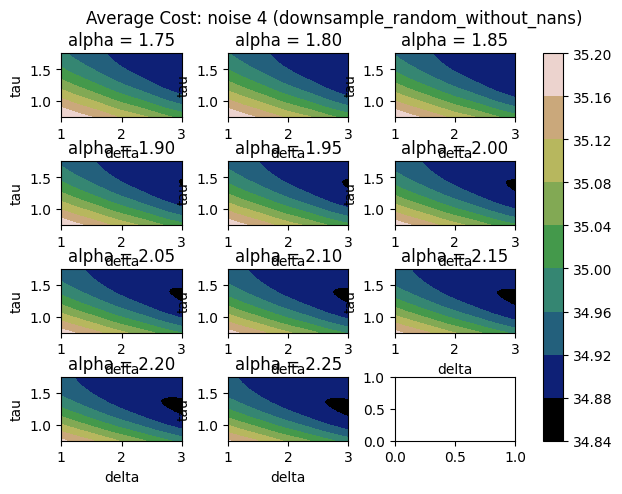

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 68.48434545572815; at
      delta  tau  alpha
9349    3.0  1.2   2.25


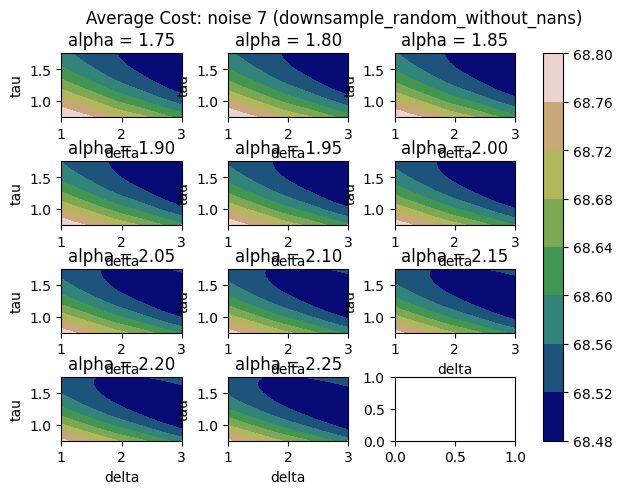

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 118.55666176380049; at
      delta   tau  alpha
9382    3.0  1.35   2.25


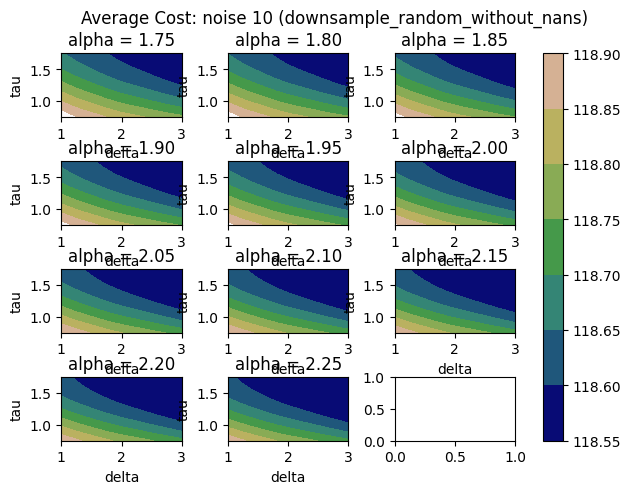

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 187.62491942574238; at
      delta   tau  alpha
9338    3.0  1.15   2.25


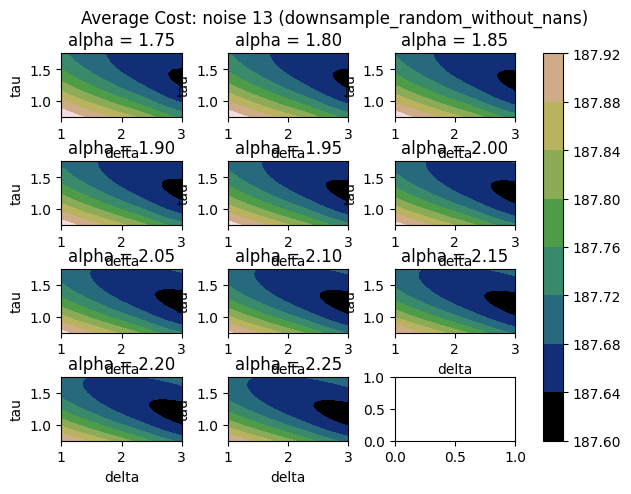

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


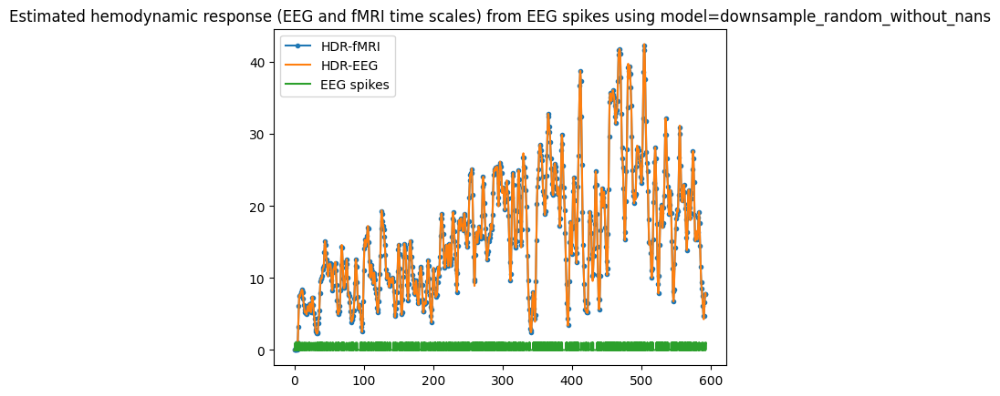

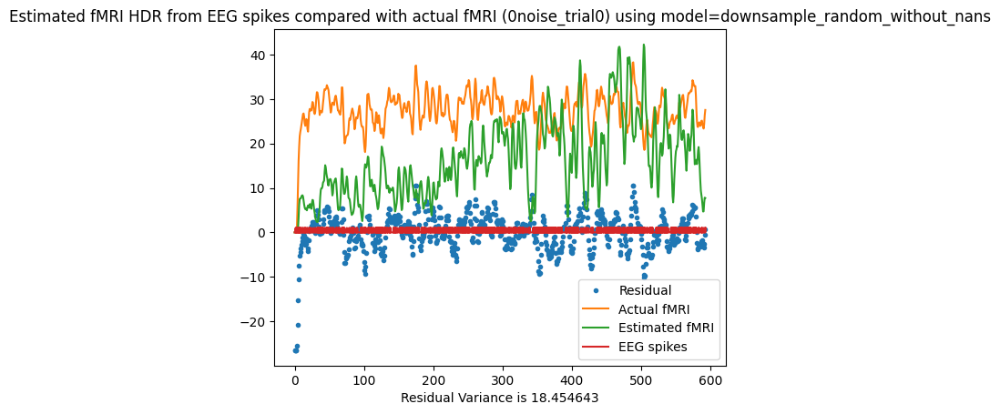

Residual Variance is 18.454643


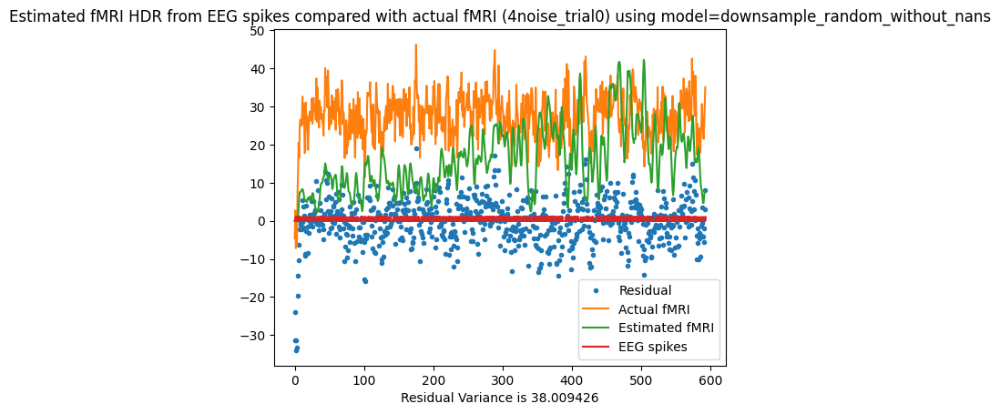

Residual Variance is 38.009426


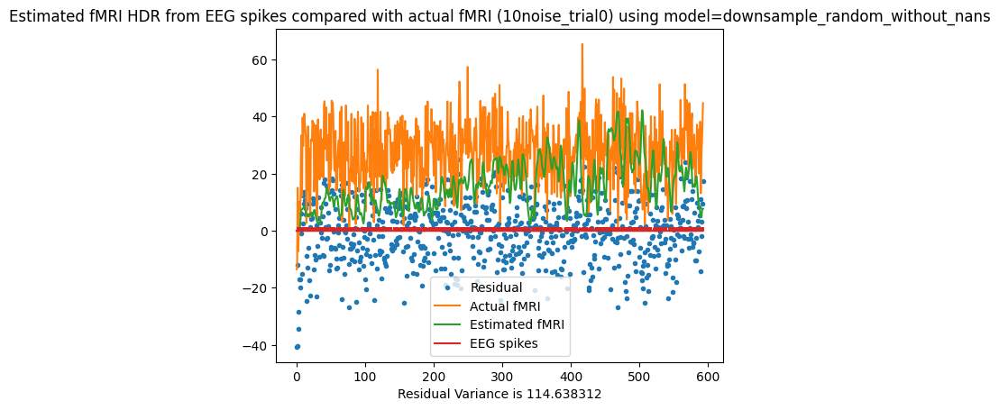

Residual Variance is 114.638312
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.67 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.73 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.86 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.91 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.92 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.02 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.04 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.12 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.02 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.98 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.97 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.93 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 1.87 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 1.95 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 18.239492495081464; at
      delta   tau  alpha
9470    3.0  1.75   2.25


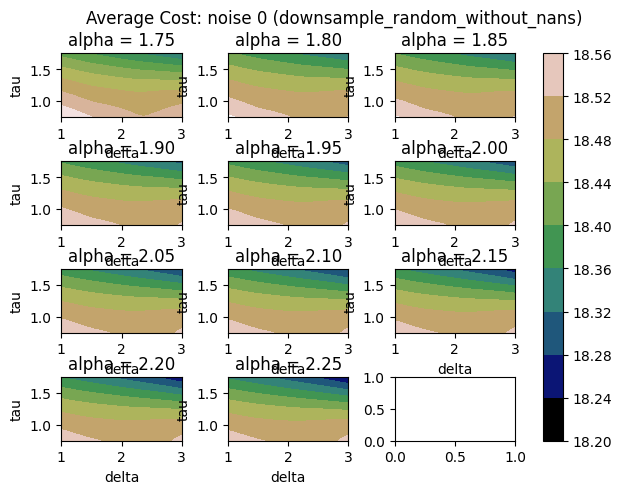

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 19.25019972754377; at
      delta   tau  alpha
9470    3.0  1.75   2.25


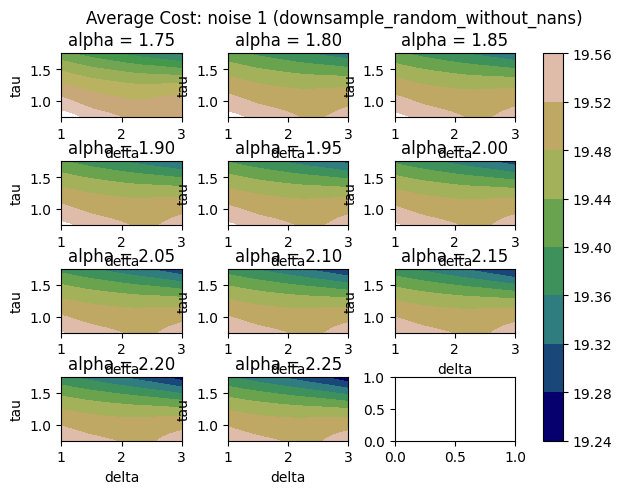

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 34.26817128317981; at
      delta   tau  alpha
9470    3.0  1.75   2.25


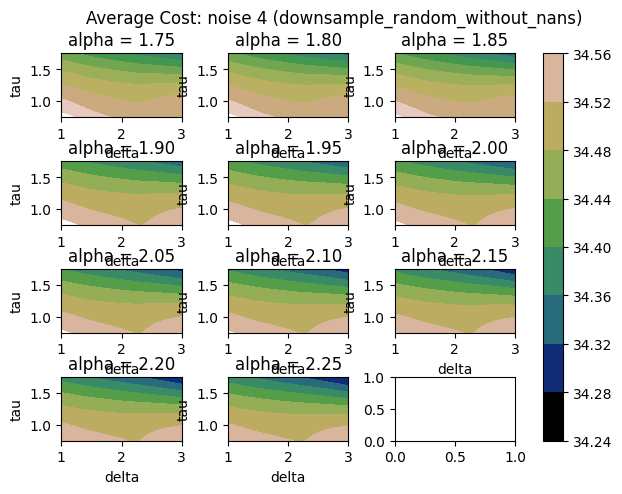

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 66.91403773092031; at
      delta   tau  alpha
9470    3.0  1.75   2.25


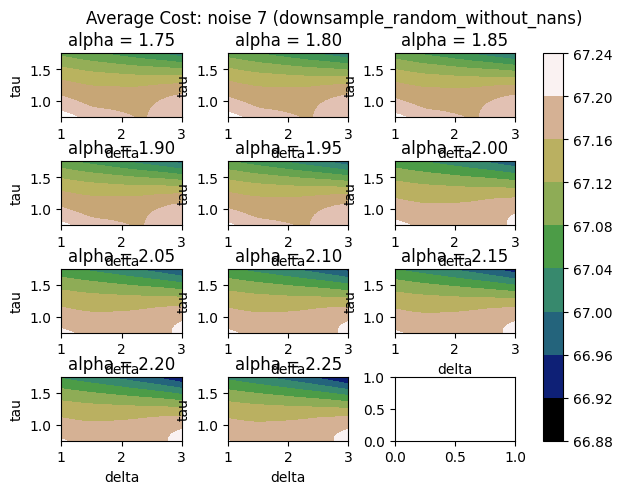

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 117.2757660498354; at
      delta   tau  alpha
9470    3.0  1.75   2.25


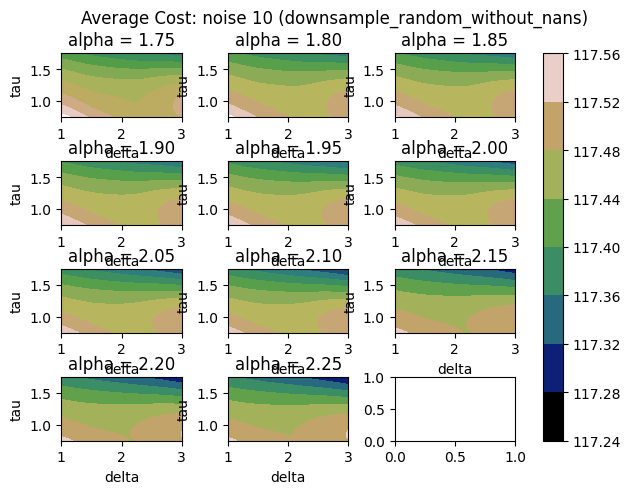

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 186.4215178682187; at
      delta   tau  alpha
9470    3.0  1.75   2.25


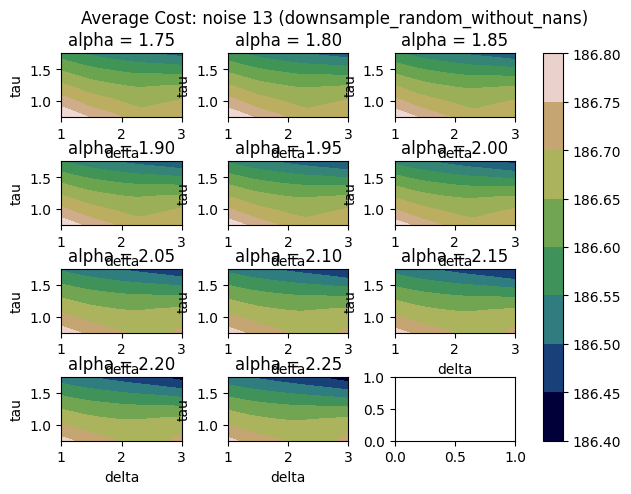

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


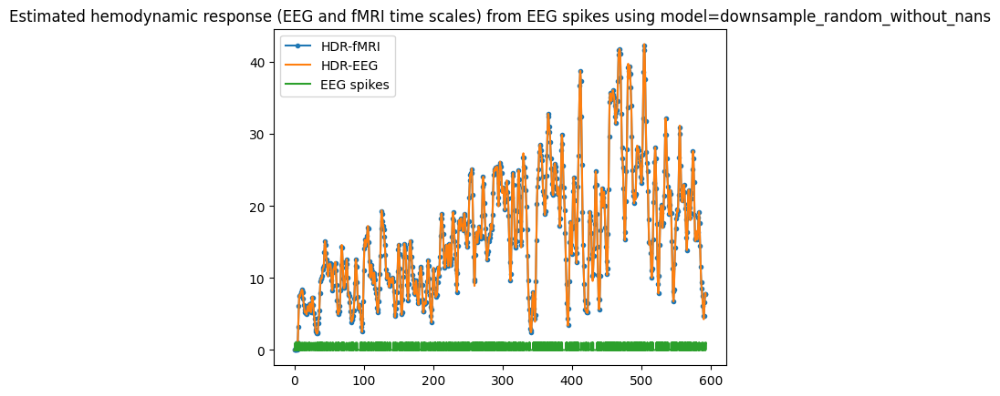

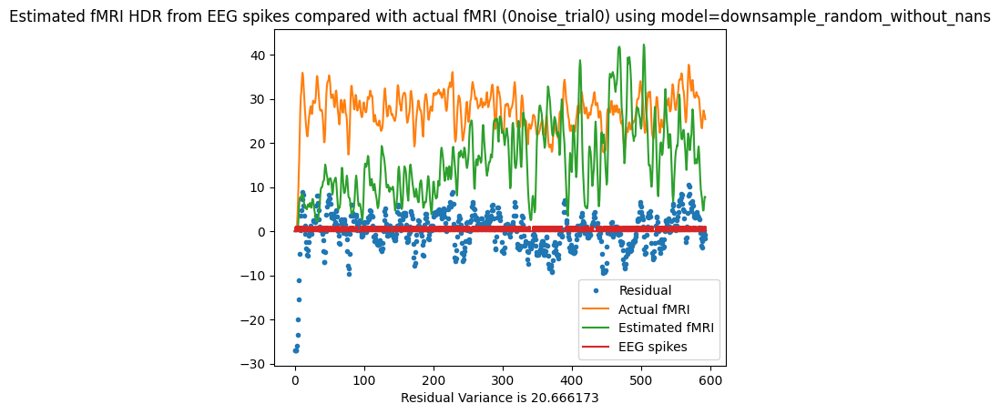

Residual Variance is 20.666173


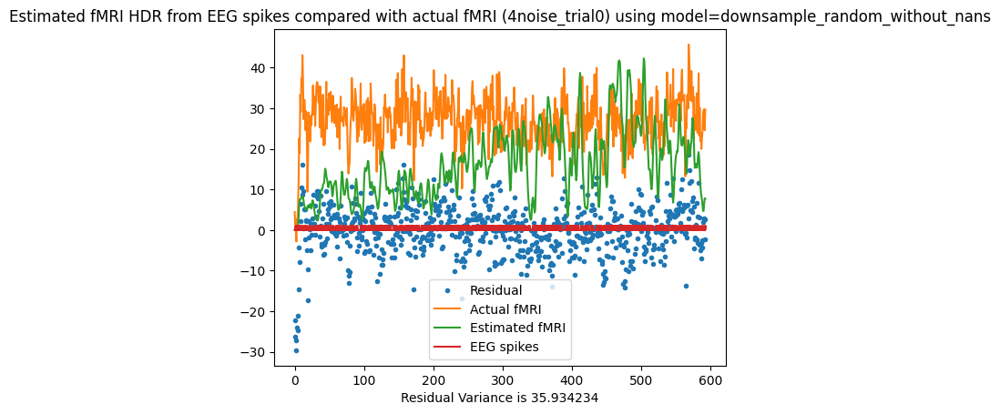

Residual Variance is 35.934234


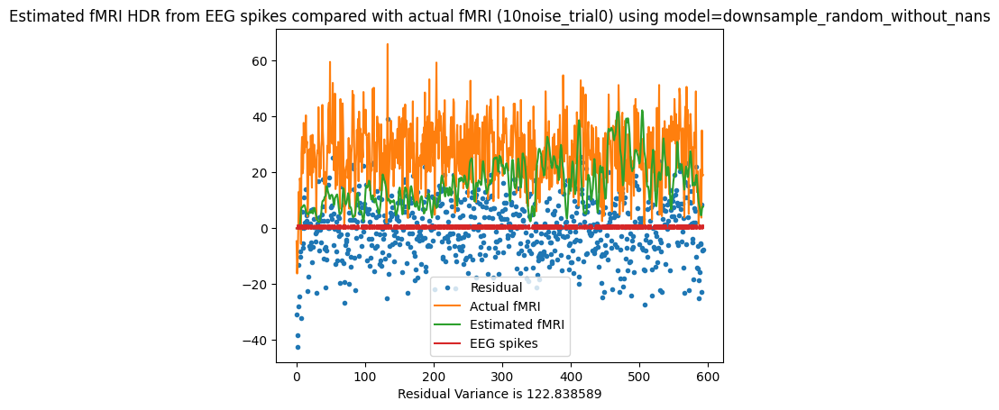

Residual Variance is 122.838589
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.61 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.75 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.85 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.92 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.88 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.00 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.09 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.01 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.03 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.04 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.03 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.17 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.15 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.10 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 20.652145280901983; at
      delta   tau  alpha
9470    3.0  1.75   2.25


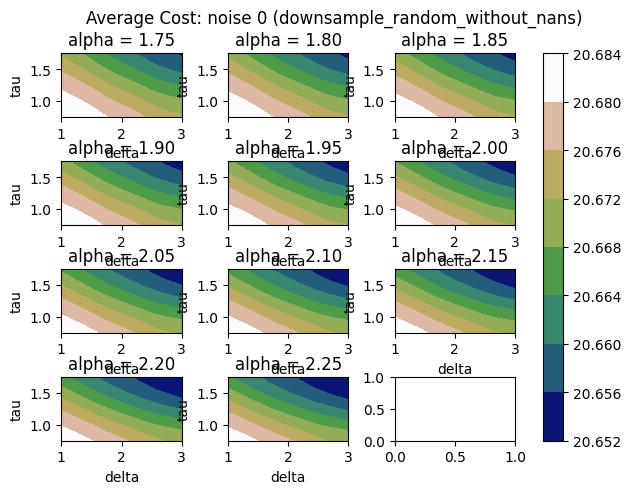

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 21.659479656059013; at
      delta   tau  alpha
9470    3.0  1.75   2.25


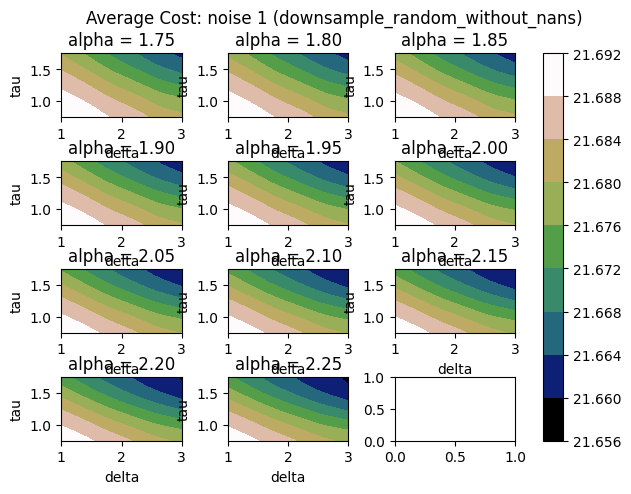

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 36.808091037267246; at
      delta  tau  alpha
9459    3.0  1.7   2.25


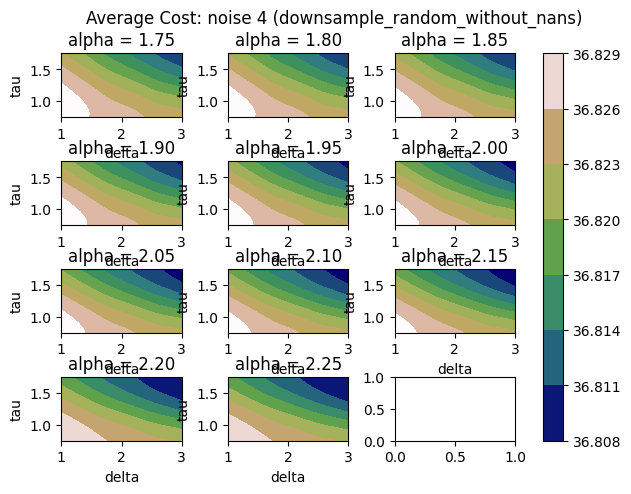

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 70.17464551694304; at
      delta   tau  alpha
9470    3.0  1.75   2.25


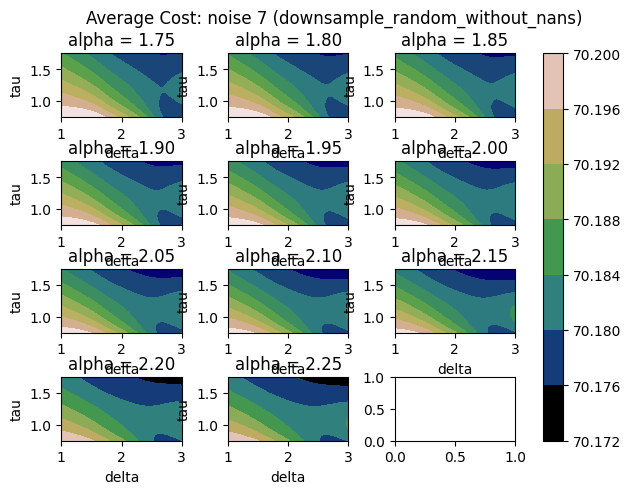

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 118.88030276113803; at
      delta   tau  alpha
7854    2.7  0.75   1.75


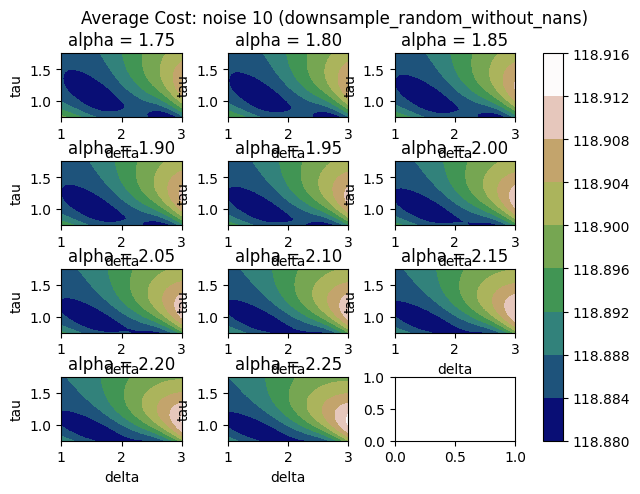

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 190.14545304032174; at
      delta   tau  alpha
9470    3.0  1.75   2.25


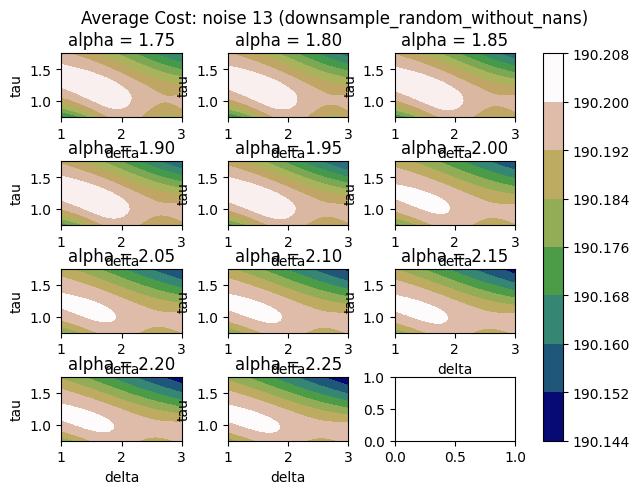

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


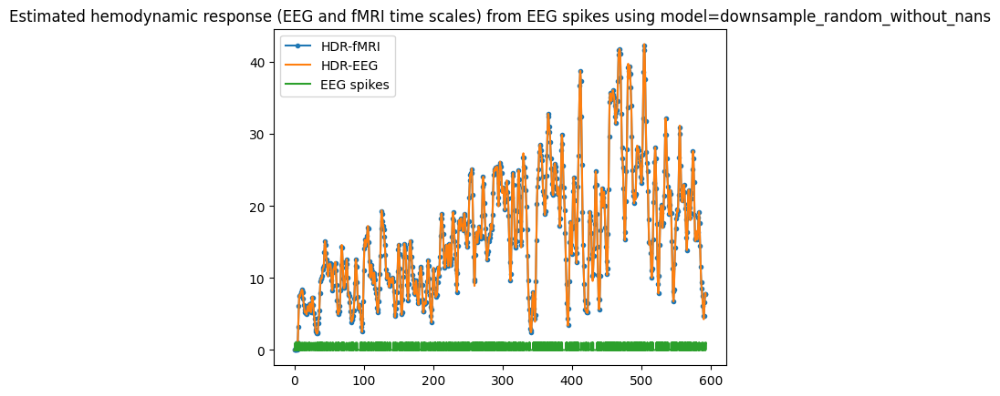

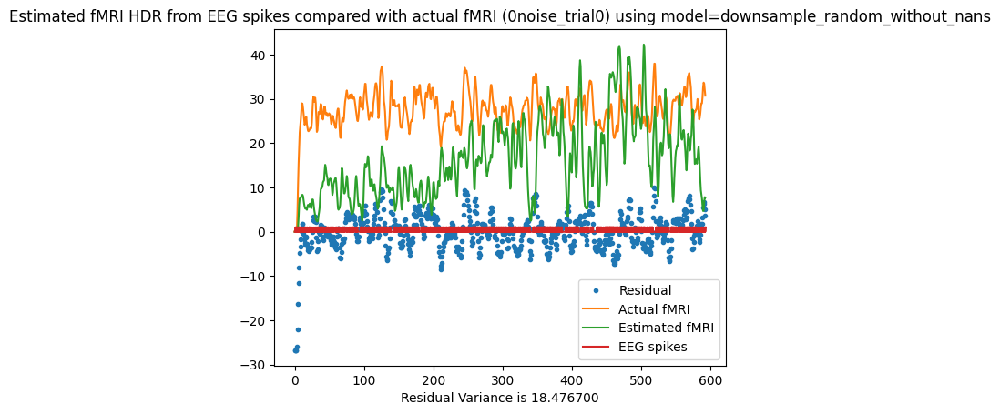

Residual Variance is 18.476700


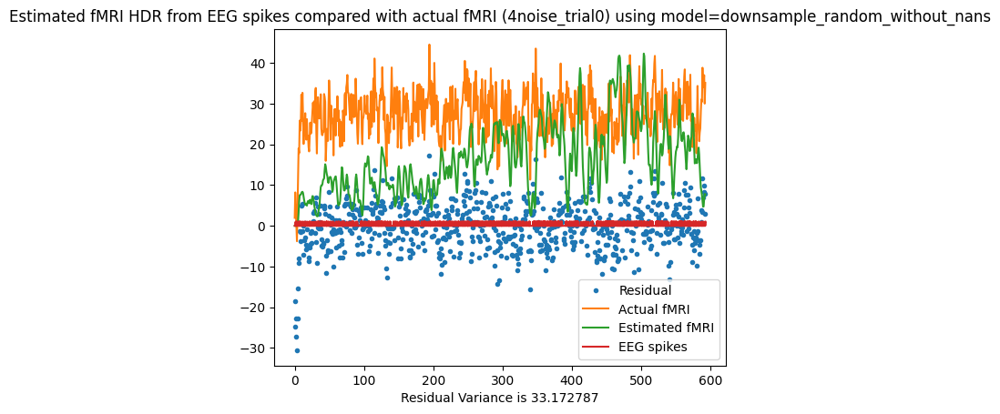

Residual Variance is 33.172787


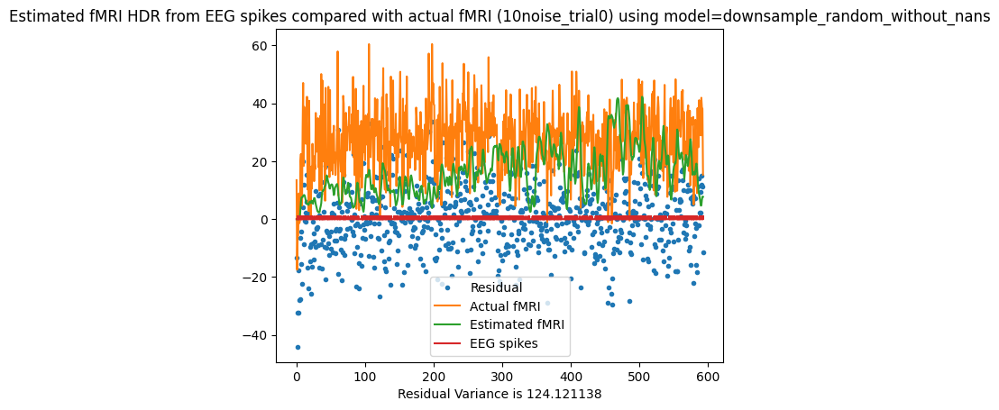

Residual Variance is 124.121138
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 2.13 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 2.94 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 2.04 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.94 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.18 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.10 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.20 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.07 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.08 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.08 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.01 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.12 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.35 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.11 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 18.452307280816026; at
      delta   tau  alpha
5114    2.1  0.85   2.25


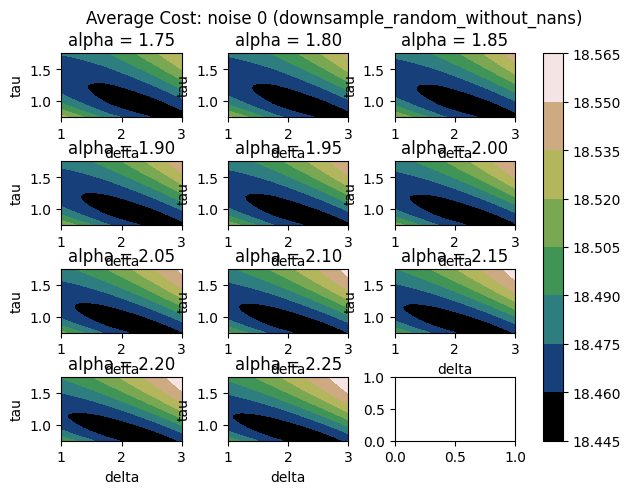

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 19.45109729509546; at
      delta   tau  alpha
5114    2.1  0.85   2.25


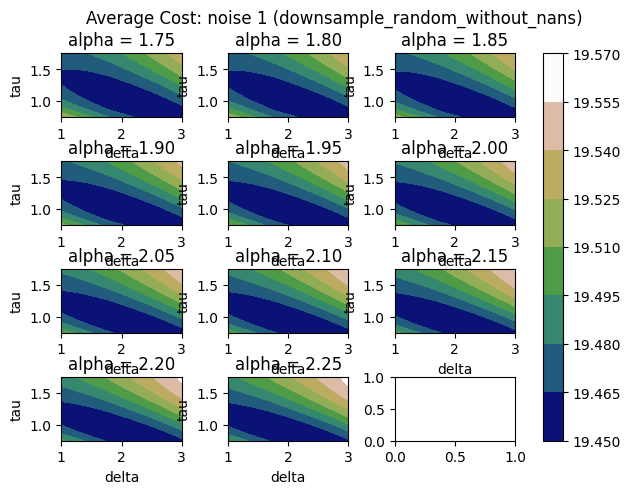

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 34.39417902869681; at
      delta   tau  alpha
3750    1.8  0.95   2.25


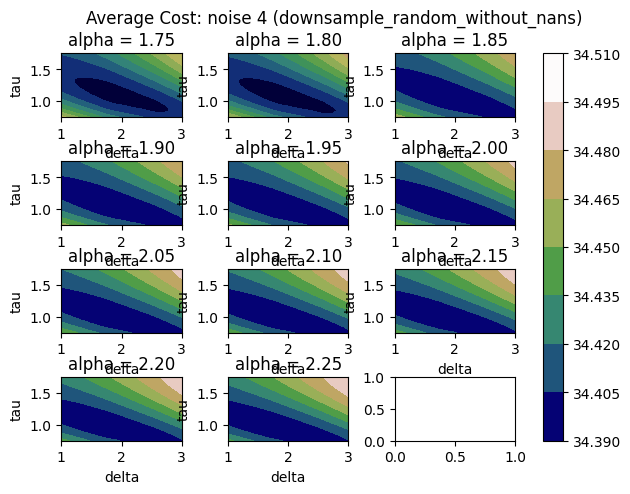

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 67.04483322495909; at
      delta   tau  alpha
3959   1.85  0.85   2.25


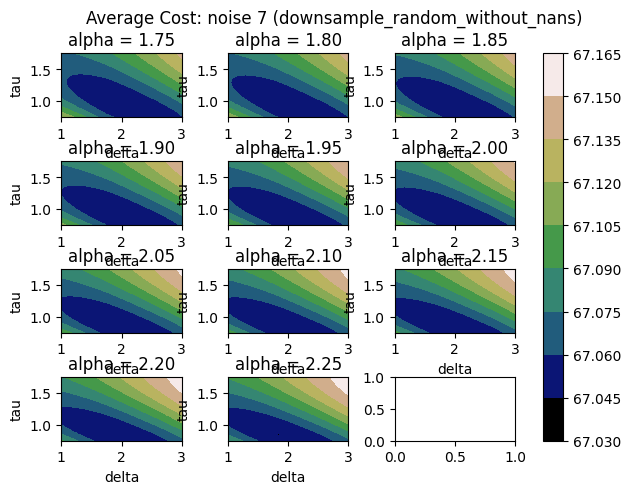

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 118.16263951597895; at
      delta   tau  alpha
6938    2.5  0.75   2.15


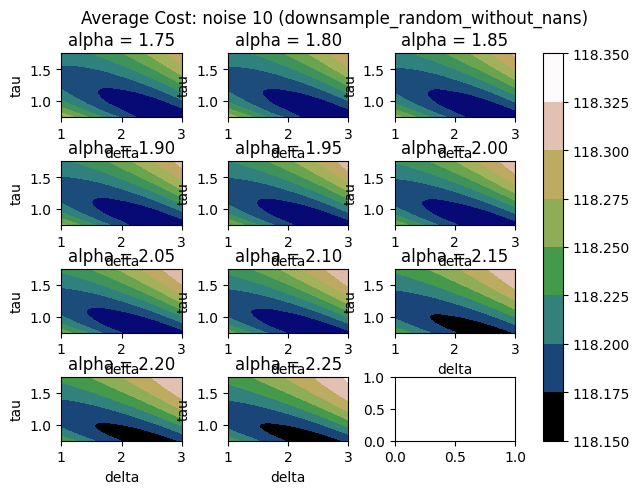

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 188.0377153898479; at
      delta   tau  alpha
8085   2.75  0.75   1.75


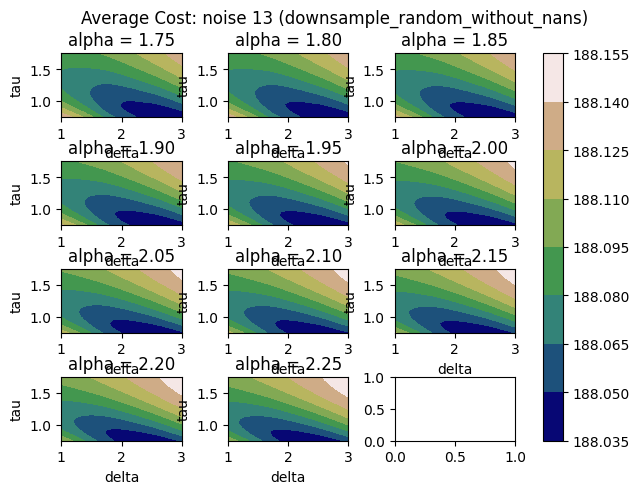

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


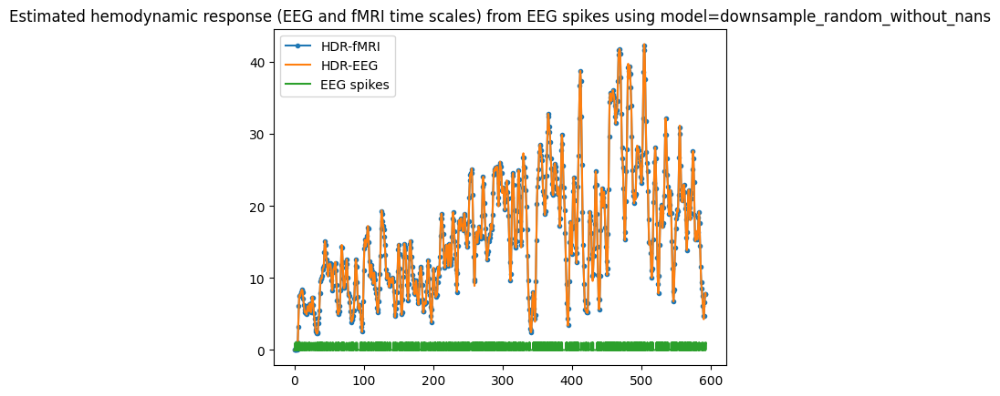

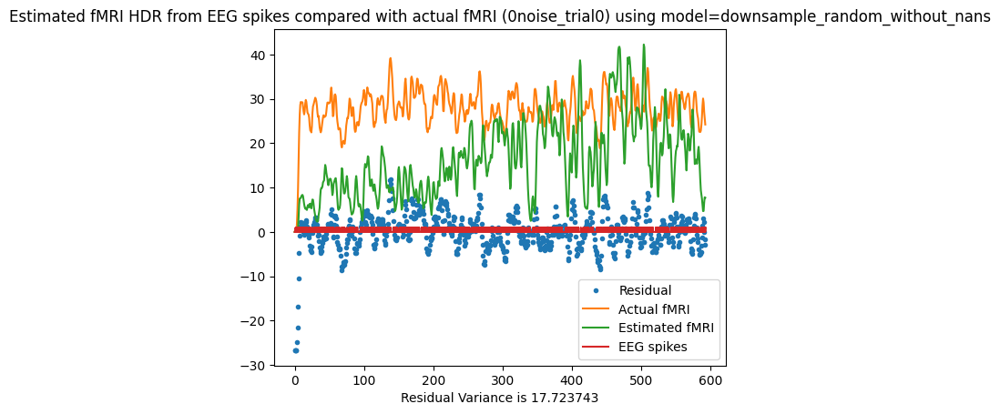

Residual Variance is 17.723743


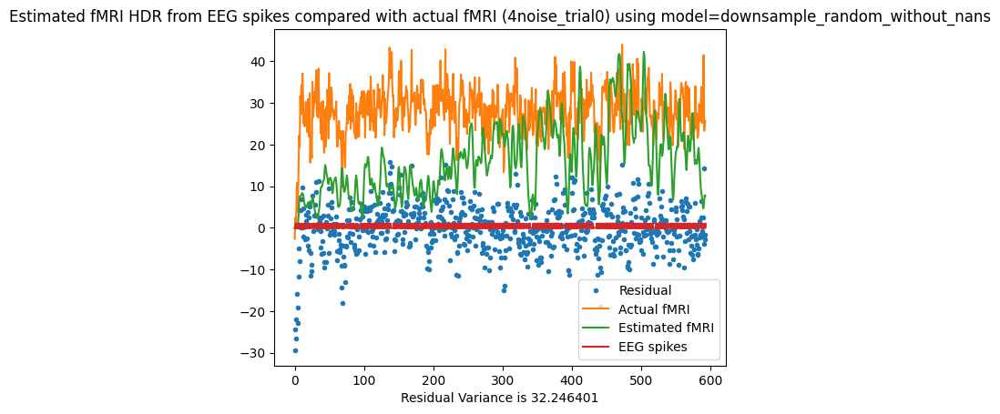

Residual Variance is 32.246401


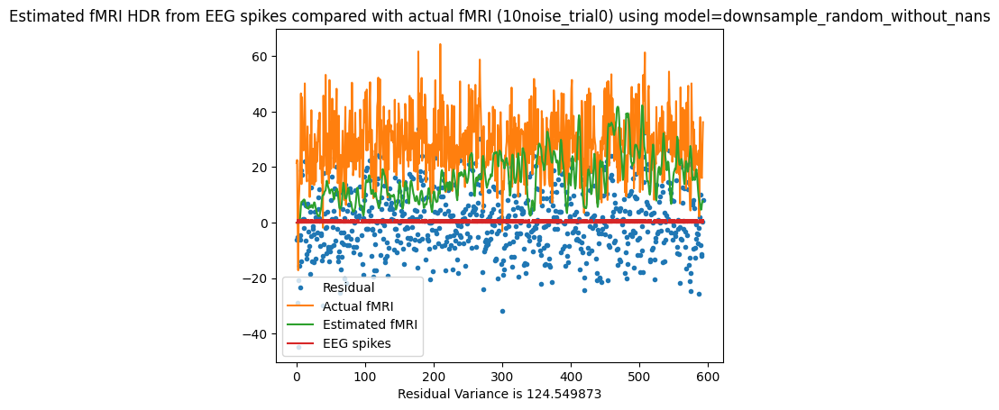

Residual Variance is 124.549873
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.64 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.78 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.95 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.84 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.98 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.90 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.13 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.14 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.14 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.20 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.16 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.43 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.16 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.15 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 17.59173992201532; at
      delta   tau  alpha
9470    3.0  1.75   2.25


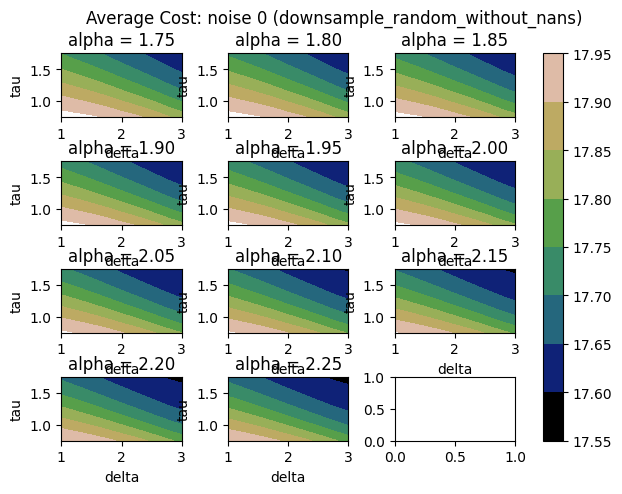

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 18.59301147857735; at
      delta   tau  alpha
9470    3.0  1.75   2.25


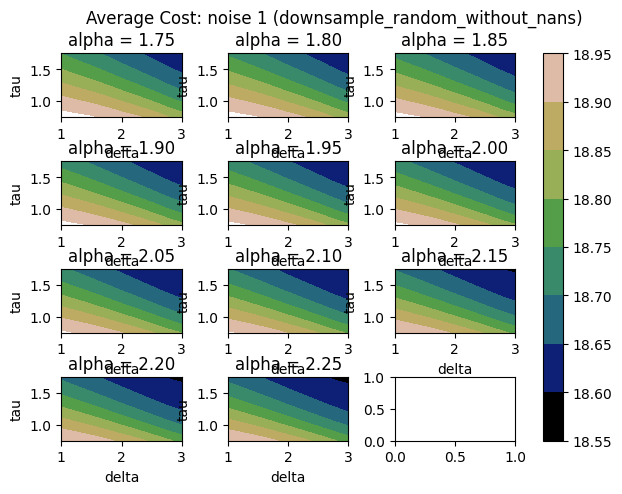

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 33.35849720889033; at
      delta   tau  alpha
9470    3.0  1.75   2.25


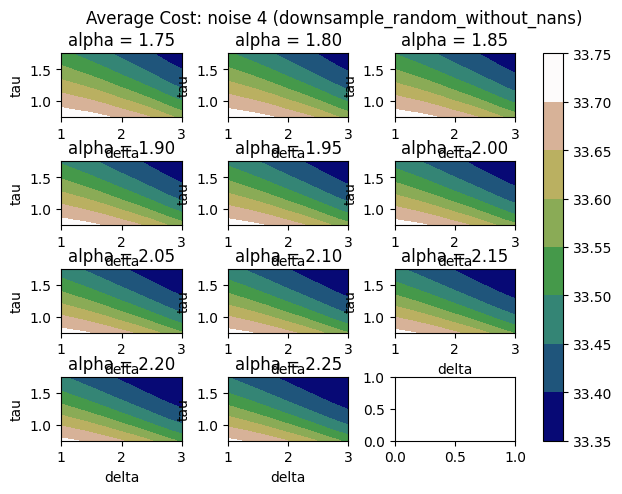

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 66.40759734663911; at
      delta   tau  alpha
9470    3.0  1.75   2.25


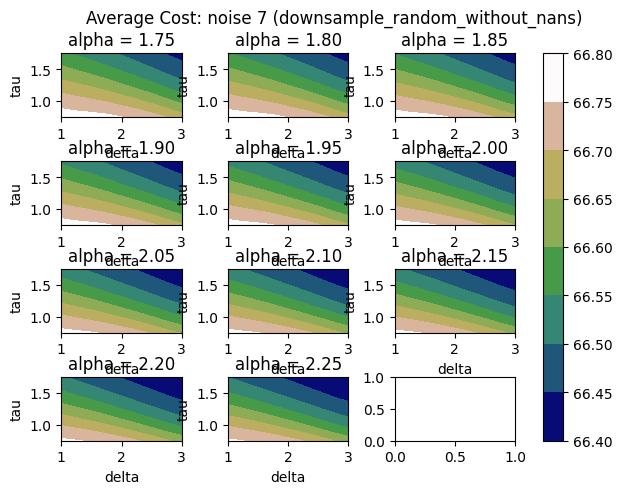

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 116.97393447693999; at
      delta   tau  alpha
9470    3.0  1.75   2.25


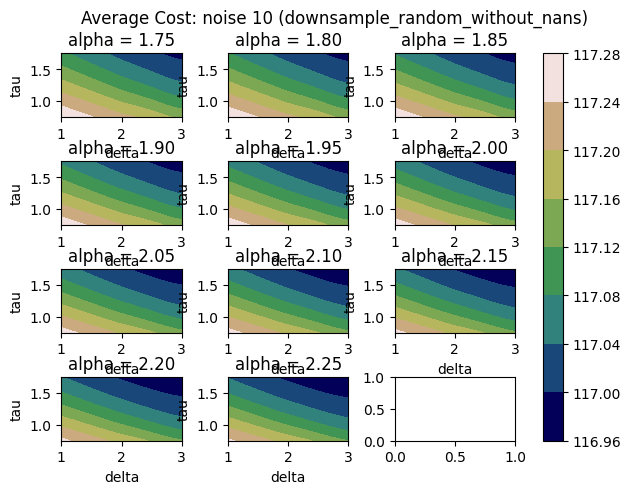

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 187.29523714896916; at
      delta   tau  alpha
7853   2.65  1.75   2.25


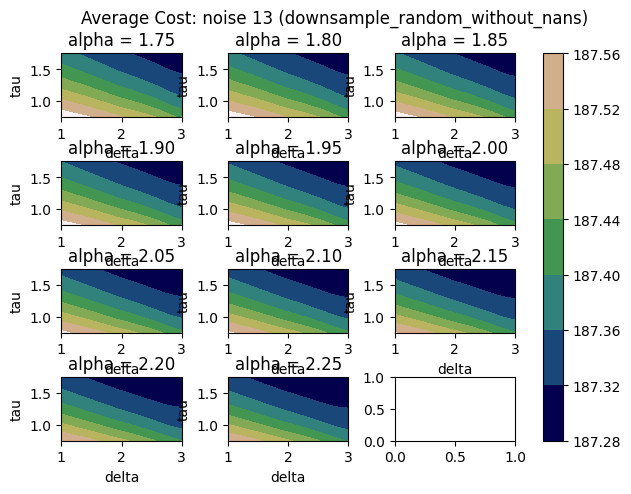

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


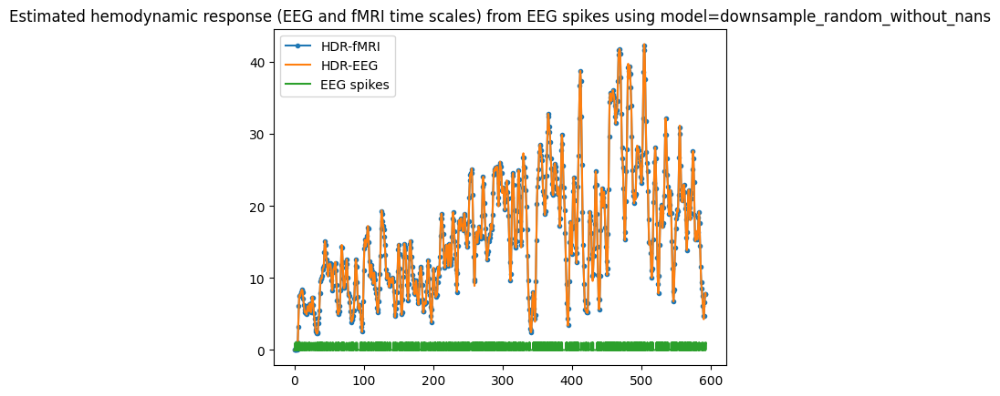

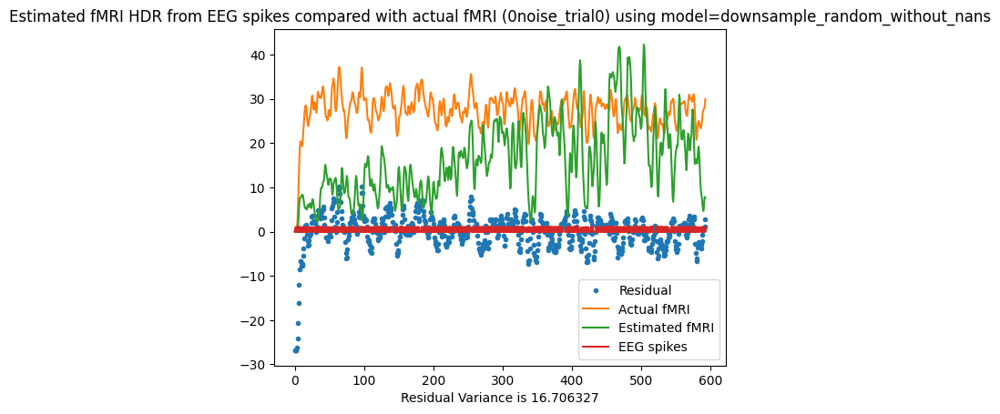

Residual Variance is 16.706327


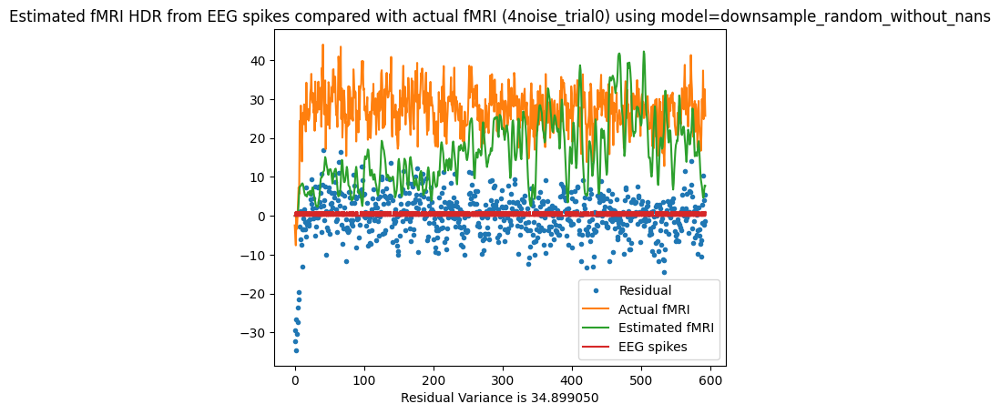

Residual Variance is 34.899050


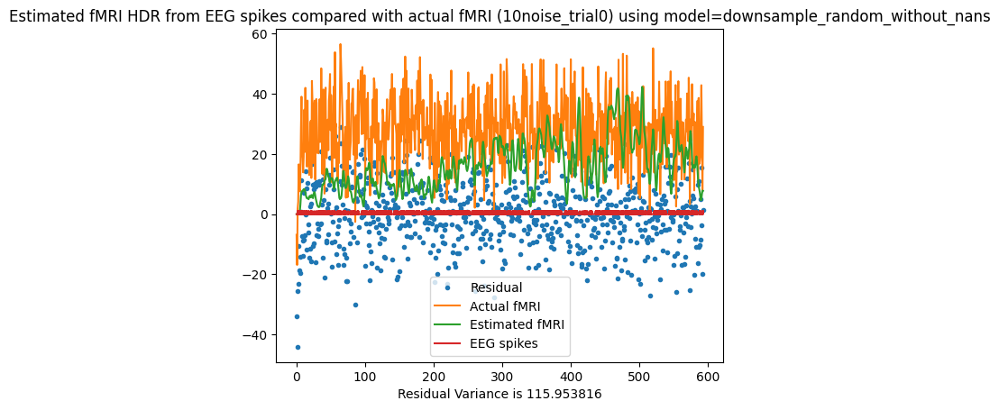

Residual Variance is 115.953816
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.73 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.85 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 2.06 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.96 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.07 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.01 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.09 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.95 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.16 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.06 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.19 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.22 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.09 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.16 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 16.681372820519297; at
      delta  tau  alpha
9459    3.0  1.7   2.25


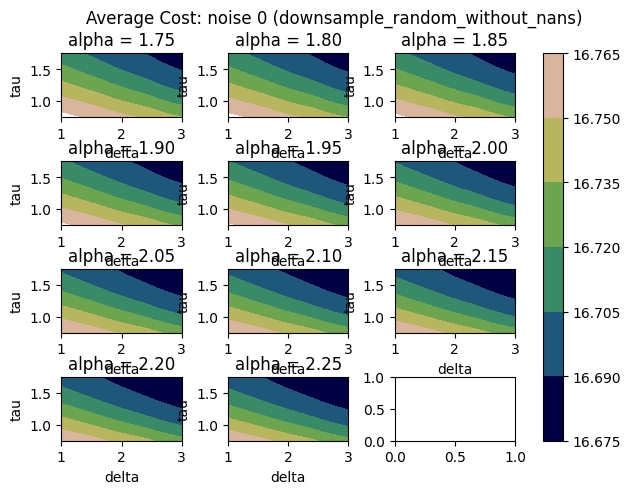

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 17.734318761796974; at
      delta  tau  alpha
9459    3.0  1.7   2.25


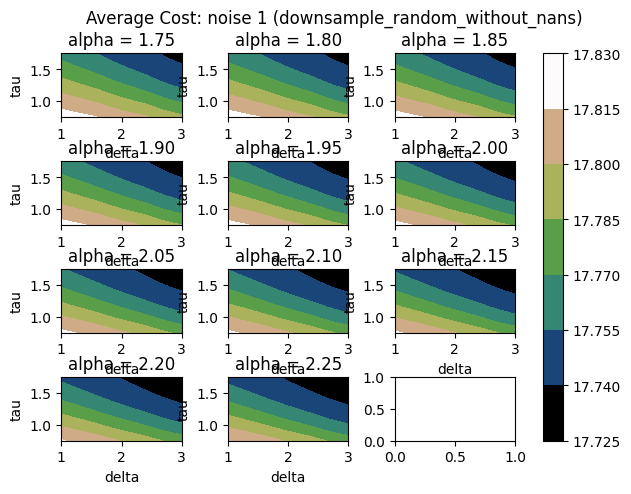

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 32.73220654752194; at
      delta   tau  alpha
9008    2.9  1.75   2.25


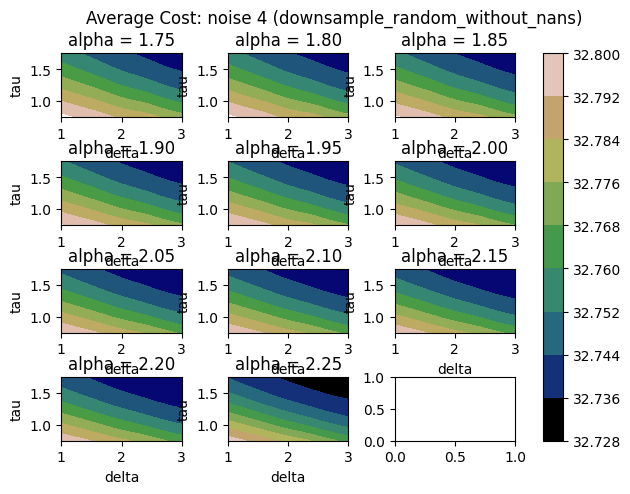

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 65.74539918712274; at
      delta   tau  alpha
7831   2.65  1.65   2.25


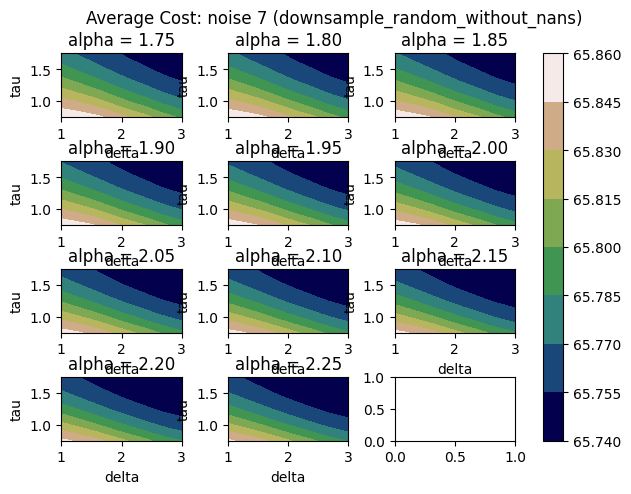

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 118.03842293501145; at
      delta   tau  alpha
9448    3.0  1.65   2.25


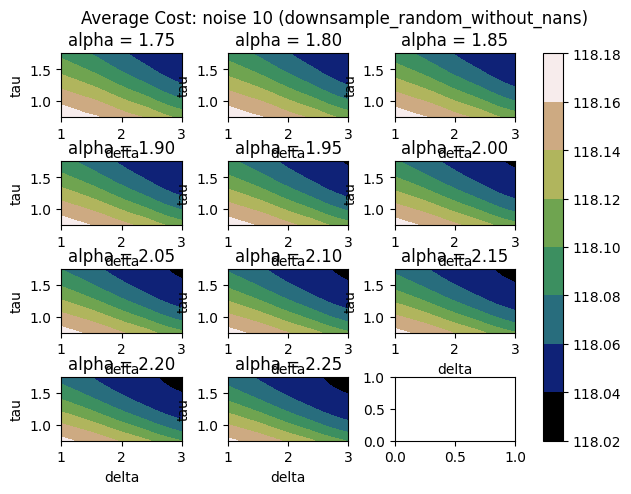

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 185.9958777565566; at
      delta   tau  alpha
9470    3.0  1.75   2.25


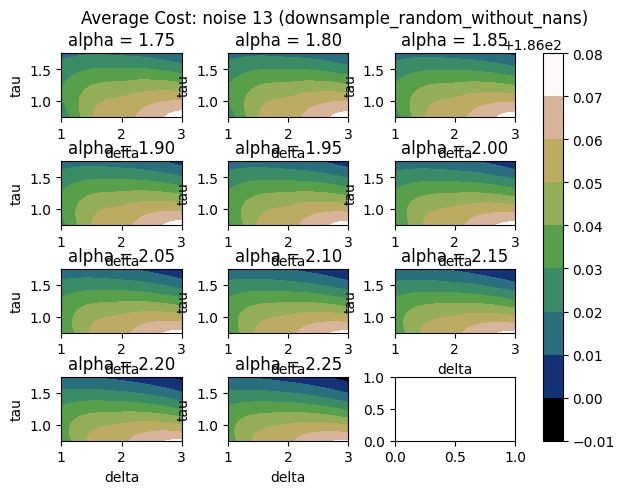

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


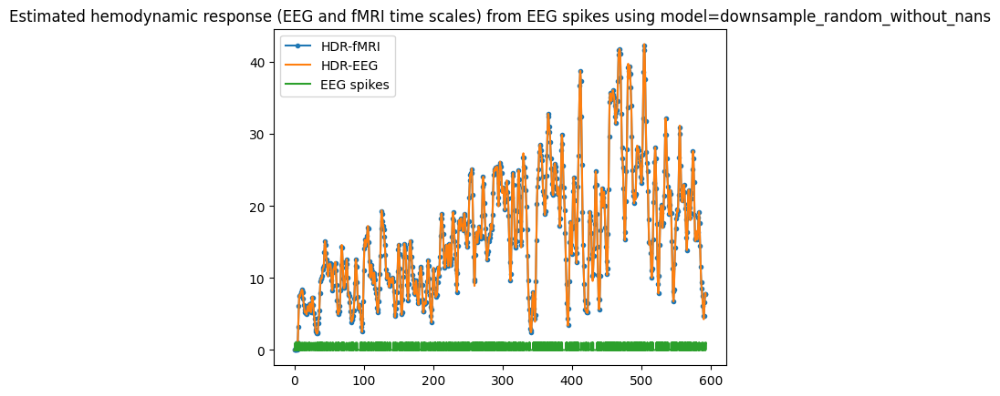

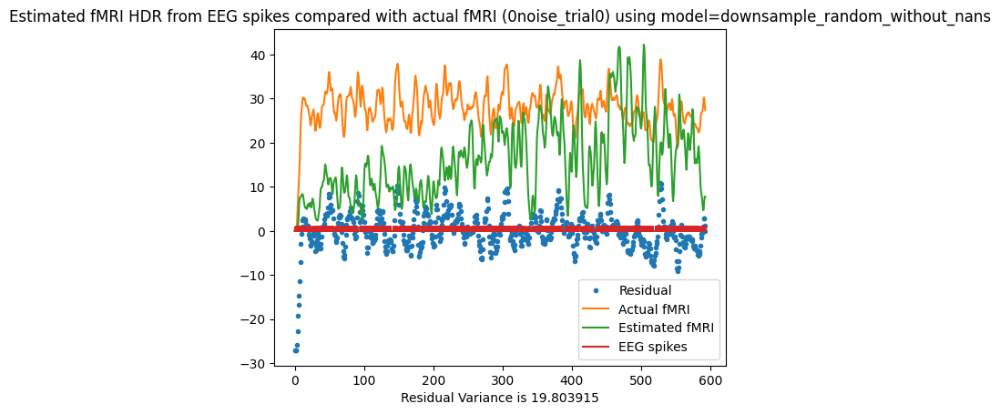

Residual Variance is 19.803915


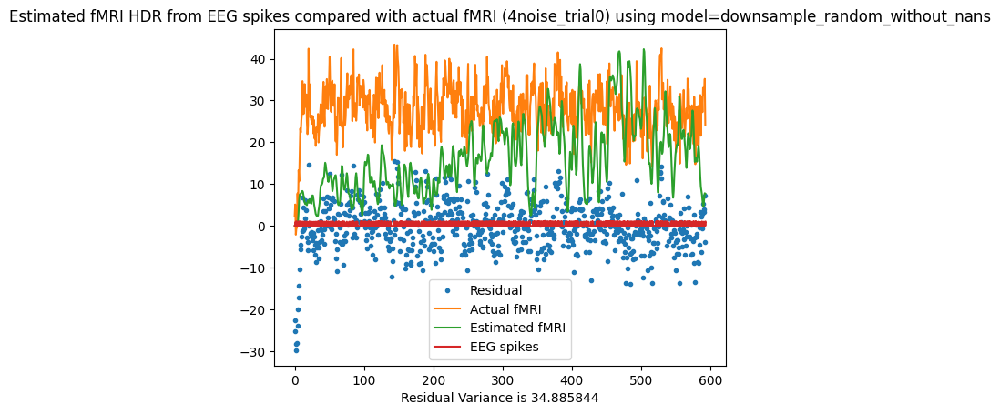

Residual Variance is 34.885844


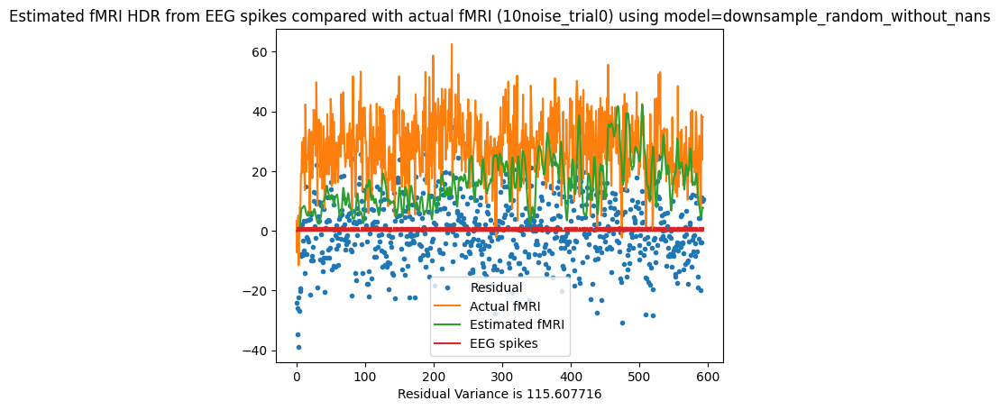

Residual Variance is 115.607716
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.65 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.66 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.77 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 2.23 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.22 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.26 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.44 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.26 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.14 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.11 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.16 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.09 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.01 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.09 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 19.715014252442497; at
    delta   tau  alpha
44    1.0  0.95   1.75


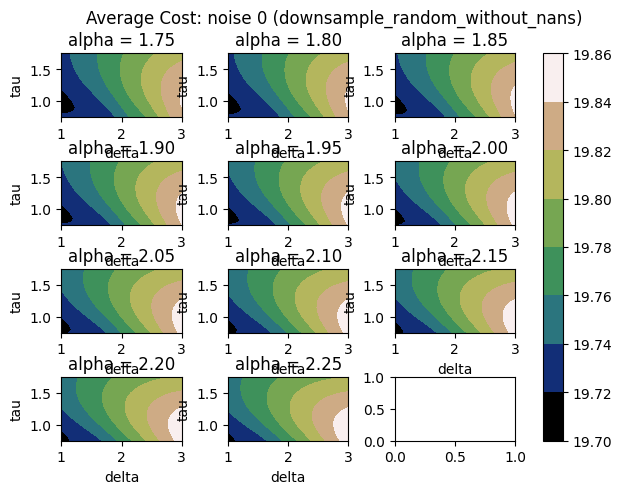

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 20.690778752746496; at
    delta  tau  alpha
55    1.0  1.0   1.75


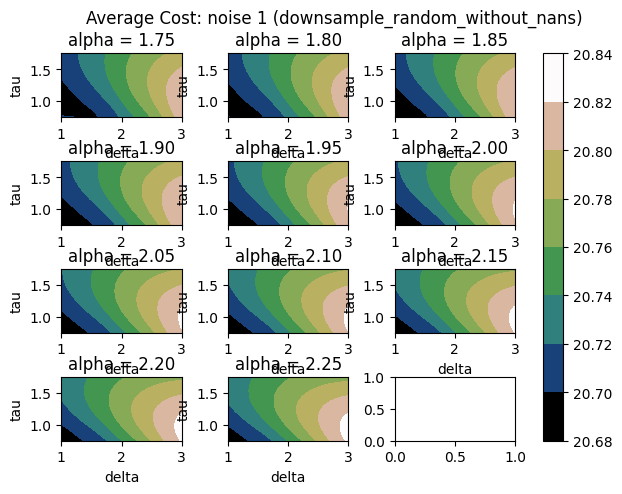

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 35.72967889513626; at
    delta  tau  alpha
77    1.0  1.1   1.75


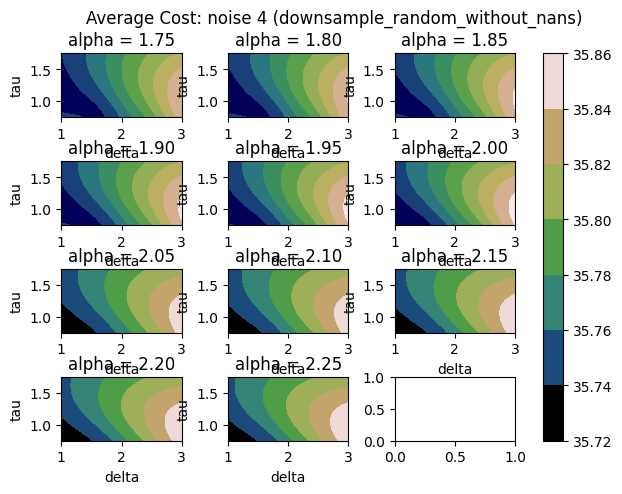

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 68.62725235837124; at
    delta  tau  alpha
55    1.0  1.0   1.75


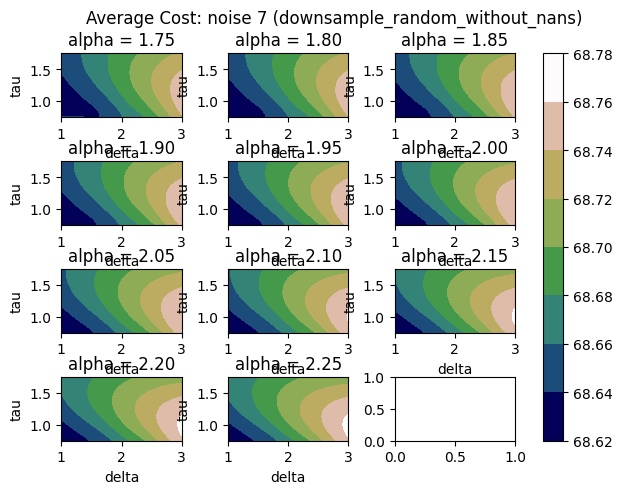

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 119.59234430915032; at
      delta   tau  alpha
3003   1.65  0.75   1.75


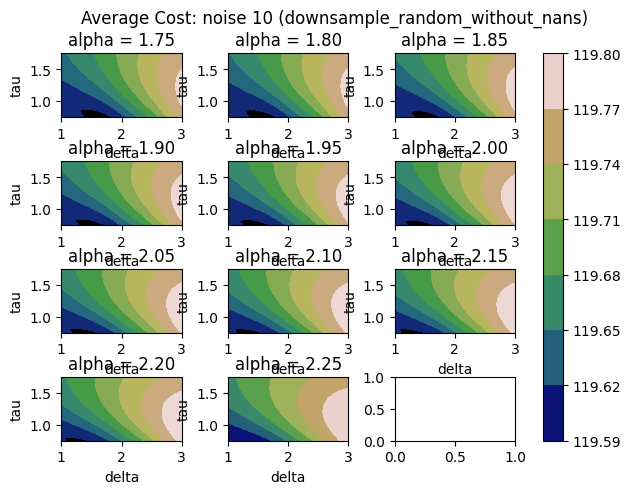

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 187.96400352678197; at
    delta  tau  alpha
12    1.0  0.8    1.8


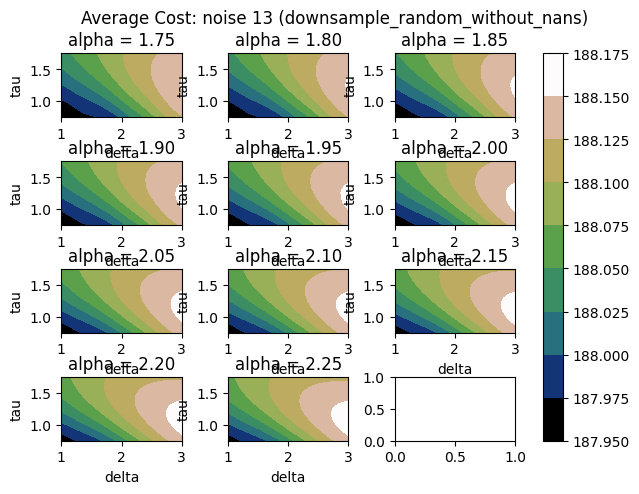

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


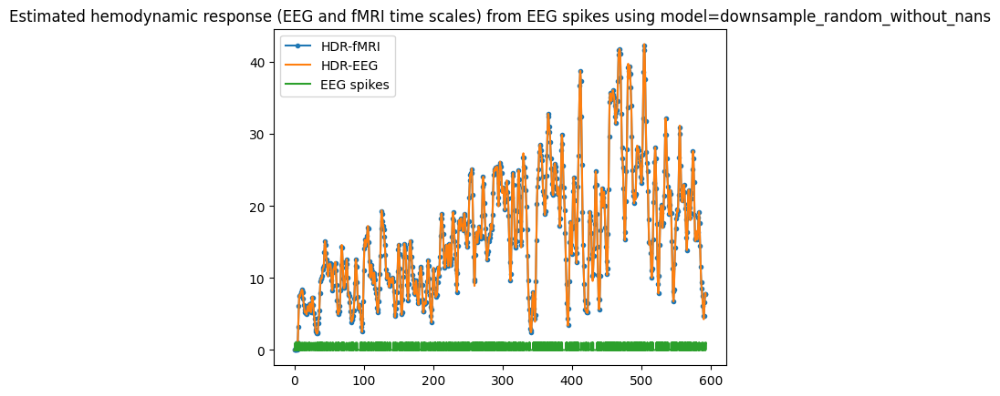

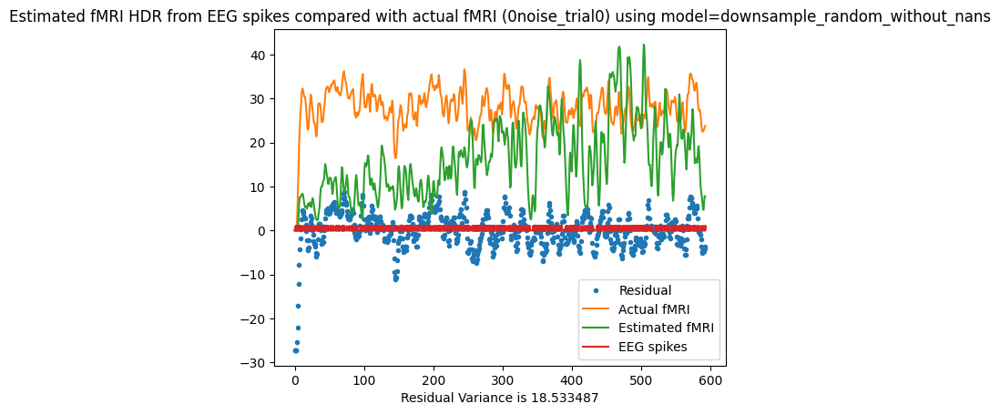

Residual Variance is 18.533487


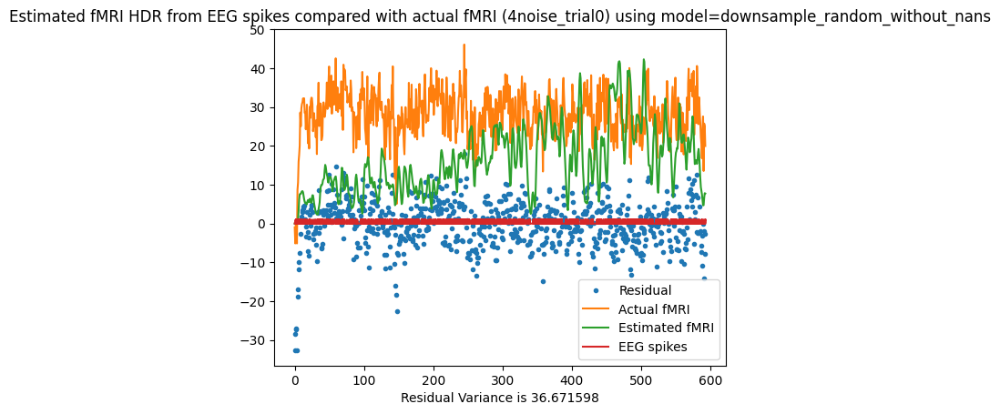

Residual Variance is 36.671598


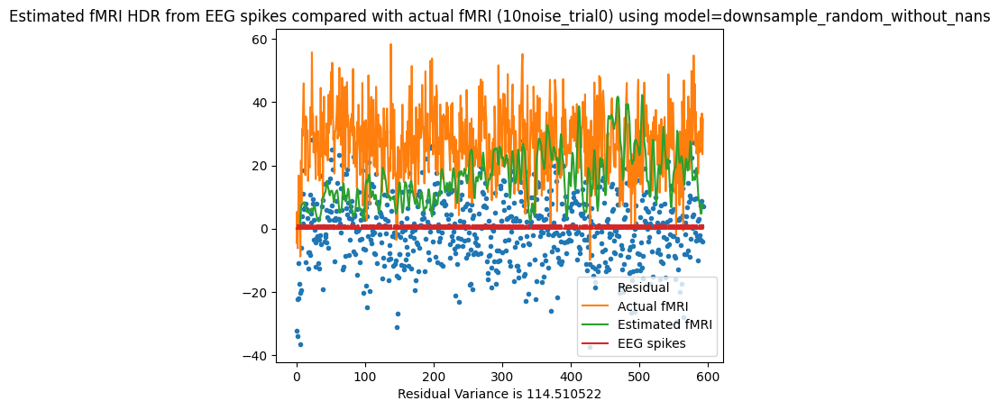

Residual Variance is 114.510522
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.65 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.73 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.79 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.87 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.86 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.97 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.97 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.91 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.95 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.10 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.71 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.29 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.15 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.15 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 18.5233984076604; at
      delta   tau  alpha
7193   2.55  0.85   2.25


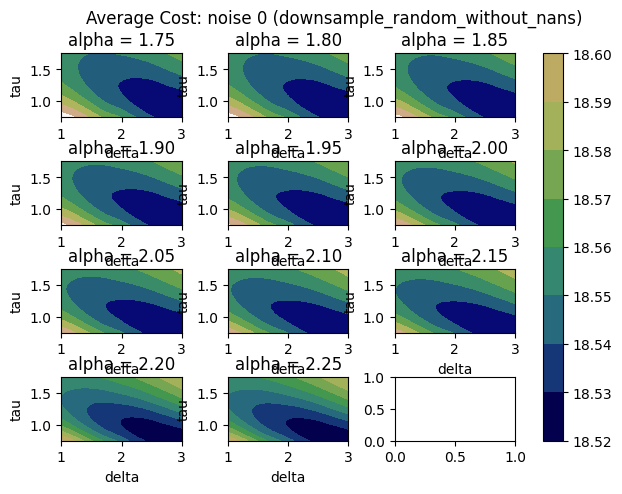

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 19.488172374959195; at
      delta   tau  alpha
9250    3.0  0.75   2.25


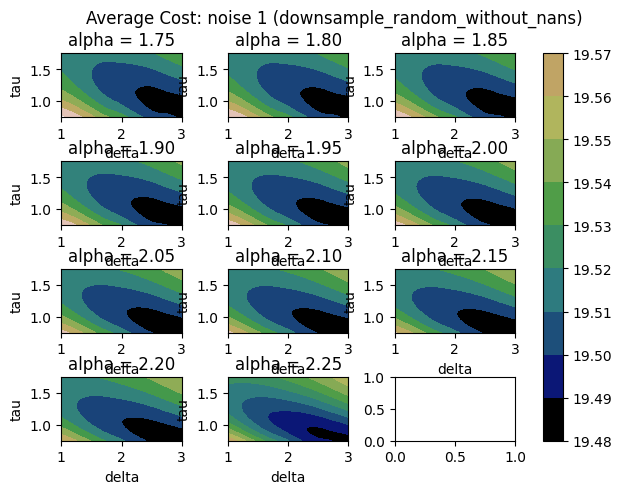

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 34.54667793690342; at
      delta   tau  alpha
9250    3.0  0.75   2.25


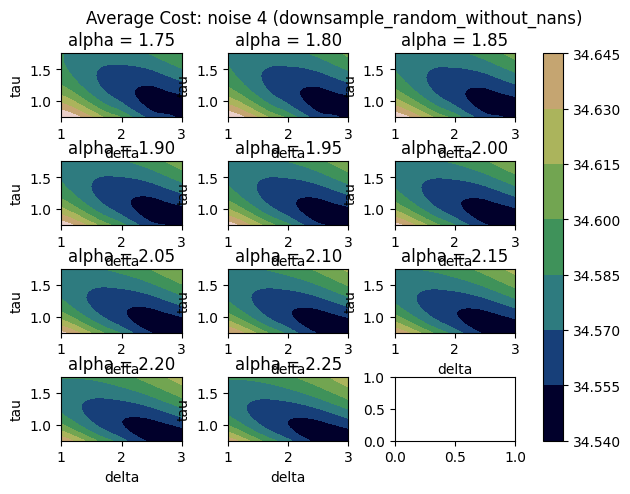

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 67.37986667904265; at
      delta   tau  alpha
9272    3.0  0.85   2.25


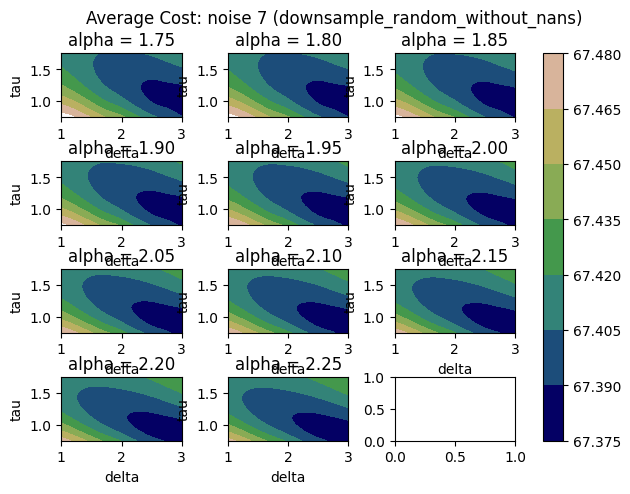

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 117.5828017073011; at
      delta  tau  alpha
9261    3.0  0.8   2.25


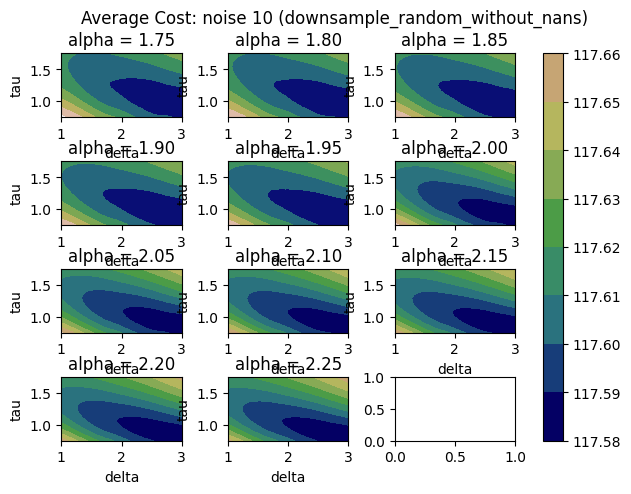

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 186.61083253342812; at
      delta   tau  alpha
6831   2.45  1.35   1.75


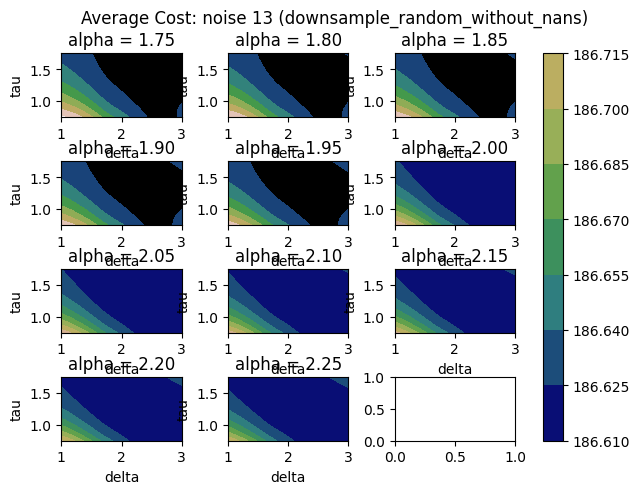

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


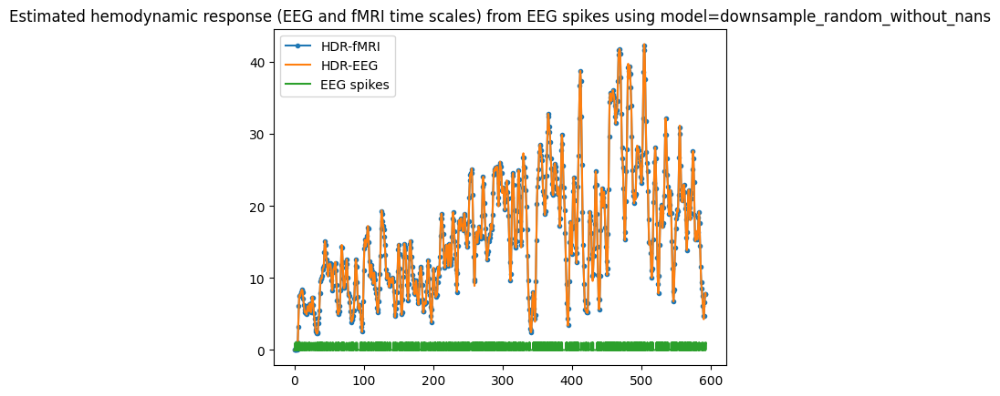

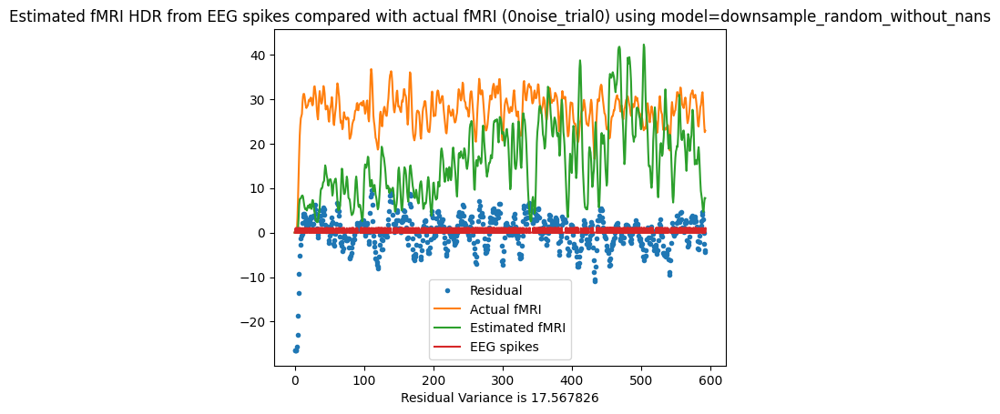

Residual Variance is 17.567826


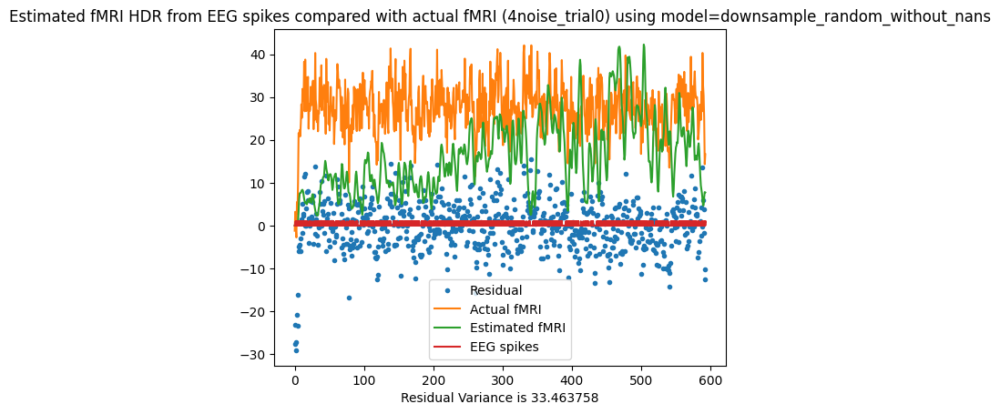

Residual Variance is 33.463758


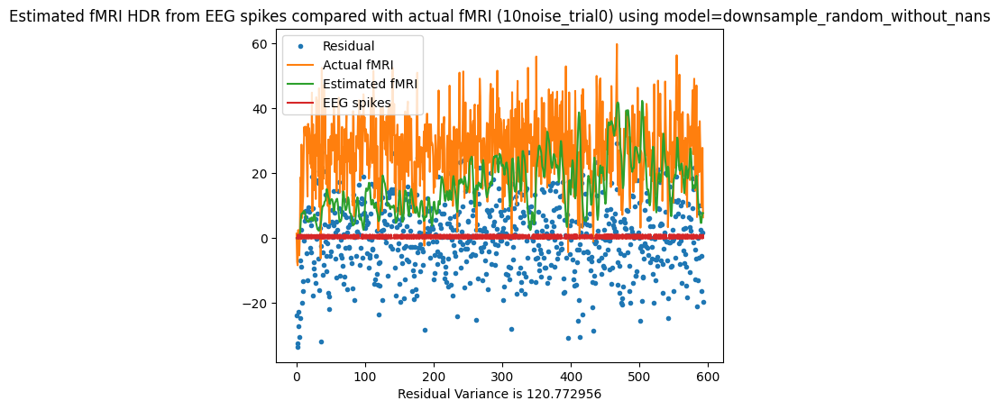

Residual Variance is 120.772956
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.86 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 2.00 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 2.04 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 2.01 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.02 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.05 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.14 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.06 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.01 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.99 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.00 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.99 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.06 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 1.94 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 17.524963390912088; at
      delta   tau  alpha
9460    3.0  1.75   1.75


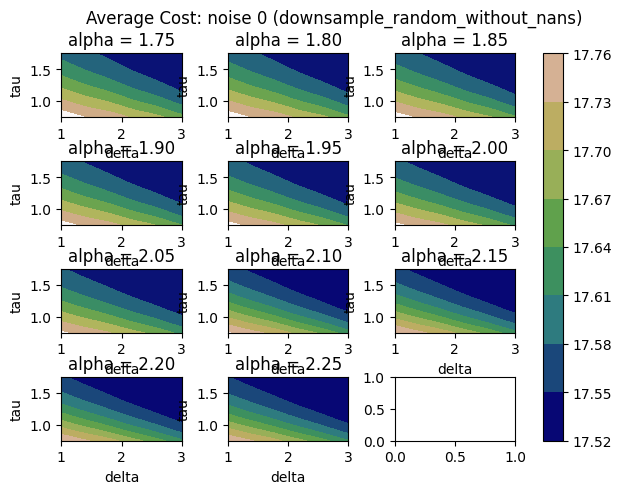

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 18.515712112377567; at
      delta   tau  alpha
9460    3.0  1.75   1.75


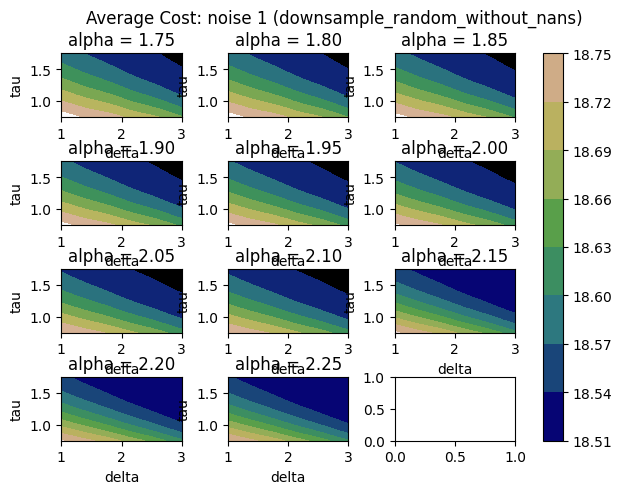

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 33.53469114779313; at
      delta   tau  alpha
7391   2.55  1.75   2.25


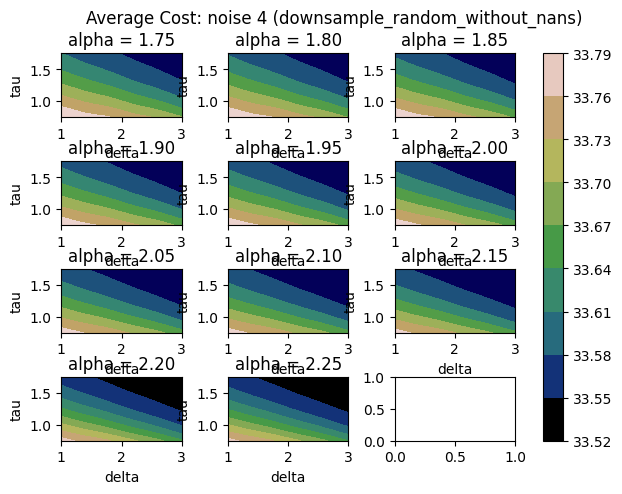

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 66.54514212709421; at
      delta   tau  alpha
9460    3.0  1.75   1.75


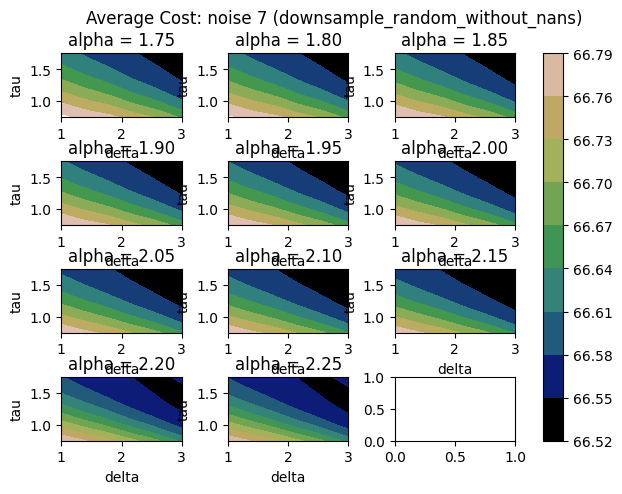

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 118.5519723653856; at
      delta   tau  alpha
9463    3.0  1.75    1.9


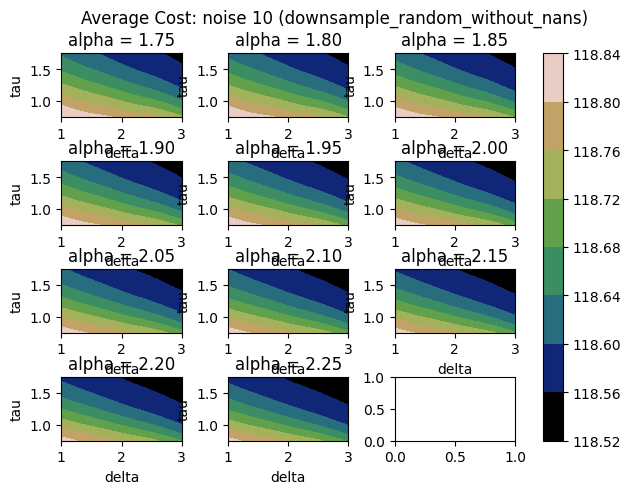

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 187.45442704965137; at
      delta   tau  alpha
7853   2.65  1.75   2.25


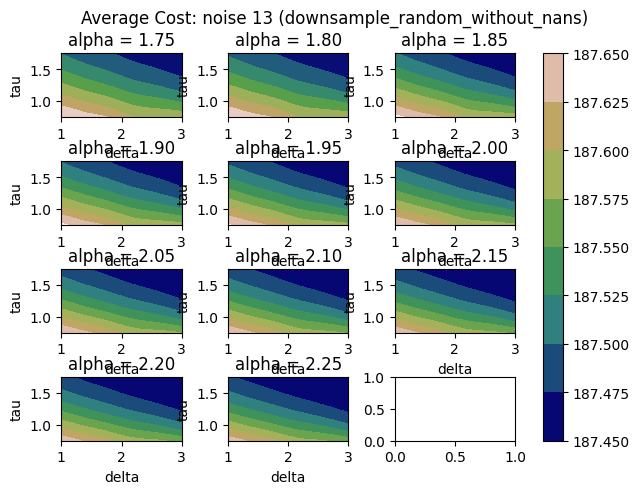

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


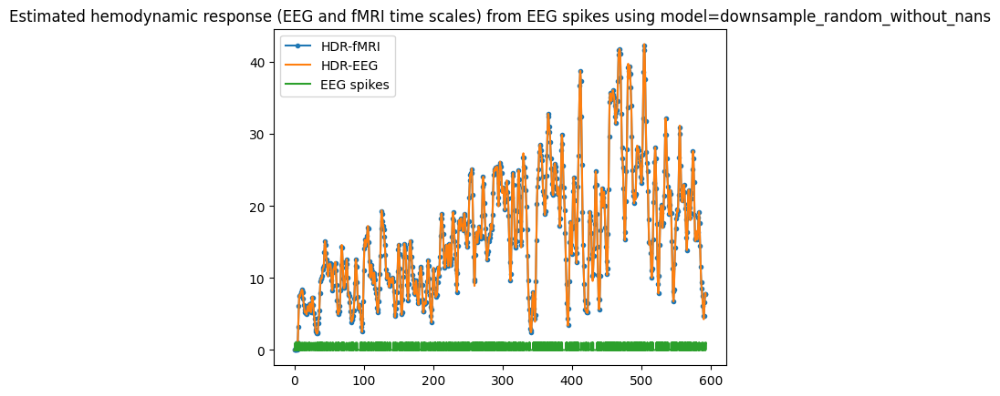

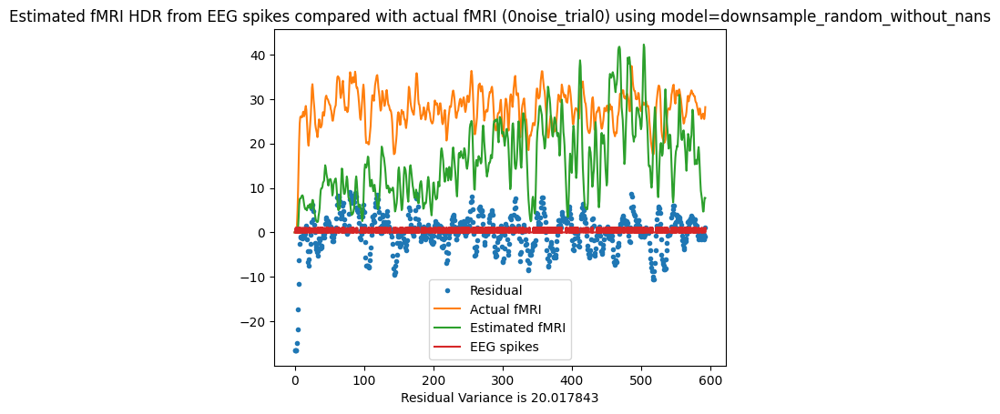

Residual Variance is 20.017843


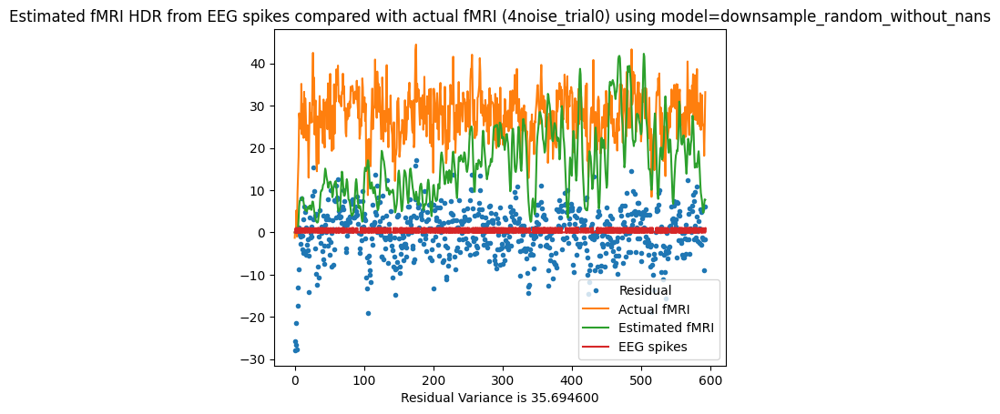

Residual Variance is 35.694600


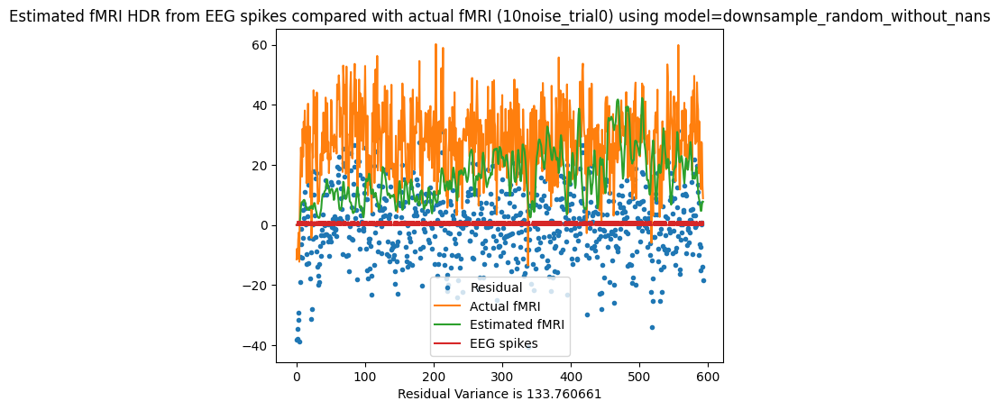

Residual Variance is 133.760661
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.73 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.84 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.96 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.98 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.00 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.02 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.01 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.05 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.05 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.03 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.02 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.05 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.12 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.16 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 19.743572197140775; at
      delta   tau  alpha
9470    3.0  1.75   2.25


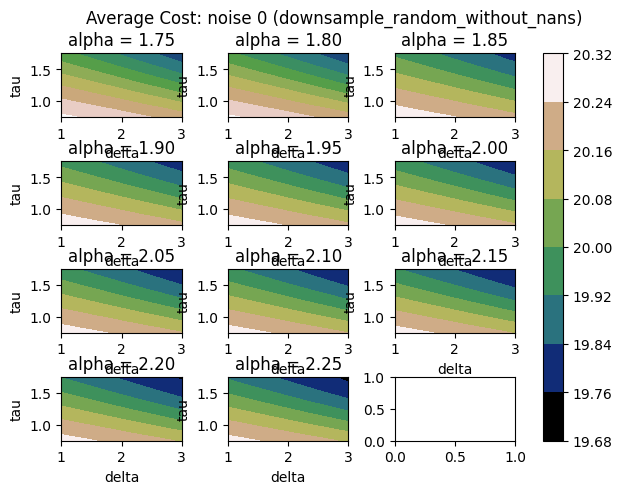

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 20.723375391467613; at
      delta   tau  alpha
9470    3.0  1.75   2.25


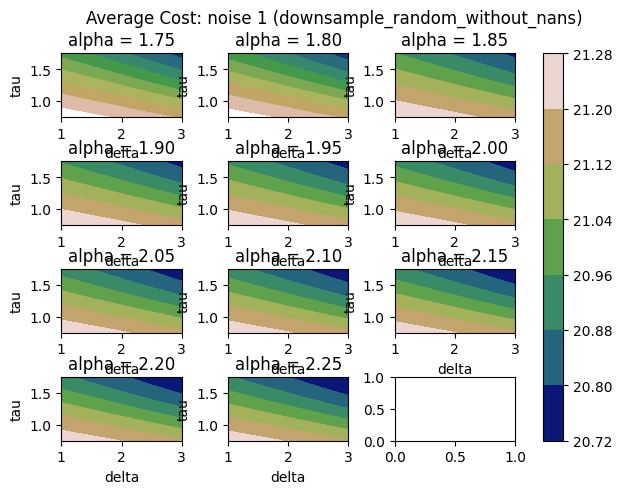

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 36.04548267795934; at
      delta   tau  alpha
9470    3.0  1.75   2.25


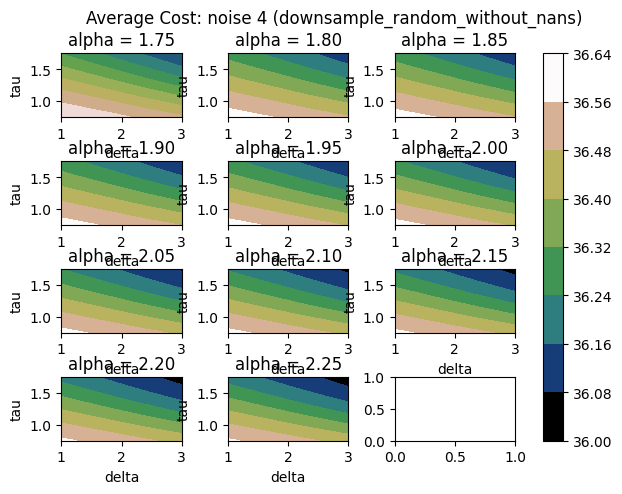

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 68.89647428705379; at
      delta   tau  alpha
9470    3.0  1.75   2.25


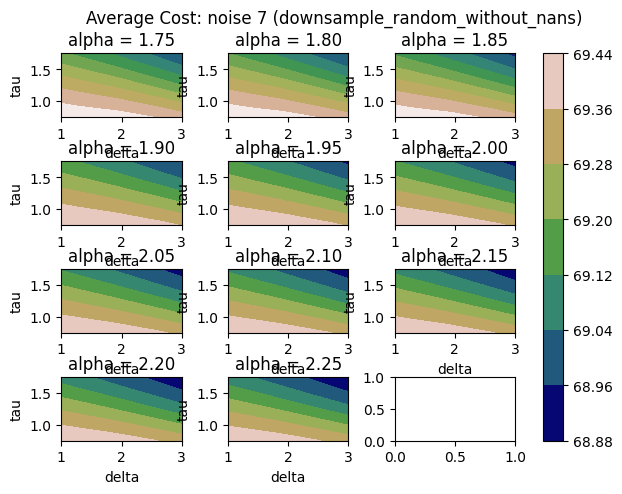

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 120.10899188223277; at
      delta   tau  alpha
9470    3.0  1.75   2.25


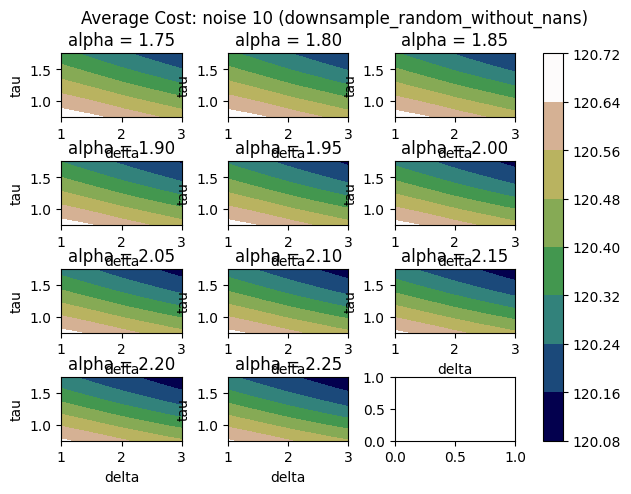

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 189.3050913640597; at
      delta   tau  alpha
9470    3.0  1.75   2.25


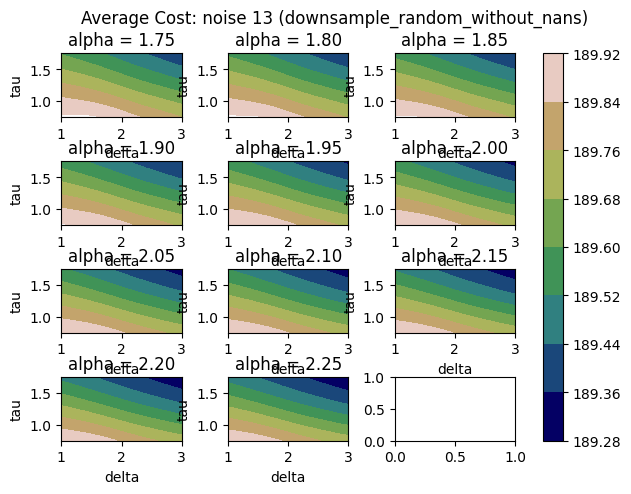

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


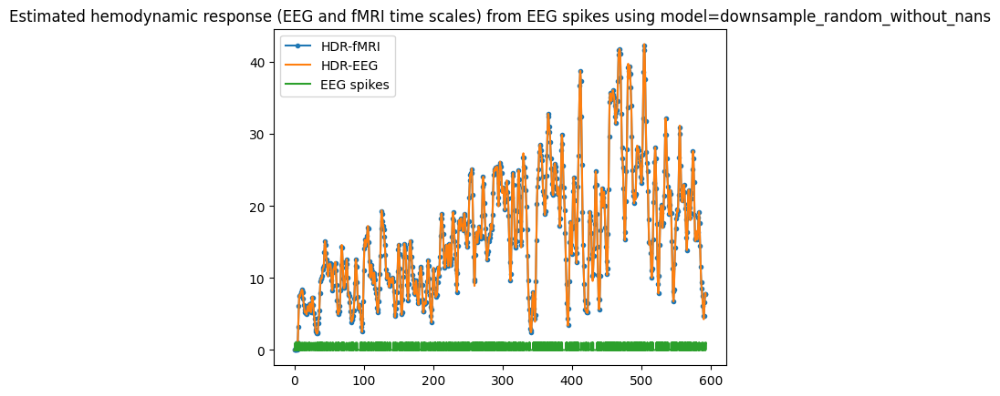

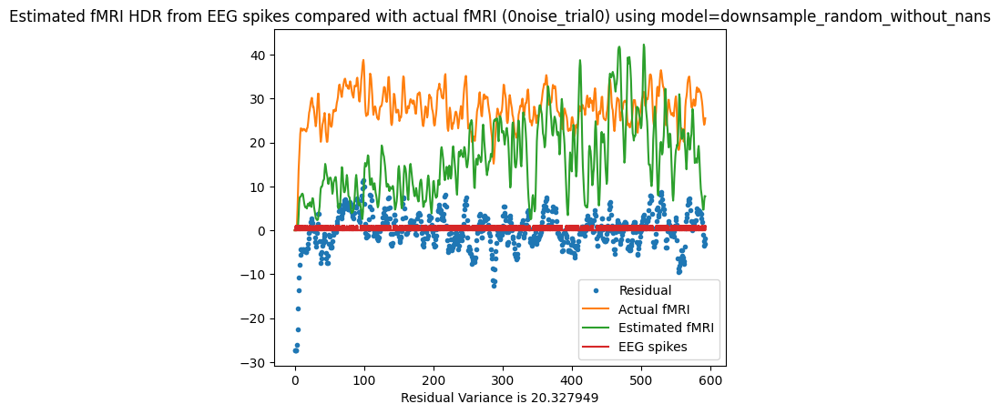

Residual Variance is 20.327949


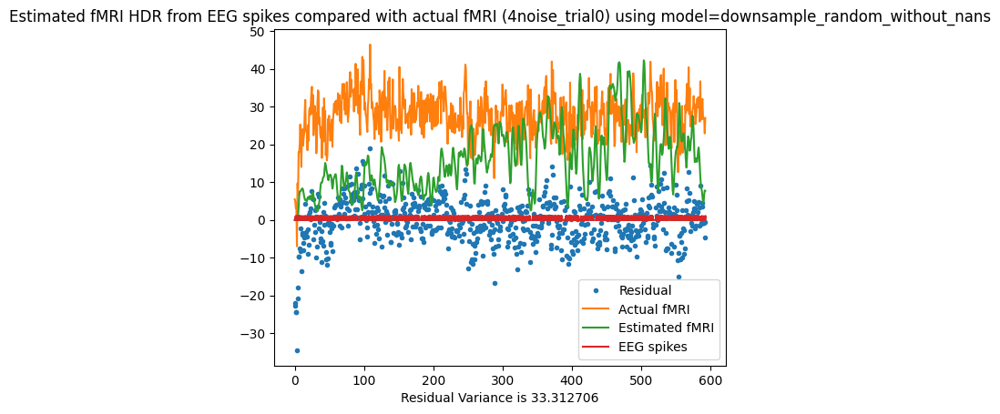

Residual Variance is 33.312706


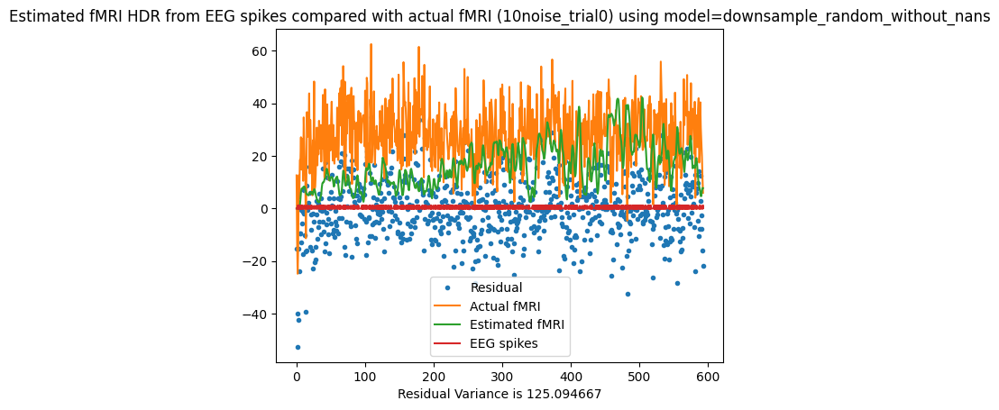

Residual Variance is 125.094667
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.66 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 2.20 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 2.03 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 2.00 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 2.02 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 2.06 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.01 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.19 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.14 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 2.05 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 2.02 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.05 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.07 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.26 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 20.22906253954813; at
      delta   tau  alpha
9470    3.0  1.75   2.25


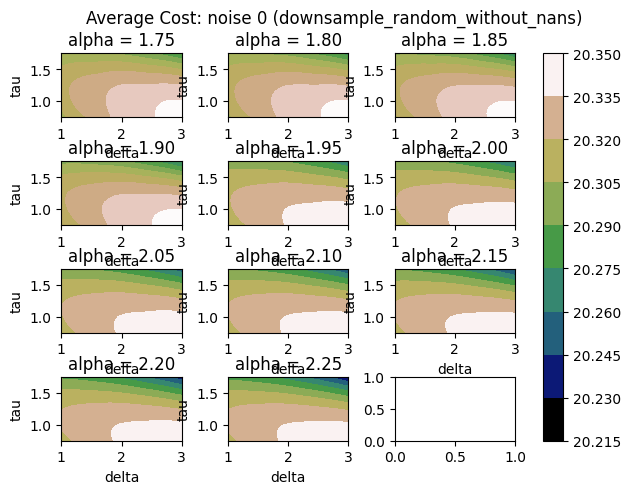

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 21.24471522917039; at
      delta   tau  alpha
9470    3.0  1.75   2.25


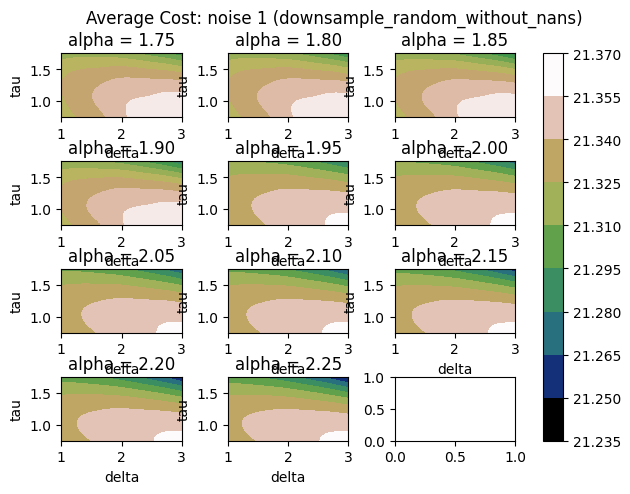

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 36.27987987525894; at
      delta   tau  alpha
9470    3.0  1.75   2.25


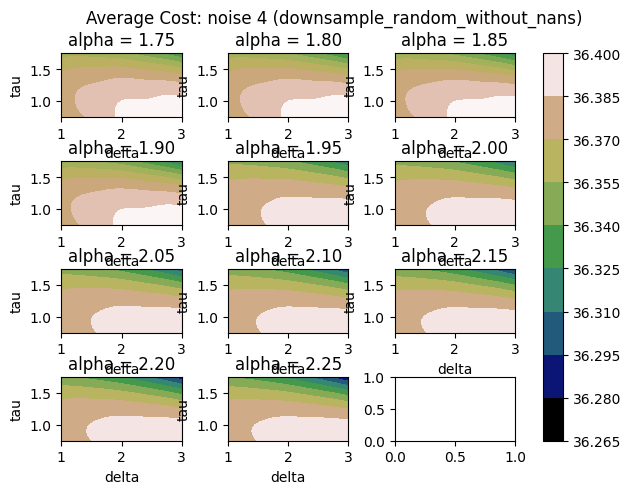

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 68.9598958107261; at
      delta   tau  alpha
9470    3.0  1.75   2.25


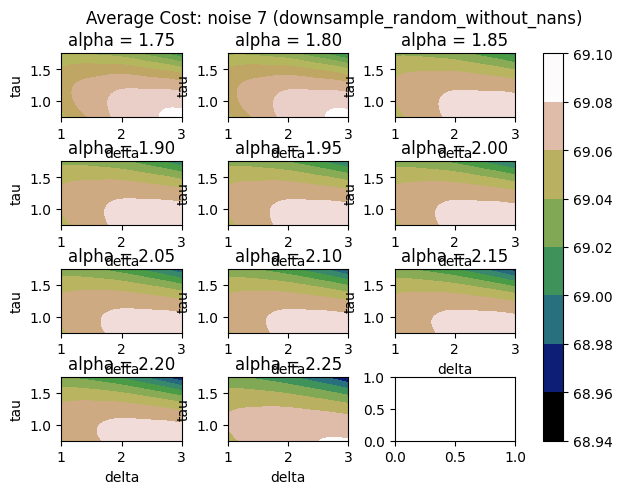

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 121.40610858658661; at
      delta   tau  alpha
9470    3.0  1.75   2.25


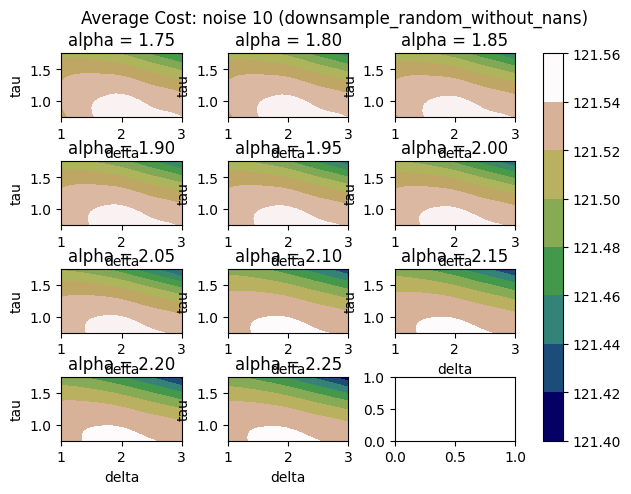

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 189.4919140926221; at
      delta   tau  alpha
9470    3.0  1.75   2.25


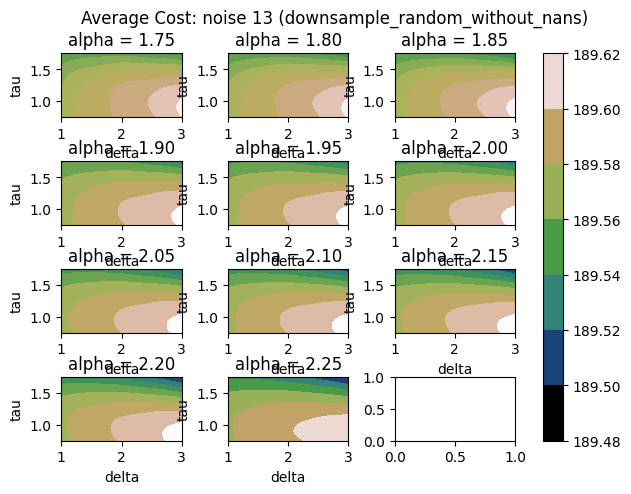

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


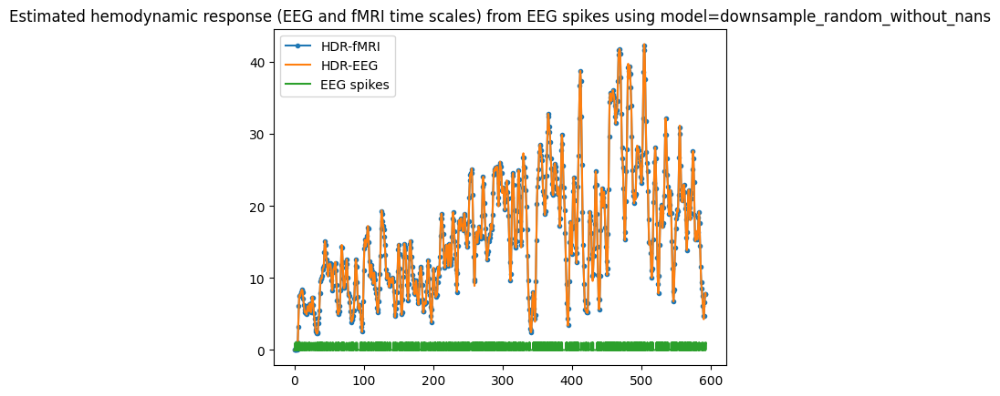

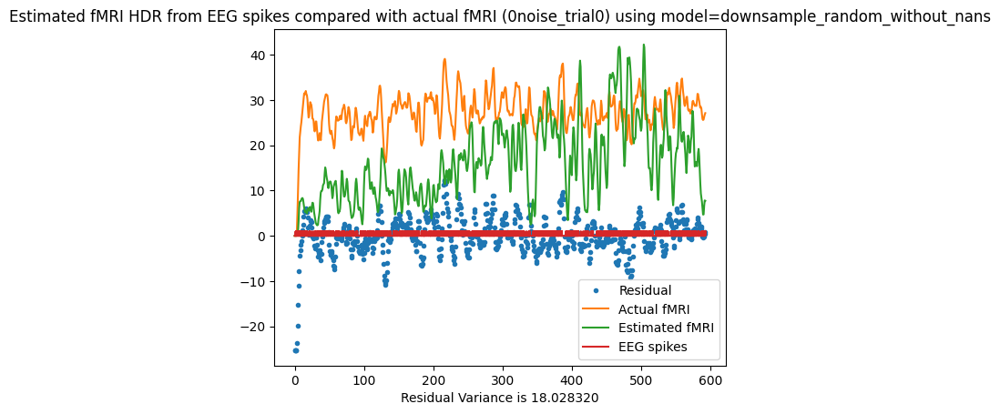

Residual Variance is 18.028320


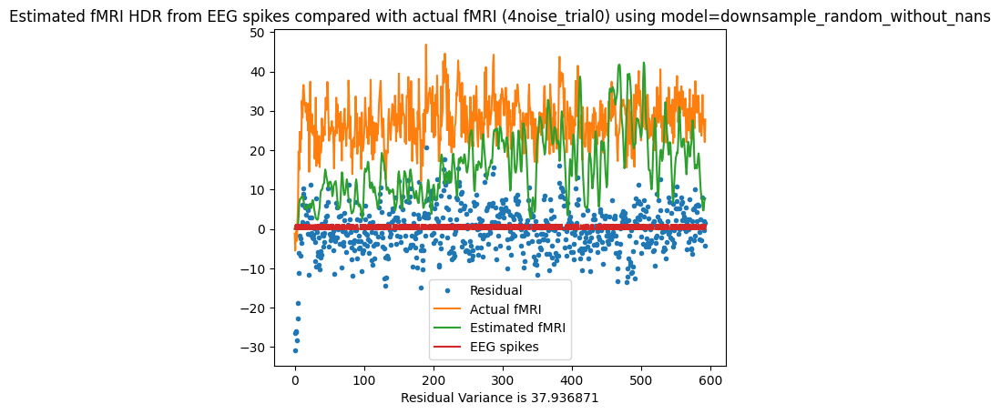

Residual Variance is 37.936871


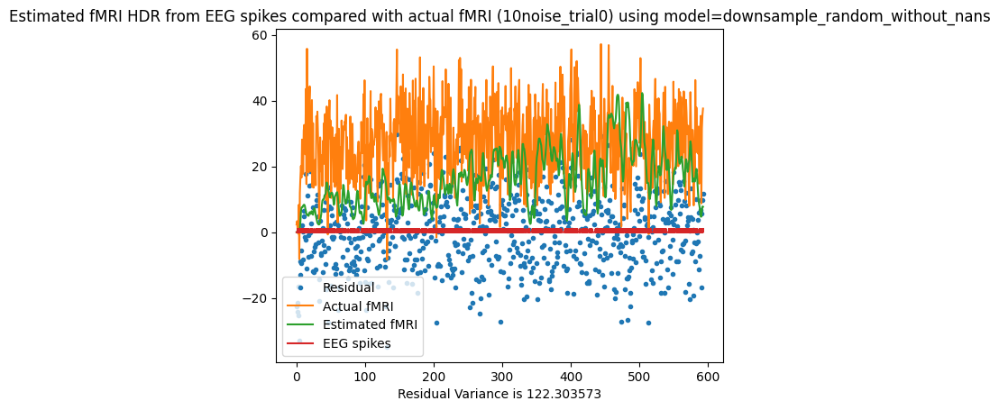

Residual Variance is 122.303573
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.49 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.54 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.65 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.72 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.82 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.89 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.89 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.89 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.89 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.89 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.90 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.90 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 1.96 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 1.95 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 17.86335129344328; at
     delta   tau  alpha
230    1.0  1.75   2.25


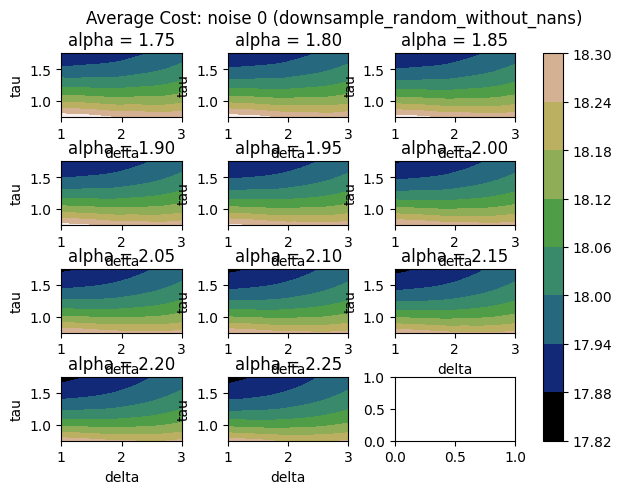

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 18.904633597881926; at
     delta   tau  alpha
230    1.0  1.75   2.25


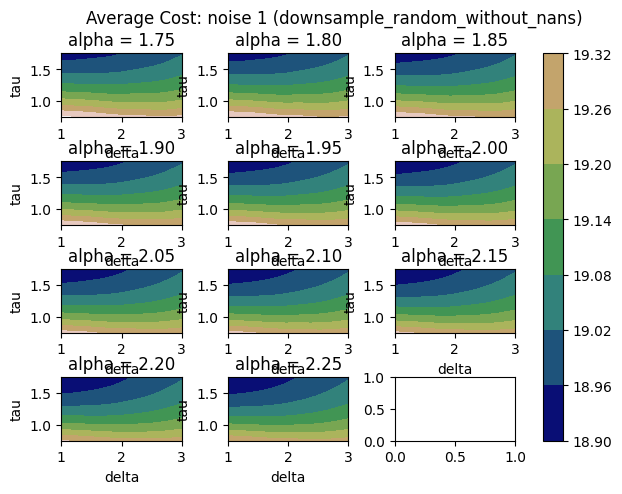

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 33.7518336918165; at
     delta   tau  alpha
230    1.0  1.75   2.25


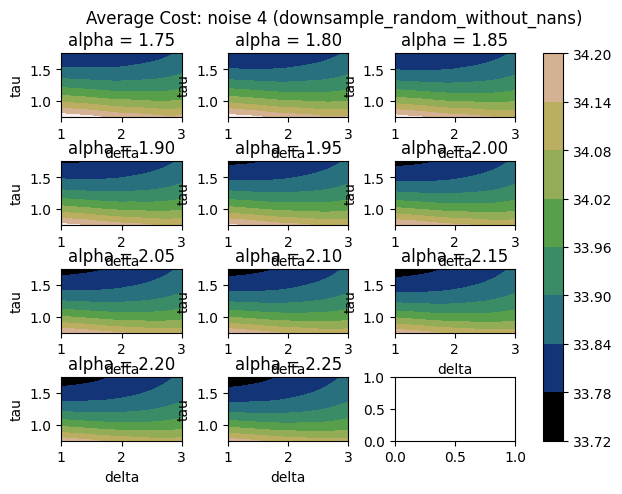

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 67.01053915788205; at
     delta   tau  alpha
230    1.0  1.75   2.25


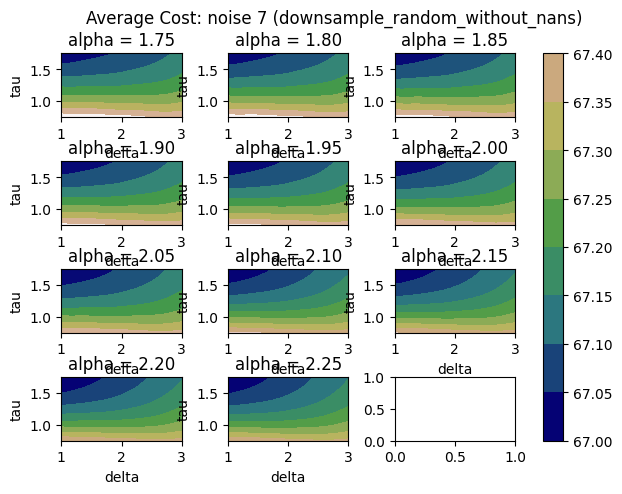

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 116.51803352622491; at
     delta   tau  alpha
230    1.0  1.75   2.25


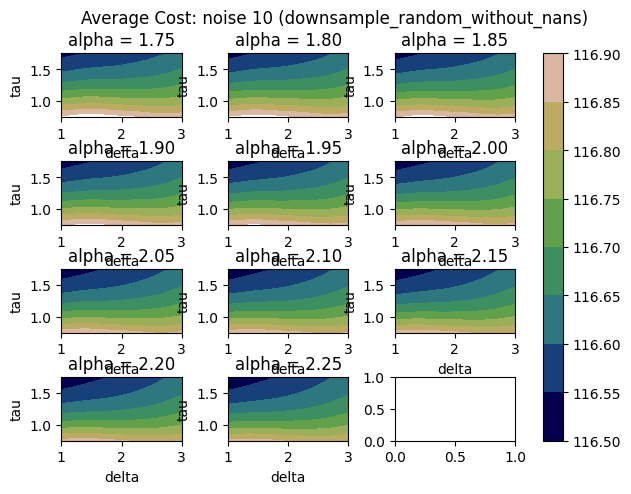

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 186.25098583912498; at
     delta   tau  alpha
222    1.0  1.75   1.85


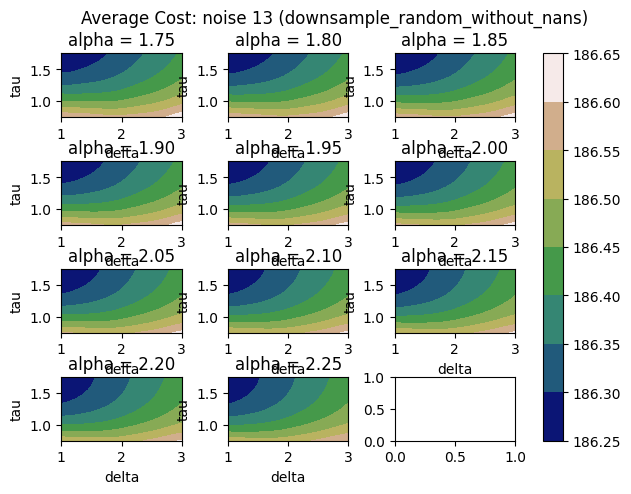

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


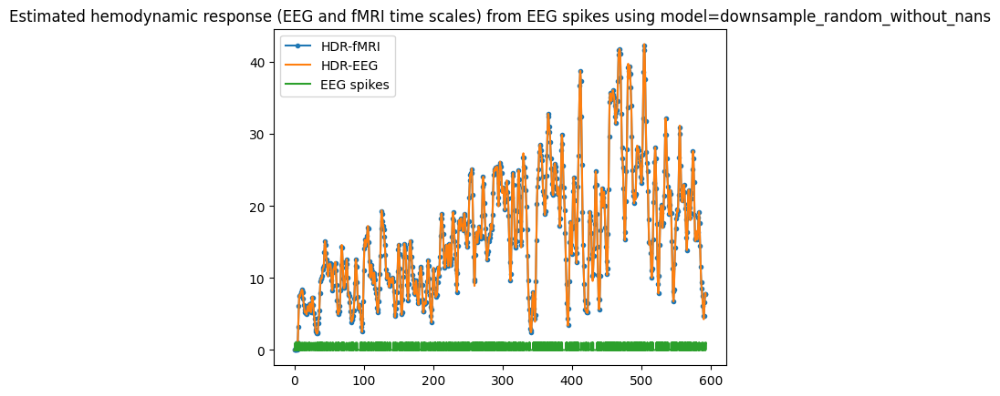

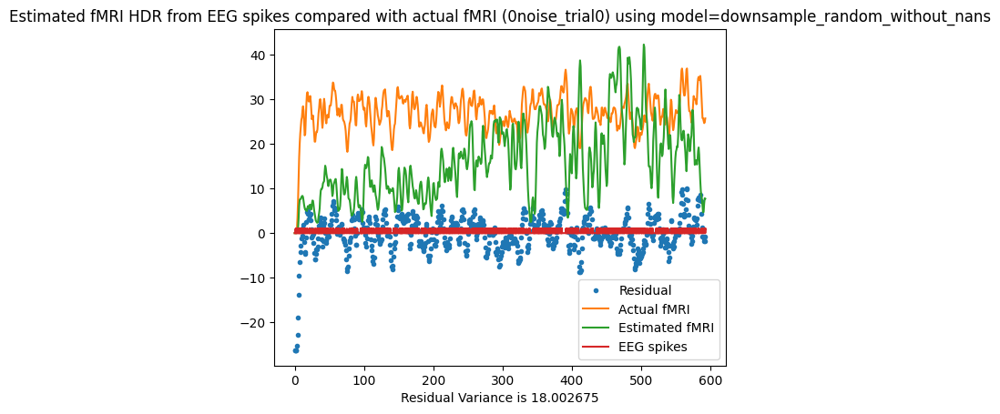

Residual Variance is 18.002675


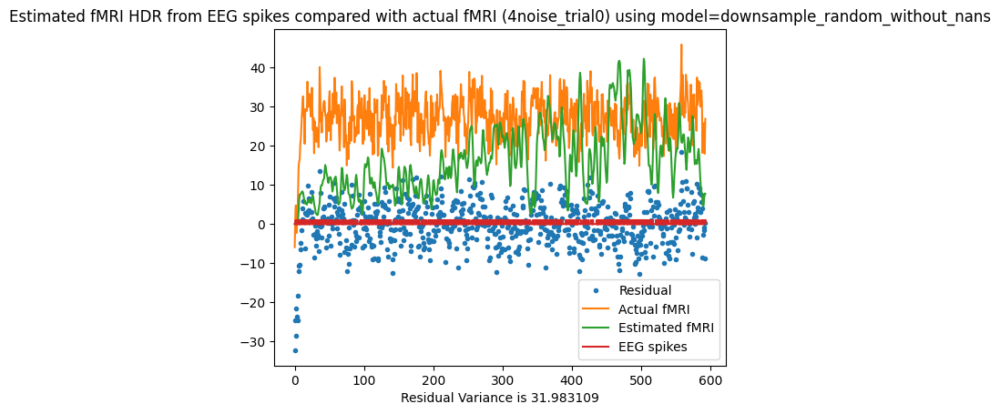

Residual Variance is 31.983109


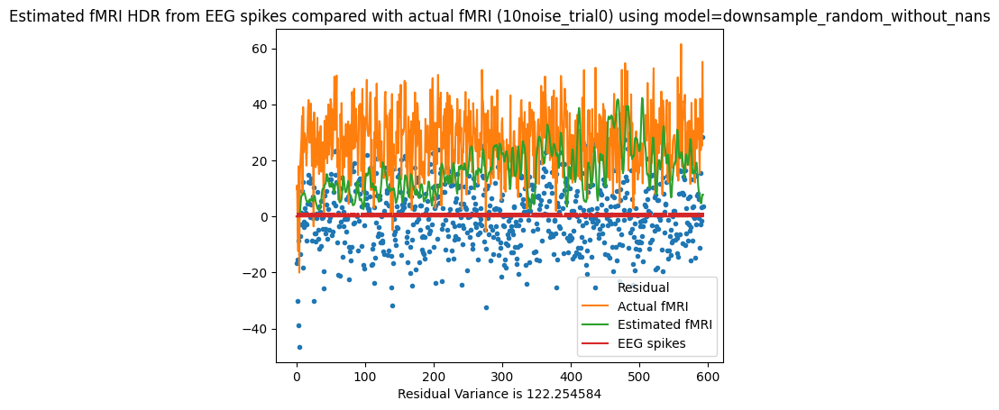

Residual Variance is 122.254584
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.63 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.66 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.78 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.83 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.88 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.89 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.90 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.89 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.90 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.98 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.92 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.95 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 1.99 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 1.98 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 17.8520196692065; at
      delta   tau  alpha
9470    3.0  1.75   2.25


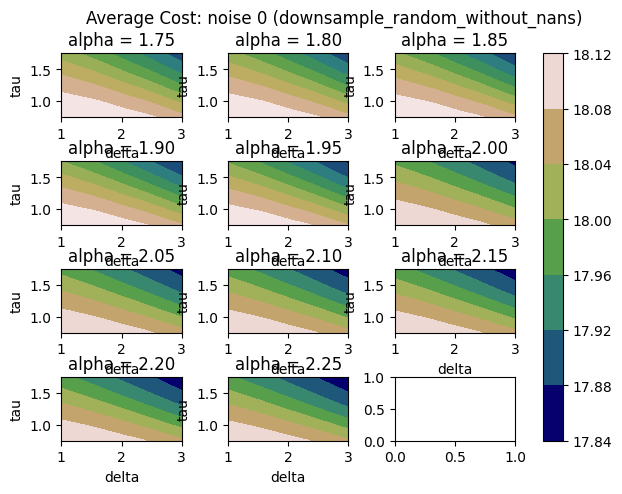

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 18.766379620631298; at
      delta   tau  alpha
9470    3.0  1.75   2.25


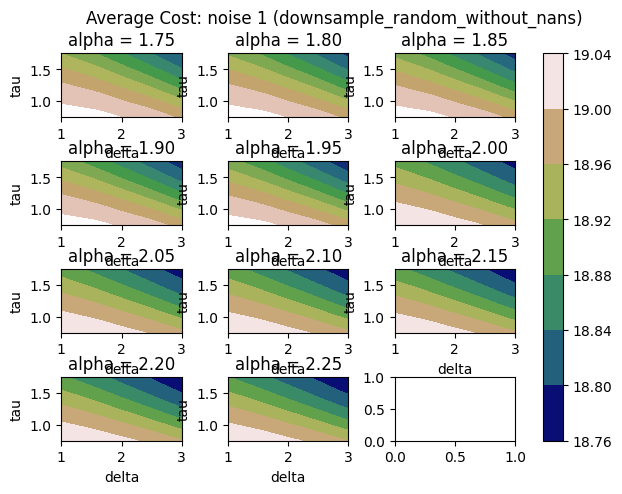

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 33.9349888444189; at
      delta   tau  alpha
9470    3.0  1.75   2.25


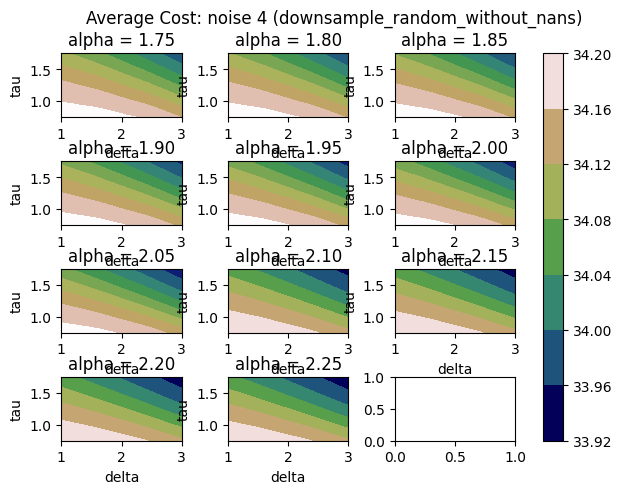

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 66.64153366323717; at
      delta   tau  alpha
9470    3.0  1.75   2.25


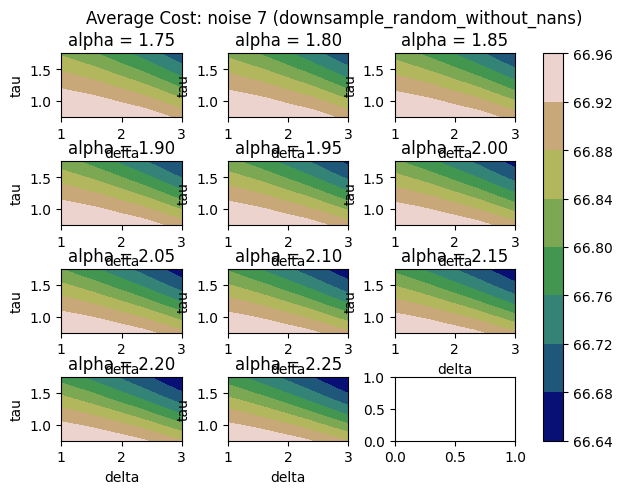

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 118.30182060779954; at
      delta   tau  alpha
9470    3.0  1.75   2.25


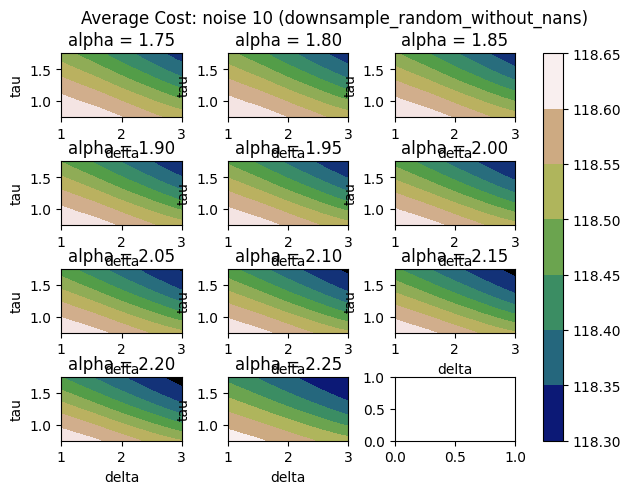

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 187.36248425938393; at
      delta   tau  alpha
9470    3.0  1.75   2.25


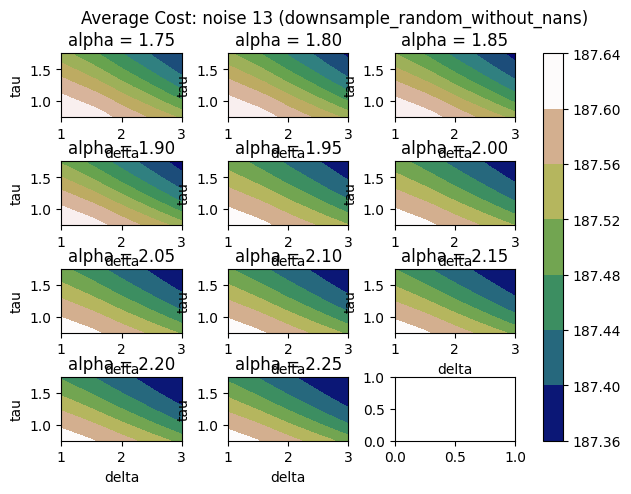

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


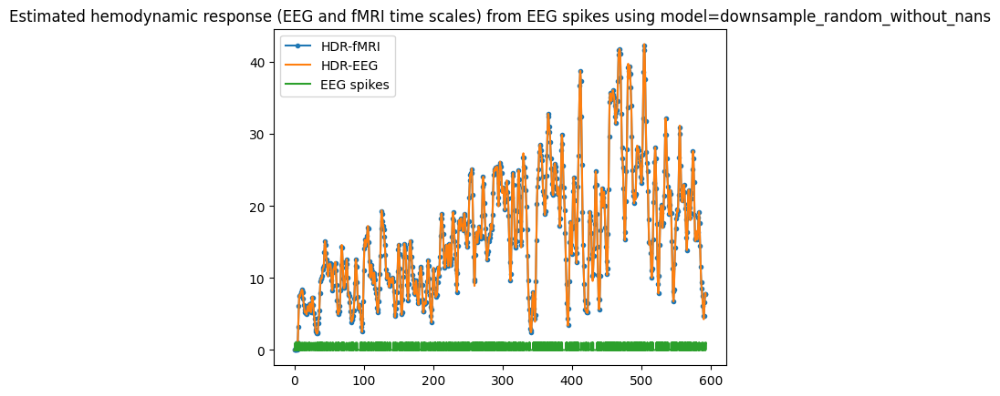

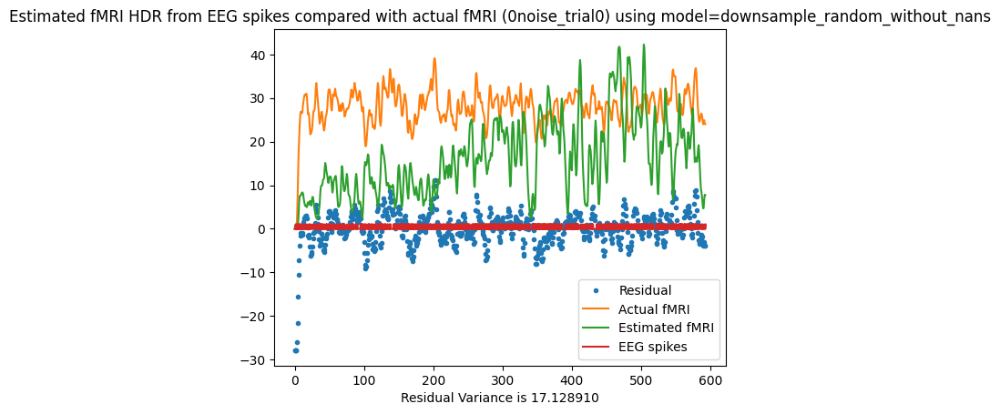

Residual Variance is 17.128910


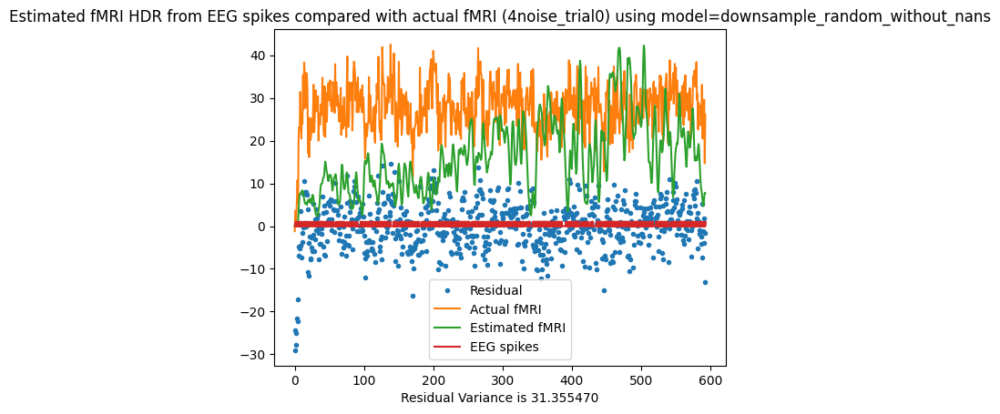

Residual Variance is 31.355470


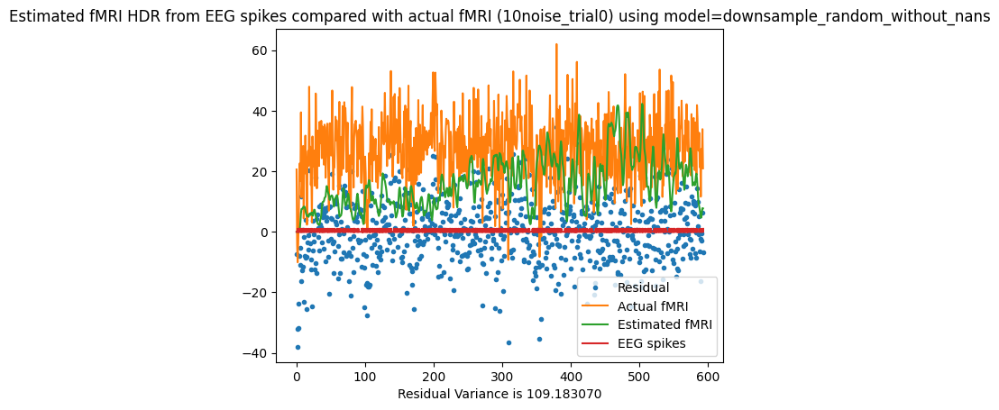

Residual Variance is 109.183070
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.60 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.70 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.87 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.86 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.91 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.92 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.98 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.17 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.35 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.99 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.98 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.01 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.06 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 1.98 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 17.018766511285197; at
      delta   tau  alpha
9470    3.0  1.75   2.25


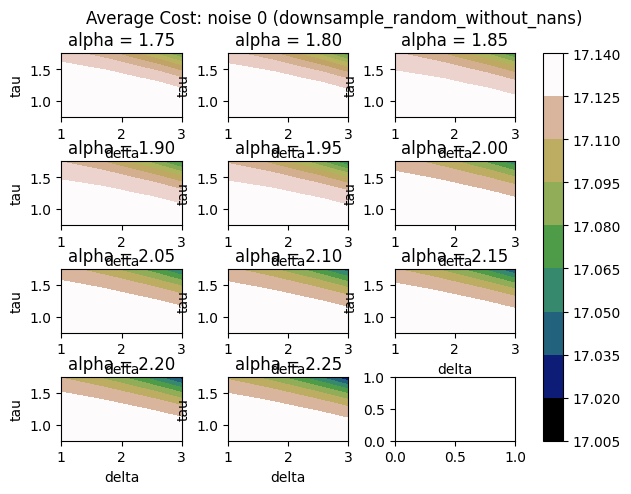

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 18.023293368748615; at
      delta   tau  alpha
9470    3.0  1.75   2.25


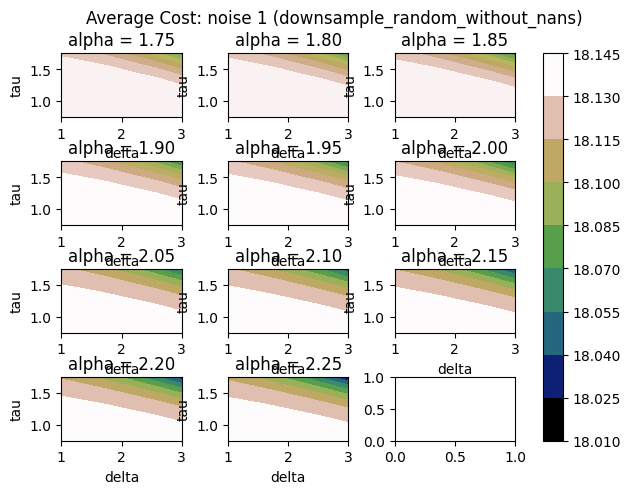

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 32.76249568459354; at
      delta   tau  alpha
9470    3.0  1.75   2.25


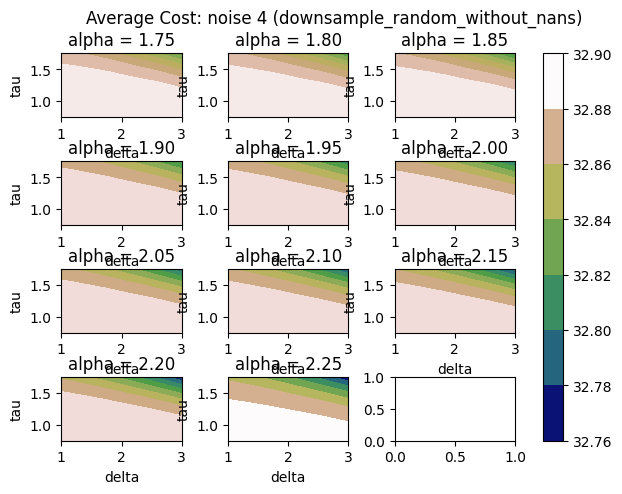

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 64.9320472767516; at
      delta   tau  alpha
9470    3.0  1.75   2.25


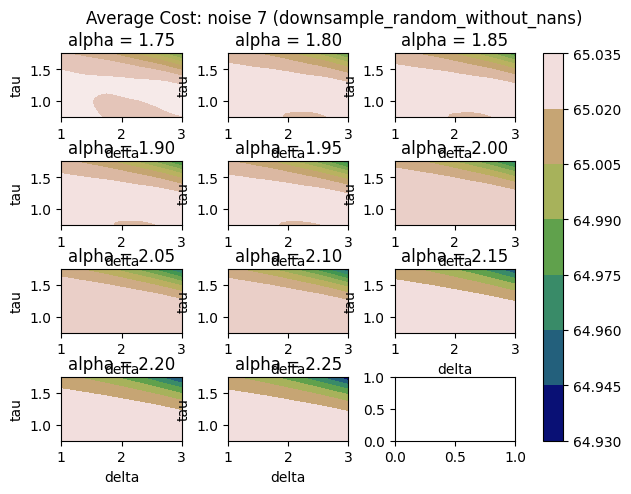

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 116.8670869775388; at
      delta   tau  alpha
9470    3.0  1.75   2.25


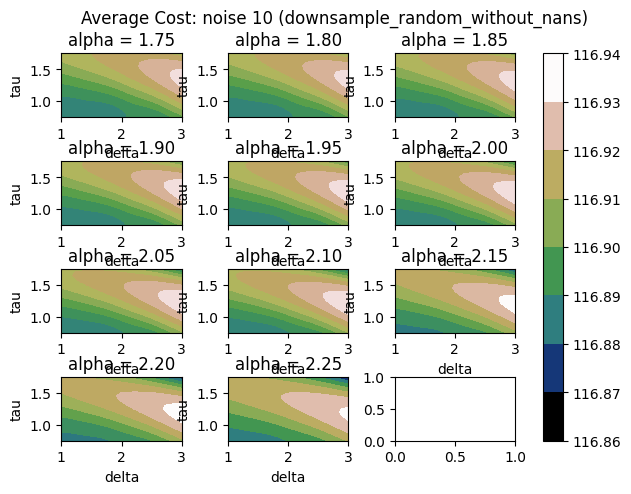

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 185.12276407829137; at
     delta   tau  alpha
231   1.05  0.75   1.75


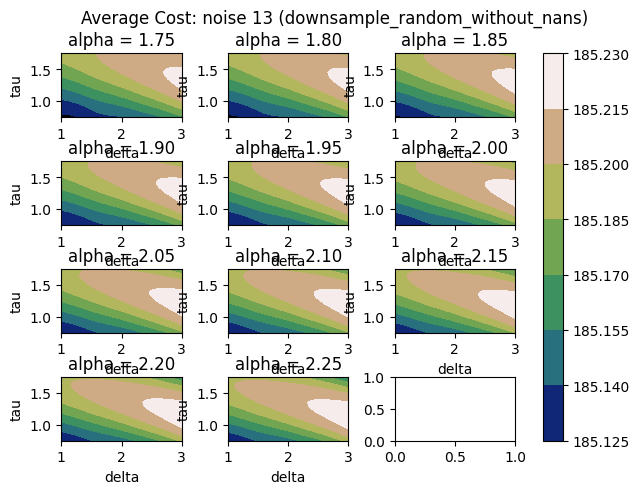

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


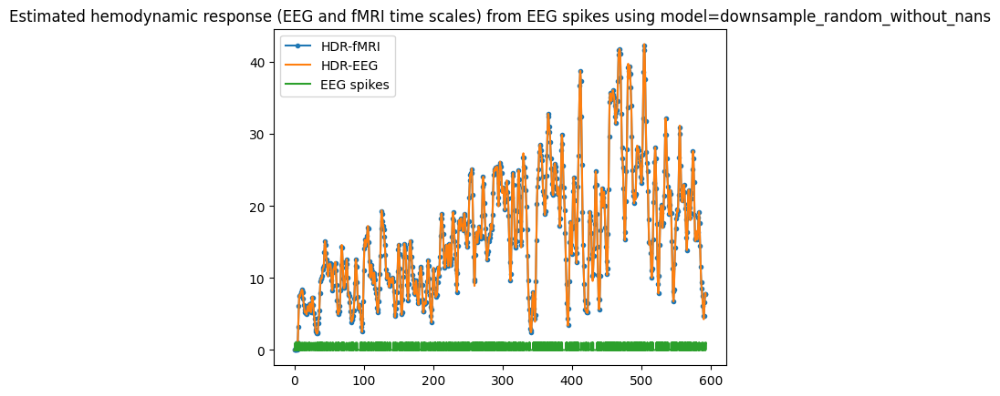

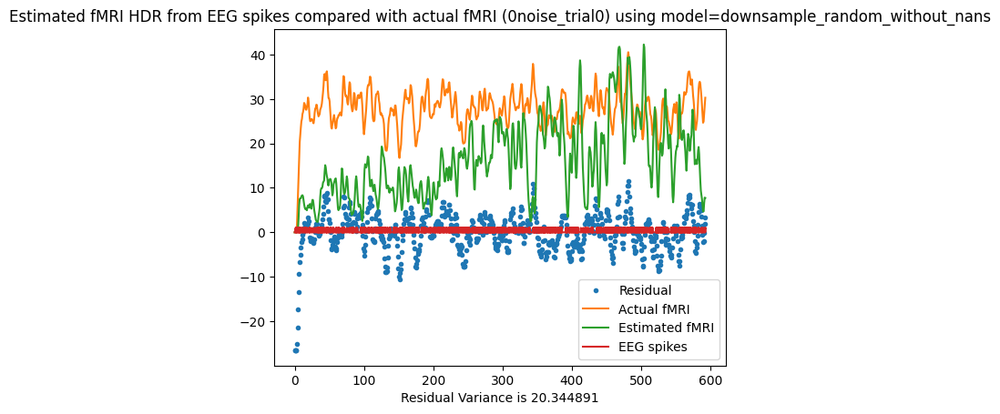

Residual Variance is 20.344891


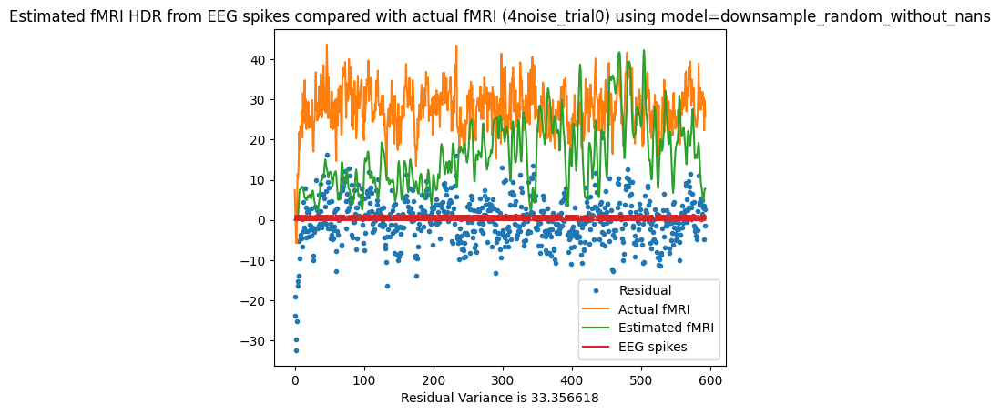

Residual Variance is 33.356618


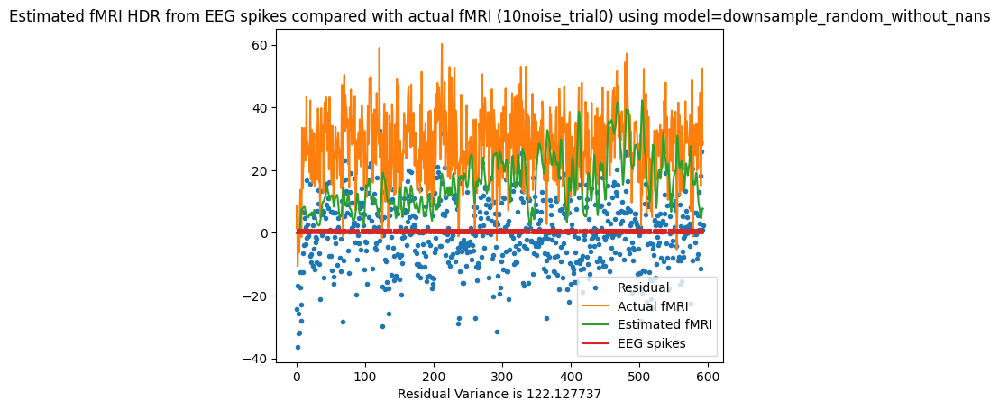

Residual Variance is 122.127737
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.57 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.70 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.78 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.87 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.96 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.91 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.92 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.91 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.94 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.98 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.98 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.98 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 1.99 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.00 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 20.31726077065826; at
      delta   tau  alpha
8075    2.7  1.75    1.8


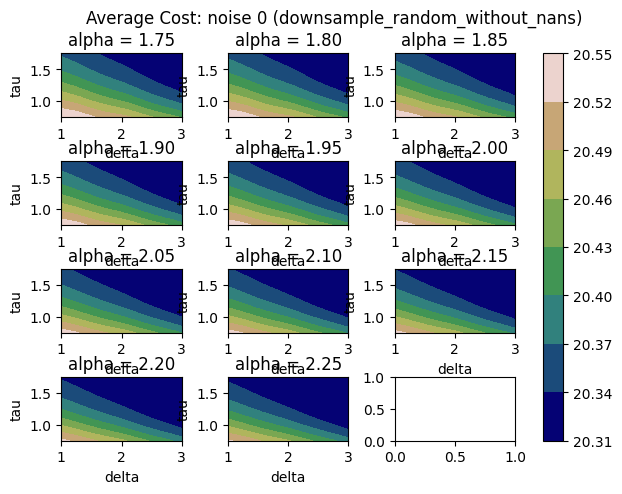

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 21.351355519841604; at
      delta   tau  alpha
8075    2.7  1.75    1.8


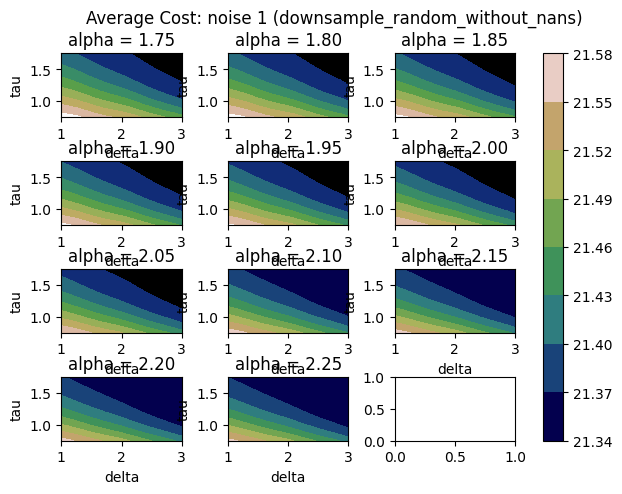

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 36.326315249649866; at
      delta  tau  alpha
9349    3.0  1.2   2.25


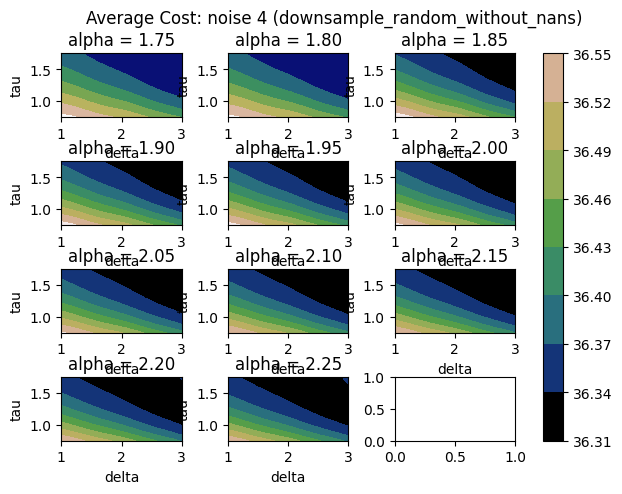

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 69.1894873063988; at
      delta   tau  alpha
9338    3.0  1.15   2.25


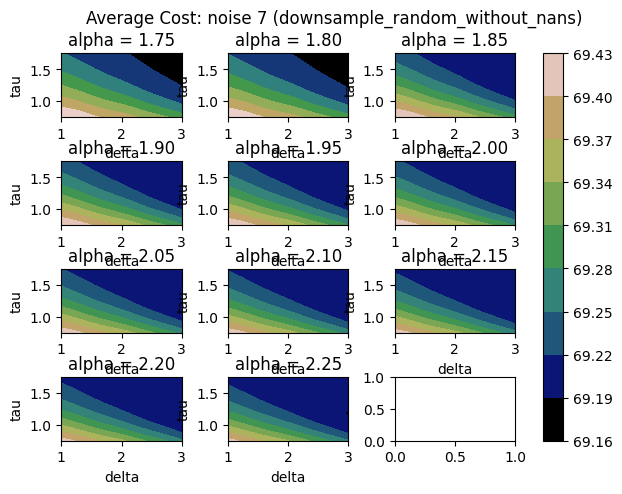

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 119.93962811907062; at
      delta  tau  alpha
9371    3.0  1.3   2.25


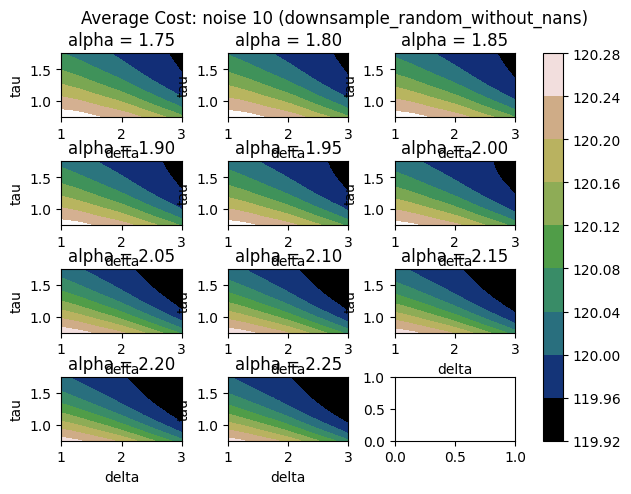

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 189.19847143486533; at
      delta   tau  alpha
7381   2.55  1.75   1.75


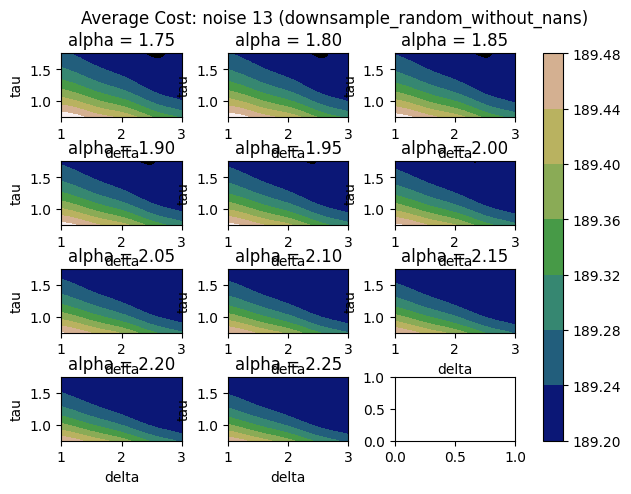

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


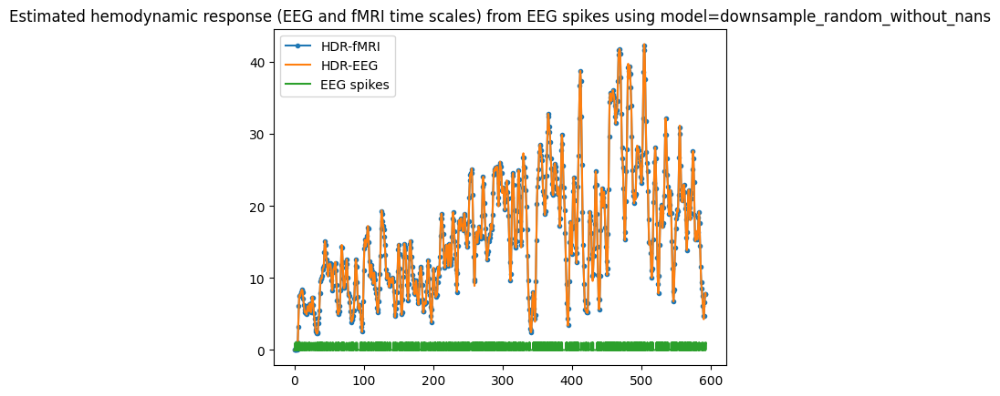

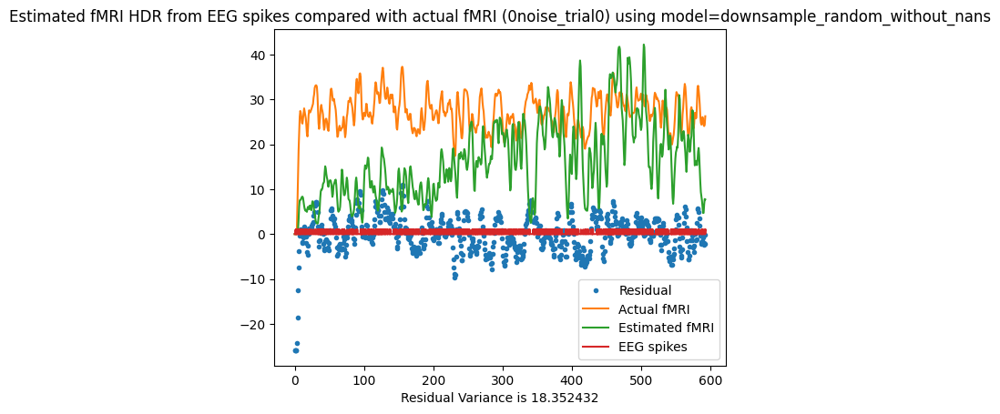

Residual Variance is 18.352432


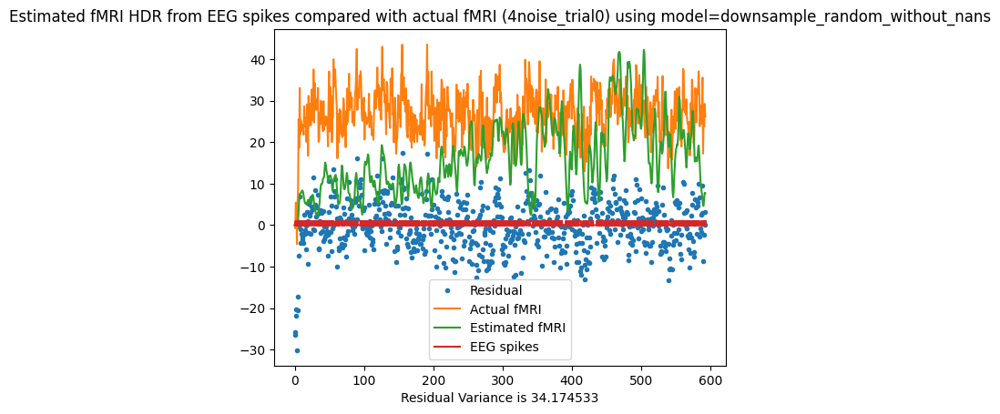

Residual Variance is 34.174533


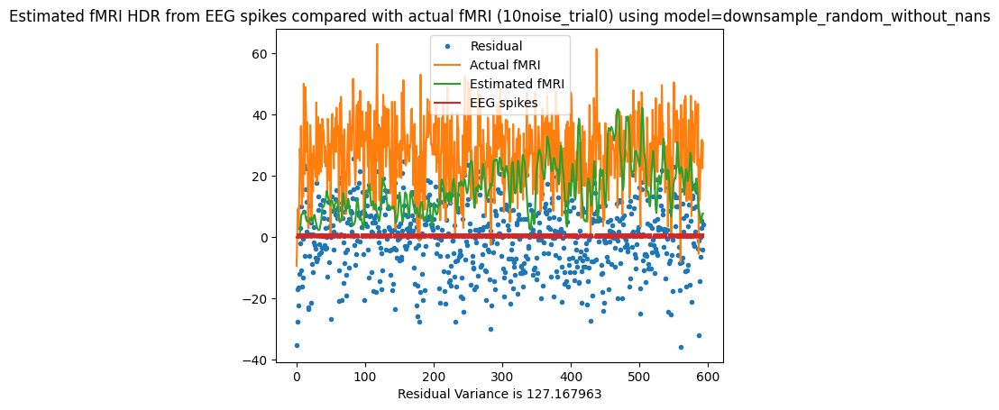

Residual Variance is 127.167963
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.70 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.62 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.71 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.79 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.83 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.90 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.88 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.88 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.88 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.96 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.89 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.93 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 1.92 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 1.82 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 18.316625185741874; at
     delta  tau  alpha
130    1.0  1.3    2.2


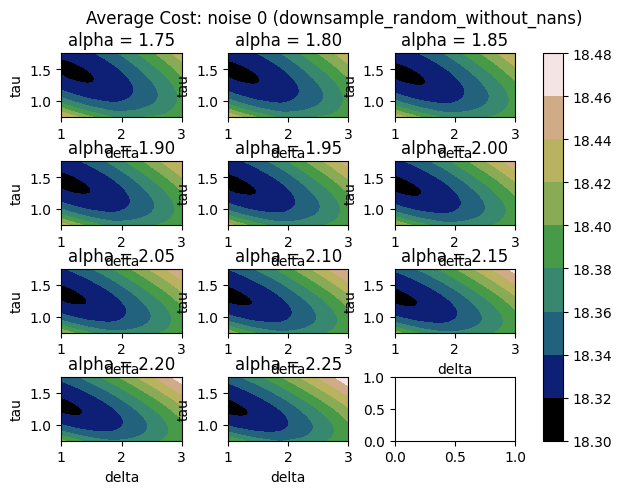

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 19.307536301322358; at
     delta  tau  alpha
130    1.0  1.3    2.2


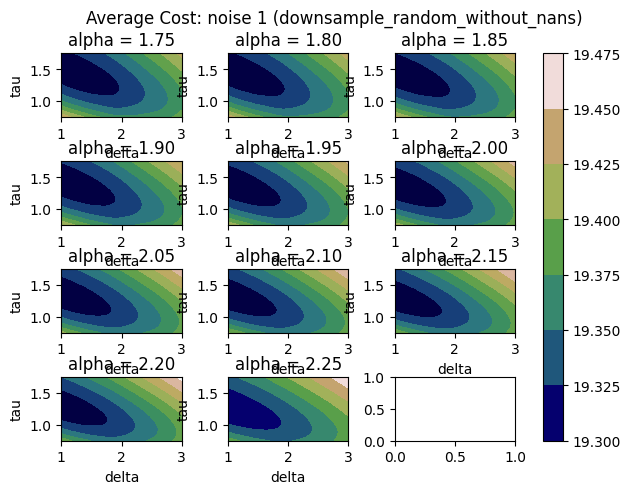

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 34.08392976626699; at
     delta   tau  alpha
351   1.05  1.25   2.25


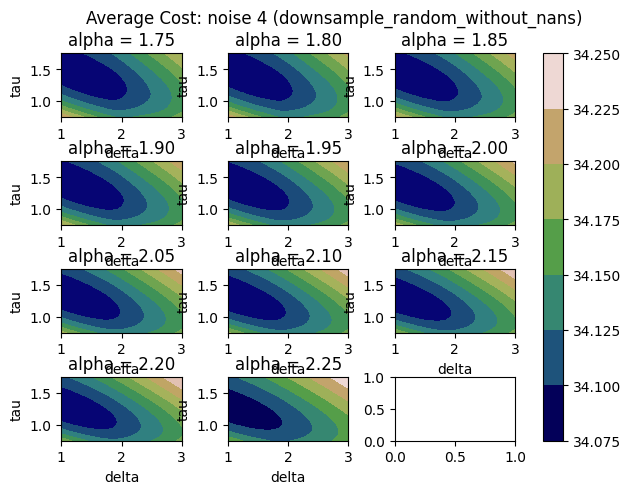

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 67.4308840120884; at
     delta   tau  alpha
596    1.1  1.35   1.85


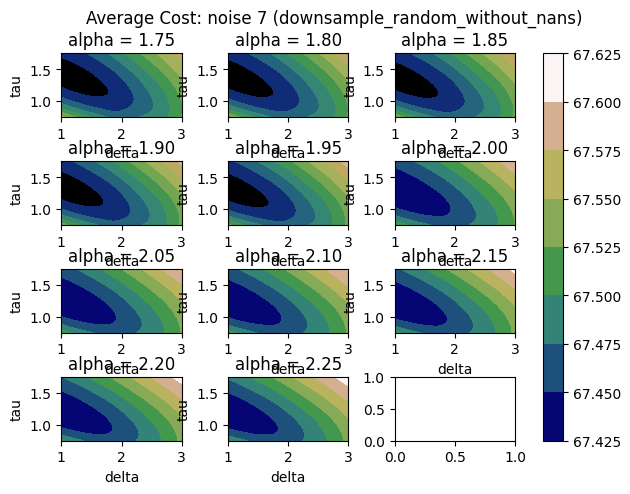

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 116.95850479894; at
     delta  tau  alpha
374   1.05  1.4   1.75


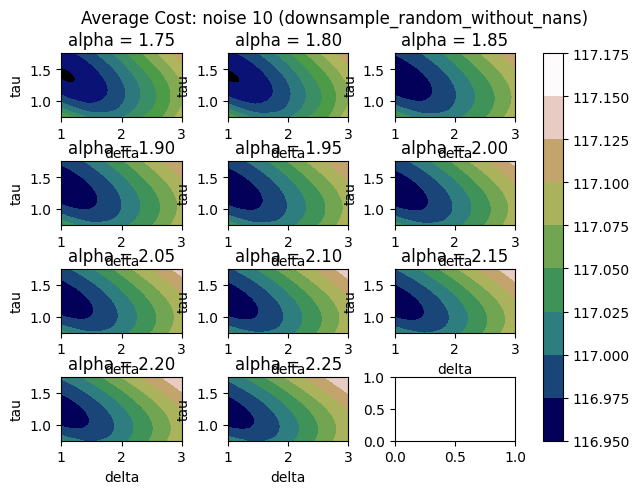

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 186.70755143710136; at
     delta   tau  alpha
386   1.05  1.45    1.8


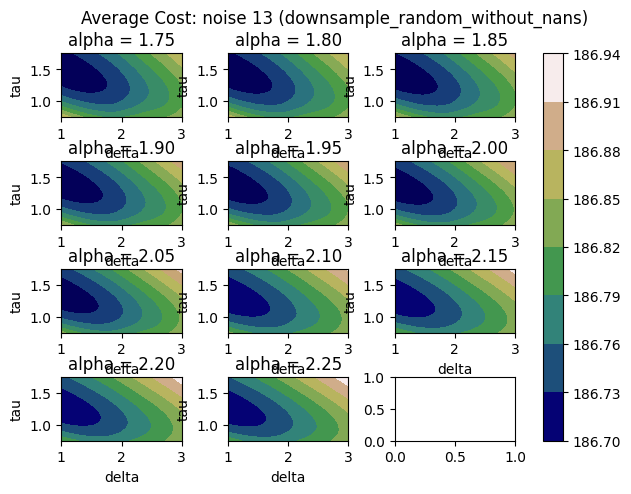

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


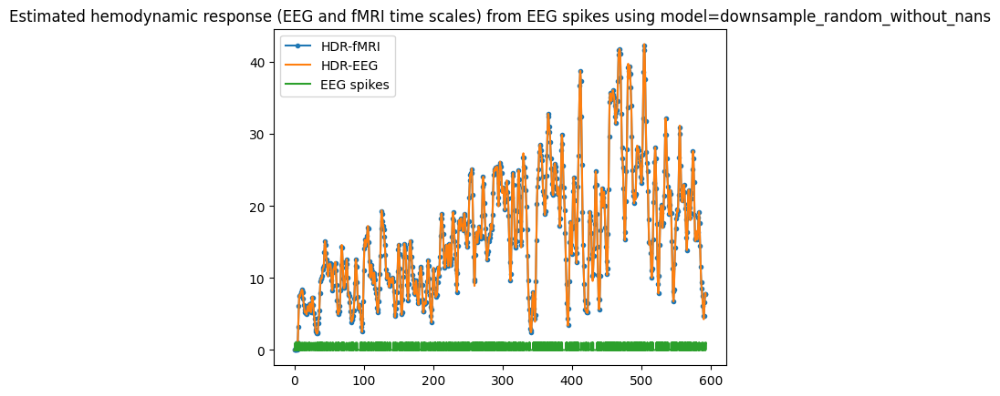

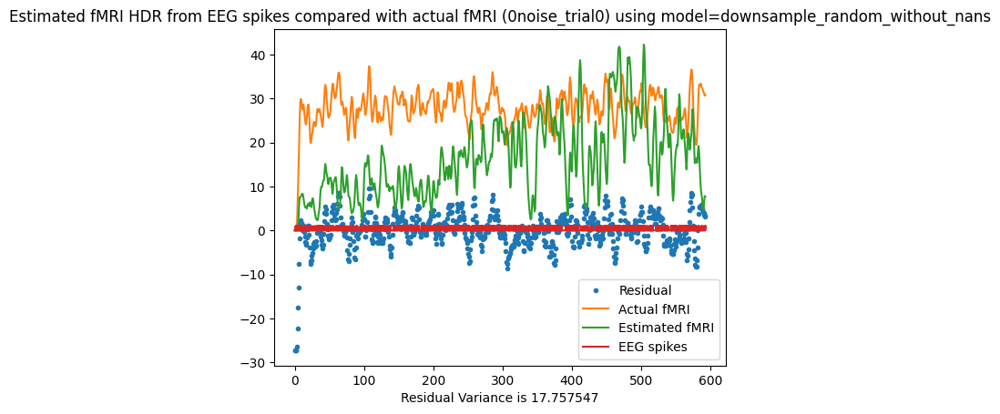

Residual Variance is 17.757547


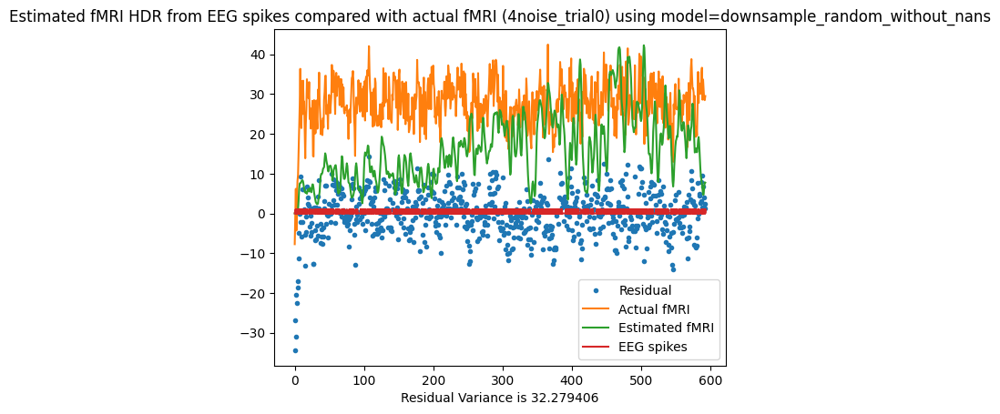

Residual Variance is 32.279406


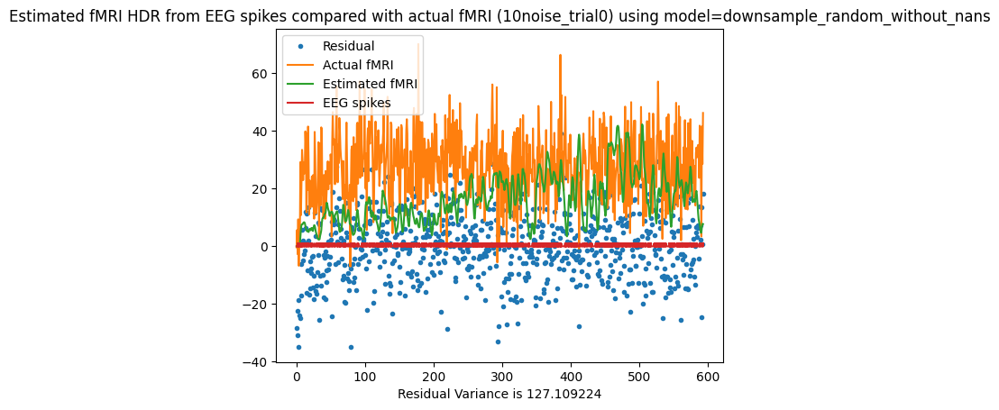

Residual Variance is 127.109224
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.56 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.62 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.73 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.87 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.87 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.90 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.92 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.92 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.92 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.96 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.98 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.99 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 1.99 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.14 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 17.656296530196418; at
      delta   tau  alpha
9470    3.0  1.75   2.25


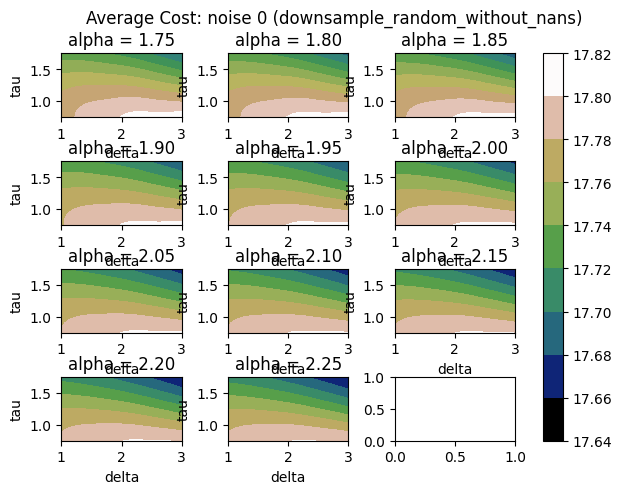

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 18.710173102881466; at
      delta   tau  alpha
9470    3.0  1.75   2.25


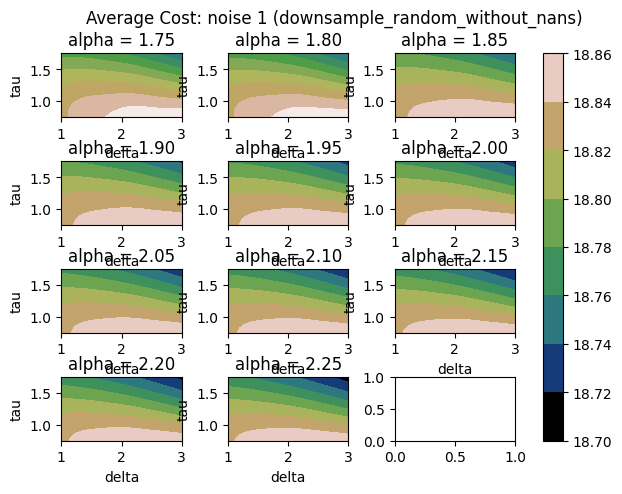

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 33.701009186822475; at
      delta   tau  alpha
9470    3.0  1.75   2.25


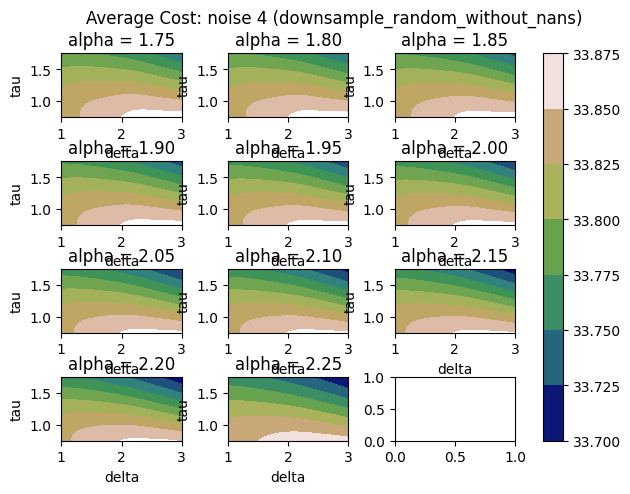

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 66.39248456207868; at
      delta   tau  alpha
9470    3.0  1.75   2.25


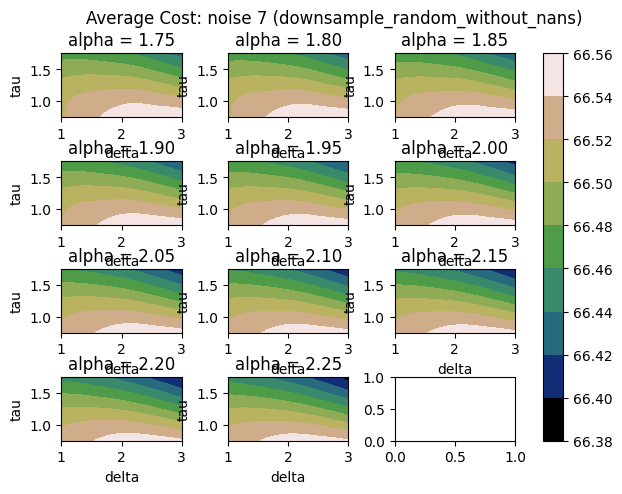

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 118.3577408635302; at
      delta   tau  alpha
9470    3.0  1.75   2.25


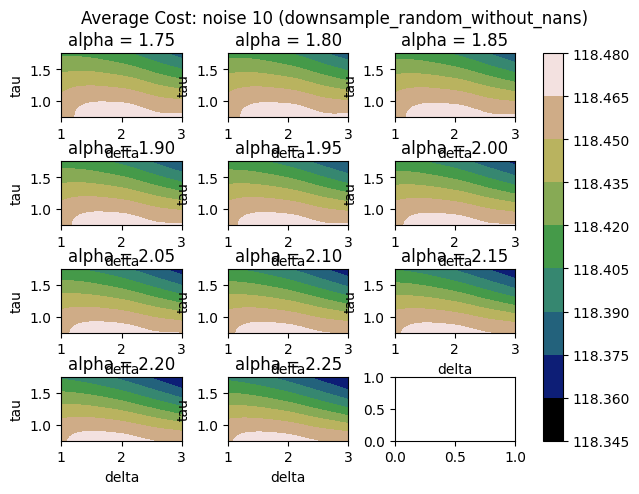

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 185.73816806379276; at
      delta   tau  alpha
9470    3.0  1.75   2.25


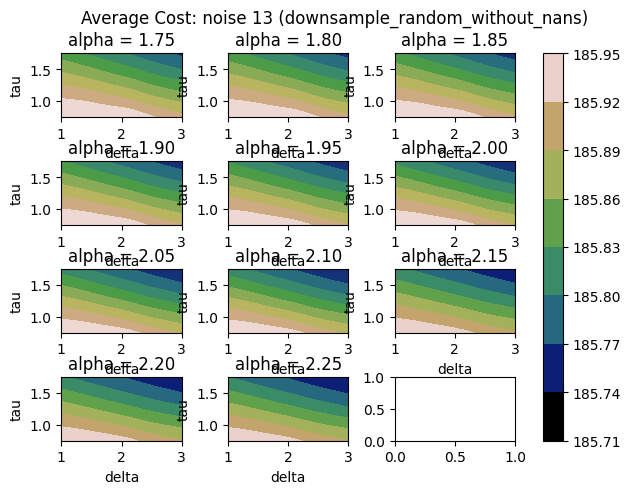

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


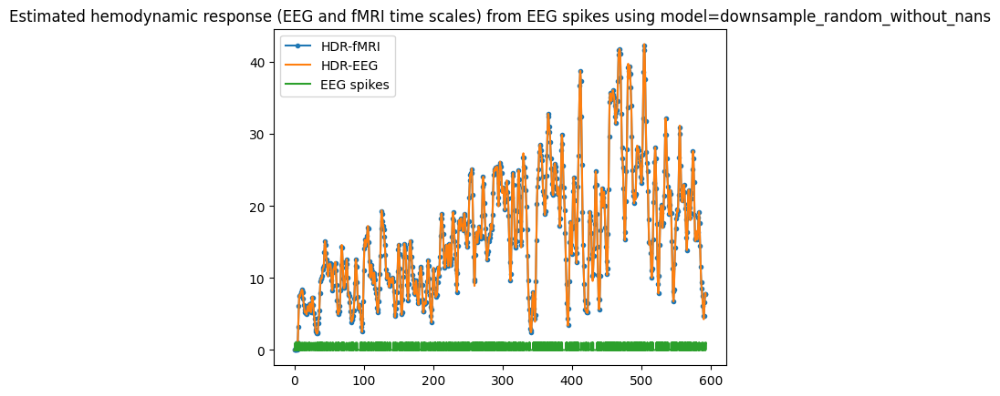

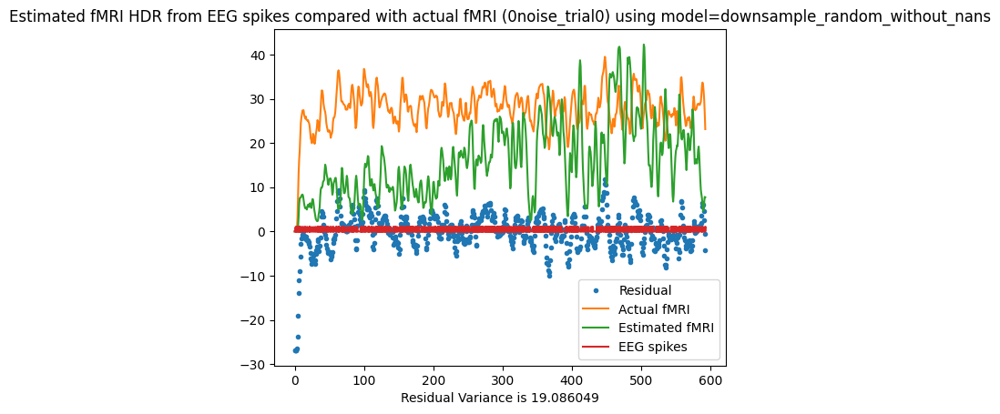

Residual Variance is 19.086049


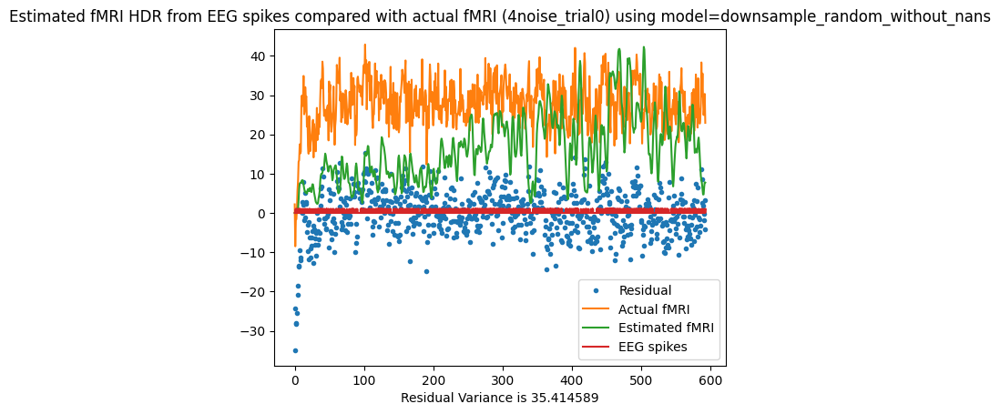

Residual Variance is 35.414589


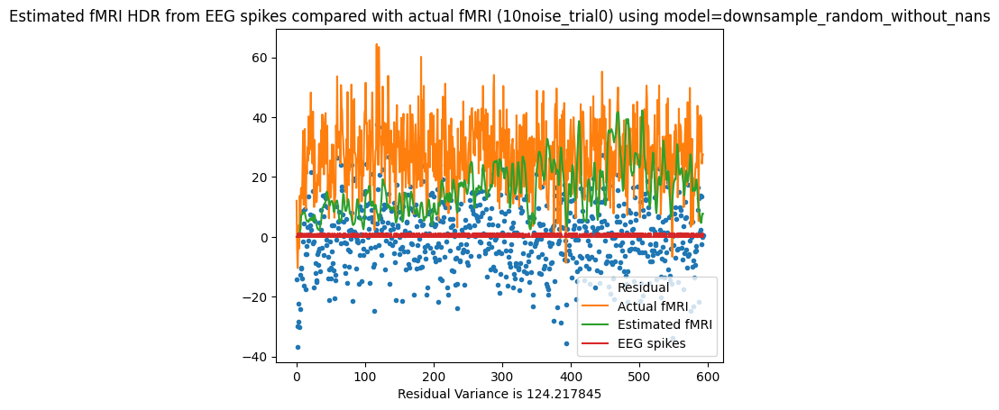

Residual Variance is 124.217845
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.56 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.59 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.69 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.79 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.86 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.89 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.92 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.99 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.09 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.98 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.98 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.02 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 1.98 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.00 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 18.744215688804417; at
      delta   tau  alpha
9470    3.0  1.75   2.25


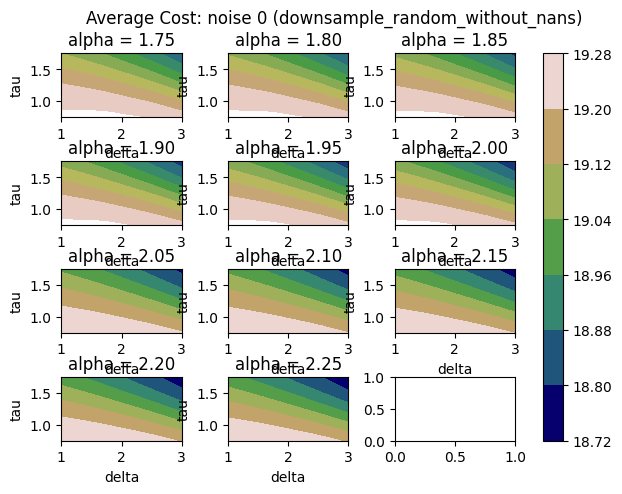

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 19.7471736997864; at
      delta   tau  alpha
9470    3.0  1.75   2.25


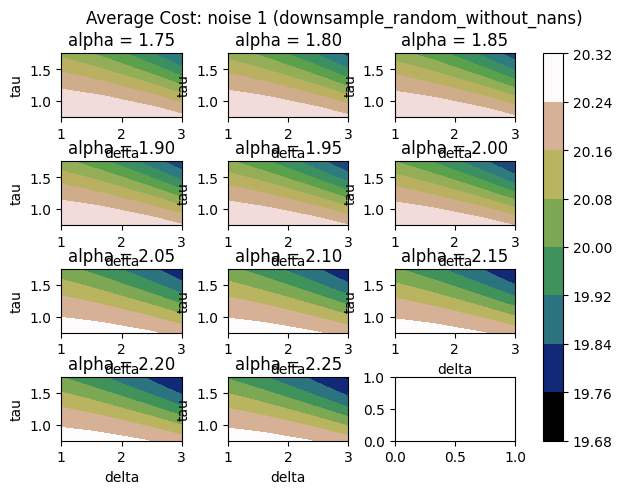

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 34.75206331515461; at
      delta   tau  alpha
9470    3.0  1.75   2.25


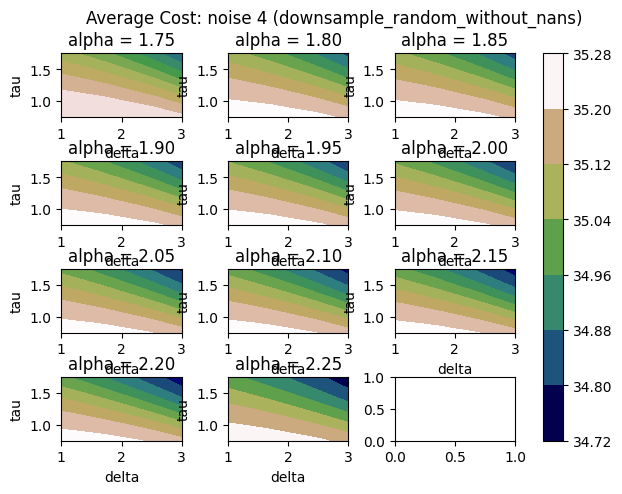

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 67.9988000631473; at
      delta   tau  alpha
9470    3.0  1.75   2.25


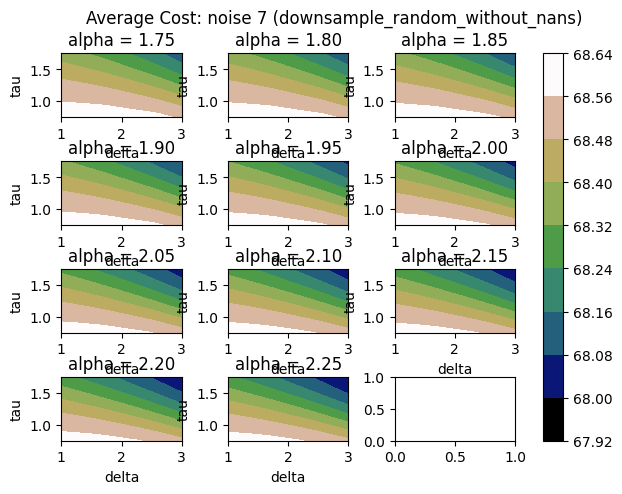

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 119.02073054678579; at
      delta   tau  alpha
9470    3.0  1.75   2.25


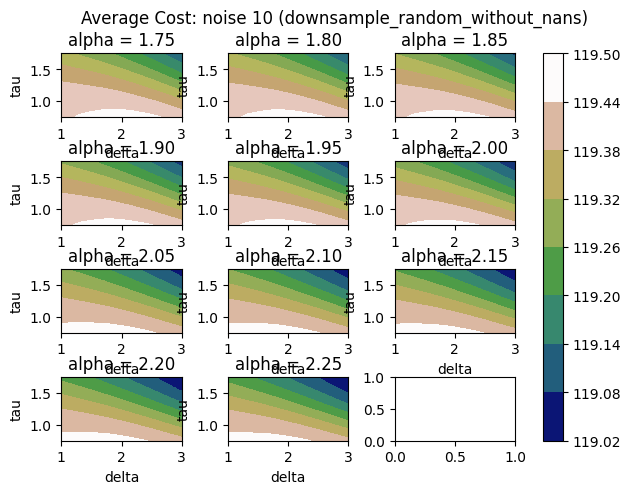

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 187.4226022503746; at
      delta   tau  alpha
9470    3.0  1.75   2.25


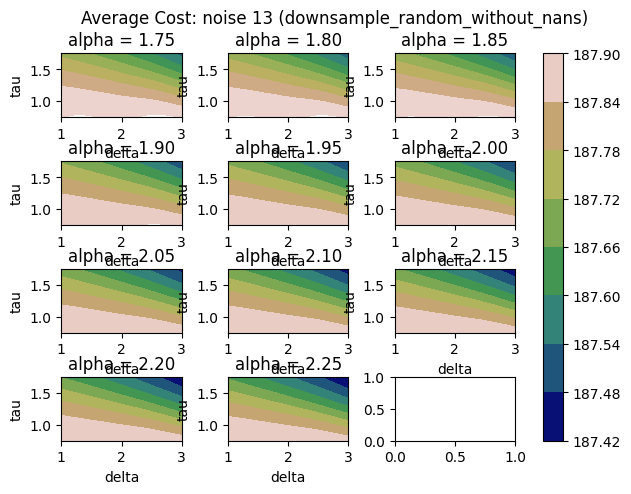

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


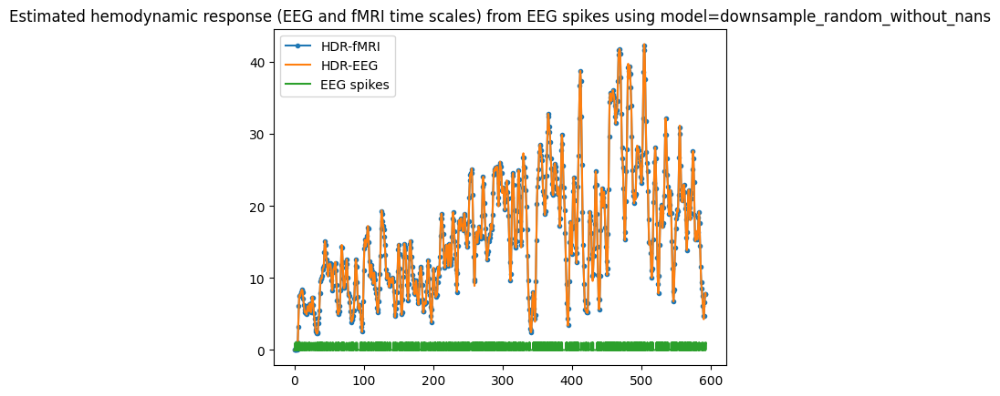

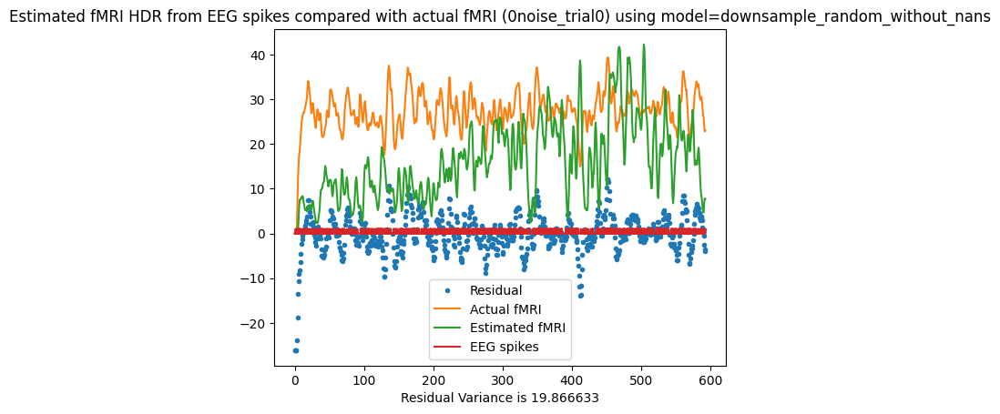

Residual Variance is 19.866633


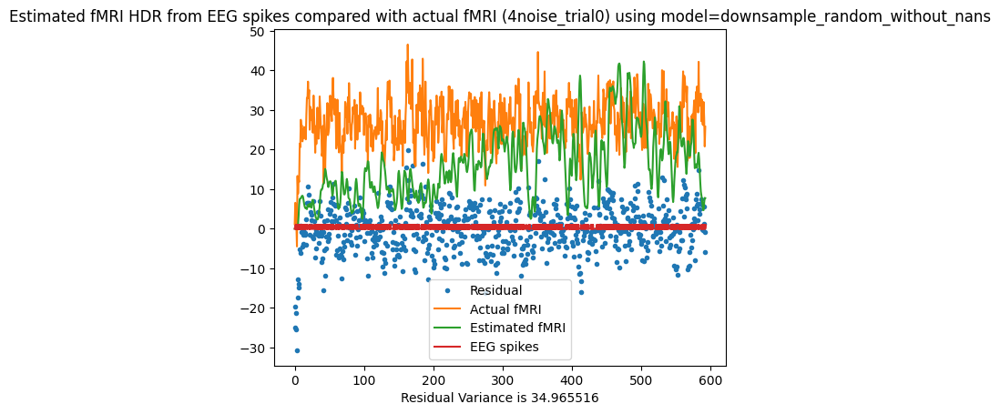

Residual Variance is 34.965516


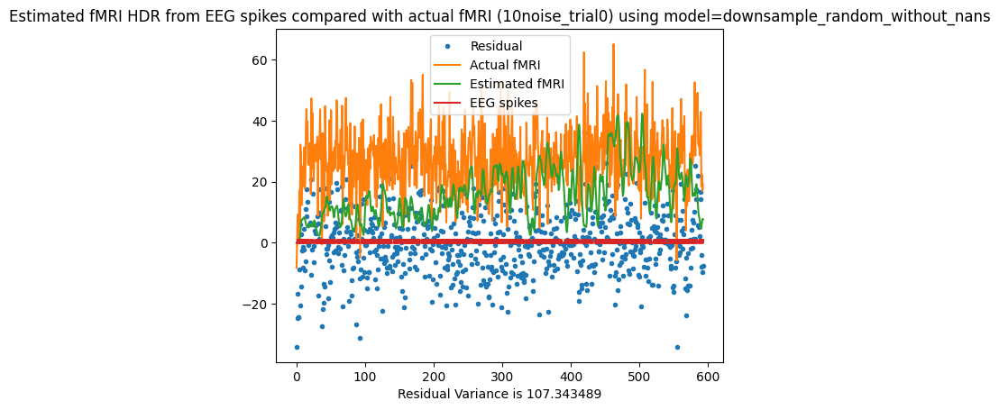

Residual Variance is 107.343489
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.49 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.55 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.62 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.68 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.71 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.73 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.78 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.78 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.79 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.82 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.83 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.84 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 1.88 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 1.97 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 19.704461866874986; at
     delta   tau  alpha
230    1.0  1.75   2.25


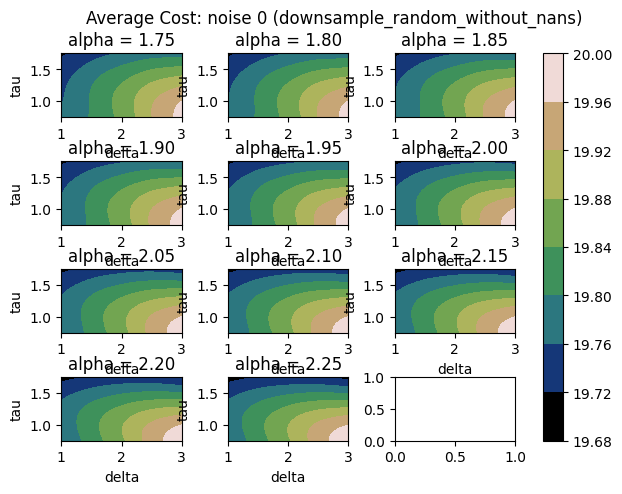

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 20.70614277523285; at
      delta   tau  alpha
9470    3.0  1.75   2.25


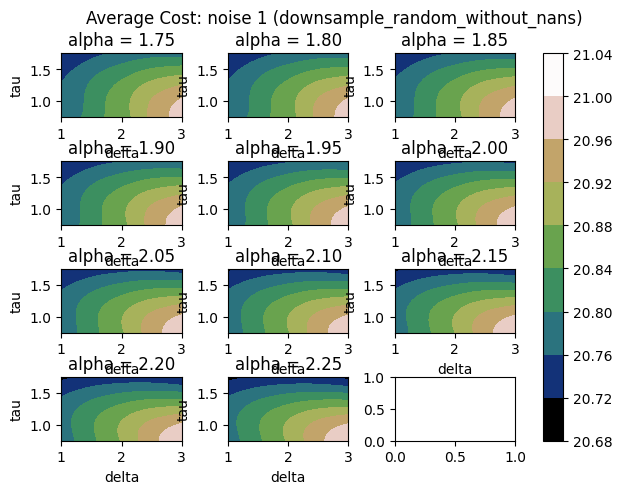

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 35.43999565642248; at
     delta   tau  alpha
220    1.0  1.75   1.75


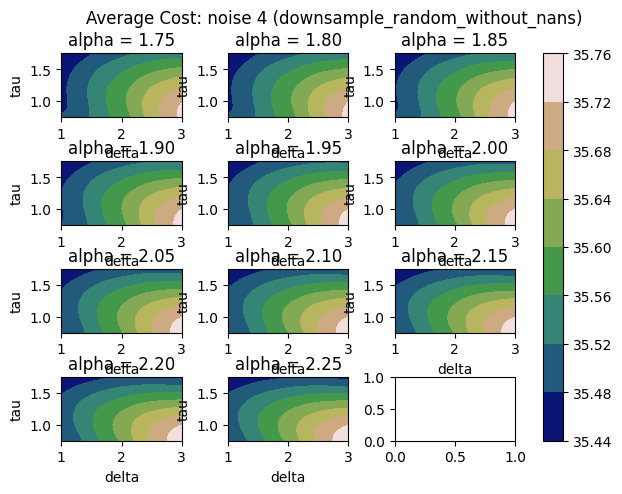

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 67.99294363588811; at
     delta   tau  alpha
230    1.0  1.75   2.25


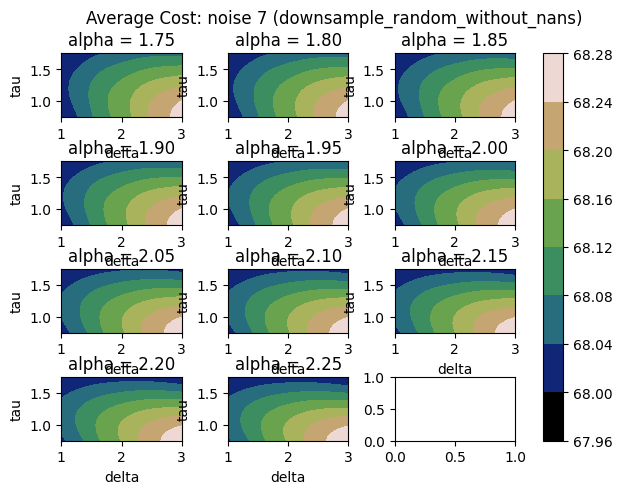

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 118.92502169927688; at
     delta   tau  alpha
220    1.0  1.75   1.75


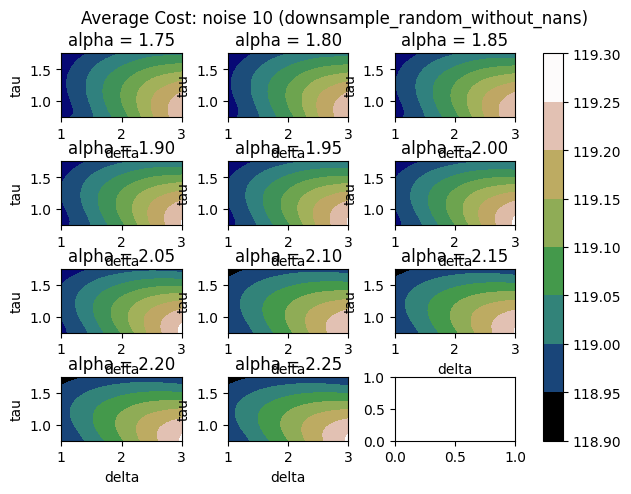

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 189.35934537494478; at
      delta   tau  alpha
9470    3.0  1.75   2.25


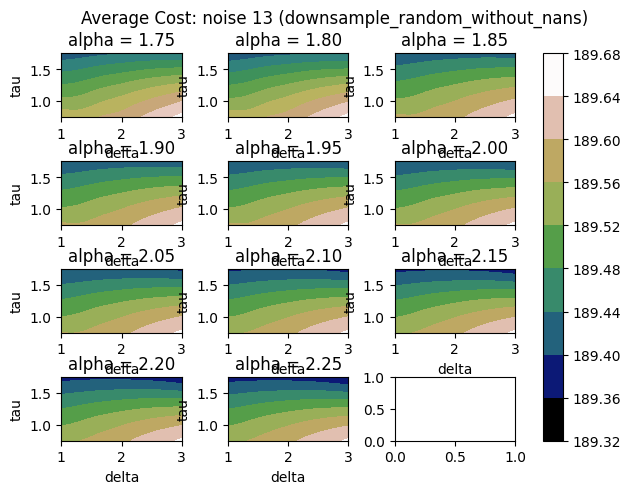

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


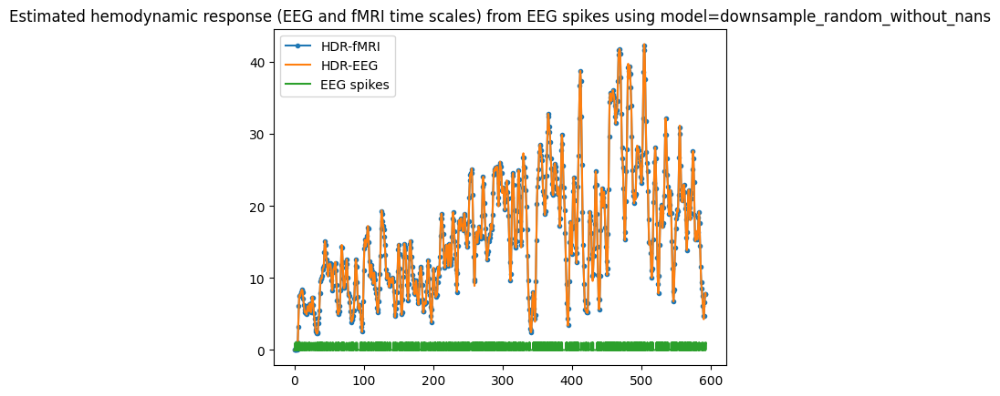

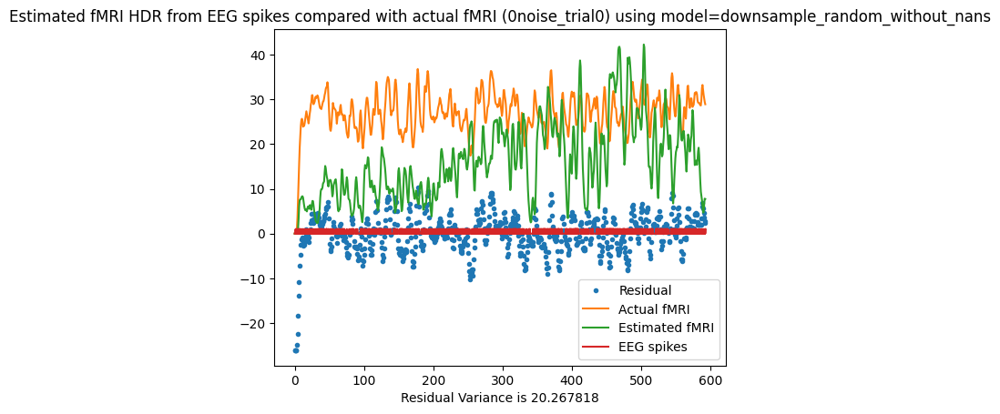

Residual Variance is 20.267818


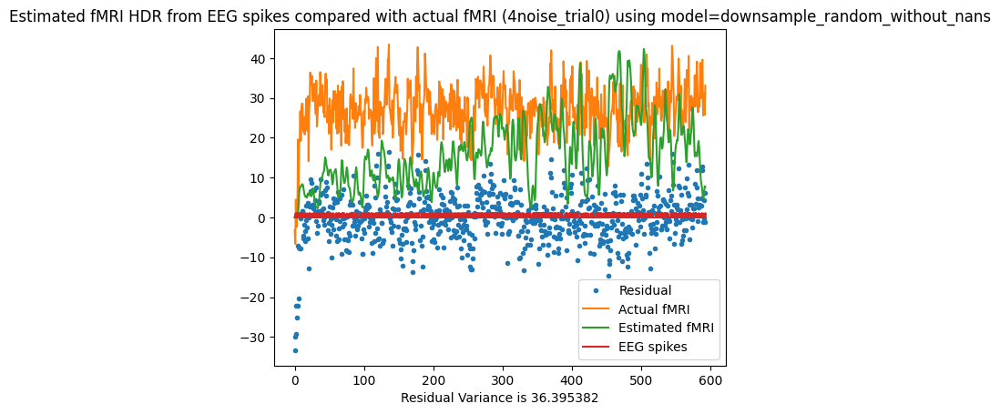

Residual Variance is 36.395382


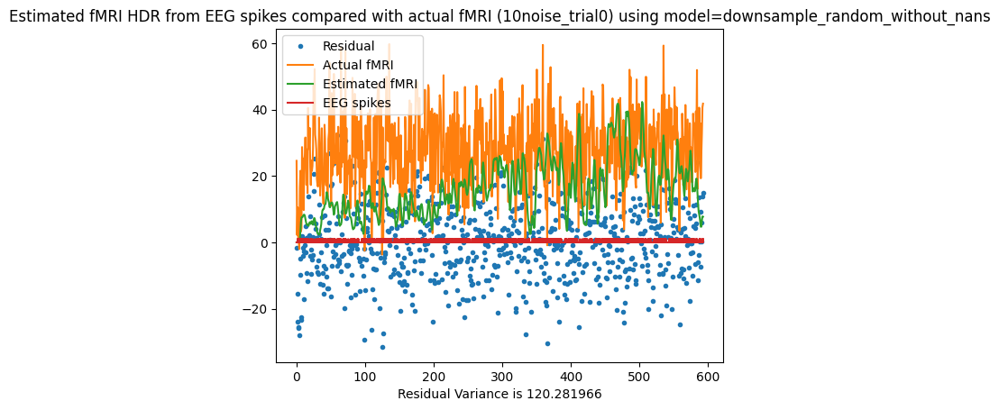

Residual Variance is 120.281966
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.58 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.69 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.77 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.87 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.90 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.93 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.93 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 2.01 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.92 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.93 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.92 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.93 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 1.97 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 1.93 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 20.110682876993618; at
      delta   tau  alpha
9470    3.0  1.75   2.25


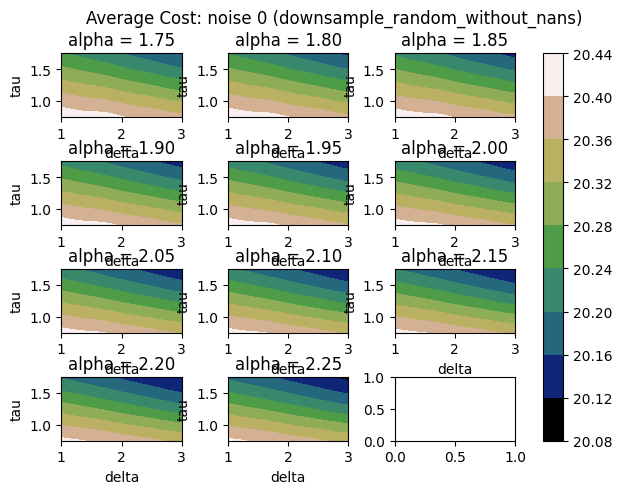

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 21.10739323269995; at
      delta   tau  alpha
9470    3.0  1.75   2.25


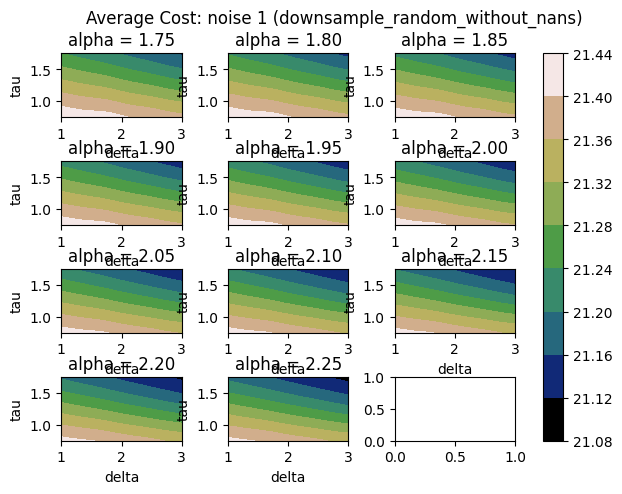

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 36.17653983426715; at
      delta   tau  alpha
9470    3.0  1.75   2.25


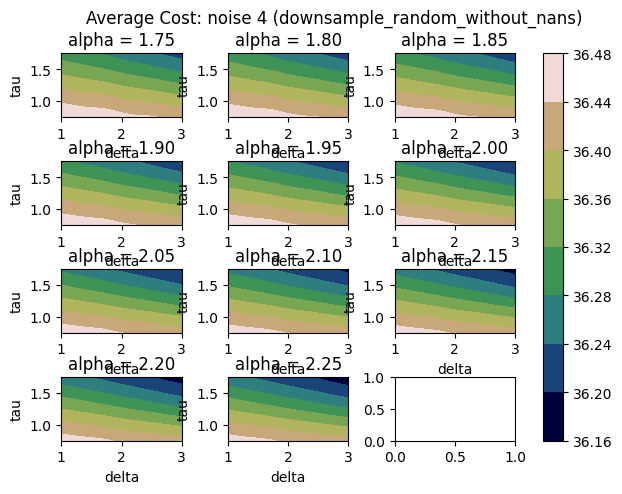

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 69.70120606073134; at
      delta   tau  alpha
9470    3.0  1.75   2.25


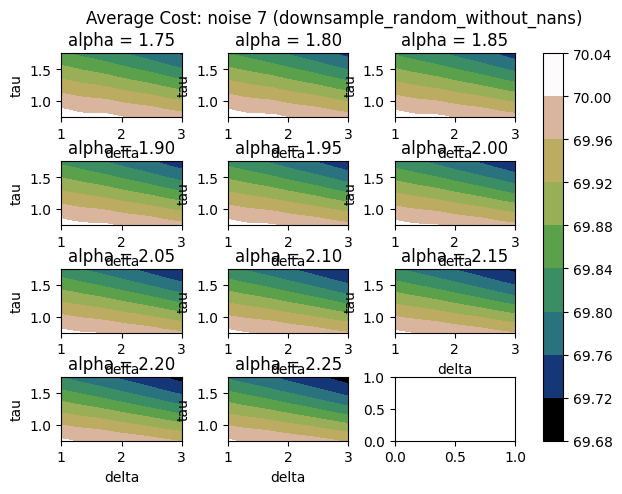

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 120.78646751245236; at
      delta   tau  alpha
9470    3.0  1.75   2.25


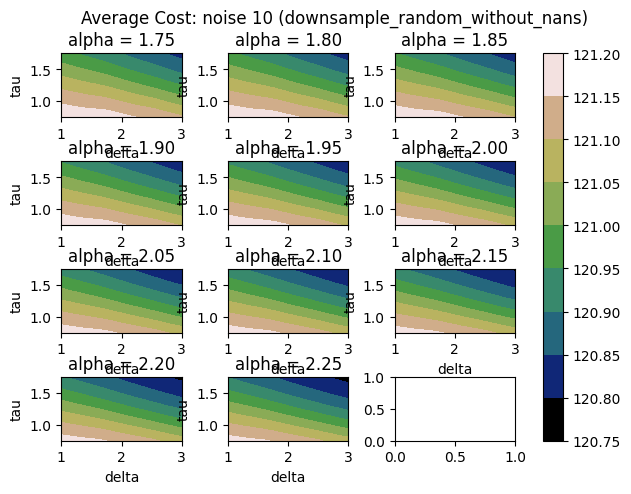

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 188.7663132633579; at
      delta   tau  alpha
9470    3.0  1.75   2.25


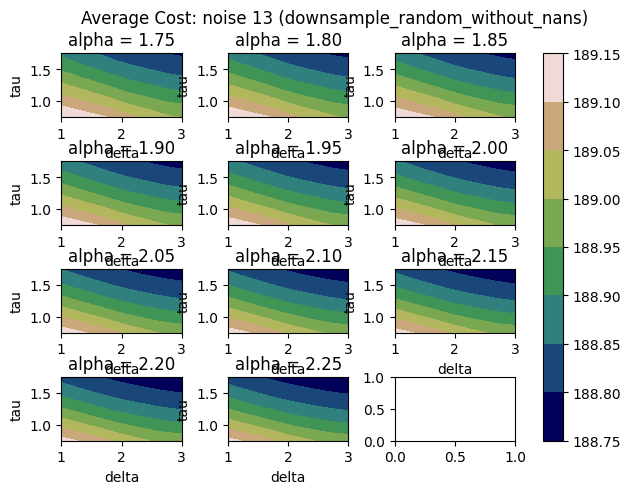

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


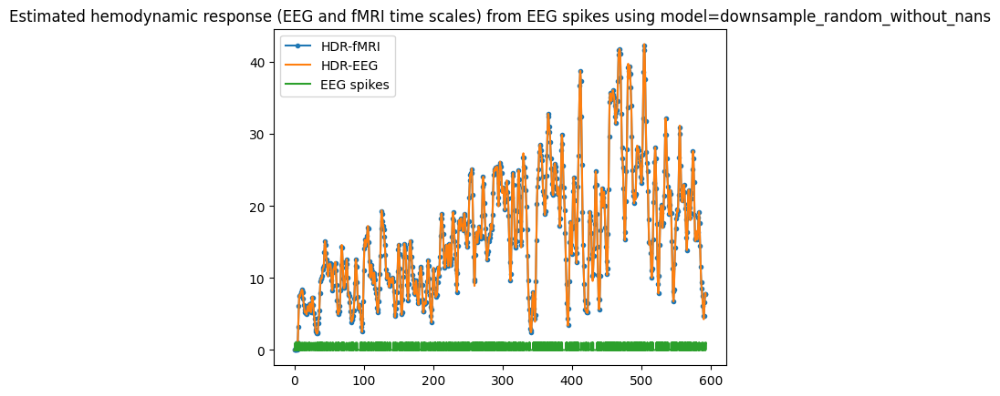

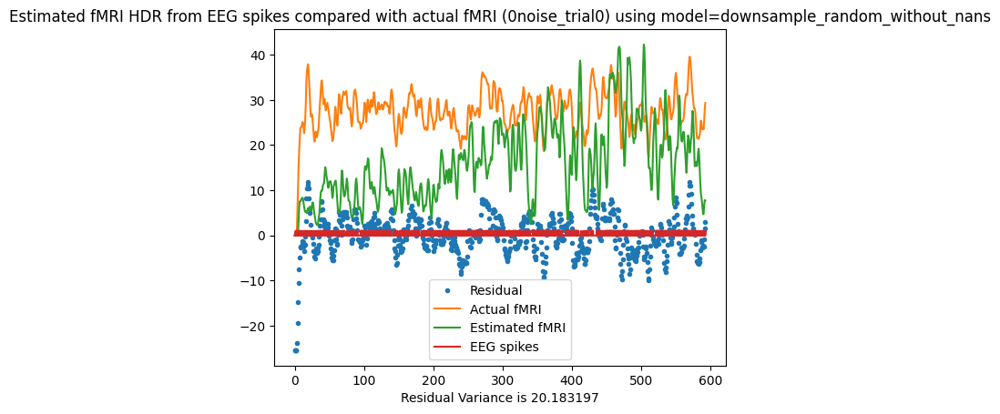

Residual Variance is 20.183197


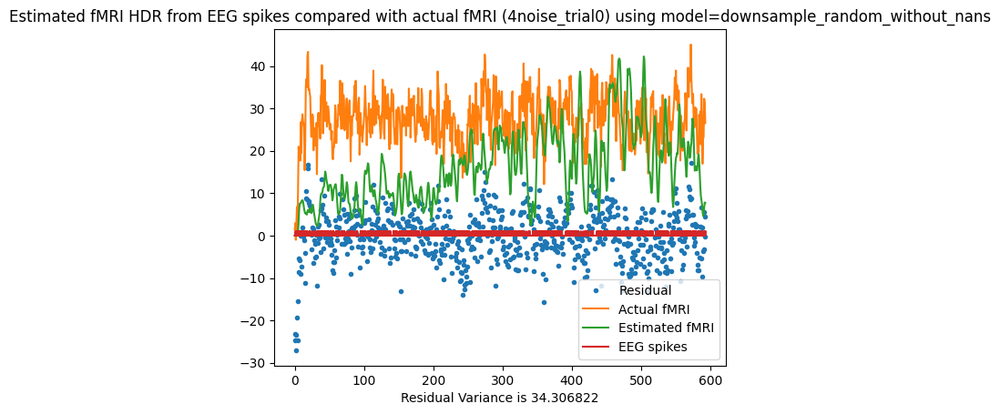

Residual Variance is 34.306822


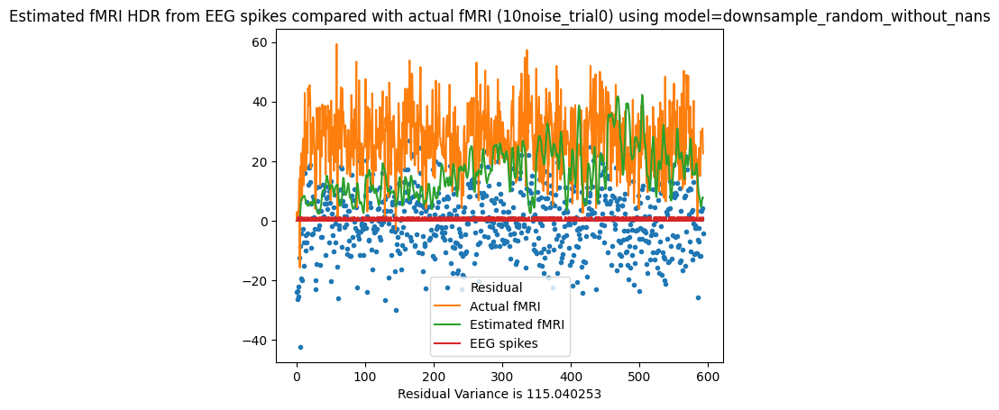

Residual Variance is 115.040253
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.57 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.62 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.80 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 2.05 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.93 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.99 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 2.00 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.99 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.99 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.99 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.99 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.98 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.07 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.02 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 20.00839422021728; at
      delta   tau  alpha
1231   1.25  1.05   2.25


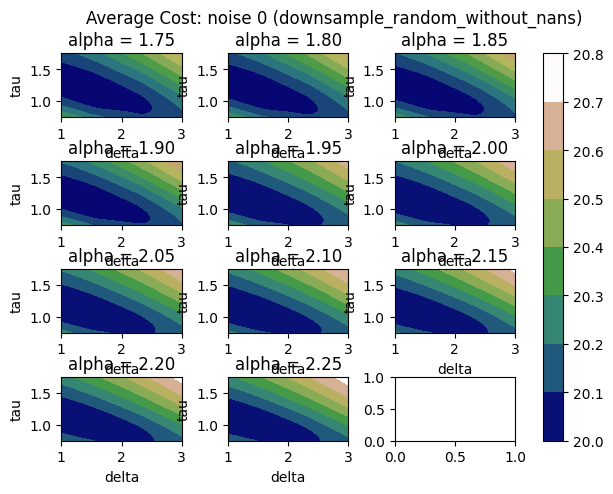

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 20.987615835761922; at
      delta   tau  alpha
1231   1.25  1.05   2.25


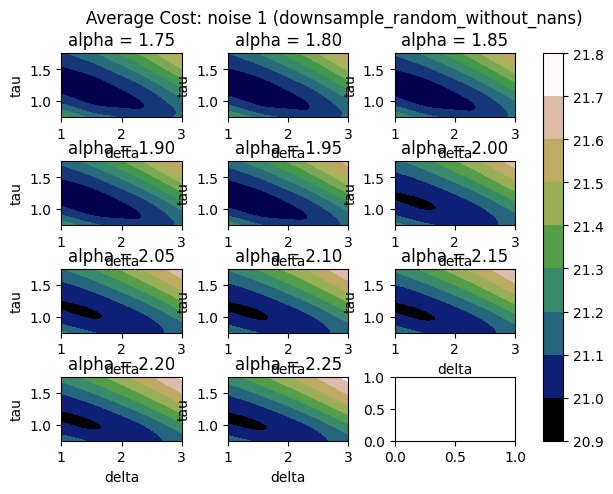

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 35.86246555742954; at
    delta  tau  alpha
87    1.0  1.1   2.25


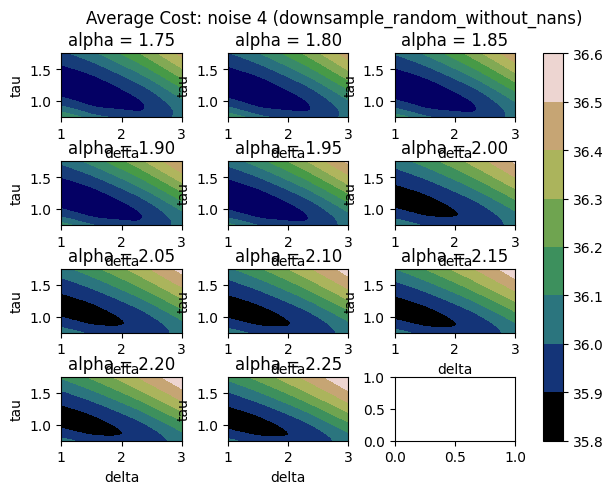

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 68.97255590551791; at
      delta   tau  alpha
1693   1.35  1.05   2.25


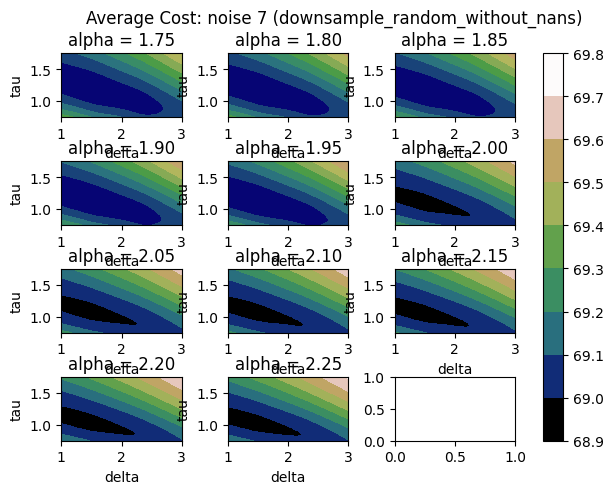

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 119.59786031026657; at
      delta  tau  alpha
1220   1.25  1.0   2.25


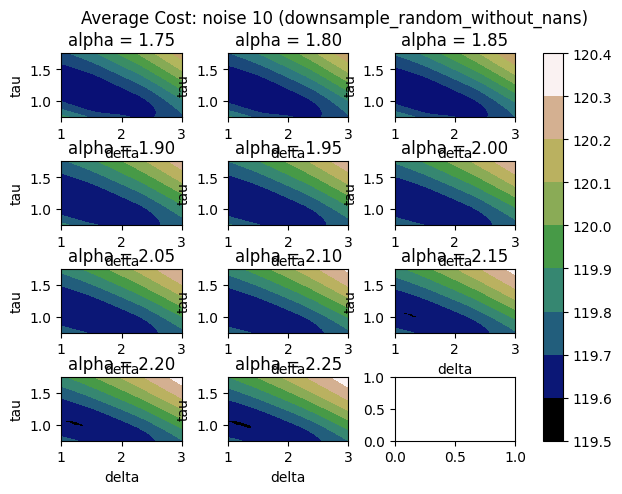

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 188.4797005441793; at
      delta   tau  alpha
4652    2.0  0.85   2.25


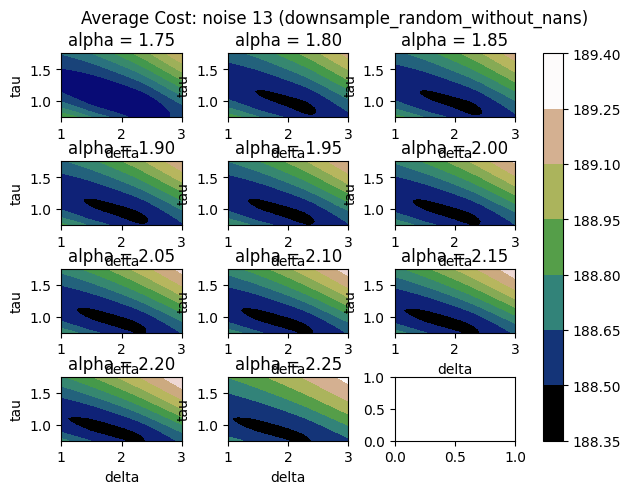

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


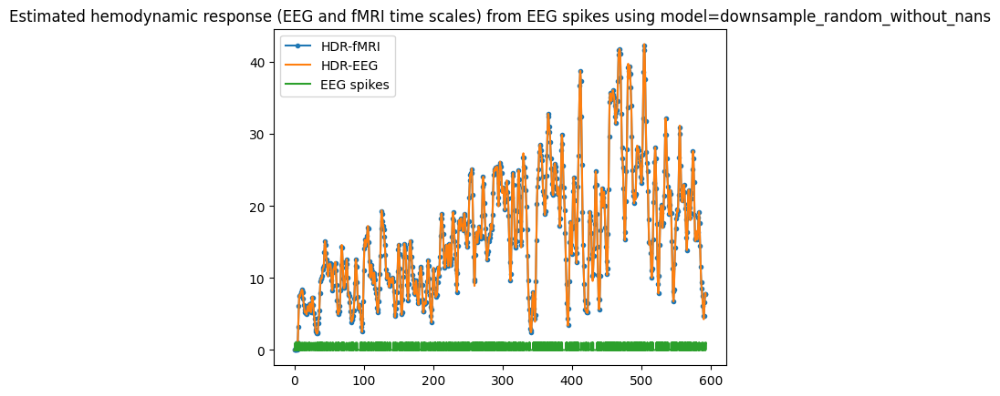

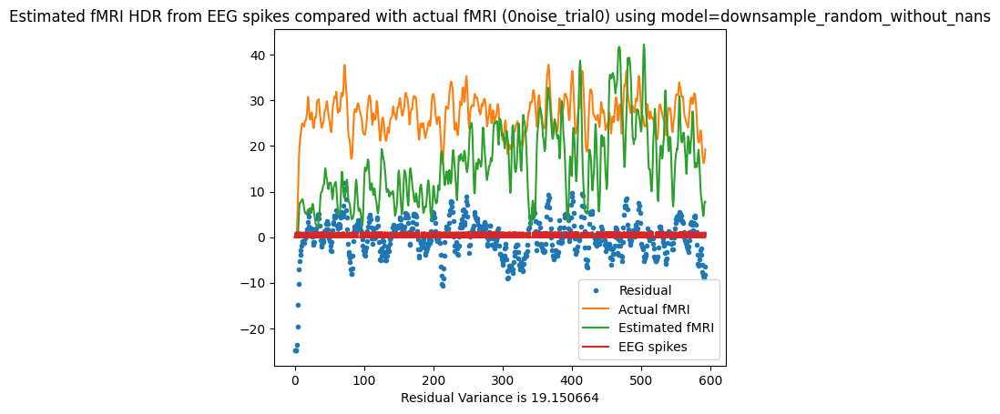

Residual Variance is 19.150664


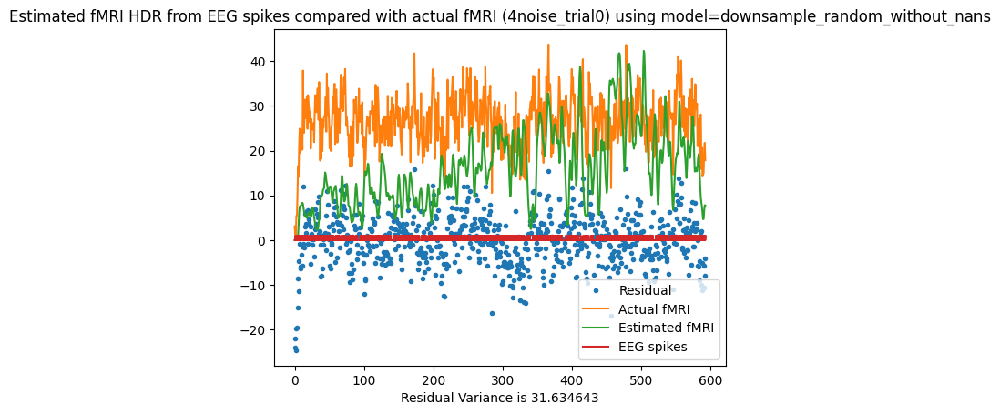

Residual Variance is 31.634643


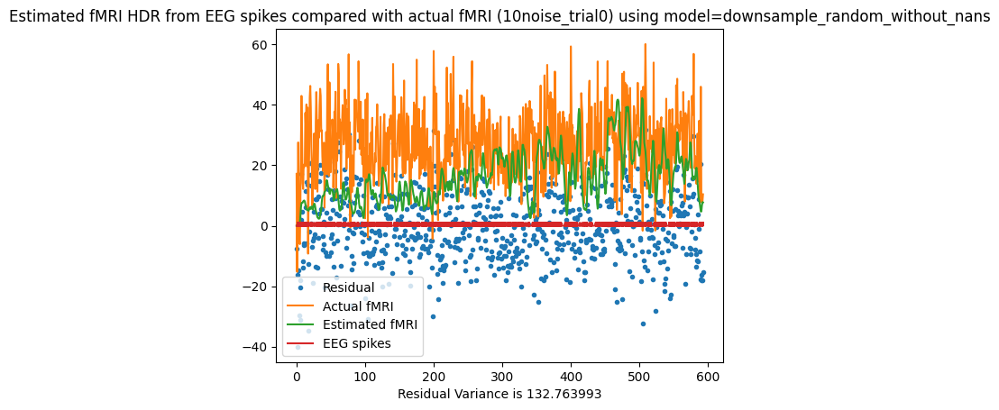

Residual Variance is 132.763993
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.64 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.58 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.64 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.71 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.77 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.77 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.82 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.79 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.80 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.97 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.86 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.95 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 1.96 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 1.90 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 19.097195243890503; at
     delta   tau  alpha
461   1.05  1.75   2.25


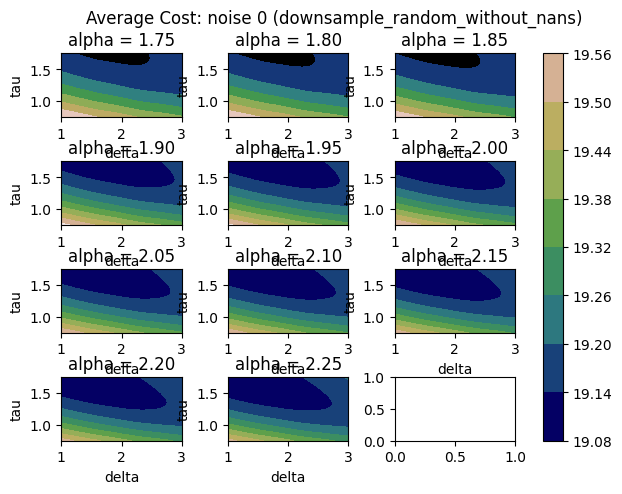

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 20.112794635211987; at
     delta   tau  alpha
692    1.1  1.75   2.25


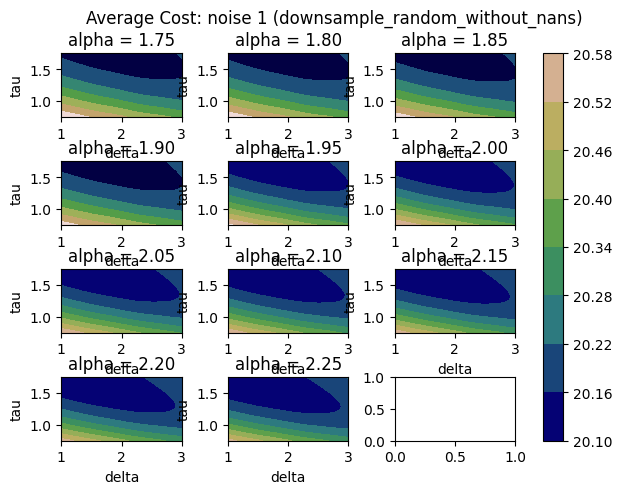

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 35.151797757462546; at
     delta   tau  alpha
461   1.05  1.75   2.25


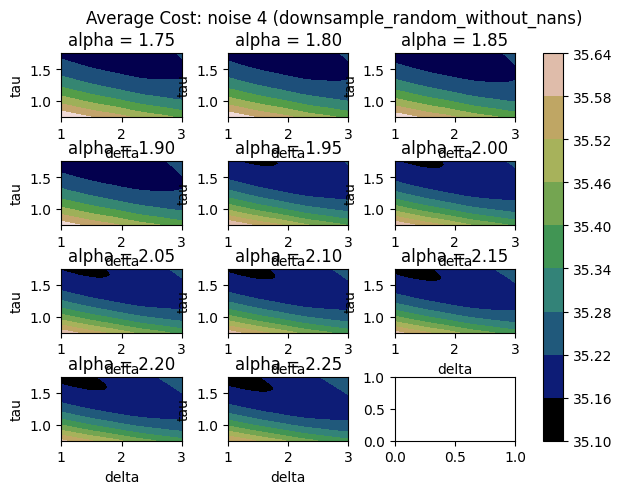

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 68.09212191875966; at
      delta   tau  alpha
2078    1.4  1.75   2.25


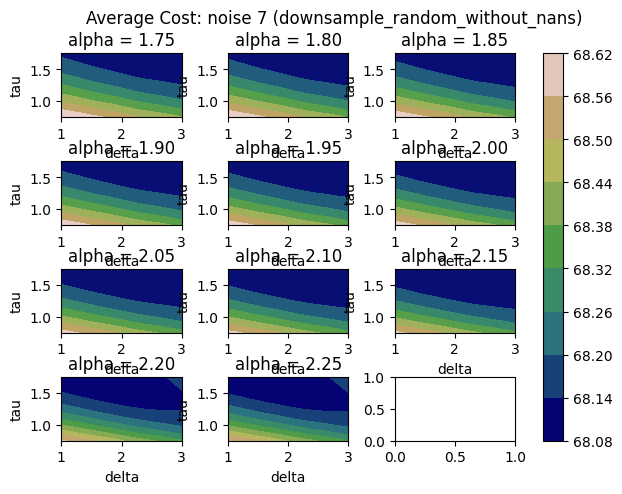

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 117.84909381781542; at
     delta   tau  alpha
230    1.0  1.75   2.25


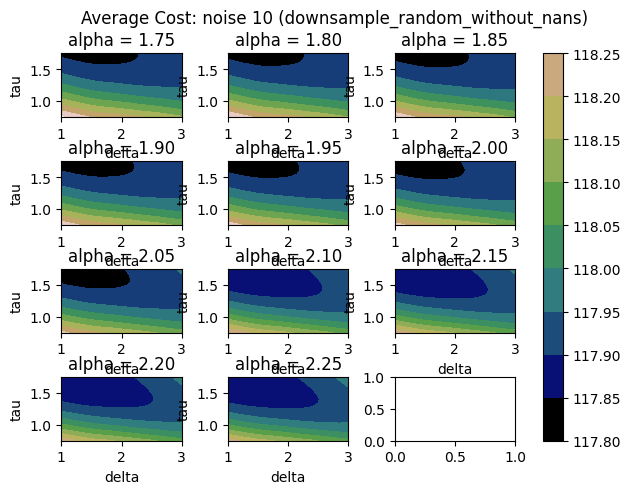

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 187.10825610130985; at
      delta   tau  alpha
3442    1.7  1.65   2.25


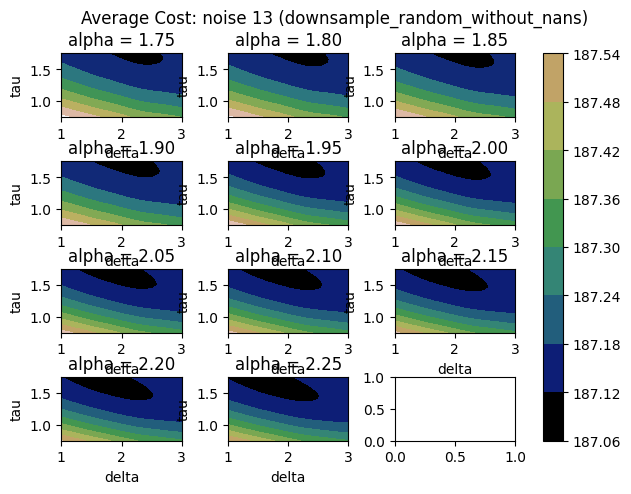

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


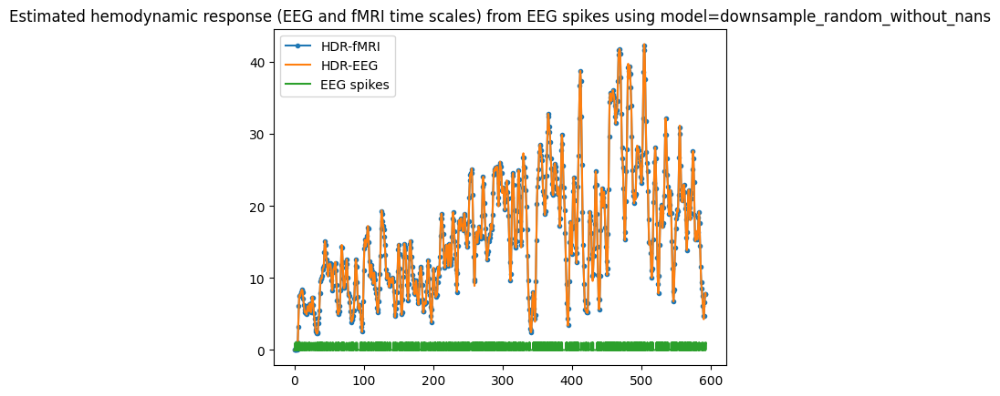

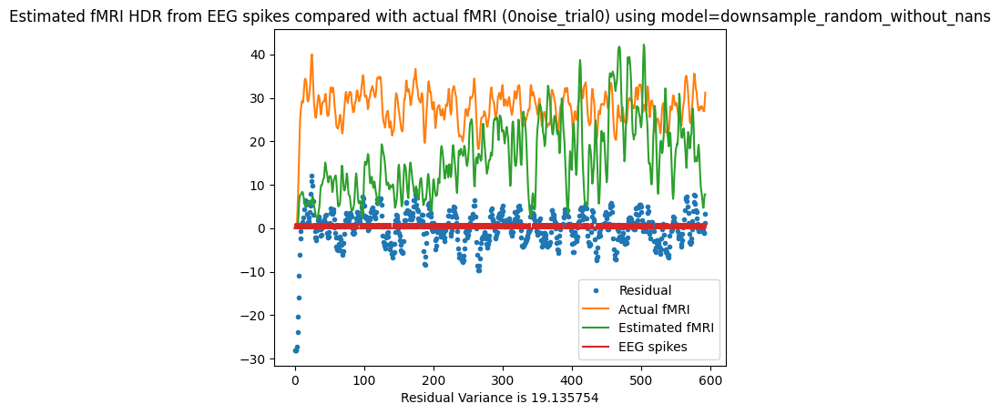

Residual Variance is 19.135754


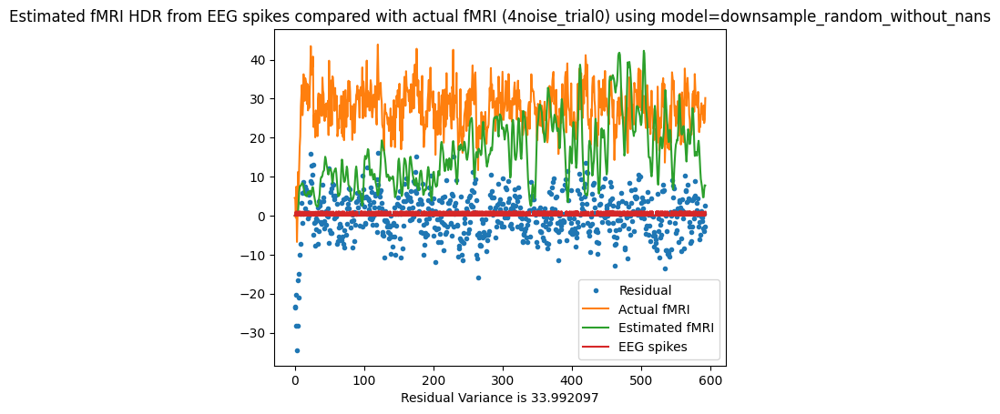

Residual Variance is 33.992097


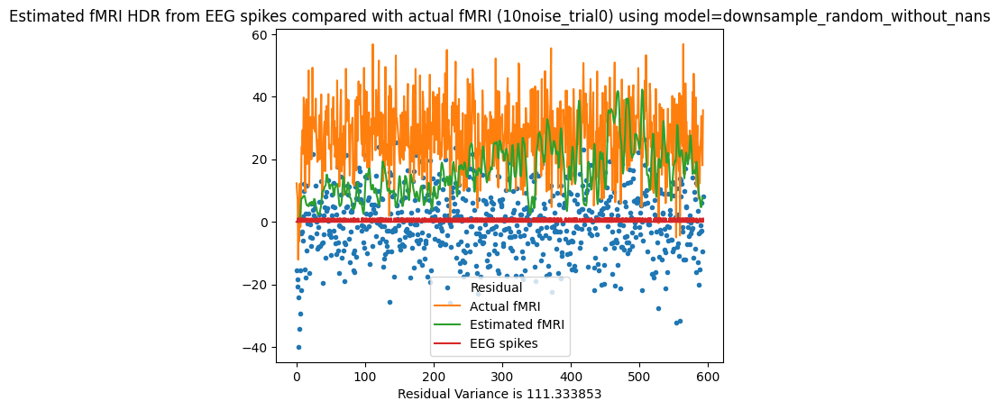

Residual Variance is 111.333853
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.57 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.62 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.72 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.79 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.83 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.96 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.89 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.88 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.92 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.94 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.94 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.98 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 1.99 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 1.98 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 19.103599815470687; at
      delta   tau  alpha
5544    2.2  0.75   1.75


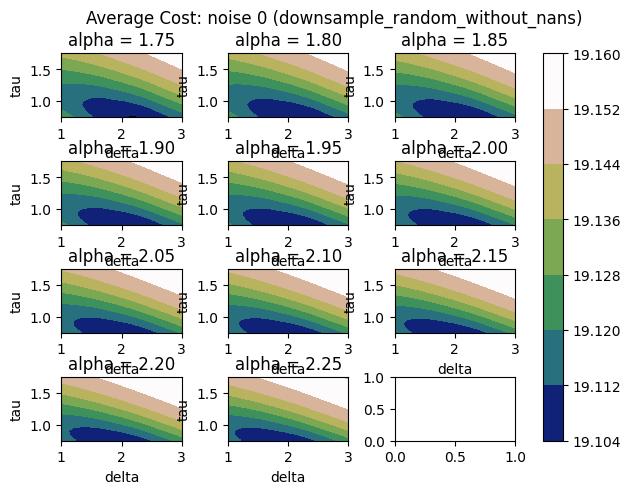

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 20.081680494932304; at
      delta   tau  alpha
5775   2.25  0.75   1.75


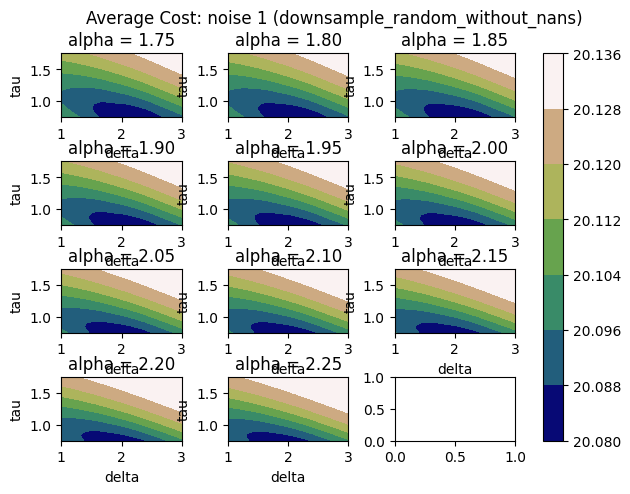

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 34.95240830834556; at
      delta   tau  alpha
6006    2.3  0.75   1.75


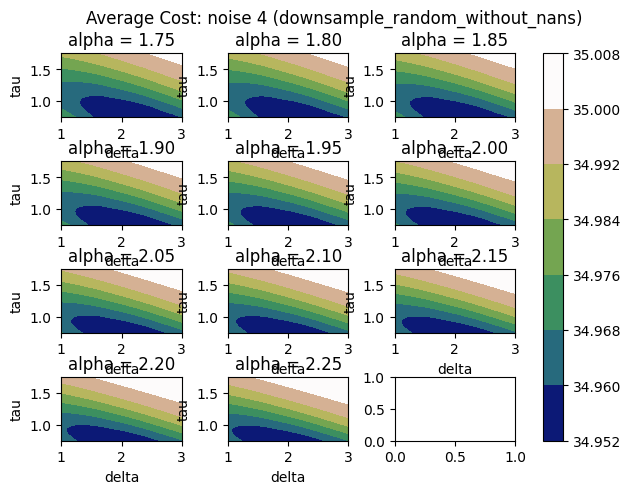

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 68.28342087108234; at
      delta   tau  alpha
4856   2.05  0.75    2.0


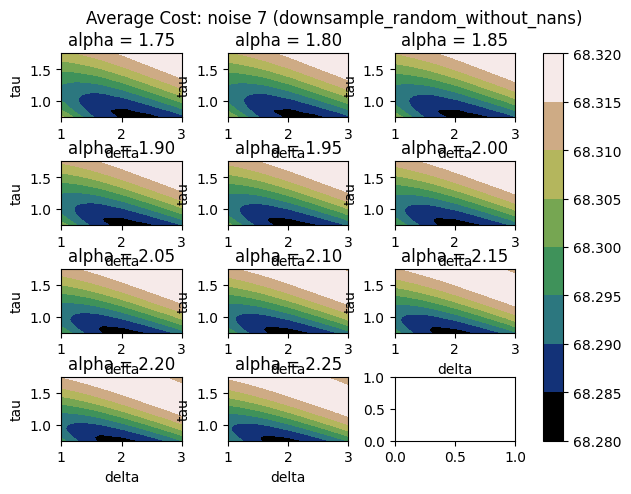

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 119.16177783683469; at
      delta   tau  alpha
5775   2.25  0.75   1.75


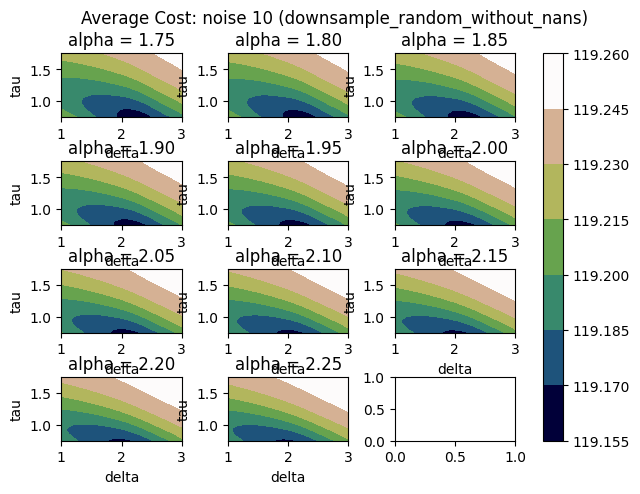

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 188.7270485823333; at
      delta  tau  alpha
1451    1.3  1.0   2.25


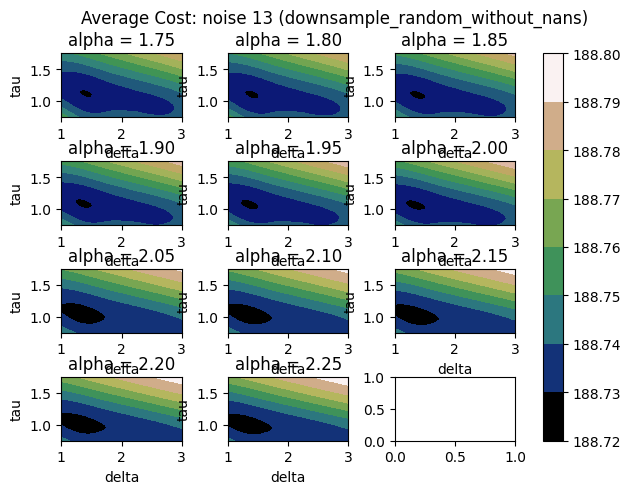

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


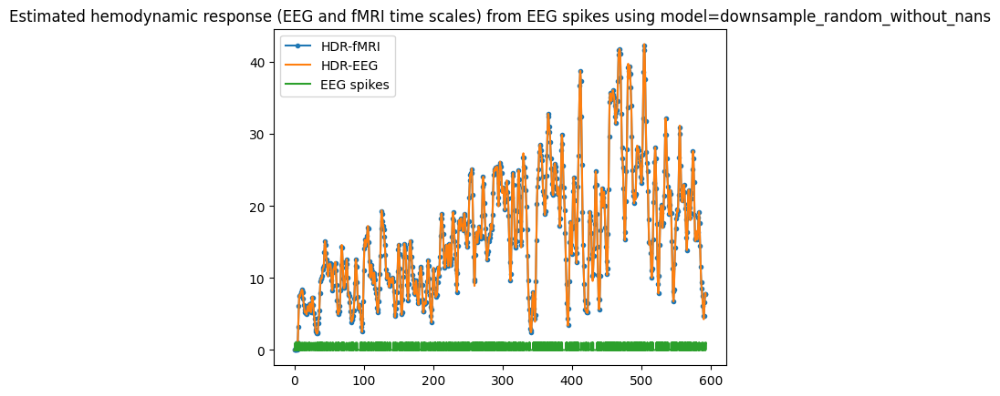

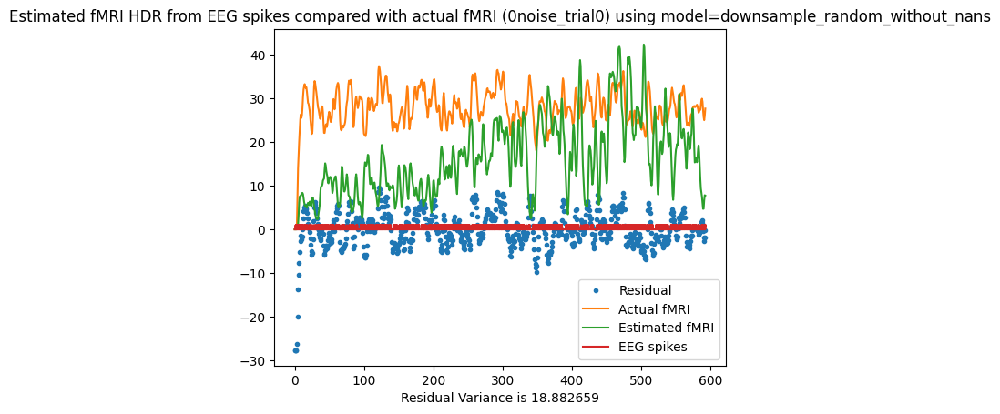

Residual Variance is 18.882659


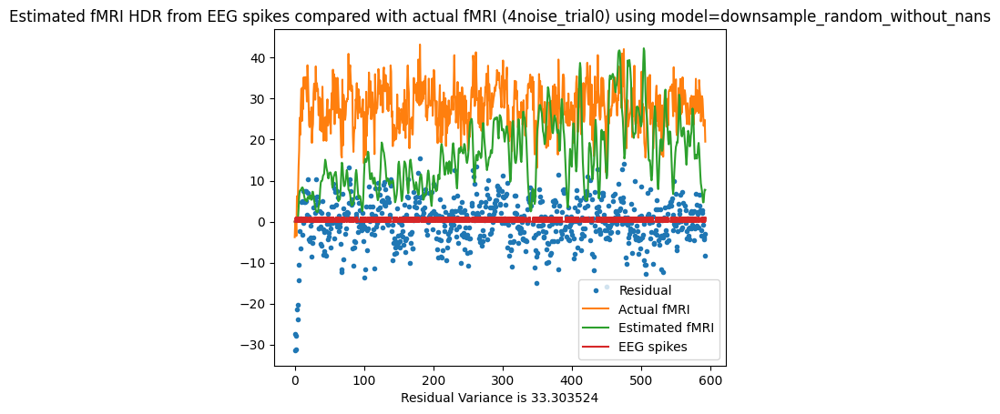

Residual Variance is 33.303524


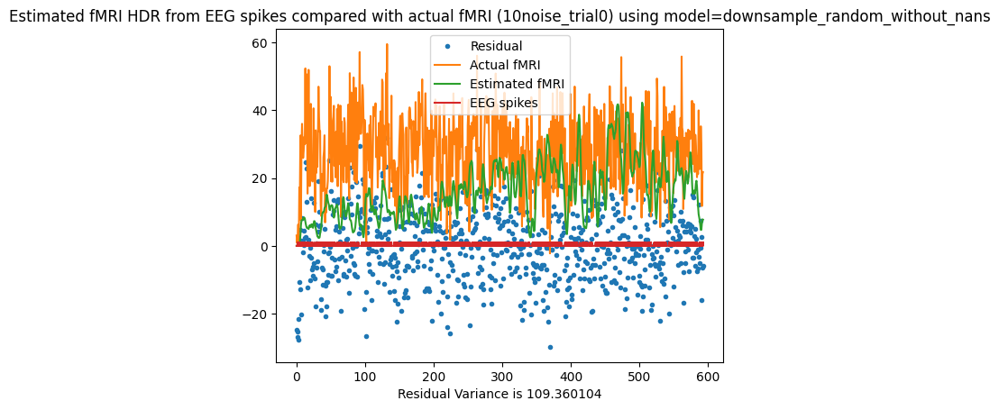

Residual Variance is 109.360104
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.49 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.49 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.57 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.65 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.71 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.74 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.87 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.83 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.89 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.90 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.94 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 2.07 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.06 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 2.08 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 18.524642276098124; at
      delta   tau  alpha
9470    3.0  1.75   2.25


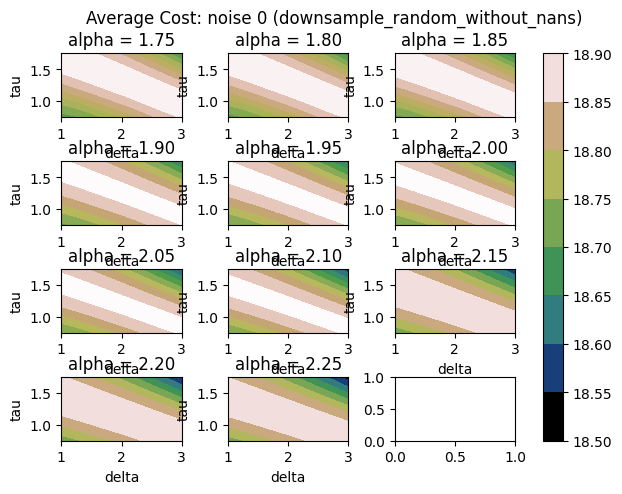

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 19.501400583048607; at
      delta   tau  alpha
9470    3.0  1.75   2.25


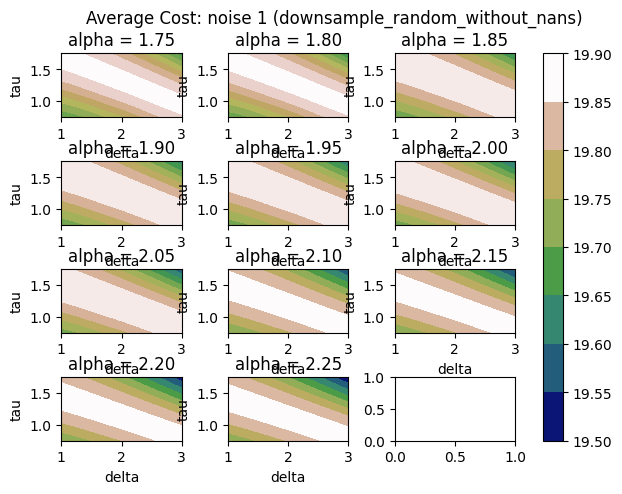

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 34.613063905803614; at
      delta   tau  alpha
9470    3.0  1.75   2.25


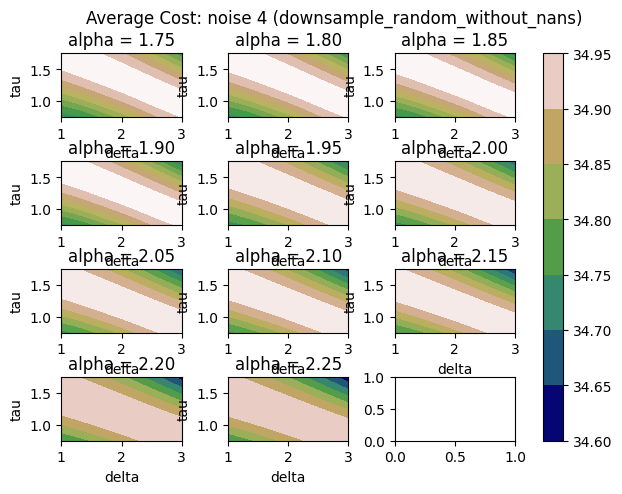

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 67.3467560655911; at
      delta   tau  alpha
9470    3.0  1.75   2.25


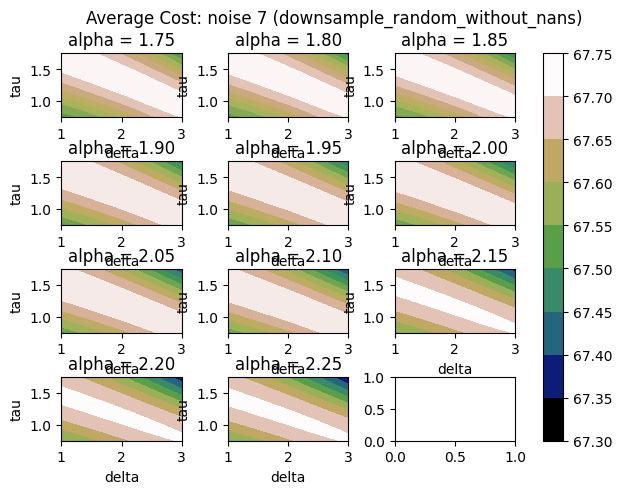

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 117.77824855367233; at
      delta   tau  alpha
9470    3.0  1.75   2.25


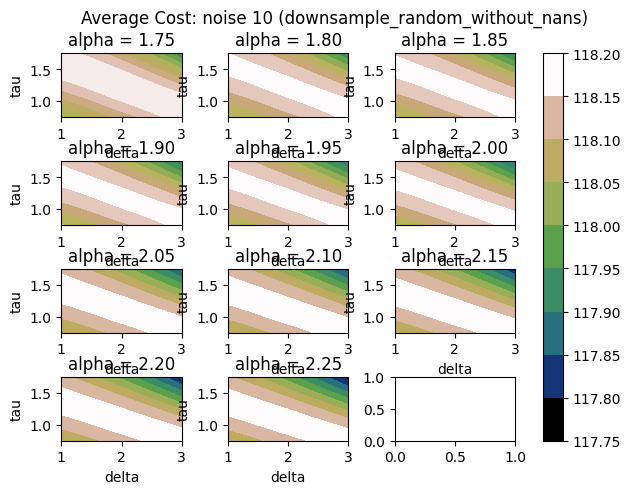

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 187.20367023170624; at
      delta   tau  alpha
9470    3.0  1.75   2.25


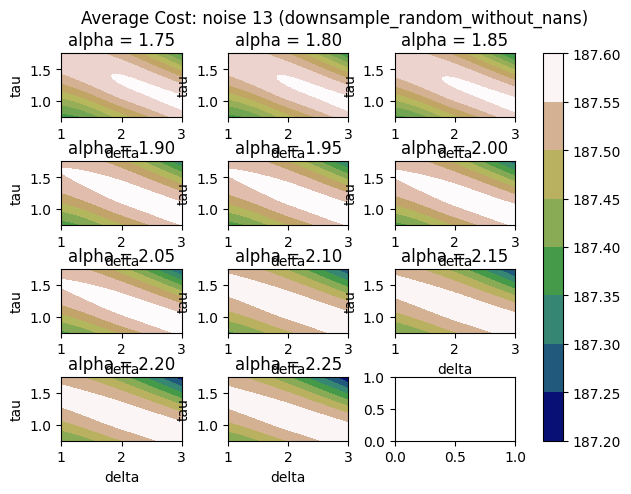

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


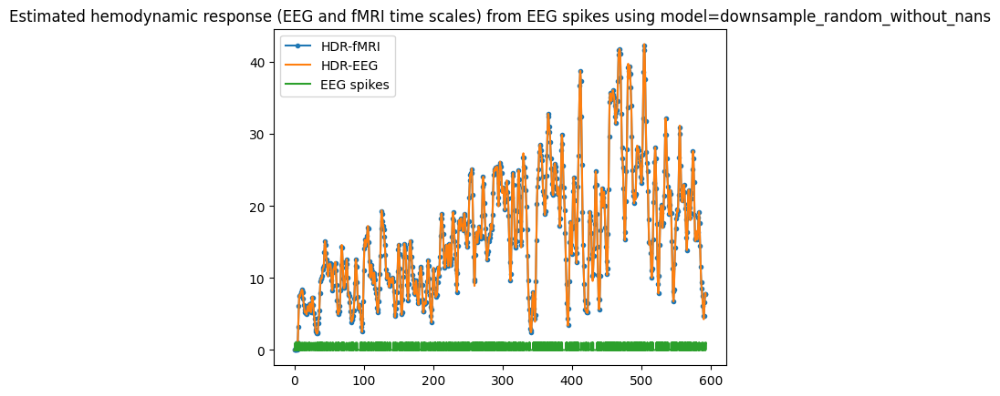

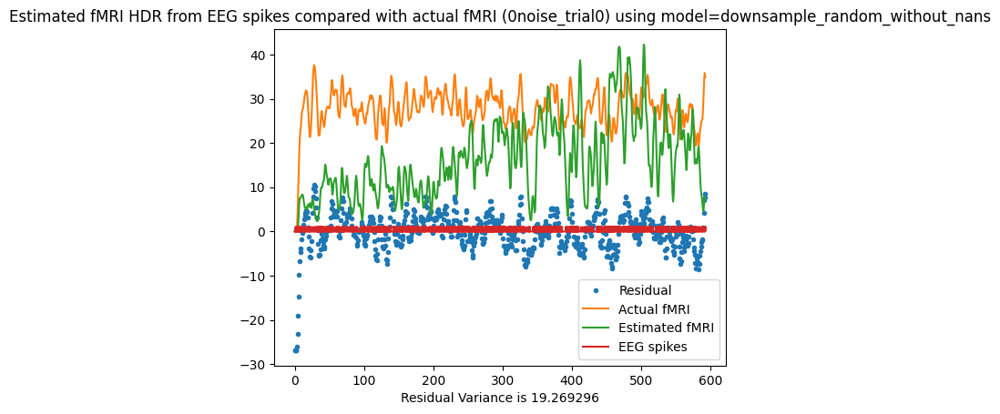

Residual Variance is 19.269296


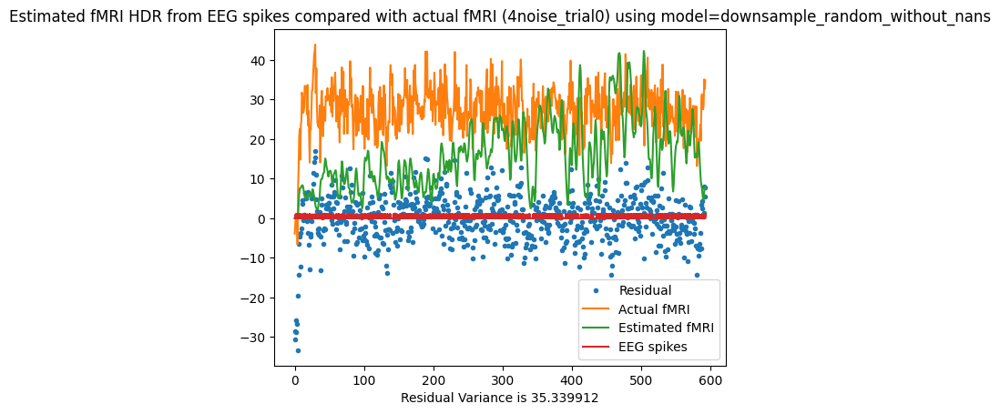

Residual Variance is 35.339912


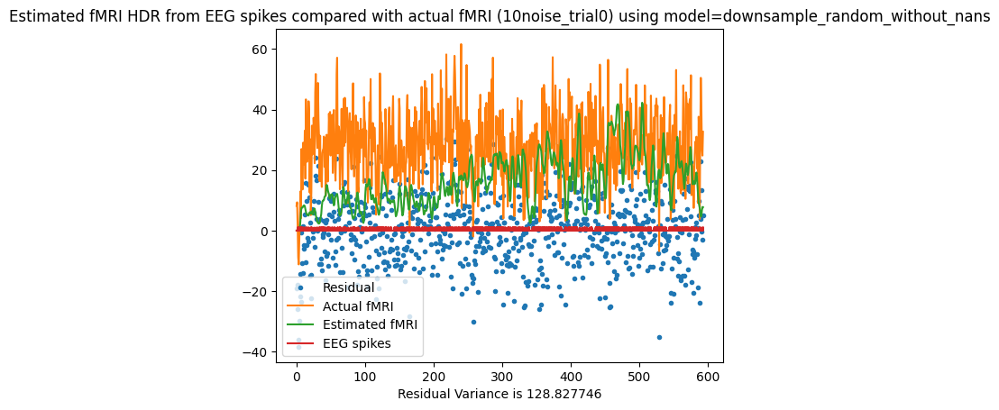

Residual Variance is 128.827746
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.57 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.59 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.59 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.64 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.71 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.85 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.82 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.83 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.81 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.88 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.81 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.82 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 1.84 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 1.89 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 19.245799708285077; at
      delta   tau  alpha
4850    2.0  1.75   2.25


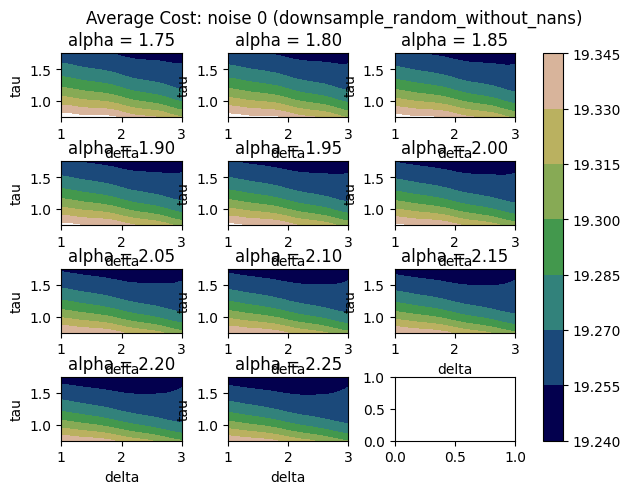

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 20.311014456407527; at
      delta   tau  alpha
5081   2.05  1.75   2.25


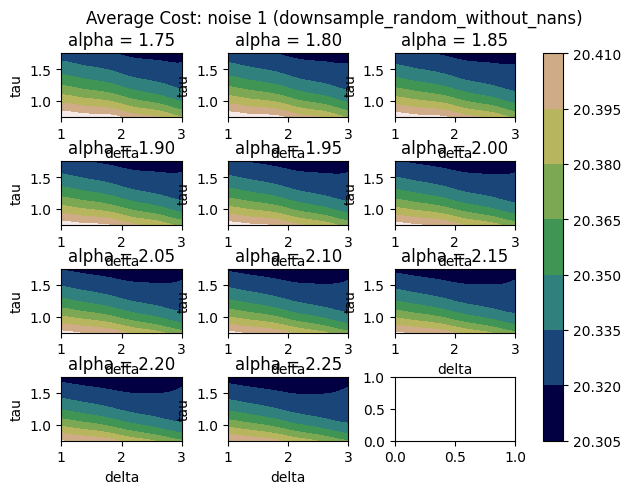

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 35.2184787651135; at
      delta   tau  alpha
5774    2.2  1.75   2.25


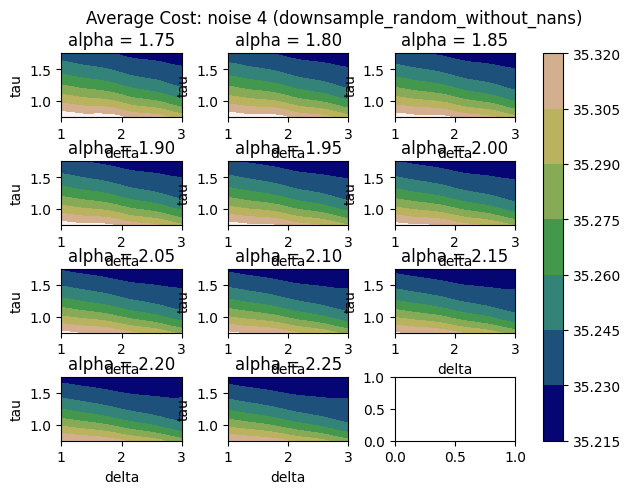

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 67.8637053182728; at
      delta   tau  alpha
7391   2.55  1.75   2.25


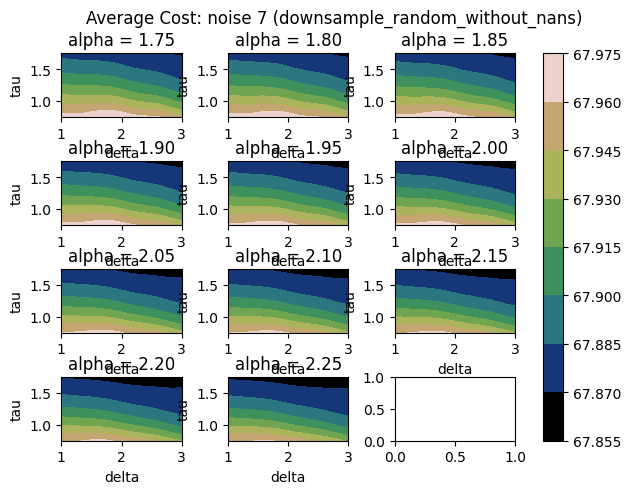

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 118.65293737985259; at
      delta   tau  alpha
9470    3.0  1.75   2.25


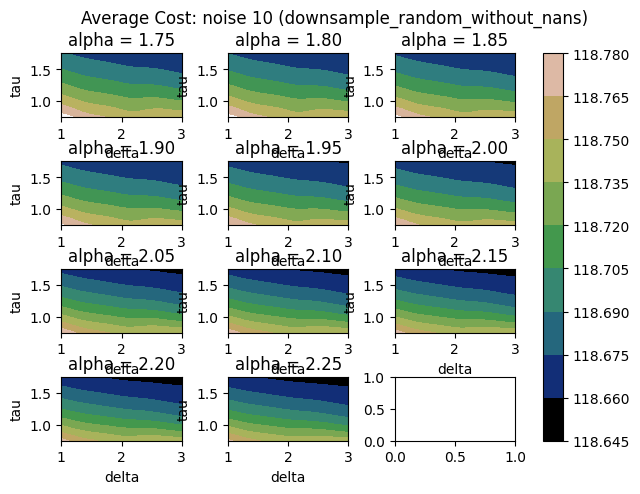

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 188.12513102223977; at
      delta  tau  alpha
1672   1.35  1.0   1.75


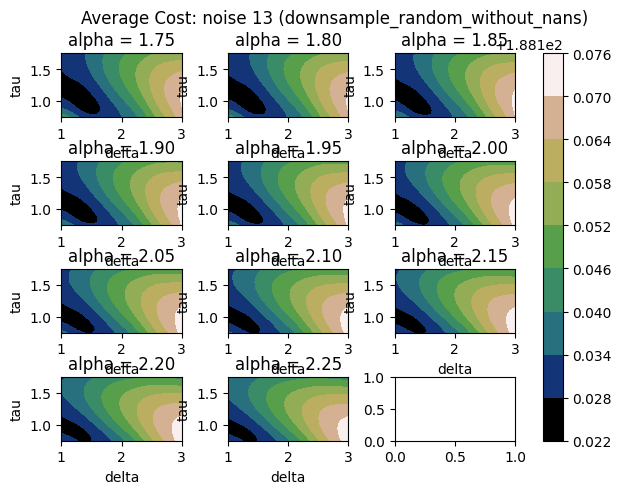

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


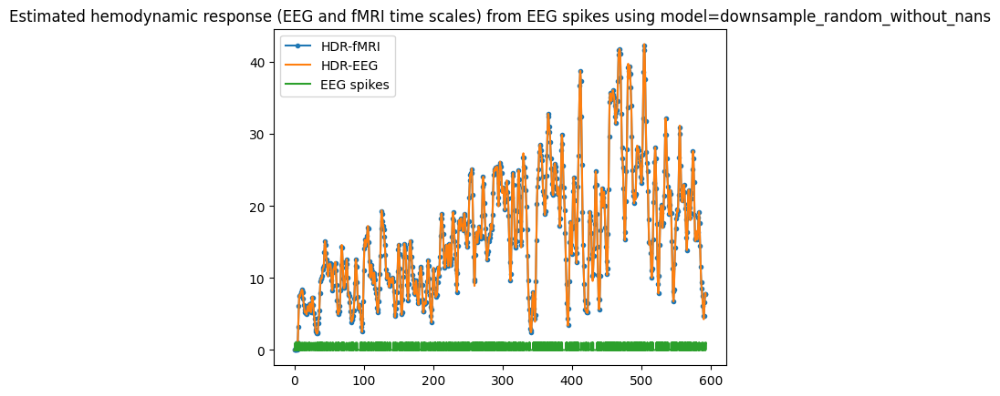

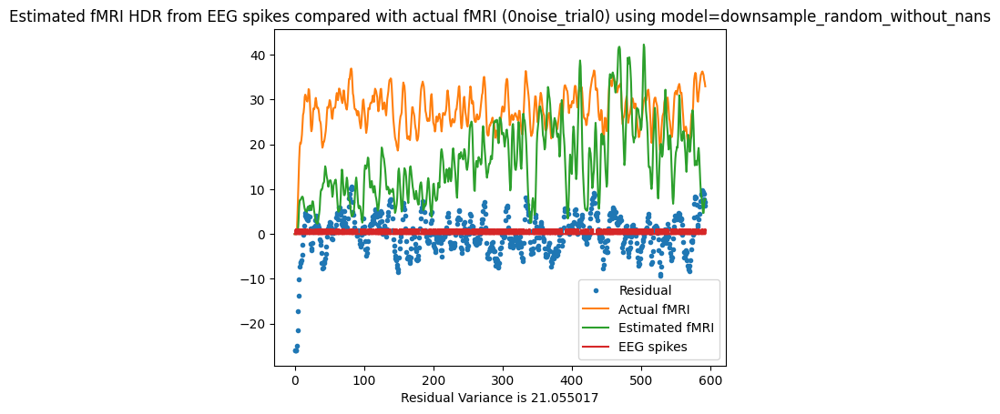

Residual Variance is 21.055017


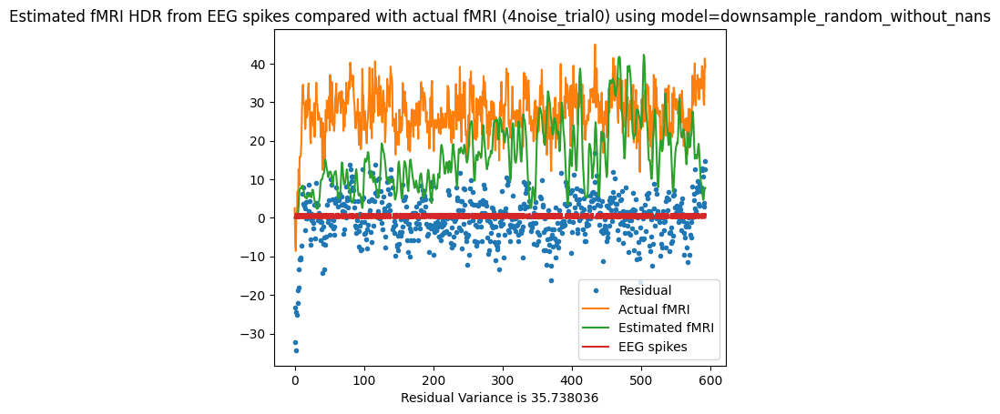

Residual Variance is 35.738036


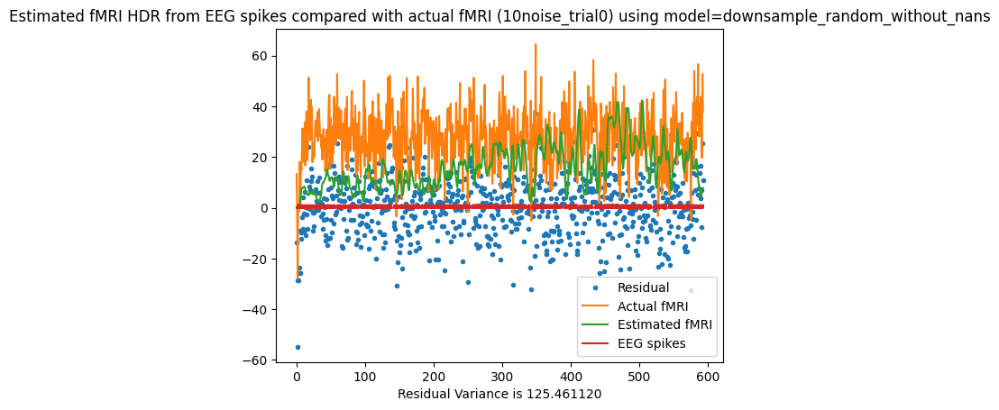

Residual Variance is 125.461120
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.49 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.50 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.60 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.73 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.74 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.85 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.80 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.81 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.82 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.82 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.81 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.81 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 1.83 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 1.82 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 20.75376275789299; at
      delta  tau  alpha
9459    3.0  1.7   2.25


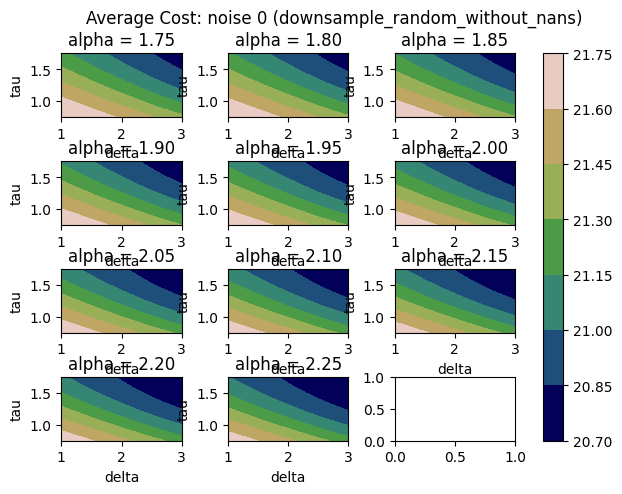

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 21.746920744195467; at
      delta  tau  alpha
9459    3.0  1.7   2.25


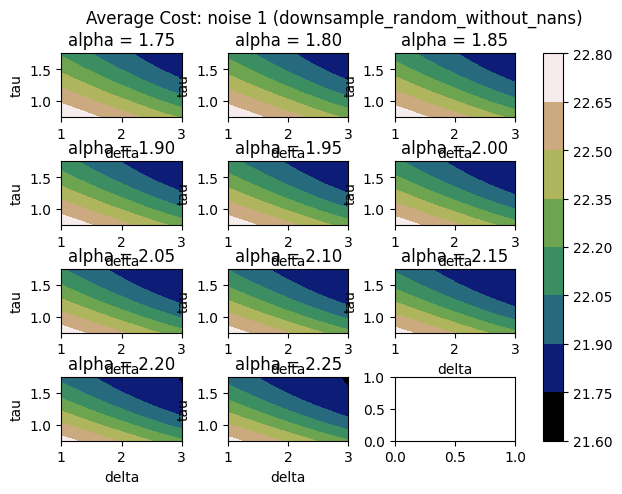

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 36.735729367540685; at
      delta  tau  alpha
9459    3.0  1.7   2.25


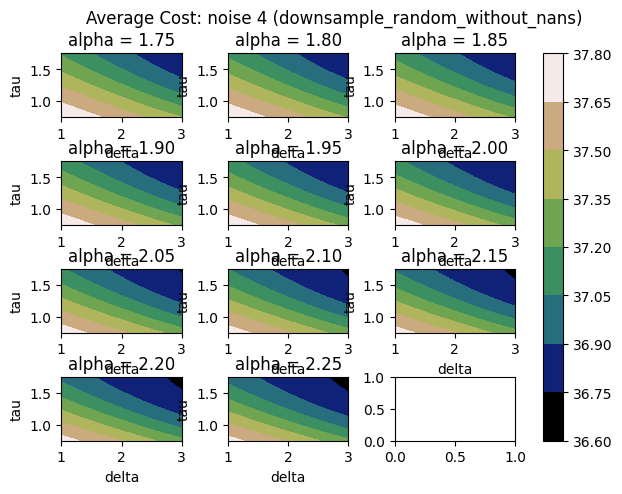

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 69.41686648509817; at
      delta   tau  alpha
9448    3.0  1.65   2.25


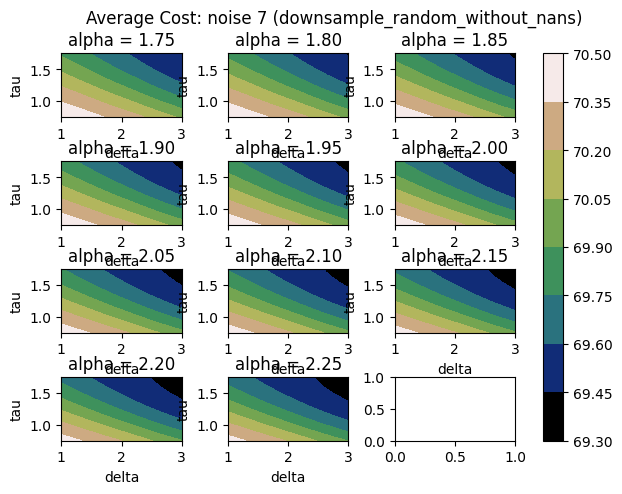

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 121.61114756182349; at
      delta   tau  alpha
9448    3.0  1.65   2.25


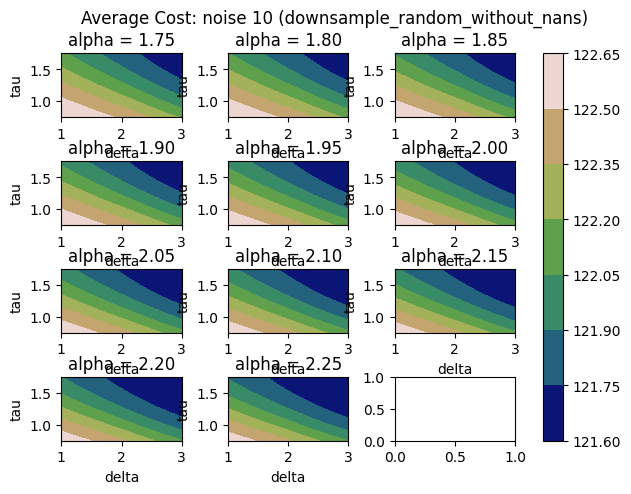

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 189.7768422757912; at
      delta   tau  alpha
9470    3.0  1.75   2.25


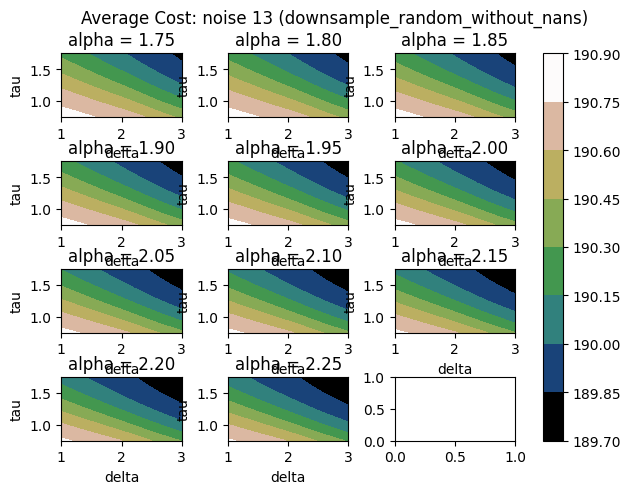

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


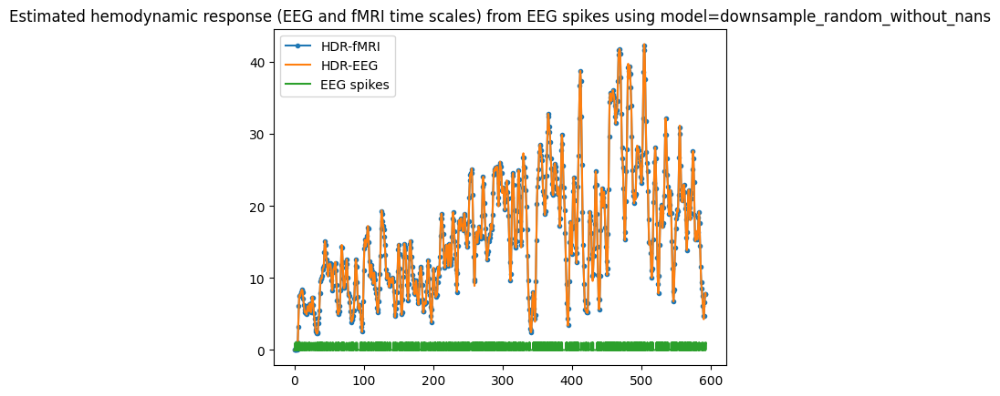

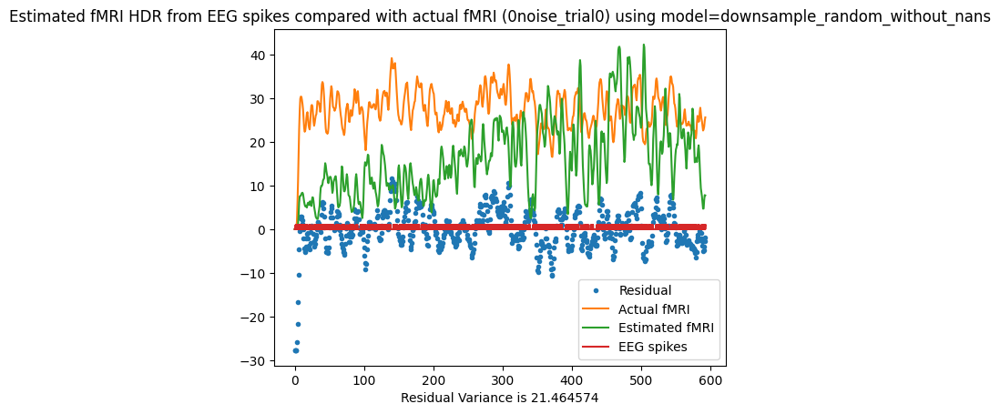

Residual Variance is 21.464574


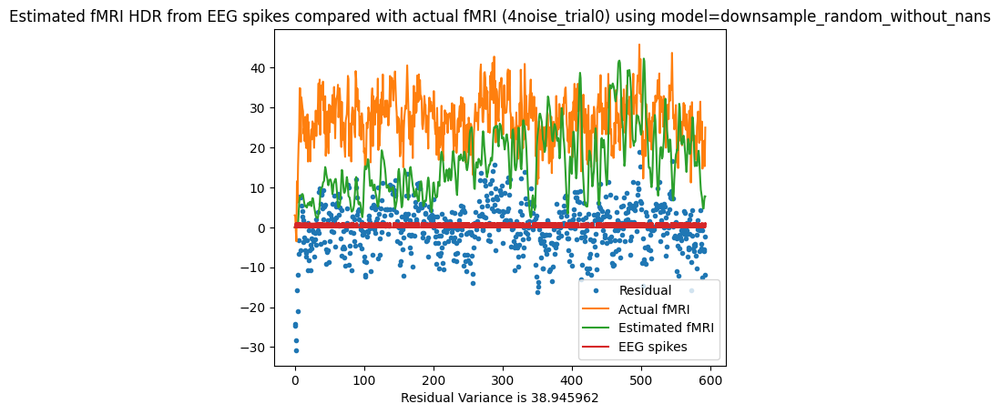

Residual Variance is 38.945962


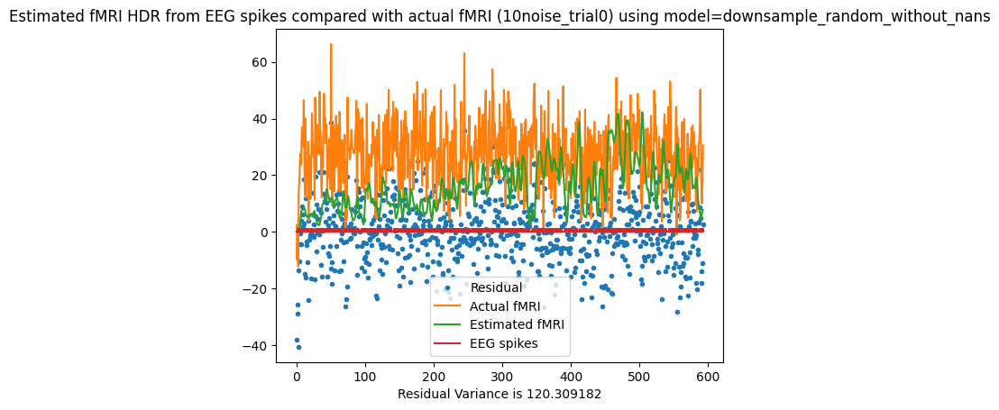

Residual Variance is 120.309182
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.55 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.49 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.55 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.64 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.70 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.74 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.74 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.81 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.79 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.79 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.79 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.97 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 1.90 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 1.80 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 21.418455541860034; at
      delta   tau  alpha
9240    3.0  0.75   1.75


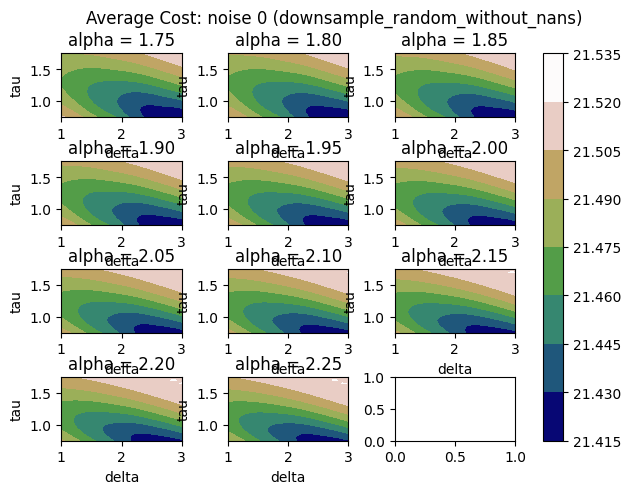

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 22.410829738605784; at
      delta   tau  alpha
9240    3.0  0.75   1.75


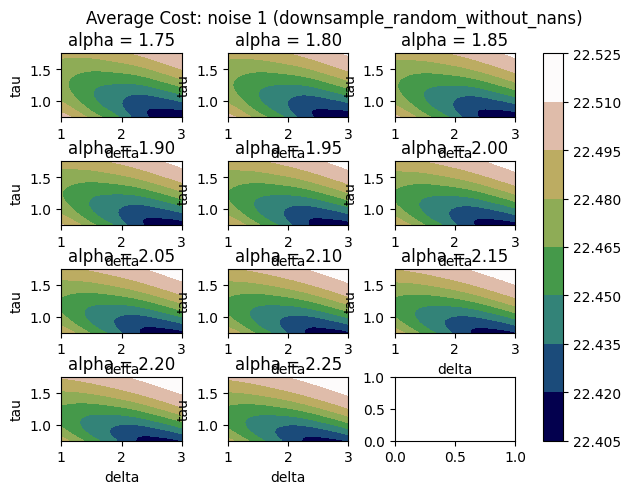

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 37.20461448770581; at
      delta   tau  alpha
9240    3.0  0.75   1.75


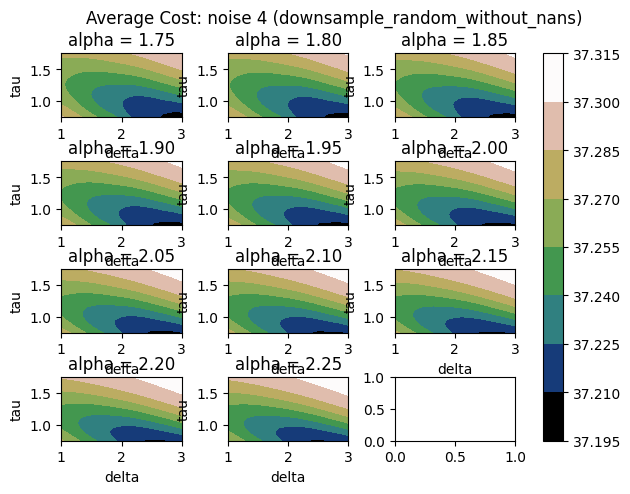

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 70.36087938681277; at
      delta   tau  alpha
9242    3.0  0.75   1.85


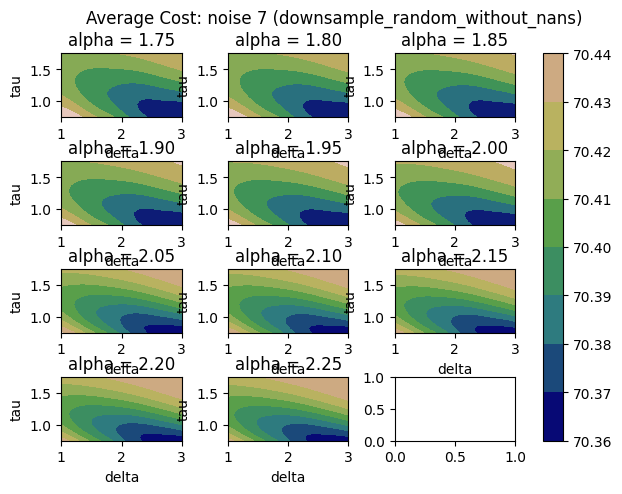

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 120.56101235517944; at
      delta   tau  alpha
9240    3.0  0.75   1.75


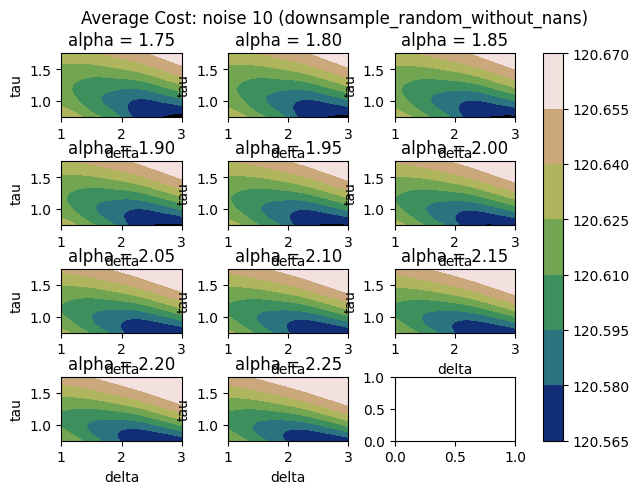

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 192.06513510659374; at
      delta   tau  alpha
9243    3.0  0.75    1.9


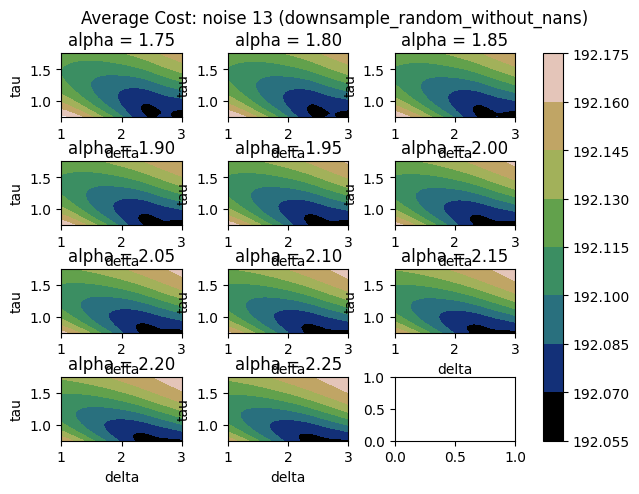

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


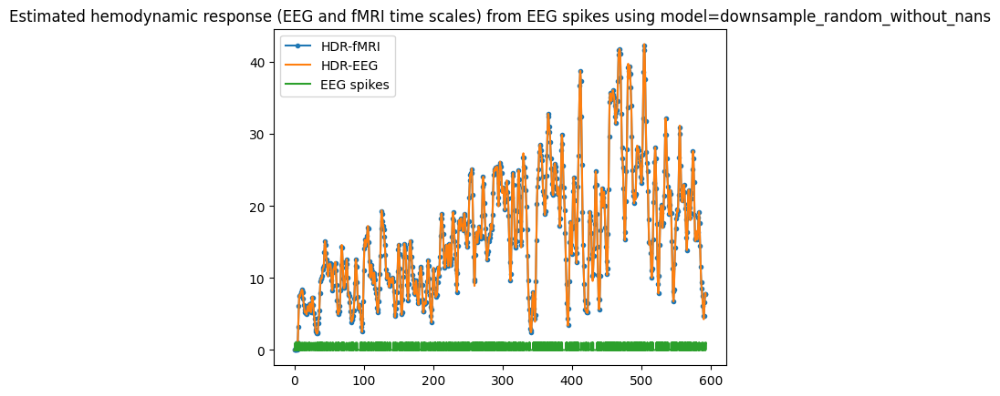

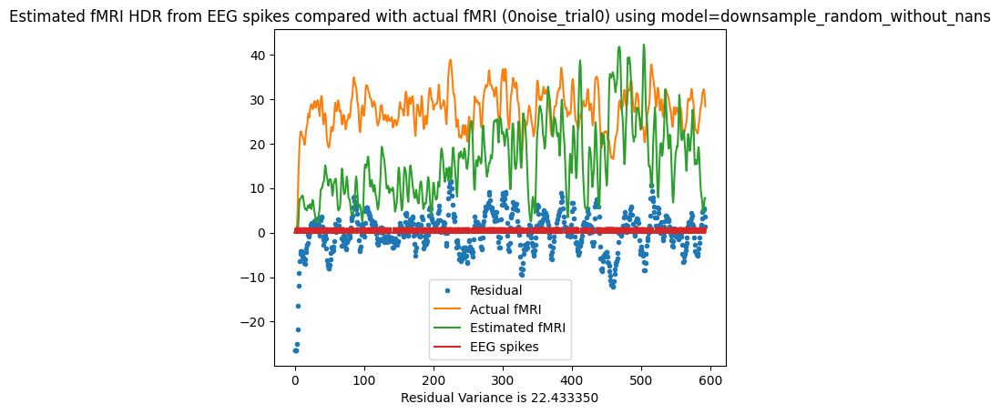

Residual Variance is 22.433350


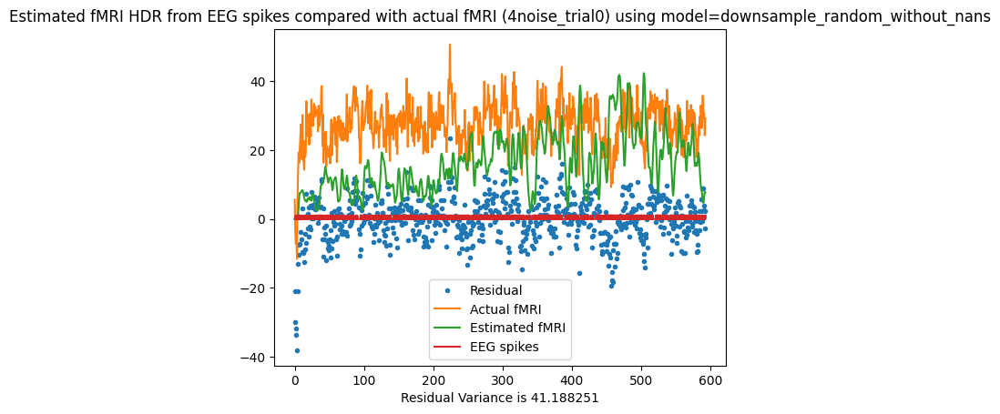

Residual Variance is 41.188251


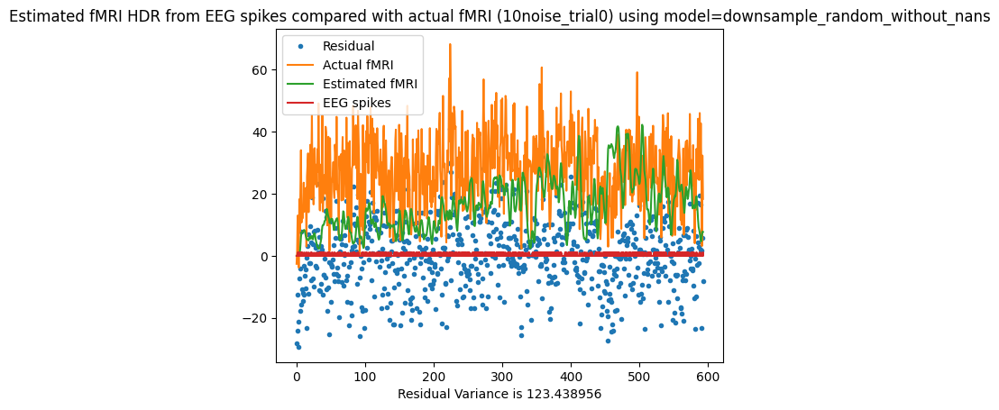

Residual Variance is 123.438956
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.57 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.57 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.65 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.75 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.80 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.84 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.94 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.96 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.92 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.93 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.97 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.92 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 1.93 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 1.98 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 22.347589458223407; at
      delta   tau  alpha
9470    3.0  1.75   2.25


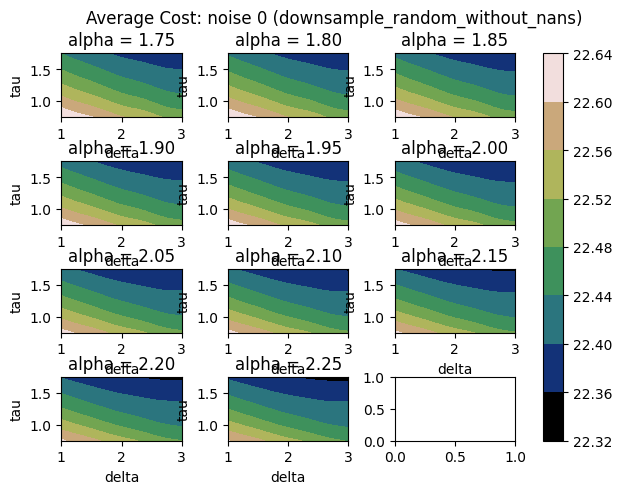

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 23.35513562134885; at
      delta   tau  alpha
9470    3.0  1.75   2.25


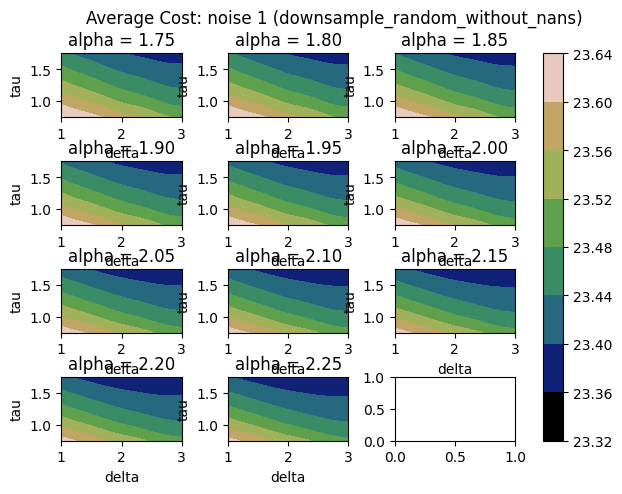

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 38.263559683436455; at
      delta   tau  alpha
9470    3.0  1.75   2.25


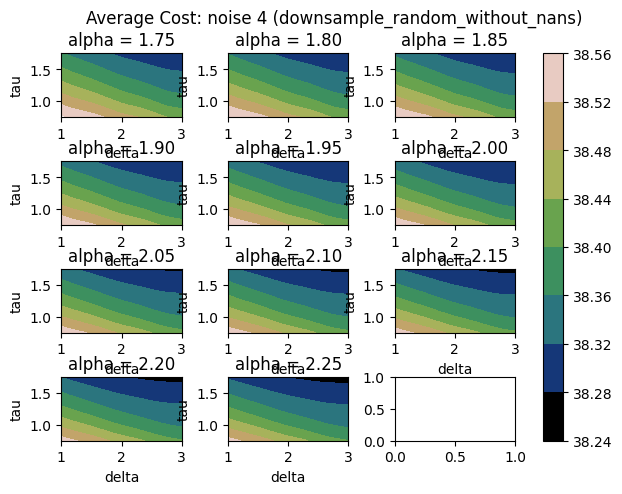

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 70.97757331603412; at
      delta   tau  alpha
9470    3.0  1.75   2.25


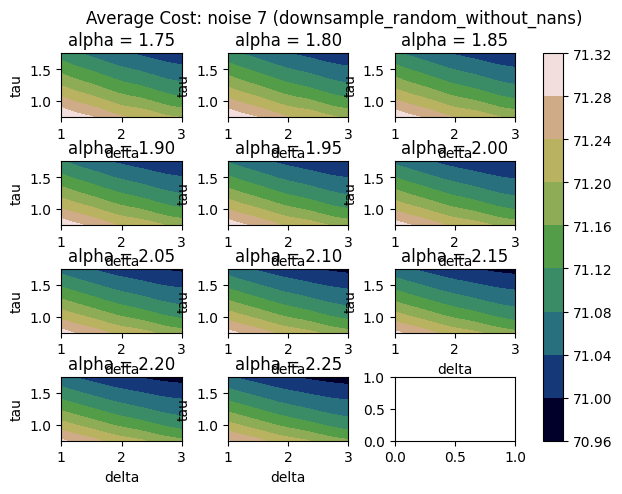

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 123.96159320108038; at
      delta   tau  alpha
9470    3.0  1.75   2.25


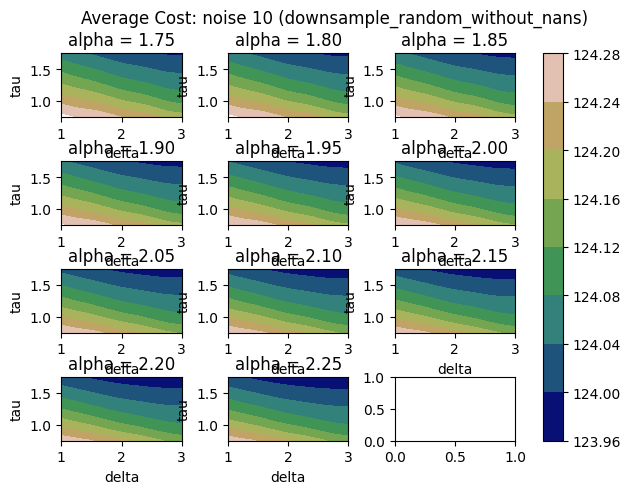

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 191.77618864431878; at
      delta   tau  alpha
9470    3.0  1.75   2.25


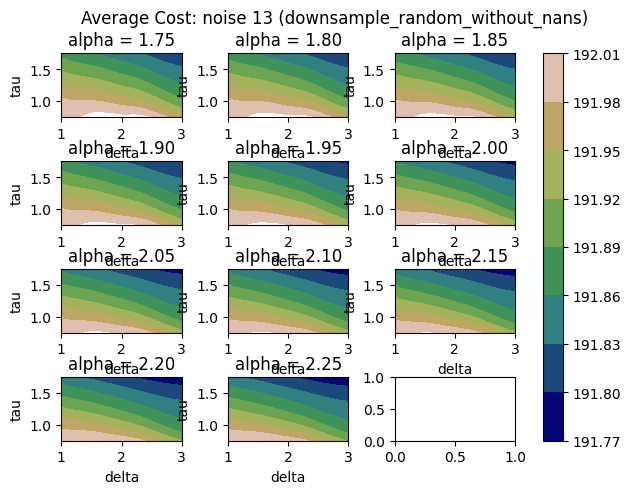

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


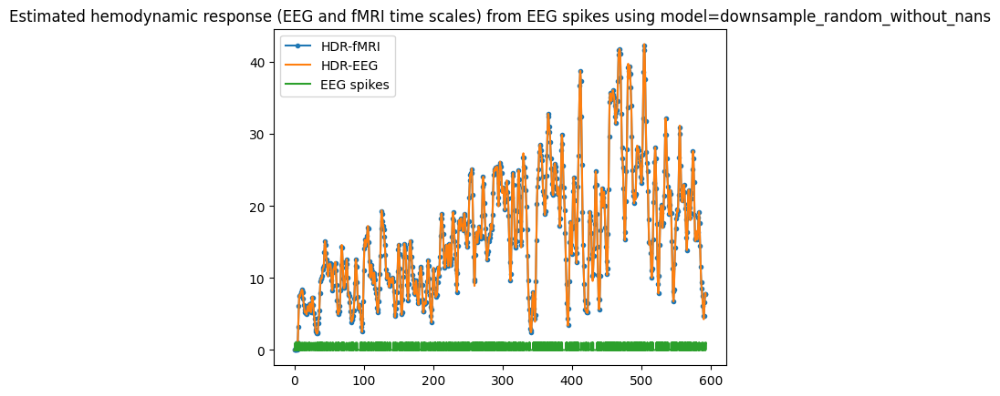

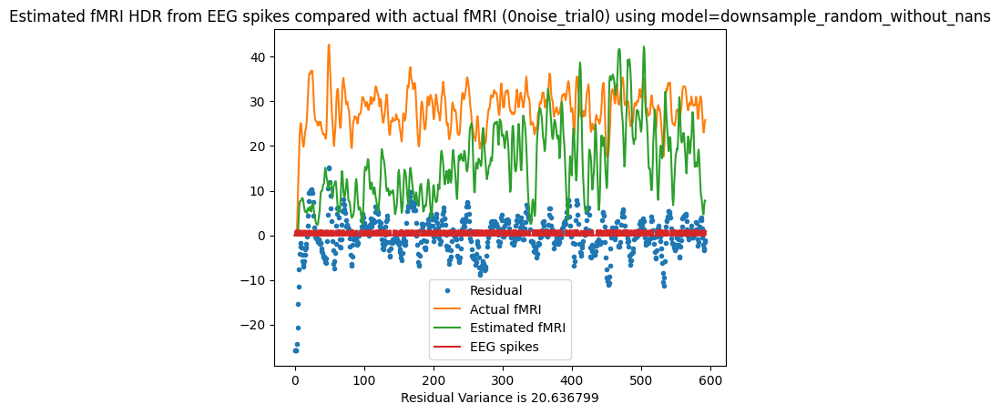

Residual Variance is 20.636799


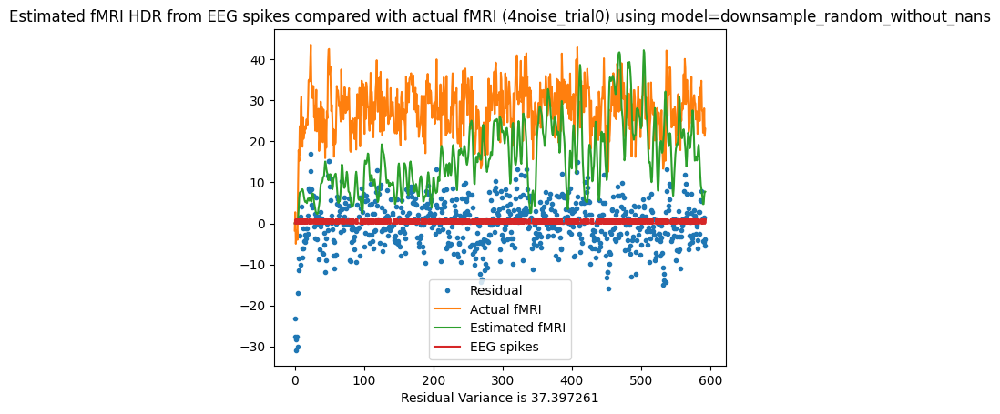

Residual Variance is 37.397261


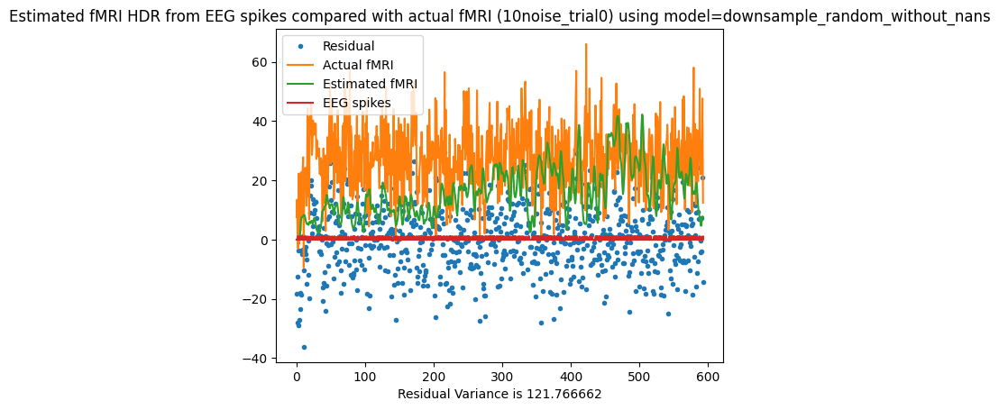

Residual Variance is 121.766662
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.56 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.64 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.62 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.74 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.78 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.83 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.88 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.90 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 2.04 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.97 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.99 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.98 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 2.06 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 1.97 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 19.984816917605908; at
      delta   tau  alpha
9470    3.0  1.75   2.25


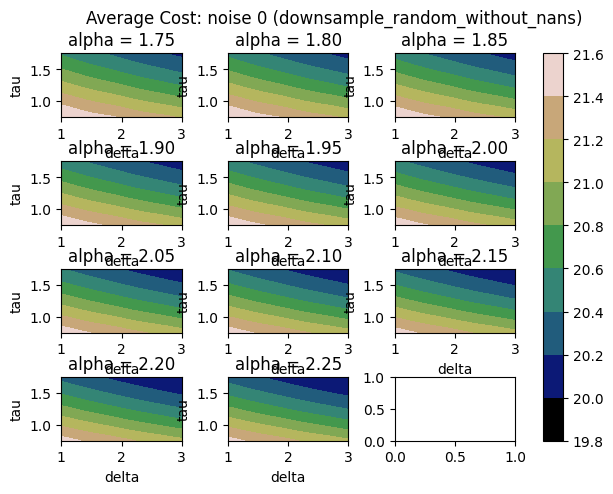

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 21.0412961636695; at
      delta   tau  alpha
9470    3.0  1.75   2.25


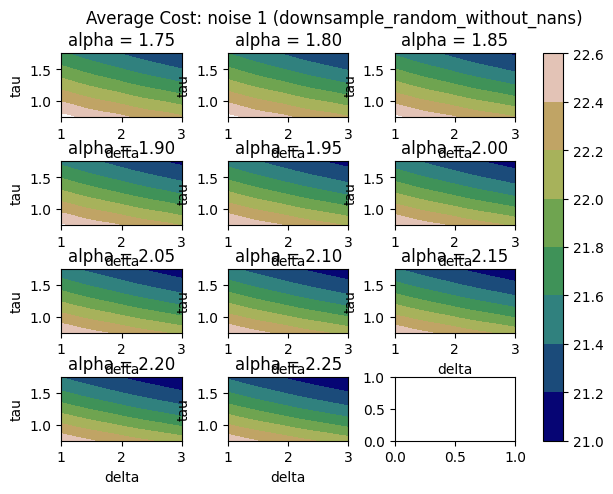

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 36.089736934449796; at
      delta   tau  alpha
9470    3.0  1.75   2.25


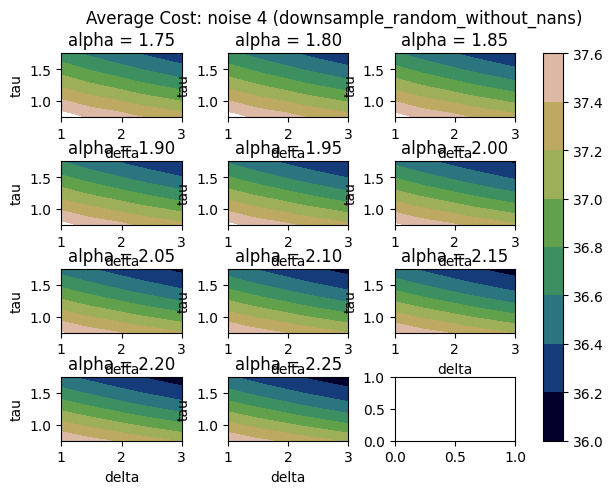

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 69.60666173916306; at
      delta   tau  alpha
9470    3.0  1.75   2.25


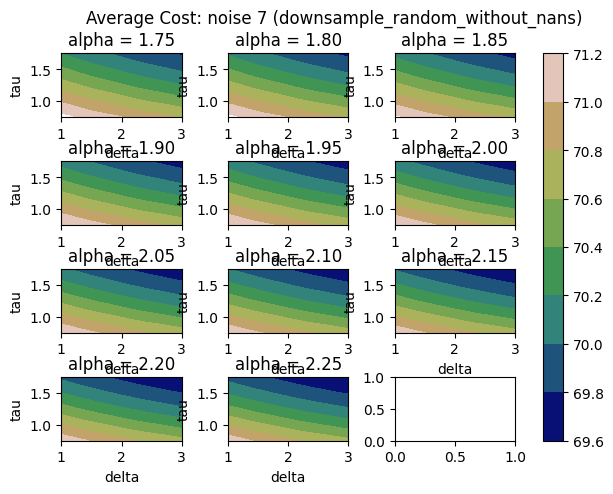

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 119.01691030080954; at
      delta   tau  alpha
9470    3.0  1.75   2.25


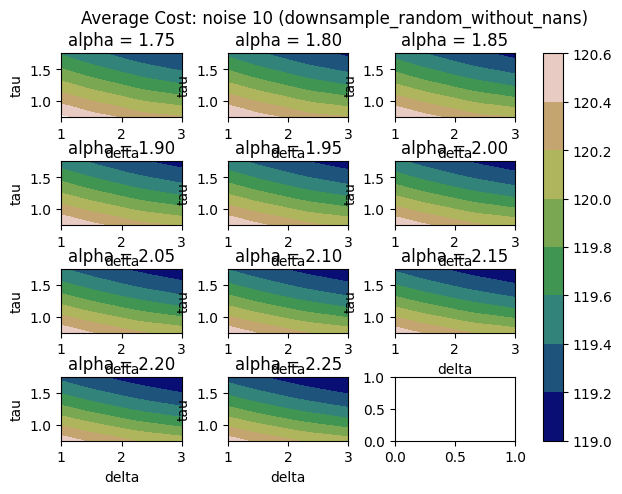

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 187.51336092951843; at
      delta   tau  alpha
9470    3.0  1.75   2.25


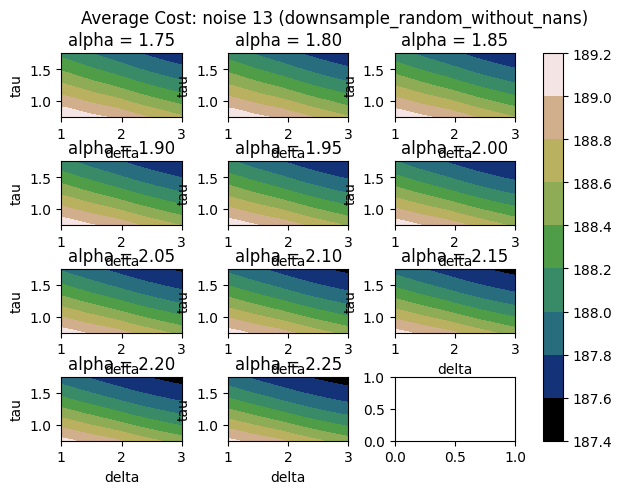

Scoring downsample_random_without_nans delta=2.25, tau=1.25, alpha=2


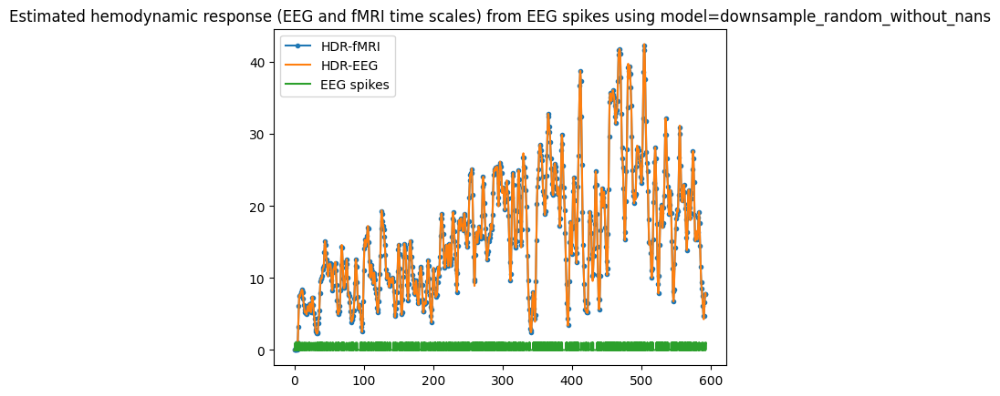

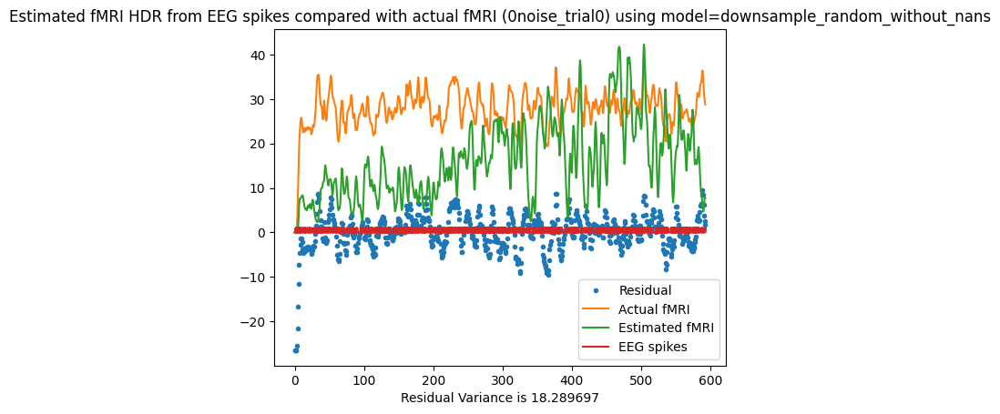

Residual Variance is 18.289697


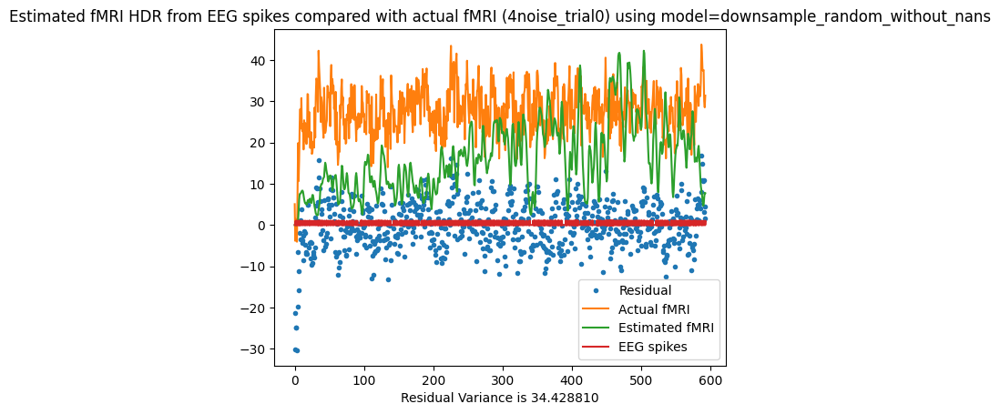

Residual Variance is 34.428810


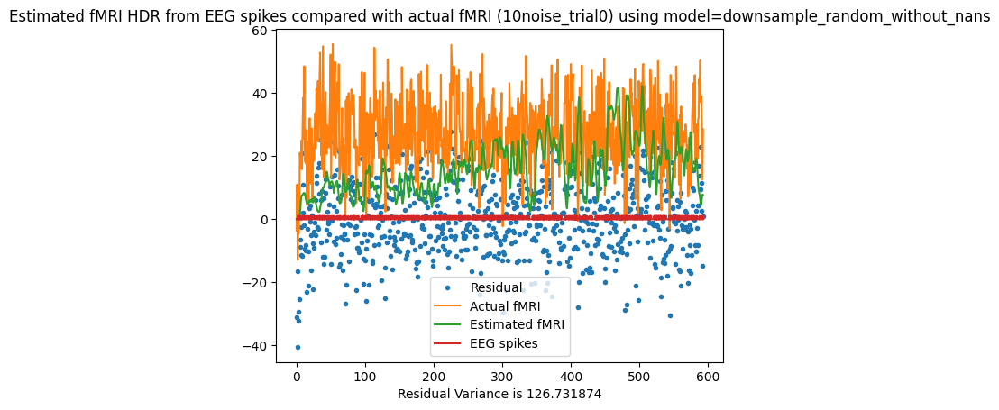

Residual Variance is 126.731874
Searching for optimal parameters!
Delta: 1.00000 (0.00%).
Delta: 1.05000 (2.44%). Last tau/alpha search took 1.56 seconds
Delta: 1.10000 (4.88%). Last tau/alpha search took 1.66 seconds
Delta: 1.15000 (7.32%). Last tau/alpha search took 1.75 seconds
Delta: 1.20000 (9.76%). Last tau/alpha search took 1.81 seconds
Delta: 1.25000 (12.20%). Last tau/alpha search took 1.85 seconds
Delta: 1.30000 (14.63%). Last tau/alpha search took 1.86 seconds
Delta: 1.35000 (17.07%). Last tau/alpha search took 1.98 seconds
Delta: 1.40000 (19.51%). Last tau/alpha search took 1.85 seconds
Delta: 1.45000 (21.95%). Last tau/alpha search took 1.86 seconds
Delta: 1.50000 (24.39%). Last tau/alpha search took 1.86 seconds
Delta: 1.55000 (26.83%). Last tau/alpha search took 1.86 seconds
Delta: 1.60000 (29.27%). Last tau/alpha search took 1.86 seconds
Delta: 1.65000 (31.71%). Last tau/alpha search took 1.86 seconds
Delta: 1.70000 (34.15%). Last tau/alpha search took 1.86 seconds
Delt

Minimal Cost for Average Cost: noise 0 (downsample_random_without_nans) = 18.246615220500843; at
     delta   tau  alpha
220    1.0  1.75   1.75


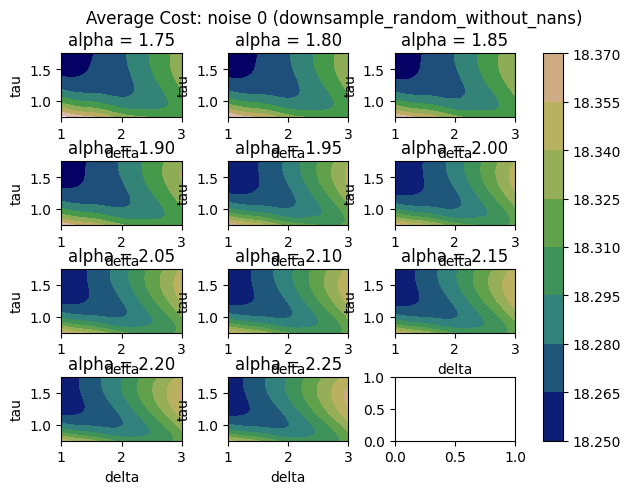

Minimal Cost for Average Cost: noise 1 (downsample_random_without_nans) = 19.228311885656492; at
     delta   tau  alpha
220    1.0  1.75   1.75


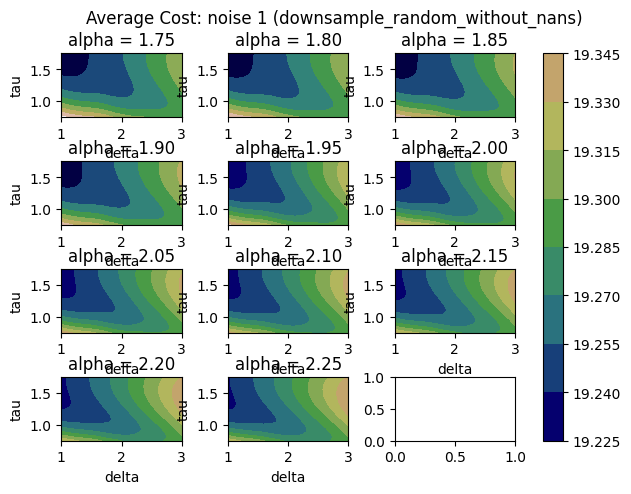

Minimal Cost for Average Cost: noise 4 (downsample_random_without_nans) = 34.42359559818498; at
     delta   tau  alpha
220    1.0  1.75   1.75


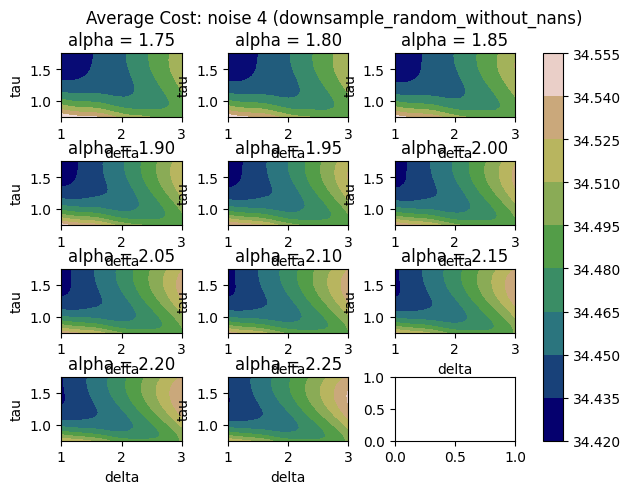

Minimal Cost for Average Cost: noise 7 (downsample_random_without_nans) = 67.73184669407524; at
     delta   tau  alpha
228    1.0  1.75   2.15


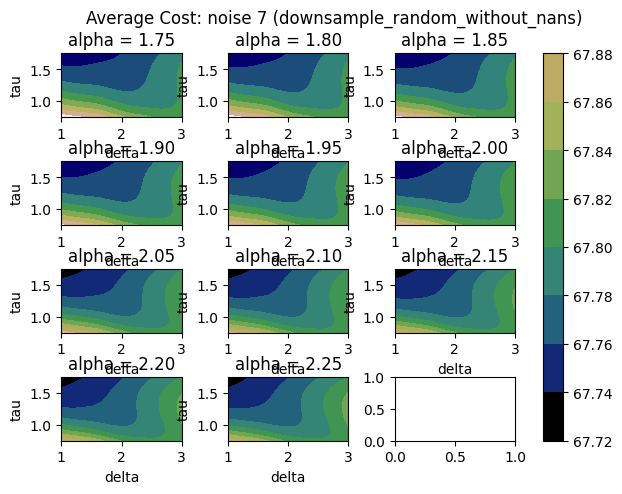

Minimal Cost for Average Cost: noise 10 (downsample_random_without_nans) = 117.59459185230286; at
     delta  tau  alpha
418   1.05  1.6   1.75


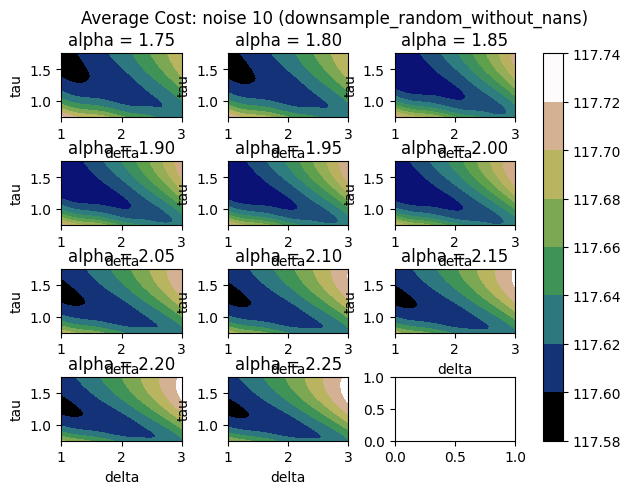

Minimal Cost for Average Cost: noise 13 (downsample_random_without_nans) = 186.86959869916626; at
     delta   tau  alpha
220    1.0  1.75   1.75


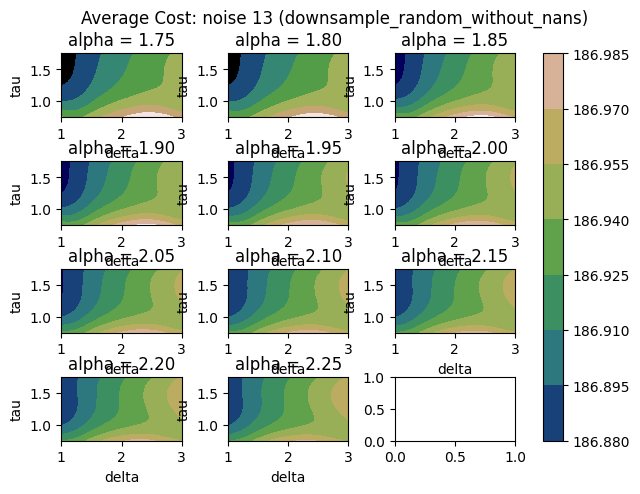

In [6]:
for i in range(num_models_to_generate):
    model_to_fmri = build_model_to_fmri(
        models_to_test,
        eeg_data_options_for_fmri_generation,
        expected_delta,
        expected_tau,
        expected_alpha,
        num_trials,
        num_trials_to_plot,
        noise_range,
        noises_to_plot,
        plot_perfect_comparison,
        tr,
        sample_freq,
        hemodynamic_response_window,
        plot_generated_data
    )
    models = build_models(
        model_to_fmri,
        eeg_data_options_for_simulation,
        tr, 
        n_trs_skipped_at_beginning,
        sample_freq,
        hemodynamic_response_window,
        plot
    )

    # Get in-depth plots for actual delta, tau, alpha
    for model_name, model in models.items():
        residual_var = model.score(expected_delta, expected_tau, expected_alpha)
        fmri_names = np.array(model.fmri.voxel_names)
        if (fmri_names == None).any():
            print(f'Residual variance was {residual_var}')
        model.plot = False
    
    print('Searching for optimal parameters!')
    descriptions, df = search_voxels(models, delta, tau, alpha)
    with open(f'{filename_substring}_{datetime.now().strftime("%Y-%m-%d_%H:%M")}{filename_ext}', 'w') as f:
        pd.DataFrame(df).to_csv(f)
    for model_name, description in zip(models.keys(), descriptions):
        with open(f'{model_name}_summary_{filename_substring}_{datetime.now().strftime("%Y-%m-%d_%H:%M")}{filename_ext}', 'w') as f:
            pd.DataFrame(description).transpose().to_csv(f)
    assert len(df['model_name'].unique()) == 1
    df_to_plot = df.drop(columns='model_name').astype(float)
    for noise in np.concatenate([[0], noise_range]):
        columns_to_choose = np.char.startswith(df_to_plot.columns.to_numpy().astype(str), f'{noise}noise')
        columns_for_noise = df_to_plot.columns[columns_to_choose]

        average_df = df_to_plot.loc[:,['delta', 'tau', 'alpha']]
        average_df[f'Average Cost: noise {noise} ({model_name})'] = df_to_plot[columns_for_noise].mean(axis=1)
        display_plot(plot_all_search_results_2d_on_same_colormap, average_df)

        # Grab parameters with the minimum cost
        minimum_cost_mask = df_to_plot[columns_for_noise] == df_to_plot[columns_for_noise].min()
        minimum_cost_array = df_to_plot[columns_for_noise][minimum_cost_mask].to_numpy()

        for point in zip(*np.where(~np.isnan(minimum_cost_array))):
            row_of_interest = df_to_plot.iloc[point[0]]
            data.append([row_of_interest['delta'], row_of_interest['tau'], row_of_interest['alpha'], noise])



## Cost by Noise

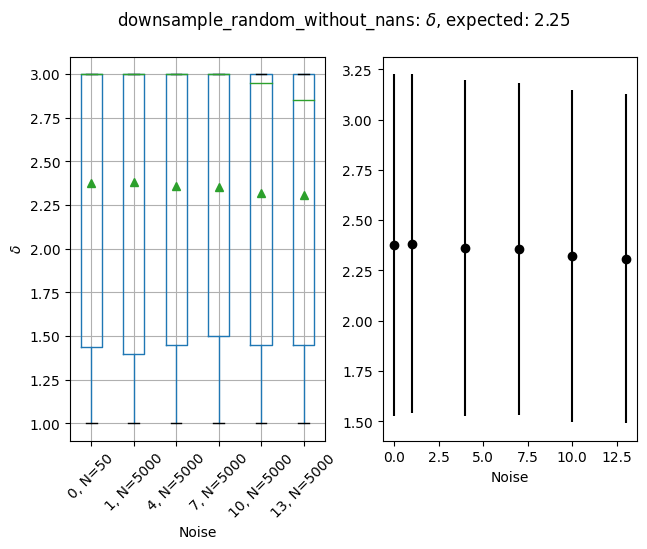

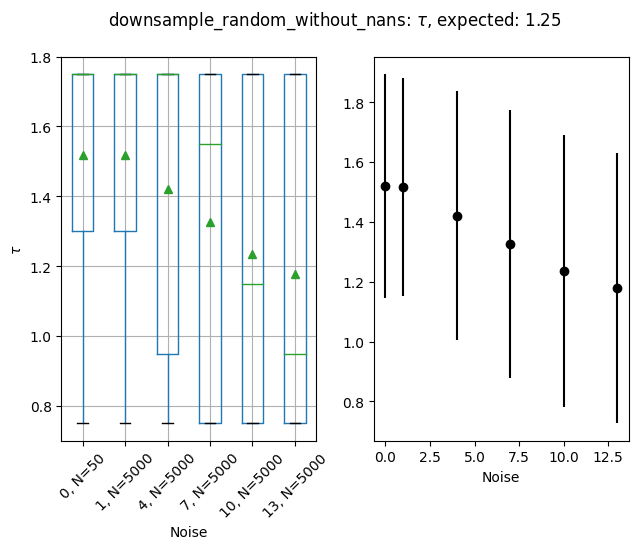

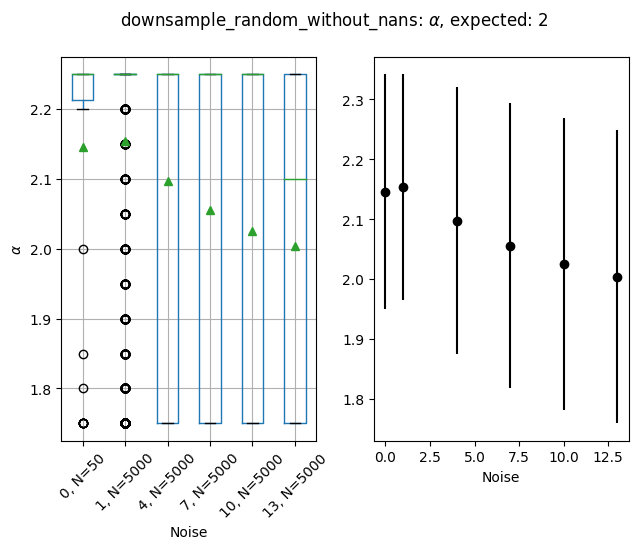

In [9]:
chosen_points = pd.DataFrame(data, columns=['delta', 'tau', 'alpha', 'noise']).groupby('noise')

for variable, expected_val in [('delta', expected_delta), ('tau', expected_tau), ('alpha', expected_alpha)]:
    fig, axs = plt.subplots(1, 2)
    fig.suptitle(f'{model_name}: {generate_latex_label(variable)}, expected: {expected_val}')
    fig.tight_layout()
    axs[0].set_ylabel(generate_latex_label(variable))
    axs[0].set_xlabel('Noise')
    axs[0] = chosen_points.boxplot(subplots=False, column=variable, rot=45, ax=axs[0], showmeans=True)
    axs[1].set_xlabel('Noise')
    axs[1].errorbar(
        np.concatenate([[0], noise_range]), 
        chosen_points.mean()[variable], 
        chosen_points.std()[variable], fmt='ok'
    )
    labels = chosen_points.count()
    labels = [f'{noise}, N={n[0].item()}' for noise, n in zip(labels.index, labels.values)]
    plt.setp(axs[0], xticklabels=labels)
    plt.show()
    